<a href="https://colab.research.google.com/github/PaulNeumann45/MSReport/blob/main/Chunked_MPC.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Mount Drive

# Necessary Packages

Install Necessary Packages

In [ ]:
!pip install tqdm
!pip install gurobipy
!pip install tabulate
!pip install ipython


Import Necessary Packages

In [ ]:
import numpy as np
import cvxpy as cp
from tqdm import tqdm
import os
import pandas as pd
import time
import matplotlib.pyplot as plt
import gurobipy as gp
import seaborn as sns
from tabulate import tabulate
from IPython.display import display, HTML

# Main Defintions

## Setup Gurobi
This code block initializes the Gurobi optimization environment. It sets up the environment with the necessary credentials for authentication, as well as configuring logging options. This function will be called globally to provide access to the Gurobi environment for optimization tasks.









In [ ]:
def setup_gurobi_env():
    wls_access_id = "23045029-4e10-4535-9832-65c80ed90d81"
    wls_secret = "4cf7e230-2944-4bef-bb81-ca366ff0e87e"
    license_id = 2519193

    env = gp.Env(empty=True)
    env.setParam('WLSACCESSID', wls_access_id)
    env.setParam('WLSSECRET', wls_secret)
    env.setParam('LICENSEID', license_id)
    env.setParam('LogToConsole', 0)
    env.setParam('OutputFlag', 0)
    env.start()
    return env

# Setup the environment globally
env = setup_gurobi_env()




## Load Data
This code block loads PV generation and home energy load data from specified CSV files. It processes the data to calculate the necessary solar array size based on the chosen net-zero energy (NZE) criteria. The function will also extract relevant columns for load and hot water demand depending on the home and water heater types.

In [ ]:
def load_data(pv_data_path, load_data_path, nze_type, nze_percentage, water_heater_type, home_type):
    """
    Loads and processes data for PV generation and home energy load based on configuration.

    Parameters:
        pv_data_path (str): Path to the PV generation data file.
        load_data_path (str): Path to the home energy load data file.
        nze_type (str): Net-zero energy type, either 'Site' or 'Electricity'.
        nze_percentage (float): Percentage of NZE target.
        water_heater_type (str): Type of water heater ('Electric_WH' or 'Gas_WH').
        home_type (str): Type of home, such as 'AE' or 'NAE'.

    Returns:
        tuple: Contains P_PV (PV generation), P_Load (total load without DHW),
               P_DHW (domestic hot water load), P_Total_Load (total load),
               and Load_Data (DataFrame).
    """
    # Print file paths for verification
    print(f"Loading PV data from: {pv_data_path}")
    print(f"Loading load data from: {load_data_path}")

    # Load the CSV files
    PV_Data = pd.read_csv(pv_data_path)
    Load_Data = pd.read_csv(load_data_path)

    # Display load data columns to verify structure
    print("Load Data Columns:", Load_Data.columns)

    # Convert 'Hours since 00:00 Jan 1' to a datetime index if it exists
    if 'Hours since 00:00 Jan 1' in Load_Data.columns:
        Load_Data['Date'] = pd.to_datetime('2022-01-01') + pd.to_timedelta(Load_Data['Hours since 00:00 Jan 1'], unit='h')
    else:
        raise ValueError("No suitable column for date parsing found in load data.")

    # Calculate Solar Size based on NZE criteria
    SolarGenPerKW = PV_Data['Hourly (kW)'].sum()  # Total annual generation per kW
    Total_Site_Energy_kBtu = Load_Data['My Design - Energy Use:  Total (kBtu)'].sum()
    Total_Site_Energy_kWh = Total_Site_Energy_kBtu / 3.412  # Convert kBtu to kWh

    # Calculate required solar array size based on NZE type
    nze_percentage = float(nze_percentage)
    if nze_type == 'Site':
        NZE_PV_Size = Total_Site_Energy_kWh / SolarGenPerKW * nze_percentage
    else:
        NZE_PV_Size = Load_Data['My Design - Fuel Use:  Electricity: Total (kWh)'].sum() / SolarGenPerKW * nze_percentage

    # Calculate NZE PV generation based on array size
    Load_Data['NZE_PV_Gen'] = PV_Data['Hourly (kW)'] * NZE_PV_Size

    # Define Parameters
    P_PV = Load_Data['NZE_PV_Gen'].values  # PV generation array

    # Select appropriate hot water load column based on water heater type
    if water_heater_type == "Electric_WH":
        if 'My Design - End Use:  Electricity: Hot Water (kWh)' in Load_Data.columns:
            P_DHW = Load_Data['My Design - End Use:  Electricity: Hot Water (kWh)'].values
        elif 'My Design - End Use:  Electricity : Hot Water (kWh)' in Load_Data.columns:
            P_DHW = Load_Data['My Design - End Use:  Electricity : Hot Water (kWh)'].values
        else:
            raise ValueError("No suitable column for electric hot water found in load data.")
    else:
        if 'My Design - End Use:  Natural Gas: Hot Water (kBtu)' in Load_Data.columns:
            P_DHW = Load_Data['My Design - End Use:  Natural Gas: Hot Water (kBtu)'].values / 3.412
        else:
            raise ValueError("No suitable column for natural gas hot water found in load data.")

    # Assign load and total load based on home and heater type
    if home_type == "AE" or (home_type == "NAE" and water_heater_type == "Electric_WH"):
        P_Load = Load_Data['My Design - Fuel Use:  Electricity: Total (kWh)'].values - P_DHW
        P_Total_Load = P_Load + P_DHW
    else:
        P_Load = Load_Data['My Design - Fuel Use:  Electricity: Total (kWh)'].values
        P_Total_Load = P_Load

    # Output the calculated NZE PV array size for verification
    print(f"NZE Solar Array Size: {NZE_PV_Size:.2f} kWp")
    print(f"Sized to: {'Total Site Energy' if nze_type == 'Site' else 'Total Site Electricity'}")

    return P_PV, P_Load, P_DHW, P_Total_Load, Load_Data


def run_main(config):
    """
    Loads data, selects and runs the specified model, and saves the results.

    Parameters:
        config (dict): A configuration dictionary with the following keys:
            - 'pv_data_path' (str): Path to the PV generation data file.
            - 'load_data_path' (str): Path to the home energy load data file.
            - 'nze_type' (str): Type of net-zero energy goal ('Site' or 'Electricity').
            - 'nze_percentage' (float): Percentage target for NZE.
            - 'water_heater_type' (str): Type of water heater ('Electric_WH' or 'Gas_WH').
            - 'home_type' (str): Type of home, such as 'AE' or 'NAE'.
            - 'model_type' (str): Type of energy storage model to run ('thermal_battery', 'battery', 'hydrogen', 'chp').
            - 'results_path' (str): Path to save the results CSV file.

    Returns:
        tuple: Contains:
            - results (DataFrame): Model output data.
            - Load_Data (DataFrame): Input load data with additional calculated columns.
    """

    # Load PV and load data based on the configuration parameters
    P_PV, P_Load, P_DHW, P_Total_Load, Load_Data = load_data(
        config['pv_data_path'], config['load_data_path'], config['nze_type'], config['nze_percentage'],
        config['water_heater_type'], config['home_type']
    )

    # Determine the type of storage model to run
    model_type = config['model_type']

    # Run the specified model based on the model type
    if model_type == "thermal_battery":
        results = run_thermal_battery(P_PV, P_Load, P_DHW, P_Total_Load, Load_Data, config)
    elif model_type == "battery":
        results = run_battery(P_PV, P_Load, P_Total_Load, P_DHW, Load_Data, config)
    elif model_type == "hydrogen":
        results = run_hydrogen(P_PV, P_Load, P_DHW, P_Total_Load, Load_Data, config)
    elif model_type == "chp":
        results = run_chp(P_PV, P_Load, P_DHW, P_Total_Load, Load_Data, config)
    else:
        raise ValueError(f"Invalid model type: {model_type}")

    # Save the results to the specified path
    results.to_csv(config['results_path'], index=False)

    # Return the results and load data for further analysis if needed
    return results, Load_Data

## Run Main FX
This block defines the `run_main` function, which is responsible for loading the necessary PV and load data, selecting the appropriate storage model, running the model, and saving the results. The function takes in a configuration dictionary (`config`) to set model parameters and paths.


In [ ]:
def run_main(config):
    """
    Loads data, selects and runs the specified model, and saves the results.

    Parameters:
        config (dict): A configuration dictionary with the following keys:
            - 'pv_data_path' (str): Path to the PV generation data file.
            - 'load_data_path' (str): Path to the home energy load data file.
            - 'nze_type' (str): Type of net-zero energy goal ('Site' or 'Electricity').
            - 'nze_percentage' (float): Percentage target for NZE.
            - 'water_heater_type' (str): Type of water heater ('Electric_WH' or 'Gas_WH').
            - 'home_type' (str): Type of home, such as 'AE' or 'NAE'.
            - 'model_type' (str): Type of energy storage model to run ('thermal_battery', 'battery', 'hydrogen', 'chp').
            - 'results_path' (str): Path to save the results CSV file.

    Returns:
        tuple: Contains:
            - results (DataFrame): Model output data.
            - Load_Data (DataFrame): Input load data with additional calculated columns.
    """

    # Load PV and load data based on the configuration parameters
    P_PV, P_Load, P_DHW, P_Total_Load, Load_Data = load_data(
        config['pv_data_path'], config['load_data_path'], config['nze_type'], config['nze_percentage'],
        config['water_heater_type'], config['home_type']
    )

    # Determine the type of storage model to run
    model_type = config['model_type']

    # Run the specified model based on the model type
    if model_type == "thermal_battery":
        results = run_thermal_battery(P_PV, P_Load, P_DHW, P_Total_Load, Load_Data, config)
    elif model_type == "battery":
        results = run_battery(P_PV, P_Load, P_Total_Load, P_DHW, Load_Data, config)
    elif model_type == "hydrogen":
        results = run_hydrogen(P_PV, P_Load, P_DHW, P_Total_Load, Load_Data, config)
    elif model_type == "chp":
        results = run_chp(P_PV, P_Load, P_DHW, P_Total_Load, Load_Data, config)
    else:
        raise ValueError(f"Invalid model type: {model_type}")

    # Save the results to the specified path
    results.to_csv(config['results_path'], index=False)

    # Return the results and load data for further analysis if needed
    return results, Load_Data

# Models

## Thermal Battery Model
This function performs a thermal battery optimization using Model Predictive Control (MPC) to manage PV generation, load demand, and grid interactions. It optimizes the charging and discharging of a thermal battery while minimizing reliance on grid imports and exports. The function iterates through time steps to manage battery states, track surplus solar energy, and meet domestic hot water (DHW) needs.


In [ ]:
def run_thermal_battery(P_PV, P_Load, P_DHW, P_Total_Load, Load_Data, config):
    """
    Chunked version of the thermal battery optimization model with original constraints.

    Parameters:
        P_PV, P_Load, P_DHW, P_Total_Load: Arrays of input data.
        Load_Data: DataFrame with additional load details.
        config: Dictionary with configuration settings.

    Returns:
        DataFrame of results for the chunked model.
    """
    ts = config['time_step']  # Total number of time steps
    chunk_size = config.get('chunk_size', 24)  # Default chunk size (e.g., daily chunks)

    # Initialize storage arrays for results
    E_TB_opt = np.zeros(ts + 1)  # State of charge of thermal battery
    P_TB_Ch_opt = np.zeros(ts)  # Battery charging power
    P_Grid_From_opt = np.zeros(ts)  # Power imported from the grid
    P_Grid_To_opt = np.zeros(ts)  # Power exported to the grid
    Net_Load_Grid_opt = np.zeros(ts)  # Net load seen by the grid
    Power_Balance_opt = np.zeros(ts)  # To validate power balance

    # Additional calculated metrics
    P_Grid_From_Baselineline = np.maximum(P_Total_Load - P_PV, 0)
    P_Grid_To_Baseline = np.maximum(P_PV - P_Total_Load, 0)
    Net_Load_Grid_Without_Battery = P_Grid_From_Baseline - P_Grid_To_Baseline
    Self_Consumption = np.minimum(P_PV, P_Load)
    Surplus_Solar = np.maximum(P_PV - P_Load, 0)
    P_net_opt = P_PV - P_Load

    # Set initial state of charge
    E_TB_opt[0] = config['init_soc']

    # Big-M value
    M = 1e6

    # Iterate over chunks
    for t_start in tqdm(range(0, ts, chunk_size), desc="Thermal Battery Optimization (Chunked)"):
        t_end = min(t_start + chunk_size, ts)
        current_horizon = t_end - t_start

        # Optimization variables for the current chunk
        P_TB_Ch = cp.Variable(current_horizon, nonneg=True)
        P_Grid_From = cp.Variable(current_horizon, nonneg=True)
        P_Grid_To = cp.Variable(current_horizon, nonneg=True)
        E_TB = cp.Variable(current_horizon + 1, nonneg=True)

        # Binary variables for Big-M constraints
        B_PV = np.array([1 if P > 0 else 0 for P in P_PV[t_start:t_end]])
        B_Ch = cp.Variable(current_horizon, boolean=True)

        # Define constraints (original model constraints preserved)
        constraints = [
            E_TB[0] == E_TB_opt[t_start],  # Initial state of charge
            E_TB[1:] == E_TB[:-1] + P_TB_Ch - P_DHW[t_start:t_end],  # SOC balance
            E_TB <= config['max_capacity'],  # Battery capacity
            P_TB_Ch <= config['max_charge_rate'],  # Max charge rate
            P_TB_Ch <= B_Ch * M,  # Link charging to binary variable
            P_Grid_From + P_PV[t_start:t_end] - P_Load[t_start:t_end] - P_Grid_To == P_TB_Ch,  # Power balance
            P_Grid_To <= B_PV * M,  # Ensure grid export only occurs with PV generation
            P_TB_Ch >= 0,  # Charging non-negative
            P_Grid_From >= 0,  # Grid import non-negative
            P_Grid_To >= 0,  # Grid export non-negative,
        ]

        # Objective function: maximize self-consumption, minimize grid import/export
        objective = cp.Maximize(
            cp.sum(P_TB_Ch) - config['alpha'] * cp.sum(P_Grid_From) - config['beta'] * cp.sum(P_Grid_To)
        )

        # Solve the problem
        prob = cp.Problem(objective, constraints)
        prob.solve(solver='GUROBI', verbose=False, env=env)

        if prob.status != cp.OPTIMAL:
            print(f"Optimization problem for chunk {t_start}-{t_end} not solved to optimality: {prob.status}")
            break

        # Store results for this chunk
        E_TB_opt[t_start + 1:t_end + 1] = E_TB.value[1:]
        P_TB_Ch_opt[t_start:t_end] = P_TB_Ch.value
        P_Grid_From_opt[t_start:t_end] = P_Grid_From.value
        P_Grid_To_opt[t_start:t_end] = P_Grid_To.value
        Net_Load_Grid_opt[t_start:t_end] = P_Grid_From.value - P_Grid_To.value
        Power_Balance_opt[t_start:t_end] = (
            P_PV[t_start:t_end] - P_Load[t_start:t_end] + P_Grid_From.value - P_Grid_To.value - P_TB_Ch.value
        )

    # Compile results into a DataFrame
    results = pd.DataFrame({
        'Date': Load_Data['Date'][:ts],
        'P_PV': P_PV[:ts],
        'P_Load': P_Load[:ts],
        'P_DHW': P_DHW[:ts],
        'P_Total_Load': P_Total_Load[:ts],
        'E_TB': E_TB_opt[:-1],
        'P_TB_Ch': P_TB_Ch_opt,
        'P_Grid_From': P_Grid_From_opt,
        'P_Grid_To': P_Grid_To_opt,
        'Net_Load_Grid': Net_Load_Grid_opt,
        'Power_Balance': Power_Balance_opt,
        'P_Grid_From_Baseline': P_Grid_From_Baseline,
        'P_Grid_To_Baseline': P_Grid_To_Baseline,
        'Net_Load_Grid_Without_Battery': Net_Load_Grid_Without_Battery,
        'Self_Consumption': Self_Consumption,
        'Surplus_Solar': Surplus_Solar,
        'P_net': P_net_opt
    })

    return results


 Executes a thermal battery optimization model using Model Predictive Control (MPC).
    
    Parameters:
        P_PV (array): Array of PV generation values.
        P_Load (array): Array of load demand values excluding DHW.
        P_DHW (array): Array of domestic hot water load values.
        P_Total_Load (array): Total energy demand including DHW.
        Load_Data (DataFrame): DataFrame with load data and time indices.
        config (dict): Configuration parameters including:
            - 'time_step' (int): Number of time steps for the optimization.
            - 'init_soc' (float): Initial state of charge of the thermal battery.
            - 'max_capacity' (float): Maximum capacity of the thermal battery.
            - 'max_charge_rate' (float): Maximum charging rate of the thermal battery.
            - 'horizon' (int): Optimization horizon (steps) for MPC.
            - 'alpha' (float): Penalty coefficient for grid import.
            - 'beta' (float): Penalty coefficient for grid export.

    Returns:
        DataFrame: Results including battery states, grid interactions, and solar metrics.
    

## Battery Model
This function performs battery optimization with Model Predictive Control (MPC) to manage PV generation, load demand, and grid interactions. It optimizes battery charge/discharge operations to maximize solar self-consumption while minimizing reliance on grid imports and exports. The optimization runs over defined time horizons with constraints on battery efficiency, charge rates, and grid interactions.


In [ ]:
def run_battery(P_PV, P_Load, P_Total_Load, P_DHW, Load_Data, config):
    ts = config['time_step']  # Time Step
    E_B_opt = np.zeros(ts + 1)  # State of charge of the battery
    P_B_Ch_opt = np.zeros(ts)  # Battery charge power
    P_B_Dis_opt = np.zeros(ts)  # Battery discharge power
    P_Grid_From_opt = np.zeros(ts)  # Grid import
    P_Grid_To_opt = np.zeros(ts)  # Grid export
    P_net_opt = np.zeros(ts)  # Net solar power
    Surplus_Solar_opt = np.zeros(ts)  # Surplus solar power
    Net_Load_Grid_opt = np.zeros(ts)  # Net load seen by the grid
    Power_Balance_opt = np.zeros(ts)  # Power balance check results

    # Initial state of charge of the battery
    E_B_opt[0] = config['E_B_initial']

    # Binary indicator for PV presence
    B_PV = np.array([1 if P > 0 else 0 for P in P_PV])

    # Large M value
    M = 1e6

    def solve_optimization(t, current_horizon):
        P_B_Ch = cp.Variable(current_horizon, nonneg=True)
        P_B_Dis = cp.Variable(current_horizon, nonneg=True)
        P_Grid_From = cp.Variable(current_horizon, nonneg=True)
        P_Grid_To = cp.Variable(current_horizon, nonneg=True)
        E_B = cp.Variable(current_horizon + 1, nonneg=True)  # State of charge of the battery

        # Binary variables
        B_Charge = cp.Variable(current_horizon, boolean=True)
        B_Discharge = cp.Variable(current_horizon, boolean=True)

        # Calculate P_net
        P_net = P_PV[t:t + current_horizon] - P_Total_Load[t:t + current_horizon]
        Surplus_Solar = cp.maximum(P_net, 0)

        # Constraints
        constraints = [
            E_B[0] == E_B_opt[t],  # Initial state of charge for this horizon
            E_B[1:] == E_B[:-1] + config['battery_efficiency'] * P_B_Ch - P_B_Dis / config['battery_efficiency'],  # Battery SOC balance with efficiency
            E_B <= config['E_B_capacity'],  # Maximum battery capacity
            E_B >= 0,  # Ensure non-negative battery SOC
            P_B_Ch <= config['P_B_Ch_rate'],  # Maximum battery charge rate
            P_B_Dis <= config['P_B_Dis_rate'],  # Maximum battery discharge rate
            P_B_Ch <= Surplus_Solar,  # Ensure battery charge does not exceed available surplus PV generation
            P_B_Ch <= B_Charge * M,  # Link battery charge power to the binary variable for charge
            P_B_Dis <= B_Discharge * M,  # Link battery discharge power to the binary variable for discharge
            B_Charge + B_Discharge <= 1,  # Prevent simultaneous charge and discharge
            P_Grid_From + P_net + P_B_Dis == P_B_Ch + P_Grid_To,  # Power balance constraint
            P_Grid_To <= Surplus_Solar,  # Ensure grid export only from surplus PV, not from battery discharge
            P_Grid_From <= P_Total_Load[t:t + current_horizon],  # Ensure grid import does not exceed the total load
            P_B_Ch <= (config['E_B_capacity'] - E_B[:-1]) / config['battery_efficiency'],  # Charge only if the battery is not full
            P_B_Dis <= E_B[:-1] * config['battery_efficiency']  # Discharge only if the battery has enough charge
        ]

        # Objective function to maximize battery charge and minimize grid power
        objective = cp.Maximize(cp.sum(P_B_Ch) - config['alpha'] * cp.sum(P_Grid_From) - config['beta'] * cp.sum(P_Grid_To))

        # Solve the problem with Gurobi and set verbosity parameters
        prob = cp.Problem(objective, constraints)
        prob.solve(solver=cp.GUROBI, verbose=False, env=env)

        if prob.status != cp.OPTIMAL:
            print(f"Optimization problem at step {t} not solved to optimality: {prob.status}")
            return None

        return {
            "E_B": E_B.value,
            "P_B_Ch": P_B_Ch.value,
            "P_B_Dis": P_B_Dis.value,
            "P_Grid_From": P_Grid_From.value,
            "P_Grid_To": P_Grid_To.value,
            "P_net": P_net,
            "Surplus_Solar": Surplus_Solar.value
        }

    # Chunk processing with correct constraints
    chunk_size = 24  # Process data in chunks to manage memory and processing time

    for t in tqdm(range(0, ts, chunk_size), desc="Battery Optimization Progress"):
        start_time = time.time()
        current_horizon = min(chunk_size, ts - t)
        result = solve_optimization(t, current_horizon)
        if result is None:
            break

        E_B_opt[t:t + current_horizon + 1] = result["E_B"]
        P_B_Ch_opt[t:t + current_horizon] = result["P_B_Ch"]
        P_B_Dis_opt[t:t + current_horizon] = result["P_B_Dis"]
        P_Grid_From_opt[t:t + current_horizon] = result["P_Grid_From"]
        P_Grid_To_opt[t:t + current_horizon] = result["P_Grid_To"]
        P_net_opt[t:t + current_horizon] = result["P_net"]
        Surplus_Solar_opt[t:t + current_horizon] = result["Surplus_Solar"]

    # Calculate without battery storage metrics
    P_Grid_From_without_B = np.maximum(P_Total_Load - P_PV, 0)
    P_Grid_To_without_B = np.maximum(P_PV - P_Total_Load, 0)
    Net_Load_Grid_without_B = P_Grid_From_without_B - P_Grid_To_without_B

    # Calculate net load seen by the grid
    Net_Load_Grid_opt = P_Grid_From_opt - P_Grid_To_opt
    Power_Balance_opt = P_B_Ch_opt + P_Grid_To_opt - (P_net_opt + P_B_Dis_opt + P_Grid_From_opt)

    # Calculate self-consumption (PV directly used)
    Self_Consumption = np.minimum(P_PV, P_Total_Load)

    # Compile results
    results = pd.DataFrame({
        'Date': Load_Data['Date'][:ts],
        'P_PV': P_PV[:ts],
        'P_Load': P_Load[:ts],
        'P_DHW': P_DHW[:ts],
        'P_Total_Load': P_Total_Load[:ts],
        'E_B': E_B_opt[:ts],
        'P_B_Ch': P_B_Ch_opt,
        'P_B_Dis': P_B_Dis_opt,
        'P_Grid_From': P_Grid_From_opt,
        'P_Grid_To': P_Grid_To_opt,
        'P_net': P_net_opt,
        'Surplus_Solar': Surplus_Solar_opt,
        'Net_Load_Grid': Net_Load_Grid_opt,
        'Power_Balance': Power_Balance_opt,
        'P_Grid_From_Without_B': P_Grid_From_without_B,
        'P_Grid_To_Without_B': P_Grid_To_without_B,
        'Net_Load_Grid_Without_B': Net_Load_Grid_without_B,
        'Self_Consumption': Self_Consumption
    })

    return results


## Hydrogen Model  
This function performs hydrogen system optimization using Model Predictive Control (MPC). It manages PV generation, load demand, hydrogen production, and fuel cell utilization to balance energy flows, maximize solar self-consumption, and minimize grid interactions. The electrolyzer produces hydrogen when there is surplus PV generation, and the fuel cell provides power during deficits.


In [ ]:
def run_hydrogen(P_PV, P_Load, P_DHW, P_Total_Load, Load_Data, config):
    ts = config['time_step']
    H2_Tank_opt = np.zeros(ts + 1)
    P_EL_opt = np.zeros(ts)
    P_FC_opt = np.zeros(ts)
    P_Grid_From_opt = np.zeros(ts)
    P_Grid_To_opt = np.zeros(ts)
    P_net_opt = np.zeros(ts)
    Surplus_Solar_opt = np.zeros(ts)
    Net_Load_Grid_opt = np.zeros(ts)
    Power_Balance_opt = np.zeros(ts)

    H2_Tank_opt[0] = config['H2_initial_level']
    B_PV = np.array([1 if P > 0 else 0 for P in P_PV])
    M = 1e6

    def solve_optimization(t, current_horizon):
        P_EL = cp.Variable(current_horizon, nonneg=True)
        P_FC = cp.Variable(current_horizon, nonneg=True)
        P_Grid_From = cp.Variable(current_horizon, nonneg=True)
        P_Grid_To = cp.Variable(current_horizon, nonneg=True)
        H2_Tank = cp.Variable(current_horizon + 1, nonneg=True)

        B_EL = cp.Variable(current_horizon, boolean=True)
        B_FC = cp.Variable(current_horizon, boolean=True)

        P_net = P_PV[t:t + current_horizon] - P_Total_Load[t:t + current_horizon]
        Surplus_Solar = cp.maximum(P_net, 0)

        constraints = [
            H2_Tank[0] == H2_Tank_opt[t],
            H2_Tank[1:] == H2_Tank[:-1] + config['H2_production_rate'] * P_EL - config['H2_consumption_rate'] * P_FC,
            H2_Tank <= config['H2_tank_capacity'],
            H2_Tank >= 0,
            P_EL <= config['EL_max_power'],
            P_FC <= config['FC_max_power'],
            P_EL <= Surplus_Solar,
            P_EL <= B_EL * M,
            P_FC <= B_FC * M,
            B_EL + B_FC <= 1,
            P_Grid_From + P_net + P_FC == P_EL + P_Grid_To,
            P_EL <= B_PV[t:t + current_horizon] * M,
            cp.sum(P_FC) + cp.sum(P_Grid_From) >= cp.sum(P_Total_Load[t:t + current_horizon]) - cp.sum(P_PV[t:t + current_horizon]),
            P_FC >= (P_Total_Load[t:t + current_horizon] - P_PV[t:t + current_horizon] - P_Grid_From),
            P_Grid_To <= (1 - B_FC) * M,
        ]

        objective = cp.Maximize(cp.sum(P_EL) - config['alpha'] * cp.sum(P_Grid_From) - config['beta'] * cp.sum(P_Grid_To))
        prob = cp.Problem(objective, constraints)
        prob.solve(solver=cp.GUROBI, verbose=False, env=env)

        if prob.status != cp.OPTIMAL:
            print(f"Optimization problem at step {t} not solved to optimality: {prob.status}")
            return None

        return {
            "H2_Tank": H2_Tank.value,
            "P_EL": P_EL.value,
            "P_FC": P_FC.value,
            "P_Grid_From": P_Grid_From.value,
            "P_Grid_To": P_Grid_To.value,
            "P_net": P_net,
            "Surplus_Solar": Surplus_Solar.value
        }

    chunk_size = 24

    for t in tqdm(range(0, ts, chunk_size), desc="Hydrogen Optimization Progress"):
        start_time = time.time()
        current_horizon = min(chunk_size, ts - t)
        result = solve_optimization(t, current_horizon)
        if result is None:
            break

        H2_Tank_opt[t:t + current_horizon + 1] = result["H2_Tank"]
        P_EL_opt[t:t + current_horizon] = result["P_EL"]
        P_FC_opt[t:t + current_horizon] = result["P_FC"]
        P_Grid_From_opt[t:t + current_horizon] = result["P_Grid_From"]
        P_Grid_To_opt[t:t + current_horizon] = result["P_Grid_To"]
        P_net_opt[t:t + current_horizon] = result["P_net"]
        Surplus_Solar_opt[t:t + current_horizon] = result["Surplus_Solar"]

    P_Grid_From_without_H2 = np.maximum(P_Total_Load - P_PV, 0)
    P_Grid_To_without_H2 = np.maximum(P_PV - P_Total_Load, 0)
    Net_Load_Grid_without_H2 = P_Grid_From_without_H2 - P_Grid_To_without_H2

    Net_Load_Grid_opt = P_Grid_From_opt - P_Grid_To_opt
    Power_Balance_opt = P_EL_opt + P_Grid_To_opt - (P_net_opt + P_FC_opt + P_Grid_From_opt)

    Self_Consumption = np.minimum(P_PV, P_Total_Load)

    results = pd.DataFrame({
        'Date': Load_Data['Date'][:ts],
        'P_PV': P_PV[:ts],
        'P_Load': P_Load[:ts],
        'P_DHW': P_DHW[:ts],
        'P_Total_Load': P_Total_Load[:ts],
        'H2_Tank': H2_Tank_opt[:ts],
        'P_EL': P_EL_opt,
        'P_FC': P_FC_opt,
        'P_Grid_From': P_Grid_From_opt,
        'P_Grid_To': P_Grid_To_opt,
        'P_net': P_net_opt,
        'Surplus_Solar': Surplus_Solar_opt,
        'Net_Load_Grid': Net_Load_Grid_opt,
        'Power_Balance': Power_Balance_opt,
        'P_Grid_From_Without_H2': P_Grid_From_without_H2,
        'P_Grid_To_Without_H2': P_Grid_To_without_H2,
        'Net_Load_Grid_Without_H2': Net_Load_Grid_without_H2,
        'Self_Consumption': Self_Consumption
    })

    return results



    Executes a hydrogen storage system optimization model using Model Predictive Control (MPC).
    
    Parameters:
        P_PV (array): Array of PV generation values.
        P_Load (array): Array of load demand values excluding DHW.
        P_DHW (array): Array of domestic hot water load values.
        P_Total_Load (array): Array of total energy demand including DHW.
        Load_Data (DataFrame): DataFrame with load data and time indices.
        config (dict): Configuration parameters including:
            - 'time_step' (int): Number of time steps for the optimization.
            - 'H2_initial_level' (float): Initial hydrogen level in the storage tank.
            - 'H2_production_rate' (float): Hydrogen production rate of the electrolyzer.
            - 'H2_consumption_rate' (float): Hydrogen consumption rate of the fuel cell.
            - 'H2_tank_capacity' (float): Maximum hydrogen storage capacity.
            - 'EL_max_power' (float): Maximum power for electrolyzer.
            - 'FC_max_power' (float): Maximum power for fuel cell.
            - 'alpha' (float): Penalty coefficient for grid import.
            - 'beta' (float): Penalty coefficient for grid export.

    Returns:
        DataFrame: Results including hydrogen tank levels, grid interactions, and power metrics.
  

## CHP Model
This function performs optimization for a combined heat and power (CHP) system that integrates hydrogen storage, an electrolyzer, a fuel cell, and a thermal battery. The model manages energy flows to balance PV generation, electric and thermal loads, and grid interactions. Waste heat from the fuel cell is used to charge the thermal battery, providing an additional source of thermal energy to meet domestic hot water (DHW) demands.


In [ ]:
def run_chp(P_PV, P_Load, P_DHW, P_Total_Load, Load_Data, config):
    """
    Combined Heat and Power (CHP) model optimization.

    Parameters:
        P_PV, P_Load, P_DHW, P_Total_Load: Arrays of input data.
        Load_Data: DataFrame with additional load details.
        config: Dictionary with configuration settings.

    Returns:
        DataFrame of results for the CHP model.
    """
    ts = config['time_step']  # Time Step
    H2_Tank_opt = np.zeros(ts + 1)  # Hydrogen tank level
    P_EL_opt = np.zeros(ts)  # Electrolyzer power
    P_FC_opt = np.zeros(ts)  # Fuel cell power
    P_Grid_From_opt = np.zeros(ts)  # Grid import
    P_Grid_To_opt = np.zeros(ts)  # Grid export
    P_net_opt = np.zeros(ts)  # Net solar power
    Surplus_Solar_opt = np.zeros(ts)  # Surplus solar power
    Net_Load_Grid_opt = np.zeros(ts)  # Net load seen by the grid
    Power_Balance_opt = np.zeros(ts)  # Power balance check results
    Thermal_Battery_opt = np.zeros(ts + 1)  # Thermal battery level
    Waste_Heat_Unused_opt = np.zeros(ts)  # Unused waste heat
    P_TB_CH_ER_opt = np.zeros(ts)  # Thermal battery charging from electric resistance
    P_TB_CH_WH_opt = np.zeros(ts)  # Thermal battery charging from waste heat
    P_TB_Discharge_opt = np.zeros(ts)  # Thermal battery discharging
    Self_Consumption_opt = np.zeros(ts)  # PV generation directly consumed on-site

    # Initial hydrogen and thermal battery levels
    H2_Tank_opt[0] = config['H2_initial_level']
    Thermal_Battery_opt[0] = config['thermal_battery_initial_level']

    # Large M value for Big-M constraints
    M = 1e6

    def solve_optimization(t, current_horizon):
        """
        Solve the optimization problem for the CHP model within the given horizon.

        Parameters:
            t: Start time index.
            current_horizon: Length of the optimization horizon.

        Returns:
            A dictionary of optimization results for the horizon.
        """
        # Optimization variables
        P_EL = cp.Variable(current_horizon, nonneg=True)  # Electrolyzer power
        P_FC = cp.Variable(current_horizon, nonneg=True)  # Fuel cell power
        P_Grid_From = cp.Variable(current_horizon, nonneg=True)  # Grid import
        P_Grid_To = cp.Variable(current_horizon, nonneg=True)  # Grid export
        H2_Tank = cp.Variable(current_horizon + 1, nonneg=True)  # Hydrogen tank level
        Thermal_Battery = cp.Variable(current_horizon + 1, nonneg=True)  # Thermal battery level
        P_TB_CH_ER = cp.Variable(current_horizon, nonneg=True)  # Thermal battery charging from electric resistance
        P_TB_CH_WH = cp.Variable(current_horizon, nonneg=True)  # Thermal battery charging from waste heat
        P_TB_Discharge = cp.Variable(current_horizon, nonneg=True)  # Thermal battery discharging
        Waste_Heat_Unused = cp.Variable(current_horizon, nonneg=True)  # Unused waste heat

        # Binary variables for Big-M constraints
        B_EL = cp.Variable(current_horizon, boolean=True)  # Electrolyzer binary variable
        B_FC = cp.Variable(current_horizon, boolean=True)  # Fuel cell binary variable

        # Calculate net PV generation
        P_net_E = P_PV[t:t + current_horizon] - P_Load[t:t + current_horizon]  # Net PV power after electric load
        Surplus_Solar = cp.maximum(P_net_E, 0)  # Surplus solar energy

        # Constraints
        constraints = [
            # Hydrogen tank balance
            H2_Tank[0] == H2_Tank_opt[t],  # Initial hydrogen level
            H2_Tank[1:] == H2_Tank[:-1] + config['H2_production_rate'] * P_EL - config['H2_consumption_rate'] * P_FC,  # Hydrogen balance
            H2_Tank <= config['H2_tank_capacity'],  # Hydrogen tank capacity
            H2_Tank >= 0,  # Non-negative hydrogen tank level

            # Power limits for electrolyzer and fuel cell
            P_EL <= config['EL_max_power'],  # Max electrolyzer power
            P_FC <= config['FC_max_power'],  # Max fuel cell power
            P_EL <= B_EL * M,  # Link electrolyzer to binary variable
            P_FC <= B_FC * M,  # Link fuel cell to binary variable
            B_EL + B_FC <= 1,  # Prevent simultaneous operation of electrolyzer and fuel cell

            # Thermal battery constraints
            Thermal_Battery[0] == Thermal_Battery_opt[t],  # Initial thermal battery level
            Thermal_Battery[1:] == Thermal_Battery[:-1] + config['thermal_battery_charge_efficiency'] * (
                P_TB_CH_ER + config['waste_heat_fraction'] * P_FC - Waste_Heat_Unused) - P_TB_Discharge,  # Thermal battery balance
            Thermal_Battery <= config['thermal_battery_capacity'],  # Thermal battery capacity
            Thermal_Battery >= 0,  # Non-negative thermal battery level

            # Waste heat and thermal battery charging
            P_TB_CH_ER <= config['thermal_battery_max_charge_rate'],  # Electric resistance charging rate
            P_TB_CH_WH <= cp.minimum(config['waste_heat_fraction'] * P_FC, config['thermal_battery_max_charge_rate_WH']),  # Waste heat charging rate
            Waste_Heat_Unused >= config['waste_heat_fraction'] * P_FC - P_TB_CH_WH,  # Unused waste heat
            Waste_Heat_Unused >= 0,  # Non-negative unused waste heat

            # Power balance constraints
            P_Grid_From + P_net_E + P_FC == P_EL + P_TB_CH_ER + P_Grid_To,  # Electric power balance
            P_Grid_From >= cp.maximum(P_Load[t:t + current_horizon] - P_PV[t:t + current_horizon] - P_FC, 0),  # Grid import to meet electric load
            P_Grid_From >= cp.maximum(P_DHW[t:t + current_horizon] - P_TB_Discharge, 0),  # Grid import to meet DHW load

            # Ensure P_TB_Discharge meets DHW load
            P_TB_Discharge == P_DHW[t:t + current_horizon]
        ]

        # Objective function
        objective = cp.Maximize(
            cp.sum(P_EL) + cp.sum(P_TB_CH_ER) - config['alpha'] * cp.sum(P_Grid_From) - config['beta'] * cp.sum(P_Grid_To)
        )

        # Solve the problem
        prob = cp.Problem(objective, constraints)
        prob.solve(solver=cp.GUROBI, verbose=False, env=env)

        if prob.status != cp.OPTIMAL:
            print(f"Optimization problem at step {t} not solved to optimality: {prob.status}")
            return None

        # Return optimization results
        return {
            "H2_Tank": H2_Tank.value,
            "P_EL": P_EL.value,
            "P_FC": P_FC.value,
            "P_Grid_From": P_Grid_From.value,
            "P_Grid_To": P_Grid_To.value,
            "P_net_E": P_net_E,
            "Surplus_Solar": Surplus_Solar.value,
            "Thermal_Battery": Thermal_Battery.value,
            "Waste_Heat_Unused": Waste_Heat_Unused.value,
            "P_TB_CH_ER": P_TB_CH_ER.value,
            "P_TB_CH_WH": P_TB_CH_WH.value,
            "P_TB_Discharge": P_TB_Discharge.value
        }

    # Chunk processing
    chunk_size = 240  # Process in chunks (e.g., 10 days)
    for t in tqdm(range(0, ts, chunk_size), desc="CHP Optimization Progress"):
        current_horizon = min(chunk_size, ts - t)  # Adjust horizon for last chunk
        result = solve_optimization(t, current_horizon)
        if result is None:
            break

        # Store results for each chunk
        H2_Tank_opt[t:t + current_horizon + 1] = result["H2_Tank"]
        P_EL_opt[t:t + current_horizon] = result["P_EL"]
        P_FC_opt[t:t + current_horizon] = result["P_FC"]
        P_Grid_From_opt[t:t + current_horizon] = result["P_Grid_From"]
        P_Grid_To_opt[t:t + current_horizon] = result["P_Grid_To"]
        P_net_opt[t:t + current_horizon] = result["P_net_E"]
        Surplus_Solar_opt[t:t + current_horizon] = result["Surplus_Solar"]
        Thermal_Battery_opt[t:t + current_horizon + 1] = result["Thermal_Battery"]
        Waste_Heat_Unused_opt[t:t + current_horizon] = result["Waste_Heat_Unused"]
        P_TB_CH_ER_opt[t:t + current_horizon] = result["P_TB_CH_ER"]
        P_TB_CH_WH_opt[t:t + current_horizon] = result["P_TB_CH_WH"]
        P_TB_Discharge_opt[t:t + current_horizon] = result["P_TB_Discharge"]

        # Self Consumption Calculation
        Self_Consumption_opt[t:t + current_horizon] = np.minimum(P_PV[t:t + current_horizon], P_Total_Load[t:t + current_horizon])

    # Compile Results
    results = pd.DataFrame({
        'Date': Load_Data['Date'],
        'P_PV': P_PV,
        'P_Load': P_Load,
        'P_DHW': P_DHW,
        'P_Total_Load': P_Total_Load,
        'H2_Tank': H2_Tank_opt[:-1],
        'P_EL': P_EL_opt,
        'P_FC': P_FC_opt,
        'P_Grid_From': P_Grid_From_opt,
        'P_Grid_To': P_Grid_To_opt,
        'P_net': P_net_opt,
        'Surplus_Solar': Surplus_Solar_opt,
        'Net_Load_Grid': P_Grid_From_opt - P_Grid_To_opt,  # Calculate Net Load Grid
        'Thermal_Battery': Thermal_Battery_opt[:-1],
        'Power_Balance': Power_Balance_opt,
        'Waste_Heat_Unused': Waste_Heat_Unused_opt,
        'P_TB_Charging_ER': P_TB_CH_ER_opt,
        'P_TB_Charging_WH': P_TB_CH_WH_opt,
        'P_TB_Discharge': P_TB_Discharge_opt,
        'Self_Consumption': Self_Consumption_opt  # Add Self Consumption
    })

    # Save results to CSV
    results.to_csv(config['results_path'], index=False)

    return results


    Executes a combined heat and power (CHP) system optimization model using Model Predictive Control (MPC).
    
    Parameters:
        P_PV (array): Array of PV generation values.
        P_Load (array): Array of load demand values excluding DHW.
        P_DHW (array): Array of domestic hot water load values.
        P_Total_Load (array): Array of total energy demand including DHW.
        Load_Data (DataFrame): DataFrame with load data and time indices.
        config (dict): Configuration parameters including:
            - 'time_step' (int): Number of time steps for the optimization.
            - 'H2_initial_level' (float): Initial hydrogen level in the storage tank.
            - 'H2_production_rate' (float): Hydrogen production rate of the electrolyzer.
            - 'H2_consumption_rate' (float): Hydrogen consumption rate of the fuel cell.
            - 'H2_tank_capacity' (float): Maximum hydrogen storage capacity.
            - 'EL_max_power' (float): Maximum power for electrolyzer.
            - 'FC_max_power' (float): Maximum power for fuel cell.
            - 'thermal_battery_initial_level' (float): Initial state of charge of the thermal battery.
            - 'thermal_battery_capacity' (float): Maximum capacity of the thermal battery.
            - 'thermal_battery_max_charge_rate' (float): Max charging rate for electric resistance heating.
            - 'thermal_battery_max_charge_rate_WH' (float): Max charging rate from waste heat.
            - 'waste_heat_fraction' (float): Fraction of fuel cell power that can be used as waste heat.
            - 'alpha' (float): Penalty coefficient for grid import.
            - 'beta' (float): Penalty coefficient for grid export.

    Returns:
        DataFrame: Results including CHP system metrics, grid interactions, and energy flows.
    

#  Configuration Function

In [ ]:
# Global dictionary to store all configurations
configs = {}
results_dict = {} # Initialize an empty dictionary to store results
regions = ['Los_Angeles', 'Boulder', 'Chicago', 'Atlanta', 'Phoenix']

In [ ]:
# Helper functions for formatting
def bold_text(text):
    return f"\033[1m{text}\033[0m"

def colored_text(text, color_code=33):  # Default color is yellow
    return f"\033[1;{color_code}m{text}\033[0m"

def print_config_names():
    """
    Prints available configuration names from the `configs` dictionary.
    """
    if not configs:
        print("No configurations available.")
        return

    print("Available configurations:")
    for config_name, config in configs.items():
        print(f"- {config_name}: {config}")


# Function to check if a configuration already exists
def configuration_exists(region, home_type, water_heater_type, nze_percentage, nze_type):
    config_suffix = f"{region.replace(' ', '_')}_{home_type}_{water_heater_type.replace(' ', '_')}_{int(nze_percentage*100)}_{nze_type}"
    return any(config['config_suffix'] == config_suffix for config in configs.values())

# Function to create a new configuration
def create_configuration(region, home_type, water_heater_type, nze_percentage, nze_type, default_run=False, default_results_folder=None):
    """
    Creates a configuration and ensures it is saved under the region's folder.

    Parameters:
        region (str): Name of the region (e.g., "Boulder").
        home_type (str): Home type (e.g., "AE" or "NAE").
        water_heater_type (str): Type of water heater (e.g., "Electric_WH" or "Gas_WH").
        nze_percentage (float): NZE target as a percentage (e.g., 1.0 for 100%).
        nze_type (str): Type of NZE calculation ('Site' or 'Source').
        default_run (bool): Whether this is part of a default batch creation.
        default_results_folder (str): Base folder for results storage.

    Returns:
        dict: The created configuration.
    """
    # Ensure the base results folder exists
    if not default_results_folder:
        raise ValueError("default_results_folder must be specified to avoid duplicate folder creation.")

    # Define the region folder under the base path
    region_folder = os.path.join(default_results_folder, region.replace(' ', '_'))
    os.makedirs(region_folder, exist_ok=True)  # Ensure the region folder exists

    # Define the configuration suffix
    config_suffix = f"{region.replace(' ', '_')}_{home_type}_{water_heater_type.replace(' ', '_')}_{int(nze_percentage * 100)}_{nze_type}"

    # Create a unique folder for the configuration under the region folder
    folder_index = 1
    config_folder = os.path.join(region_folder, config_suffix)
    while os.path.exists(config_folder):
        folder_index += 1
        config_folder = os.path.join(region_folder, f"{config_suffix}_{folder_index}")
    os.makedirs(config_folder, exist_ok=True)  # Create the configuration folder

    # Define data paths
    pv_data_path = f"/content/drive/MyDrive/Thesis/Data/{region.replace(' ', '_')}/{region.replace(' ', '_')} PV Watts Hourly kW.csv"
    load_data_path = f"/content/drive/MyDrive/Thesis/Data/{region.replace(' ', '_')}/{region.replace(' ', '_')}_{home_type}_{water_heater_type.replace(' ', '_')}_Loads.csv"

    # Check if input files exist
    if not os.path.exists(pv_data_path):
        print(f"Error: PV data file not found at {pv_data_path}")
        return None
    if not os.path.exists(load_data_path):
        print(f"Error: Load data file not found at {load_data_path}")
        return None

    # Create the configuration dictionary
    config = {
        'region': region,
        'pv_data_path': pv_data_path,
        'load_data_path': load_data_path,
        'nze_type': nze_type,
        'nze_percentage': nze_percentage,
        'water_heater_type': water_heater_type,
        'home_type': home_type,
        'config_folder': config_folder,
        'config_suffix': config_suffix if folder_index == 1 else f"{config_suffix}_{folder_index}"
    }

    # Store the configuration globally
    configs[config['config_suffix']] = config

    # Print creation details
    print(f"Configuration Created: {colored_text(config['config_suffix'], 33)}")
    print(f"Results will be saved in: {config['config_folder']}\n")
    return config


# Function to create default configurations for a specific city
def create_default_configs(regions, nze_type="Site", nze_percentage=1.0, results_base_path="/content/drive/MyDrive/Thesis/Results"):
    """
    Creates default configurations for the given region(s).

    Parameters:
        regions (str or list): Region(s) to create configurations for.
        nze_type (str): Net-zero energy type ('Site' or 'Source').
        nze_percentage (float): Percentage of NZE target.
        results_base_path (str): Base path for saving results.
    """
    if isinstance(regions, str):
        regions = [regions]

    for region in regions:
        # Ensure the base results folder exists
        if not results_base_path:
            raise ValueError("results_base_path must be specified to avoid duplicate folders.")
        os.makedirs(results_base_path, exist_ok=True)

        print(f"\nCreating default configurations for region: {colored_text(region, 33)}")

        # Create configurations for each region
        config1 = create_configuration(
            region, "NAE", "Electric_WH", nze_percentage, nze_type, default_run=True, default_results_folder=results_base_path
        )
        config2 = create_configuration(
            region, "NAE", "Gas_WH", nze_percentage, nze_type, default_run=True, default_results_folder=results_base_path
        )
        config3 = create_configuration(
            region, "AE", "Electric_WH", nze_percentage, nze_type, default_run=True, default_results_folder=results_base_path
        )

        # Provide feedback on creation success
        configs_created = [config for config in [config1, config2, config3] if config is not None]
        if len(configs_created) == 3:
            print(colored_text(f"Default configurations created for {region}. Results stored in: {results_base_path}/{region.replace(' ', '_')}", 33))
        else:
            print(colored_text(f"Partial configurations created for {region}. Each configuration has its own folder.", 33))

        for config in configs_created:
            print(config['config_suffix'])



# Function to create a custom configuration
def create_custom_configuration():
    region = input("Enter the region (city): ").strip()
    home_type = input("Enter the home type (e.g., NAE, AE): ").strip()
    water_heater_type = input("Enter the water heater type (e.g., Electric_WH, Gas_WH): ").strip()
    nze_percentage = float(input("Enter the NZE percentage (e.g., 1.0 for 100%): ").strip())
    nze_type = input("Enter the NZE type (e.g., Site, Source): ").strip()
    return create_configuration(region, home_type, water_heater_type, nze_percentage, nze_type)


# Function to filter configurations by region
def filter_configs_by_region(region):
    return [config for config in configs.values() if config['region'] == region]

# Function to run models for a city or a specific configuration by name
def run_model(identifier):
    if identifier in configs:
        # Run a specific configuration by name
        config = configs[identifier]
        run_all_models(config, single_config=True)
    else:
        # Filter configurations by region
        region_configs = filter_configs_by_region(identifier)
        if not region_configs:
            print(f"Error: No configurations found for '{identifier}'. Please create configurations first.")
            return

        print(f"\n{bold_text('Available Configurations for')} {colored_text(identifier, 33)}:")
        for i, config in enumerate(region_configs):
            print(f"[{i+1}] {config['config_suffix']}")

        choice = input(
            "Select configuration by index,\n"
            "type 'all' to run all configurations,\n"
            "or type multiple indexes separated by commas: "
        ).strip().lower()

        if choice == "all":
            run_all_configs(region_configs)
        else:
            indexes = [int(i) - 1 for i in choice.split(",")]
            selected_configs = [region_configs[i] for i in indexes]
            for config in selected_configs:
                run_all_models(config, single_config=True)

# Function to run all models for all configurations
def run_all_configs(config_list):
    option = input("Do you want to run all models for all configurations? (yes/no): ").strip().lower()
    if option == "yes":
        for config in config_list:
            print(f"\n{bold_text('Running all models for configuration:')} {colored_text(config['config_suffix'], 33)}\n")
            run_thermal_model(config)
            run_battery_model(config)
            run_hydrogen_model(config)
            run_chp_model(config)
    else:
        available_models = ["thermal_battery", "battery", "hydrogen", "chp"]
        print("\nAvailable Models:")
        for i, model in enumerate(available_models):
            print(f"[{i+1}] {model}")

        model_choice = input(
            "Select model by index,\n"
            "type 'all' to run all models,\n"
            "or type multiple indexes separated by commas: "
        ).strip().lower()

        selected_models = available_models if model_choice == "all" else [available_models[int(i) - 1] for i in model_choice.split(",")]
        for config in config_list:
            for model in selected_models:
                if model == "thermal_battery":
                    run_thermal_model(config)
                elif model == "battery":
                    run_battery_model(config)
                elif model == "hydrogen":
                    run_hydrogen_model(config)
                elif model == "chp":
                    run_chp_model(config)

# Function to run all models for a specific configuration
def run_all_models(config, single_config=False):
    """
    Runs all storage models for a specific configuration and calculates metrics.

    Parameters:
        config (dict): Configuration dictionary.
        single_config (bool): Whether this is a single configuration run.
    """
    if single_config:
        option = input("Do you want to run all models for this configuration? (yes/no): ").strip().lower()
        if option != "yes":
            run_selected_models(config)
            return

    print(f"\n{bold_text('Running all models for configuration:')} {colored_text(config['config_suffix'], 33)}\n")

    # Run each storage model and process results
    summary_rows = []  # To store aggregated metrics for printing and saving

    # Run the models and calculate metrics
    for run_model_func in [run_thermal_model, run_battery_model, run_hydrogen_model, run_chp_model]:
        # Run the model
        run_model_func(config)

        # Process metrics for this specific model
        model_results_path = f"{config['config_folder']}/{run_model_func.__name__.replace('run_', '').title()}_Results_{config['config_suffix']}.csv"

        # Check if the result file exists before proceeding with metrics calculation
        if os.path.exists(model_results_path):
            print(f"\n{colored_text('Calculating Metrics', 35)}")  # Magenta
            process_model_results(model_results_path)

            # Load the annual summary for aggregation
            summary_path = model_results_path.replace(".csv", "_annual_summary.csv")
            if os.path.exists(summary_path):
                summary = pd.read_csv(summary_path)
                summary['Configuration'] = config['config_suffix']
                summary['Model_Type'] = run_model_func.__name__.replace("run_", "").replace("_model", "").title()
                summary_rows.append(summary)

    # Combine and save aggregated results for this configuration
    if summary_rows:
        aggregated_summary = pd.concat(summary_rows, ignore_index=True)

        # Check if the baseline needs to be added
        baseline_path = os.path.join(config['config_folder'], "Baseline_Annual_Summary.csv")
        if os.path.exists(baseline_path):
            baseline_summary = pd.read_csv(baseline_path)
            baseline_summary['Model_Type'] = "Baseline (PV)"
            aggregated_summary = pd.concat([baseline_summary, aggregated_summary], ignore_index=True)

        # Ensure no duplicate 'Model_Type' column
        if 'Model_Type' in aggregated_summary.columns and aggregated_summary['Model_Type'].duplicated().any():
            aggregated_summary.drop(columns=['Model_Type'], inplace=True)

        aggregated_summary_path = os.path.join(config['config_folder'], "Aggregated_Annual_Summary.csv")
        aggregated_summary.to_csv(aggregated_summary_path, index=False)

        # Display results in a table
        print("\nAggregated Results:")
        print(aggregated_summary)
        print(f"\nAggregated results saved to: {aggregated_summary_path}")


# Function to run selected models for a configuration
def run_selected_models(config):
    """
    Runs selected models for a specific configuration.

    Parameters:
        config (dict): Configuration dictionary.
    """
    available_models = ["Thermal Battery", "Battery", "Hydrogen", "CHP"]
    print("\nAvailable Models:")
    for i, model in enumerate(available_models):
        print(f"[{i+1}] {model}")

    model_choice = input(
        "Select model by index,\n"
        "type 'all' to run all models,\n"
        "or type multiple indexes separated by commas: "
    ).strip().lower()

    selected_models = available_models if model_choice == "all" else [available_models[int(i) - 1] for i in model_choice.split(",")]

    baseline_processed = False
    for model in selected_models:
        if model == "Thermal Battery":
            run_thermal_model(config)
        elif model == "Battery":
            run_battery_model(config)
        elif model == "Hydrogen":
            run_hydrogen_model(config)
        elif model == "CHP":
            run_chp_model(config)

        if not baseline_processed:
            # Ensure baseline metrics are calculated only once
            process_baseline_metrics(config['config_folder'])
            baseline_processed = True


# Model-specific functions
def run_thermal_model(config):
    print(f"\n{colored_text('Running Thermal Battery Optimization Model', 32)}")  # Green
    thermal_config = config.copy()
    thermal_config.update({
        'model_type': "thermal_battery",
        'init_soc': 4,
        'max_capacity': 10.5,
        'max_charge_rate': 3,
        'alpha': 10000,
        'beta': 1000,
        'horizon': 24,
        'time_step': 8760,
        'results_path': f"{config['config_folder']}/Thermal_Battery_Results_{config['config_suffix']}.csv"
    })

    # Simulate running the optimization
    results_thermal, load_data_thermal = run_main(thermal_config)

    # Save the results to a dictionary
    results_dict[f"{config['config_suffix']}_thermal_battery"] = results_thermal

    # Completion message
    print(f"\n{colored_text('Thermal Battery Optimization completed.', 32)}")
    print(f"Results saved to: {thermal_config['results_path']}\n")

    # Calculate metrics for this model
    print(f"\n{colored_text('Calculating Metrics', 35)}")  # Magenta
    process_model_results(thermal_config['results_path'])

def run_battery_model(config):
    print(f"\n{colored_text('Running Battery Optimization Model', 34)}")  # Blue
    battery_config = config.copy()
    battery_config.update({
        'model_type': "battery",
        'E_B_initial': 13.5,
        'E_B_capacity': 13.5,
        'P_B_Ch_rate': 5.0,
        'P_B_Dis_rate': 5.0,
        'battery_efficiency': 0.95,
        'alpha': 10000,
        'beta': 1000,
        'horizon': 24,
        'time_step': 8760,
        'results_path': f"{config['config_folder']}/Battery_Results_{config['config_suffix']}.csv"
    })

    # Simulate running the optimization
    results_battery, load_data_battery = run_main(battery_config)

    # Save the results to a dictionary
    results_dict[f"{config['config_suffix']}_battery"] = results_battery

    # Completion message
    print(f"\n{colored_text('Battery Optimization completed.', 34)}")
    print(f"Results saved to: {battery_config['results_path']}\n")

    # Calculate metrics for this model
    print(f"\n{colored_text('Calculating Metrics', 35)}")  # Magenta
    process_model_results(battery_config['results_path'])

def run_hydrogen_model(config):
    print(f"\n{colored_text('Running Hydrogen Optimization Model', 33)}")  # Yellow
    hydrogen_config = config.copy()
    hydrogen_config.update({
        'model_type': "hydrogen",
        'H2_initial_level': 30000,
        'H2_tank_capacity': 30000,
        'H2_production_rate': 208,
        'H2_consumption_rate': 460,
        'EL_max_power': 5.8,
        'FC_max_power': 10.0,
        'alpha': 10000,
        'beta': 1000,
        'horizon': 168,
        'time_step': 8760,
        'results_path': f"{config['config_folder']}/Hydrogen_Results_{config['config_suffix']}.csv"
    })
    # Simulate running the optimization
    results_hydrogen, load_data_hydrogen = run_main(hydrogen_config)

    # Save the results to a dictionary
    results_dict[f"{config['config_suffix']}_hydrogen"] = results_hydrogen

    # Completion message
    print(f"\n{colored_text('Hydrogen Optimization completed.', 33)}")
    print(f"Results saved to: {hydrogen_config['results_path']}\n")

    # Calculate metrics for this model
    print(f"\n{colored_text('Calculating Metrics', 35)}")  # Magenta
    process_model_results(hydrogen_config['results_path'])

def run_chp_model(config):
    print(f"\n{colored_text('Running CHP Optimization Model', 31)}")  # Red
    chp_config = config.copy()
    chp_config.update({
        'model_type': "chp",
        'H2_initial_level': 15000,
        'H2_tank_capacity': 30000,
        'H2_production_rate': 192,
        'H2_consumption_rate': 460,
        'EL_max_power': 3.0,
        'FC_max_power': 10.0,
        'thermal_battery_capacity': 15,
        'thermal_battery_initial_level': 7.5,
        'thermal_battery_charge_efficiency': 0.9,
        'thermal_battery_max_charge_rate': 3.0,
        'thermal_battery_max_charge_rate_WH': 4.0,
        'waste_heat_fraction': 0.4,
        'alpha': 10000,
        'beta': 1000,
        'horizon': 240,
        'time_step': 8760,
        'results_path': f"{config['config_folder']}/CHP_Results_{config['config_suffix']}.csv"
    })


    # Simulate running the optimization
    results_chp, load_data_chp = run_main(chp_config)

    # Save the results to a dictionary
    results_dict[f"{config['config_suffix']}_chp"] = results_chp

    # Completion message
    print(f"\n{colored_text('CHP Optimization completed.', 31)}")
    print(f"Results saved to: {chp_config['results_path']}\n")

    # Calculate metrics for this model
    print(f"\n{colored_text('Calculating Metrics', 35)}")  # Magenta
    process_model_results(chp_config['results_path'])


# Preliminary Data Analysis

In [ ]:
def load_data_preliminary_v6(load_data_path, water_heater_type, home_type):
    Load_Data = pd.read_csv(load_data_path)

    # Convert 'Hours since 00:00 Jan 1' to a datetime index if it exists
    if 'Hours since 00:00 Jan 1' in Load_Data.columns:
        Load_Data['Date'] = pd.to_datetime('2022-01-01') + pd.to_timedelta(Load_Data['Hours since 00:00 Jan 1'], unit='h')
    else:
        raise ValueError("No suitable column for date parsing found in load data.")

    # Total site energy (kWh) from CSV, converting from kBtu if needed
    if 'My Design - Energy Use:  Total (kBtu)' in Load_Data.columns:
        Total_Site_Energy_kBtu = Load_Data['My Design - Energy Use:  Total (kBtu)'].values
        Total_Site_Energy_kWh = Total_Site_Energy_kBtu / 3.412
    else:
        raise ValueError("No suitable column for total site energy found in load data.")

    # Total electric load excluding DHW
    if 'My Design - Fuel Use:  Electricity: Total (kWh)' in Load_Data.columns:
        Total_Electric_Load = Load_Data['My Design - Fuel Use:  Electricity: Total (kWh)'].values
        Total_Electric_Load_kBtu = Total_Electric_Load * 3.412
    else:
        raise ValueError("No suitable column for total electric load found in load data.")

    # Domestic Hot Water (DHW) load
    if water_heater_type == "Electric_WH":
        if 'My Design - End Use:  Electricity: Hot Water (kWh)' in Load_Data.columns:
            P_DHW = Load_Data['My Design - End Use:  Electricity: Hot Water (kWh)'].values
        else:
            raise ValueError("No suitable column for electric hot water found in load data.")
    elif water_heater_type == "Gas_WH":
        if 'My Design - End Use:  Natural Gas: Hot Water (kBtu)' in Load_Data.columns:
            P_DHW_kBtu = Load_Data['My Design - End Use:  Natural Gas: Hot Water (kBtu)'].values
            P_DHW = P_DHW_kBtu / 3.412
        else:
            raise ValueError("No suitable column for natural gas hot water found in load data.")
    else:
        raise ValueError("Invalid water heater type specified.")

    return Total_Site_Energy_kBtu, Total_Site_Energy_kWh, Total_Electric_Load, Total_Electric_Load_kBtu, P_DHW, Load_Data


def calculate_preliminary_energy_results_v8(*regions):
    # If only a single region is provided as a tuple or list, expand it
    if len(regions) == 1 and isinstance(regions[0], (list, tuple)):
        regions = regions[0]

    all_results = []

    for region in regions:
        # Load the PV data for the region
        pv_data_path = f"/content/drive/MyDrive/Thesis/Data/{region}/{region} PV Watts Hourly kW.csv"
        if not os.path.exists(pv_data_path):
            print(f"Error: PV data file not found at {pv_data_path}. Skipping this region.")
            continue

        pv_data = pd.read_csv(pv_data_path)
        solar_resource_kWh = pv_data['Hourly (kW)'].sum()
        solar_resource_ratio = solar_resource_kWh / 1000  # Since it's for 1 kWp system

        print(f"--- Solar Resource for {region} ---")
        print(f"Solar Resource Ratio: {solar_resource_ratio:.2f} kWh per 1 kWp Array Size\n")

        home_types = ["AE", "NAE"]
        water_heater_types = ["Electric_WH", "Gas_WH"]

        results = []

        for home_type in home_types:
            for water_heater_type in water_heater_types:
                if home_type == "AE" and water_heater_type == "Gas_WH":
                    continue

                load_data_path = f"/content/drive/MyDrive/Thesis/Data/{region}/{region}_{home_type}_{water_heater_type}_Loads.csv"

                if not os.path.exists(load_data_path):
                    print(f"Warning: Load data file not found for {region}, {home_type}, {water_heater_type}. Skipping.")
                    continue

                Total_Site_Energy_kBtu, Total_Site_Energy_kWh, Total_Electric_Load, Total_Electric_Load_kBtu, P_DHW, Load_Data = load_data_preliminary_v6(
                    load_data_path, water_heater_type, home_type)

                total_energy_kWh = Total_Site_Energy_kWh.sum()
                total_energy_kBtu = Total_Site_Energy_kBtu.sum()
                total_electricity = Total_Electric_Load.sum()

                # Calculate the total gas demand where applicable
                if home_type == "NAE":
                    total_gas_kBtu = total_energy_kBtu - Total_Electric_Load_kBtu.sum()
                    total_gas = total_gas_kBtu / 3.412
                else:
                    total_gas_kBtu = 0
                    total_gas = 0

                prop_electricity = (total_electricity / total_energy_kWh) * 100 if total_energy_kWh > 0 else 0
                prop_dhw = (P_DHW.sum() / total_energy_kWh) * 100 if total_energy_kWh > 0 else 0
                prop_gas = (total_gas / total_energy_kWh) * 100 if total_energy_kWh > 0 else 0

                nze_pv_size_energy = total_energy_kWh / solar_resource_kWh  # PV size for total site energy
                nze_pv_size_electricity = total_electricity / solar_resource_kWh  # PV size for total electricity

                # Print the results
                print(f"--- Results for {region} - {home_type} - {water_heater_type} ---")
                print(f"Total Energy Demand: {total_energy_kBtu:.2f} kBtu / {total_energy_kWh:.2f} kWh")
                print(f"Total Electricity Demand: {total_electricity:.2f} kWh ({prop_electricity:.2f}% of Total Energy Demand)")
                print(f"Total Hot Water Demand: {P_DHW.sum():.2f} kWh ({prop_dhw:.2f}% of Total Energy Demand)")
                if total_gas > 0:
                    print(f"Total Gas Demand: {total_gas_kBtu:.2f} kBtu / {total_gas:.2f} kWh ({prop_gas:.2f}% of Total Energy Demand)")
                print(f"100% NZE PV Size for Total Site Energy: {nze_pv_size_energy:.2f} kWp")
                print(f"100% NZE PV Size for Total Electricity: {nze_pv_size_electricity:.2f} kWp")
                print("\n")

                # Store the result for the interactive table
                results.append({
                    "Region": region,
                    "Home Type": home_type,
                    "Water Heater Type": water_heater_type,
                    "Total Energy Demand (kBtu)": f"{total_energy_kBtu:.2f}",
                    "Total Energy Demand (kWh)": f"{total_energy_kWh:.2f}",
                    "Total Electricity Demand (kWh)": f"{total_electricity:.2f} ({prop_electricity:.2f}%)",
                    "Total Hot Water Demand (kWh)": f"{P_DHW.sum():.2f} ({prop_dhw:.2f}%)",
                    "Total Gas Demand (kBtu)": f"{total_gas_kBtu:.2f}" if total_gas_kBtu > 0 else "N/A",
                    "Total Gas Demand (kWh)": f"{total_gas:.2f} ({prop_gas:.2f}%)" if total_gas > 0 else "N/A",
                    "PV Size for NZE (Energy, kWp)": f"{nze_pv_size_energy:.2f}",
                    "PV Size for NZE (Electricity, kWp)": f"{nze_pv_size_electricity:.2f}"
                })

        # Display the results in an interactive table for the current region
        if results:
            results_df = pd.DataFrame(results)
            print(f"--- Interactive Table for {region} ---")
            display(results_df)
            all_results.append(results_df)

    # Display an aggregated interactive table for all regions only if multiple regions were processed
    if len(regions) > 1 and all_results:
        aggregated_results = pd.concat(all_results, ignore_index=True)
        print("--- Aggregated Interactive Table for All Regions ---")
        display(aggregated_results)

In [ ]:
# Example usage
# For a single region
calculate_preliminary_energy_results_v8("Boulder")

--- Solar Resource for Boulder ---
Solar Resource Ratio: 1.47 kWh per 1 kWp Array Size

--- Results for Boulder - AE - Electric_WH ---
Total Energy Demand: 59916.42 kBtu / 17560.50 kWh
Total Electricity Demand: 17559.58 kWh (99.99% of Total Energy Demand)
Total Hot Water Demand: 3149.56 kWh (17.94% of Total Energy Demand)
100% NZE PV Size for Total Site Energy: 11.93 kWp
100% NZE PV Size for Total Electricity: 11.92 kWp


--- Results for Boulder - NAE - Electric_WH ---
Total Energy Demand: 93612.88 kBtu / 27436.37 kWh
Total Electricity Demand: 10586.15 kWh (38.58% of Total Energy Demand)
Total Hot Water Demand: 3149.56 kWh (11.48% of Total Energy Demand)
Total Gas Demand: 57492.94 kBtu / 16850.22 kWh (61.42% of Total Energy Demand)
100% NZE PV Size for Total Site Energy: 18.63 kWp
100% NZE PV Size for Total Electricity: 7.19 kWp


--- Results for Boulder - NAE - Gas_WH ---
Total Energy Demand: 93612.88 kBtu / 27436.37 kWh
Total Electricity Demand: 7436.54 kWh (27.10% of Total Energy De

,Region,Home Type,Water Heater Type,Total Energy Demand (kBtu),Total Energy Demand (kWh),Total Electricity Demand (kWh),Total Hot Water Demand (kWh),Total Gas Demand (kBtu),Total Gas Demand (kWh),"PV Size for NZE (Energy, kWp)","PV Size for NZE (Electricity, kWp)"
0,Boulder,AE,Electric_WH,59916.42,17560.50,17559.58 (99.99%),3149.56 (17.94%),N/A,N/A,11.93,11.92
1,Boulder,NAE,Electric_WH,93612.88,27436.37,10586.15 (38.58%),3149.56 (11.48%),57492.94,16850.22 (61.42%),18.63,7.19
2,Boulder,NAE,Gas_WH,93612.88,27436.37,7436.54 (27.10%),3149.29 (11.48%),68239.41,19999.83 (72.90%),18.63,5.05


In [ ]:
calculate_preliminary_energy_results_v8("Boulder", "Los_Angeles")

--- Solar Resource for Boulder ---
Solar Resource Ratio: 1.47 kWh per 1 kWp Array Size

--- Results for Boulder - AE - Electric_WH ---
Total Energy Demand: 59916.42 kBtu / 17560.50 kWh
Total Electricity Demand: 17559.58 kWh (99.99% of Total Energy Demand)
Total Hot Water Demand: 3149.56 kWh (17.94% of Total Energy Demand)
100% NZE PV Size for Total Site Energy: 11.93 kWp
100% NZE PV Size for Total Electricity: 11.92 kWp


--- Results for Boulder - NAE - Electric_WH ---
Total Energy Demand: 93612.88 kBtu / 27436.37 kWh
Total Electricity Demand: 10586.15 kWh (38.58% of Total Energy Demand)
Total Hot Water Demand: 3149.56 kWh (11.48% of Total Energy Demand)
Total Gas Demand: 57492.94 kBtu / 16850.22 kWh (61.42% of Total Energy Demand)
100% NZE PV Size for Total Site Energy: 18.63 kWp
100% NZE PV Size for Total Electricity: 7.19 kWp


--- Results for Boulder - NAE - Gas_WH ---
Total Energy Demand: 93612.88 kBtu / 27436.37 kWh
Total Electricity Demand: 7436.54 kWh (27.10% of Total Energy De

,Region,Home Type,Water Heater Type,Total Energy Demand (kBtu),Total Energy Demand (kWh),Total Electricity Demand (kWh),Total Hot Water Demand (kWh),Total Gas Demand (kBtu),Total Gas Demand (kWh),"PV Size for NZE (Energy, kWp)","PV Size for NZE (Electricity, kWp)"
0,Boulder,AE,Electric_WH,59916.42,17560.50,17559.58 (99.99%),3149.56 (17.94%),N/A,N/A,11.93,11.92
1,Boulder,NAE,Electric_WH,93612.88,27436.37,10586.15 (38.58%),3149.56 (11.48%),57492.94,16850.22 (61.42%),18.63,7.19
2,Boulder,NAE,Gas_WH,93612.88,27436.37,7436.54 (27.10%),3149.29 (11.48%),68239.41,19999.83 (72.90%),18.63,5.05


--- Solar Resource for Los_Angeles ---
Solar Resource Ratio: 1.68 kWh per 1 kWp Array Size

--- Results for Los_Angeles - AE - Electric_WH ---
Total Energy Demand: 34909.79 kBtu / 10231.47 kWh
Total Electricity Demand: 10230.92 kWh (99.99% of Total Energy Demand)
Total Hot Water Demand: 2408.40 kWh (23.54% of Total Energy Demand)
100% NZE PV Size for Total Site Energy: 6.07 kWp
100% NZE PV Size for Total Electricity: 6.07 kWp


--- Results for Los_Angeles - NAE - Electric_WH ---
Total Energy Demand: 39011.53 kBtu / 11433.63 kWh
Total Electricity Demand: 10050.12 kWh (87.90% of Total Energy Demand)
Total Hot Water Demand: 2408.40 kWh (21.06% of Total Energy Demand)
Total Gas Demand: 4720.52 kBtu / 1383.51 kWh (12.10% of Total Energy Demand)
100% NZE PV Size for Total Site Energy: 6.79 kWp
100% NZE PV Size for Total Electricity: 5.96 kWp


--- Results for Los_Angeles - NAE - Gas_WH ---
Total Energy Demand: 39011.53 kBtu / 11433.63 kWh
Total Electricity Demand: 7642.33 kWh (66.84% of Tota

,Region,Home Type,Water Heater Type,Total Energy Demand (kBtu),Total Energy Demand (kWh),Total Electricity Demand (kWh),Total Hot Water Demand (kWh),Total Gas Demand (kBtu),Total Gas Demand (kWh),"PV Size for NZE (Energy, kWp)","PV Size for NZE (Electricity, kWp)"
0,Los_Angeles,AE,Electric_WH,34909.79,10231.47,10230.92 (99.99%),2408.40 (23.54%),N/A,N/A,6.07,6.07
1,Los_Angeles,NAE,Electric_WH,39011.53,11433.63,10050.12 (87.90%),2408.40 (21.06%),4720.52,1383.51 (12.10%),6.79,5.96
2,Los_Angeles,NAE,Gas_WH,39011.53,11433.63,7642.33 (66.84%),2408.98 (21.07%),12935.90,3791.30 (33.16%),6.79,4.54


--- Aggregated Interactive Table for All Regions ---


,Region,Home Type,Water Heater Type,Total Energy Demand (kBtu),Total Energy Demand (kWh),Total Electricity Demand (kWh),Total Hot Water Demand (kWh),Total Gas Demand (kBtu),Total Gas Demand (kWh),"PV Size for NZE (Energy, kWp)","PV Size for NZE (Electricity, kWp)"
0,Boulder,AE,Electric_WH,59916.42,17560.50,17559.58 (99.99%),3149.56 (17.94%),N/A,N/A,11.93,11.92
1,Boulder,NAE,Electric_WH,93612.88,27436.37,10586.15 (38.58%),3149.56 (11.48%),57492.94,16850.22 (61.42%),18.63,7.19
2,Boulder,NAE,Gas_WH,93612.88,27436.37,7436.54 (27.10%),3149.29 (11.48%),68239.41,19999.83 (72.90%),18.63,5.05
3,Los_Angeles,AE,Electric_WH,34909.79,10231.47,10230.92 (99.99%),2408.40 (23.54%),N/A,N/A,6.07,6.07
4,Los_Angeles,NAE,Electric_WH,39011.53,11433.63,10050.12 (87.90%),2408.40 (21.06%),4720.52,1383.51 (12.10%),6.79,5.96
5,Los_Angeles,NAE,Gas_WH,39011.53,11433.63,7642.33 (66.84%),2408.98 (21.07%),12935.90,3791.30 (33.16%),6.79,4.54


In [ ]:
calculate_preliminary_energy_results_v8(regions)

--- Solar Resource for Los_Angeles ---
Solar Resource Ratio: 1.68 kWh per 1 kWp Array Size

--- Results for Los_Angeles - AE - Electric_WH ---
Total Energy Demand: 34909.79 kBtu / 10231.47 kWh
Total Electricity Demand: 10230.92 kWh (99.99% of Total Energy Demand)
Total Hot Water Demand: 2408.40 kWh (23.54% of Total Energy Demand)
100% NZE PV Size for Total Site Energy: 6.07 kWp
100% NZE PV Size for Total Electricity: 6.07 kWp


--- Results for Los_Angeles - NAE - Electric_WH ---
Total Energy Demand: 39011.53 kBtu / 11433.63 kWh
Total Electricity Demand: 10050.12 kWh (87.90% of Total Energy Demand)
Total Hot Water Demand: 2408.40 kWh (21.06% of Total Energy Demand)
Total Gas Demand: 4720.52 kBtu / 1383.51 kWh (12.10% of Total Energy Demand)
100% NZE PV Size for Total Site Energy: 6.79 kWp
100% NZE PV Size for Total Electricity: 5.96 kWp


--- Results for Los_Angeles - NAE - Gas_WH ---
Total Energy Demand: 39011.53 kBtu / 11433.63 kWh
Total Electricity Demand: 7642.33 kWh (66.84% of Tota

,Region,Home Type,Water Heater Type,Total Energy Demand (kBtu),Total Energy Demand (kWh),Total Electricity Demand (kWh),Total Hot Water Demand (kWh),Total Gas Demand (kBtu),Total Gas Demand (kWh),"PV Size for NZE (Energy, kWp)","PV Size for NZE (Electricity, kWp)"
0,Los_Angeles,AE,Electric_WH,34909.79,10231.47,10230.92 (99.99%),2408.40 (23.54%),N/A,N/A,6.07,6.07
1,Los_Angeles,NAE,Electric_WH,39011.53,11433.63,10050.12 (87.90%),2408.40 (21.06%),4720.52,1383.51 (12.10%),6.79,5.96
2,Los_Angeles,NAE,Gas_WH,39011.53,11433.63,7642.33 (66.84%),2408.98 (21.07%),12935.90,3791.30 (33.16%),6.79,4.54


--- Solar Resource for Boulder ---
Solar Resource Ratio: 1.47 kWh per 1 kWp Array Size

--- Results for Boulder - AE - Electric_WH ---
Total Energy Demand: 59916.42 kBtu / 17560.50 kWh
Total Electricity Demand: 17559.58 kWh (99.99% of Total Energy Demand)
Total Hot Water Demand: 3149.56 kWh (17.94% of Total Energy Demand)
100% NZE PV Size for Total Site Energy: 11.93 kWp
100% NZE PV Size for Total Electricity: 11.92 kWp


--- Results for Boulder - NAE - Electric_WH ---
Total Energy Demand: 93612.88 kBtu / 27436.37 kWh
Total Electricity Demand: 10586.15 kWh (38.58% of Total Energy Demand)
Total Hot Water Demand: 3149.56 kWh (11.48% of Total Energy Demand)
Total Gas Demand: 57492.94 kBtu / 16850.22 kWh (61.42% of Total Energy Demand)
100% NZE PV Size for Total Site Energy: 18.63 kWp
100% NZE PV Size for Total Electricity: 7.19 kWp


--- Results for Boulder - NAE - Gas_WH ---
Total Energy Demand: 93612.88 kBtu / 27436.37 kWh
Total Electricity Demand: 7436.54 kWh (27.10% of Total Energy De

,Region,Home Type,Water Heater Type,Total Energy Demand (kBtu),Total Energy Demand (kWh),Total Electricity Demand (kWh),Total Hot Water Demand (kWh),Total Gas Demand (kBtu),Total Gas Demand (kWh),"PV Size for NZE (Energy, kWp)","PV Size for NZE (Electricity, kWp)"
0,Boulder,AE,Electric_WH,59916.42,17560.50,17559.58 (99.99%),3149.56 (17.94%),N/A,N/A,11.93,11.92
1,Boulder,NAE,Electric_WH,93612.88,27436.37,10586.15 (38.58%),3149.56 (11.48%),57492.94,16850.22 (61.42%),18.63,7.19
2,Boulder,NAE,Gas_WH,93612.88,27436.37,7436.54 (27.10%),3149.29 (11.48%),68239.41,19999.83 (72.90%),18.63,5.05


--- Solar Resource for Chicago ---
Solar Resource Ratio: 1.31 kWh per 1 kWp Array Size

--- Results for Chicago - AE - Electric_WH ---
Total Energy Demand: 78817.28 kBtu / 23100.02 kWh
Total Electricity Demand: 23098.77 kWh (99.99% of Total Energy Demand)
Total Hot Water Demand: 3184.05 kWh (13.78% of Total Energy Demand)
100% NZE PV Size for Total Site Energy: 17.67 kWp
100% NZE PV Size for Total Electricity: 17.67 kWp


--- Results for Chicago - NAE - Electric_WH ---
Total Energy Demand: 113249.15 kBtu / 33191.43 kWh
Total Electricity Demand: 10982.72 kWh (33.09% of Total Energy Demand)
Total Hot Water Demand: 3184.05 kWh (9.59% of Total Energy Demand)
Total Gas Demand: 75776.11 kBtu / 22208.71 kWh (66.91% of Total Energy Demand)
100% NZE PV Size for Total Site Energy: 25.39 kWp
100% NZE PV Size for Total Electricity: 8.40 kWp


--- Results for Chicago - NAE - Gas_WH ---
Total Energy Demand: 113249.15 kBtu / 33191.43 kWh
Total Electricity Demand: 7797.81 kWh (23.49% of Total Energy D

,Region,Home Type,Water Heater Type,Total Energy Demand (kBtu),Total Energy Demand (kWh),Total Electricity Demand (kWh),Total Hot Water Demand (kWh),Total Gas Demand (kBtu),Total Gas Demand (kWh),"PV Size for NZE (Energy, kWp)","PV Size for NZE (Electricity, kWp)"
0,Chicago,AE,Electric_WH,78817.28,23100.02,23098.77 (99.99%),3184.05 (13.78%),N/A,N/A,17.67,17.67
1,Chicago,NAE,Electric_WH,113249.15,33191.43,10982.72 (33.09%),3184.05 (9.59%),75776.11,22208.71 (66.91%),25.39,8.40
2,Chicago,NAE,Gas_WH,113249.15,33191.43,7797.81 (23.49%),3184.85 (9.60%),86643.02,25393.62 (76.51%),25.39,5.97


--- Solar Resource for Atlanta ---
Solar Resource Ratio: 1.43 kWh per 1 kWp Array Size

--- Results for Atlanta - AE - Electric_WH ---
Total Energy Demand: 48047.44 kBtu / 14081.90 kWh
Total Electricity Demand: 14081.54 kWh (100.00% of Total Energy Demand)
Total Hot Water Demand: 2430.71 kWh (17.26% of Total Energy Demand)
100% NZE PV Size for Total Site Energy: 9.88 kWp
100% NZE PV Size for Total Electricity: 9.88 kWp


--- Results for Atlanta - NAE - Electric_WH ---
Total Energy Demand: 64671.56 kBtu / 18954.15 kWh
Total Electricity Demand: 11874.69 kWh (62.65% of Total Energy Demand)
Total Hot Water Demand: 2430.71 kWh (12.82% of Total Energy Demand)
Total Gas Demand: 24155.12 kBtu / 7079.46 kWh (37.35% of Total Energy Demand)
100% NZE PV Size for Total Site Energy: 13.29 kWp
100% NZE PV Size for Total Electricity: 8.33 kWp


--- Results for Atlanta - NAE - Gas_WH ---
Total Energy Demand: 64671.56 kBtu / 18954.15 kWh
Total Electricity Demand: 9444.33 kWh (49.83% of Total Energy Dema

,Region,Home Type,Water Heater Type,Total Energy Demand (kBtu),Total Energy Demand (kWh),Total Electricity Demand (kWh),Total Hot Water Demand (kWh),Total Gas Demand (kBtu),Total Gas Demand (kWh),"PV Size for NZE (Energy, kWp)","PV Size for NZE (Electricity, kWp)"
0,Atlanta,AE,Electric_WH,48047.44,14081.90,14081.54 (100.00%),2430.71 (17.26%),N/A,N/A,9.88,9.88
1,Atlanta,NAE,Electric_WH,64671.56,18954.15,11874.69 (62.65%),2430.71 (12.82%),24155.12,7079.46 (37.35%),13.29,8.33
2,Atlanta,NAE,Gas_WH,64671.56,18954.15,9444.33 (49.83%),2430.56 (12.82%),32447.51,9509.82 (50.17%),13.29,6.62


--- Solar Resource for Phoenix ---
Solar Resource Ratio: 1.77 kWh per 1 kWp Array Size

--- Results for Phoenix - AE - Electric_WH ---
Total Energy Demand: 55001.10 kBtu / 16119.90 kWh
Total Electricity Demand: 16118.94 kWh (99.99% of Total Energy Demand)
Total Hot Water Demand: 1621.45 kWh (10.06% of Total Energy Demand)
100% NZE PV Size for Total Site Energy: 9.13 kWp
100% NZE PV Size for Total Electricity: 9.13 kWp


--- Results for Phoenix - NAE - Electric_WH ---
Total Energy Demand: 57924.65 kBtu / 16976.74 kWh
Total Electricity Demand: 16018.96 kWh (94.36% of Total Energy Demand)
Total Hot Water Demand: 1621.45 kWh (9.55% of Total Energy Demand)
Total Gas Demand: 3267.96 kBtu / 957.78 kWh (5.64% of Total Energy Demand)
100% NZE PV Size for Total Site Energy: 9.62 kWp
100% NZE PV Size for Total Electricity: 9.07 kWp


--- Results for Phoenix - NAE - Gas_WH ---
Total Energy Demand: 57924.65 kBtu / 16976.74 kWh
Total Electricity Demand: 14397.19 kWh (84.81% of Total Energy Demand)
T

,Region,Home Type,Water Heater Type,Total Energy Demand (kBtu),Total Energy Demand (kWh),Total Electricity Demand (kWh),Total Hot Water Demand (kWh),Total Gas Demand (kBtu),Total Gas Demand (kWh),"PV Size for NZE (Energy, kWp)","PV Size for NZE (Electricity, kWp)"
0,Phoenix,AE,Electric_WH,55001.10,16119.90,16118.94 (99.99%),1621.45 (10.06%),N/A,N/A,9.13,9.13
1,Phoenix,NAE,Electric_WH,57924.65,16976.74,16018.96 (94.36%),1621.45 (9.55%),3267.96,957.78 (5.64%),9.62,9.07
2,Phoenix,NAE,Gas_WH,57924.65,16976.74,14397.19 (84.81%),1622.03 (9.55%),8801.44,2579.55 (15.19%),9.62,8.16


--- Aggregated Interactive Table for All Regions ---


,Region,Home Type,Water Heater Type,Total Energy Demand (kBtu),Total Energy Demand (kWh),Total Electricity Demand (kWh),Total Hot Water Demand (kWh),Total Gas Demand (kBtu),Total Gas Demand (kWh),"PV Size for NZE (Energy, kWp)","PV Size for NZE (Electricity, kWp)"
0,Los_Angeles,AE,Electric_WH,34909.79,10231.47,10230.92 (99.99%),2408.40 (23.54%),N/A,N/A,6.07,6.07
1,Los_Angeles,NAE,Electric_WH,39011.53,11433.63,10050.12 (87.90%),2408.40 (21.06%),4720.52,1383.51 (12.10%),6.79,5.96
2,Los_Angeles,NAE,Gas_WH,39011.53,11433.63,7642.33 (66.84%),2408.98 (21.07%),12935.90,3791.30 (33.16%),6.79,4.54
3,Boulder,AE,Electric_WH,59916.42,17560.50,17559.58 (99.99%),3149.56 (17.94%),N/A,N/A,11.93,11.92
4,Boulder,NAE,Electric_WH,93612.88,27436.37,10586.15 (38.58%),3149.56 (11.48%),57492.94,16850.22 (61.42%),18.63,7.19
5,Boulder,NAE,Gas_WH,93612.88,27436.37,7436.54 (27.10%),3149.29 (11.48%),68239.41,19999.83 (72.90%),18.63,5.05
6,Chicago,AE,Electric_WH,78817.28,23100.02,23098.77 (99.99%),3184.05 (13.78%),N/A,N/A,17.67,17.67
7,Chicago,NAE,Electric_WH,113249.15,33191.43,10982.72 (33.09%),3184.05 (9.59%),75776.11,22208.71 (66.91%),25.39,8.40
8,Chicago,NAE,Gas_WH,113249.15,33191.43,7797.81 (23.49%),3184.85 (9.60%),86643.02,25393.62 (76.51%),25.39,5.97
9,Atlanta,AE,Electric_WH,48047.44,14081.90,14081.54 (100.00%),2430.71 (17.26%),N/A,N/A,9.88,9.88


# Full Comparison Workflow

In [ ]:
def run_all_models_2(config, single_config=False):
    """
    Runs all models for a given configuration without redundant prompts.

    Parameters:
        config (dict): Configuration dictionary.
        single_config (bool): If True, indicates a single configuration is being processed.
    """
    print(f"\n{bold_text('Running all models for configuration:')} {colored_text(config['config_suffix'], 33)}")

    # Directly run all model types without asking for confirmation
    run_thermal_model(config)
    run_battery_model(config)
    run_hydrogen_model(config)
    run_chp_model(config)

    print(f"\n{bold_text('All models completed for configuration:')} {colored_text(config['config_suffix'], 33)}")


def full_comparison_workflow(regions, nze_percentage=1.0):
    """
    Runs all models for all configurations (Site and Source Energy) for all regions, compares results, and saves them.

    Parameters:
        regions (list): A list of region names to process.
        nze_percentage (float): NZE percentage target (default is 100% or 1.0).
    """
    print("\nStep 1: Creating configurations for Site and Source Energy...")
    create_configs_for_site_and_source(regions, nze_percentage=nze_percentage)

    print("\nStep 2: Running all models for all configurations across all regions...")
    run_models_for_all_regions_and_configs(regions)

    print("\nStep 3: Comparing results...")
    compare_results_for_site_and_source()

def create_configs_for_site_and_source(regions, nze_percentage=1.0):
    """
    Creates configurations for both Site Energy and Source Energy, saving them in a 'Comparison' folder.

    Parameters:
        regions (list): A list of region names to create configurations for.
        nze_percentage (float): NZE percentage target (default is 100% or 1.0).
    """
    for region in regions:
        comparison_folder = f"/content/drive/MyDrive/Thesis/Results/Comparison/{region.replace(' ', '_')}"
        site_folder = os.path.join(comparison_folder, "Site")
        source_folder = os.path.join(comparison_folder, "Source")

        # Ensure Comparison, Site, and Source folders exist
        os.makedirs(site_folder, exist_ok=True)
        os.makedirs(source_folder, exist_ok=True)

        print(f"\nCreating configurations for region: {colored_text(region, 33)}")

        # Create configurations for Site Energy, redirecting results to Site folder
        create_default_configs(
            regions=[region],
            nze_type="Site",
            nze_percentage=nze_percentage,
            results_base_path=site_folder,  # Force results to the Site folder
        )

        # Create configurations for Source Energy, redirecting results to Source folder
        create_default_configs(
            regions=[region],
            nze_type="Electricity",
            nze_percentage=nze_percentage,
            results_base_path=source_folder,  # Force results to the Source folder
        )



def run_models_for_all_regions_and_configs(regions):
    """
    Runs all models for all configurations in the specified regions without redundant prompts.

    Parameters:
        regions (list): List of region names.
    """
    print(f"\n{bold_text('Running models for all configurations in all regions...')}")

    for region in regions:
        region_configs = filter_configs_by_region(region)
        if not region_configs:
            print(f"No configurations found for region: {region}. Skipping...")
            continue

        print(f"\n{bold_text(f'Running all models for region: {colored_text(region, 33)}')}")
        for config in region_configs:
            run_all_models_2(config, single_config=True)  # Automatically run all models without prompting


def compare_results_for_site_and_source():
    """
    Combines and compares results for Site Energy and Source Energy configurations, saving to a CSV.
    """
    if not results_dict:
        print("No results available. Please run models first.")
        return

    # Combine results into a single DataFrame
    combined_results = pd.concat(results_dict.values(), keys=results_dict.keys())
    combined_results.reset_index(level=0, inplace=True)
    combined_results.rename(columns={'level_0': 'Configuration'}, inplace=True)

    # Filter results by NZE type
    site_results = combined_results[combined_results['Configuration'].str.contains("_Site$")]
    source_results = combined_results[combined_results['Configuration'].str.contains("_Electricity$")]

    # Print summaries
    print("\nSite Energy Results Summary:")
    print(site_results.describe())

    print("\nSource Energy Results Summary:")
    print(source_results.describe())

    # Save combined results for comparison
    comparison_file = "/content/drive/MyDrive/Thesis/Results/Comparison/Site_vs_Source_Comparison.csv"
    combined_results.to_csv(comparison_file, index=False)
    print(f"\nComparison results saved to: {comparison_file}")



In [ ]:
# Run the full comparison workflow for all regions
full_comparison_workflow(regions, nze_percentage=1.0)



Step 1: Creating configurations for Site and Source Energy...

Creating configurations for region: Los_Angeles

Creating default configurations for region: Los_Angeles
Configuration Created: Los_Angeles_NAE_Electric_WH_100_Site
Results will be saved in: /content/drive/MyDrive/Thesis/Results/Comparison/Los_Angeles/Site/Los_Angeles_NAE_Electric_WH_100_Site

Configuration Created: Los_Angeles_NAE_Gas_WH_100_Site
Results will be saved in: /content/drive/MyDrive/Thesis/Results/Comparison/Los_Angeles/Site/Los_Angeles_NAE_Gas_WH_100_Site

Configuration Created: Los_Angeles_AE_Electric_WH_100_Site
Results will be saved in: /content/drive/MyDrive/Thesis/Results/Comparison/Los_Angeles/Site/Los_Angeles_AE_Electric_WH_100_Site

Default configurations created for Los_Angeles. Results stored in: /content/drive/MyDrive/Thesis/Results/Comparison/Los_Angeles/Site
Los_Angeles_NAE_Electric_WH_100_Site
Los_Angeles_NAE_Gas_WH_100_Site
Los_Angeles_AE_Electric_WH_100_Site

Creating default configurations fo

Thermal Battery Optimization (Chunked): 100%|██████████| 365/365 [00:10<00:00, 34.74it/s]



Thermal Battery Optimization completed.
Results saved to: /content/drive/MyDrive/Thesis/Results/Comparison/Los_Angeles/Site/Los_Angeles_NAE_Electric_WH_100_Site/Thermal_Battery_Results_Los_Angeles_NAE_Electric_WH_100_Site.csv


Running Battery Optimization Model
Loading PV data from: /content/drive/MyDrive/Thesis/Data/Los_Angeles/Los_Angeles PV Watts Hourly kW.csv
Loading load data from: /content/drive/MyDrive/Thesis/Data/Los_Angeles/Los_Angeles_NAE_Electric_WH_Loads.csv
Load Data Columns: Index(['Hours since 00:00 Jan 1', 'My Design - Energy Use:  Total (kBtu)', 'My Design - Fuel Use:  Electricity: Total (kWh)',
       'My Design - End Use:  Electricity: Hot Water (kWh)'],
      dtype='object')
NZE Solar Array Size: 6.79 kWp
Sized to: Total Site Energy


Battery Optimization Progress: 100%|██████████| 365/365 [00:13<00:00, 26.38it/s]



Battery Optimization completed.
Results saved to: /content/drive/MyDrive/Thesis/Results/Comparison/Los_Angeles/Site/Los_Angeles_NAE_Electric_WH_100_Site/Battery_Results_Los_Angeles_NAE_Electric_WH_100_Site.csv


Running Hydrogen Optimization Model
Loading PV data from: /content/drive/MyDrive/Thesis/Data/Los_Angeles/Los_Angeles PV Watts Hourly kW.csv
Loading load data from: /content/drive/MyDrive/Thesis/Data/Los_Angeles/Los_Angeles_NAE_Electric_WH_Loads.csv
Load Data Columns: Index(['Hours since 00:00 Jan 1', 'My Design - Energy Use:  Total (kBtu)', 'My Design - Fuel Use:  Electricity: Total (kWh)',
       'My Design - End Use:  Electricity: Hot Water (kWh)'],
      dtype='object')
NZE Solar Array Size: 6.79 kWp
Sized to: Total Site Energy


Hydrogen Optimization Progress: 100%|██████████| 365/365 [00:13<00:00, 26.65it/s]



Hydrogen Optimization completed.
Results saved to: /content/drive/MyDrive/Thesis/Results/Comparison/Los_Angeles/Site/Los_Angeles_NAE_Electric_WH_100_Site/Hydrogen_Results_Los_Angeles_NAE_Electric_WH_100_Site.csv


Running CHP Optimization Model
Loading PV data from: /content/drive/MyDrive/Thesis/Data/Los_Angeles/Los_Angeles PV Watts Hourly kW.csv
Loading load data from: /content/drive/MyDrive/Thesis/Data/Los_Angeles/Los_Angeles_NAE_Electric_WH_Loads.csv
Load Data Columns: Index(['Hours since 00:00 Jan 1', 'My Design - Energy Use:  Total (kBtu)', 'My Design - Fuel Use:  Electricity: Total (kWh)',
       'My Design - End Use:  Electricity: Hot Water (kWh)'],
      dtype='object')
NZE Solar Array Size: 6.79 kWp
Sized to: Total Site Energy


CHP Optimization Progress: 100%|██████████| 37/37 [00:06<00:00,  5.75it/s]



CHP Optimization completed.
Results saved to: /content/drive/MyDrive/Thesis/Results/Comparison/Los_Angeles/Site/Los_Angeles_NAE_Electric_WH_100_Site/CHP_Results_Los_Angeles_NAE_Electric_WH_100_Site.csv


All models completed for configuration: Los_Angeles_NAE_Electric_WH_100_Site

Running all models for configuration: Los_Angeles_NAE_Gas_WH_100_Site

Running Thermal Battery Optimization Model
Loading PV data from: /content/drive/MyDrive/Thesis/Data/Los_Angeles/Los_Angeles PV Watts Hourly kW.csv
Loading load data from: /content/drive/MyDrive/Thesis/Data/Los_Angeles/Los_Angeles_NAE_Gas_WH_Loads.csv
Load Data Columns: Index(['Hours since 00:00 Jan 1', 'My Design - Energy Use:  Total (kBtu)', 'My Design - Fuel Use:  Electricity: Total (kWh)',
       'My Design - End Use:  Natural Gas: Hot Water (kBtu)'],
      dtype='object')
NZE Solar Array Size: 6.79 kWp
Sized to: Total Site Energy


Thermal Battery Optimization (Chunked): 100%|██████████| 365/365 [00:10<00:00, 35.96it/s]



Thermal Battery Optimization completed.
Results saved to: /content/drive/MyDrive/Thesis/Results/Comparison/Los_Angeles/Site/Los_Angeles_NAE_Gas_WH_100_Site/Thermal_Battery_Results_Los_Angeles_NAE_Gas_WH_100_Site.csv


Running Battery Optimization Model
Loading PV data from: /content/drive/MyDrive/Thesis/Data/Los_Angeles/Los_Angeles PV Watts Hourly kW.csv
Loading load data from: /content/drive/MyDrive/Thesis/Data/Los_Angeles/Los_Angeles_NAE_Gas_WH_Loads.csv
Load Data Columns: Index(['Hours since 00:00 Jan 1', 'My Design - Energy Use:  Total (kBtu)', 'My Design - Fuel Use:  Electricity: Total (kWh)',
       'My Design - End Use:  Natural Gas: Hot Water (kBtu)'],
      dtype='object')
NZE Solar Array Size: 6.79 kWp
Sized to: Total Site Energy


Battery Optimization Progress: 100%|██████████| 365/365 [00:13<00:00, 26.87it/s]



Battery Optimization completed.
Results saved to: /content/drive/MyDrive/Thesis/Results/Comparison/Los_Angeles/Site/Los_Angeles_NAE_Gas_WH_100_Site/Battery_Results_Los_Angeles_NAE_Gas_WH_100_Site.csv


Running Hydrogen Optimization Model
Loading PV data from: /content/drive/MyDrive/Thesis/Data/Los_Angeles/Los_Angeles PV Watts Hourly kW.csv
Loading load data from: /content/drive/MyDrive/Thesis/Data/Los_Angeles/Los_Angeles_NAE_Gas_WH_Loads.csv
Load Data Columns: Index(['Hours since 00:00 Jan 1', 'My Design - Energy Use:  Total (kBtu)', 'My Design - Fuel Use:  Electricity: Total (kWh)',
       'My Design - End Use:  Natural Gas: Hot Water (kBtu)'],
      dtype='object')
NZE Solar Array Size: 6.79 kWp
Sized to: Total Site Energy


Hydrogen Optimization Progress: 100%|██████████| 365/365 [00:13<00:00, 27.93it/s]



Hydrogen Optimization completed.
Results saved to: /content/drive/MyDrive/Thesis/Results/Comparison/Los_Angeles/Site/Los_Angeles_NAE_Gas_WH_100_Site/Hydrogen_Results_Los_Angeles_NAE_Gas_WH_100_Site.csv


Running CHP Optimization Model
Loading PV data from: /content/drive/MyDrive/Thesis/Data/Los_Angeles/Los_Angeles PV Watts Hourly kW.csv
Loading load data from: /content/drive/MyDrive/Thesis/Data/Los_Angeles/Los_Angeles_NAE_Gas_WH_Loads.csv
Load Data Columns: Index(['Hours since 00:00 Jan 1', 'My Design - Energy Use:  Total (kBtu)', 'My Design - Fuel Use:  Electricity: Total (kWh)',
       'My Design - End Use:  Natural Gas: Hot Water (kBtu)'],
      dtype='object')
NZE Solar Array Size: 6.79 kWp
Sized to: Total Site Energy


CHP Optimization Progress: 100%|██████████| 37/37 [00:06<00:00,  5.91it/s]



CHP Optimization completed.
Results saved to: /content/drive/MyDrive/Thesis/Results/Comparison/Los_Angeles/Site/Los_Angeles_NAE_Gas_WH_100_Site/CHP_Results_Los_Angeles_NAE_Gas_WH_100_Site.csv


All models completed for configuration: Los_Angeles_NAE_Gas_WH_100_Site

Running all models for configuration: Los_Angeles_AE_Electric_WH_100_Site

Running Thermal Battery Optimization Model
Loading PV data from: /content/drive/MyDrive/Thesis/Data/Los_Angeles/Los_Angeles PV Watts Hourly kW.csv
Loading load data from: /content/drive/MyDrive/Thesis/Data/Los_Angeles/Los_Angeles_AE_Electric_WH_Loads.csv
Load Data Columns: Index(['Hours since 00:00 Jan 1', 'My Design - Energy Use:  Total (kBtu)', 'My Design - Fuel Use:  Electricity: Total (kWh)',
       'My Design - End Use:  Electricity: Hot Water (kWh)'],
      dtype='object')
NZE Solar Array Size: 6.07 kWp
Sized to: Total Site Energy


Thermal Battery Optimization (Chunked): 100%|██████████| 365/365 [00:10<00:00, 36.50it/s]



Thermal Battery Optimization completed.
Results saved to: /content/drive/MyDrive/Thesis/Results/Comparison/Los_Angeles/Site/Los_Angeles_AE_Electric_WH_100_Site/Thermal_Battery_Results_Los_Angeles_AE_Electric_WH_100_Site.csv


Running Battery Optimization Model
Loading PV data from: /content/drive/MyDrive/Thesis/Data/Los_Angeles/Los_Angeles PV Watts Hourly kW.csv
Loading load data from: /content/drive/MyDrive/Thesis/Data/Los_Angeles/Los_Angeles_AE_Electric_WH_Loads.csv
Load Data Columns: Index(['Hours since 00:00 Jan 1', 'My Design - Energy Use:  Total (kBtu)', 'My Design - Fuel Use:  Electricity: Total (kWh)',
       'My Design - End Use:  Electricity: Hot Water (kWh)'],
      dtype='object')
NZE Solar Array Size: 6.07 kWp
Sized to: Total Site Energy


Battery Optimization Progress: 100%|██████████| 365/365 [00:13<00:00, 26.86it/s]



Battery Optimization completed.
Results saved to: /content/drive/MyDrive/Thesis/Results/Comparison/Los_Angeles/Site/Los_Angeles_AE_Electric_WH_100_Site/Battery_Results_Los_Angeles_AE_Electric_WH_100_Site.csv


Running Hydrogen Optimization Model
Loading PV data from: /content/drive/MyDrive/Thesis/Data/Los_Angeles/Los_Angeles PV Watts Hourly kW.csv
Loading load data from: /content/drive/MyDrive/Thesis/Data/Los_Angeles/Los_Angeles_AE_Electric_WH_Loads.csv
Load Data Columns: Index(['Hours since 00:00 Jan 1', 'My Design - Energy Use:  Total (kBtu)', 'My Design - Fuel Use:  Electricity: Total (kWh)',
       'My Design - End Use:  Electricity: Hot Water (kWh)'],
      dtype='object')
NZE Solar Array Size: 6.07 kWp
Sized to: Total Site Energy


Hydrogen Optimization Progress: 100%|██████████| 365/365 [00:13<00:00, 28.06it/s]



Hydrogen Optimization completed.
Results saved to: /content/drive/MyDrive/Thesis/Results/Comparison/Los_Angeles/Site/Los_Angeles_AE_Electric_WH_100_Site/Hydrogen_Results_Los_Angeles_AE_Electric_WH_100_Site.csv


Running CHP Optimization Model
Loading PV data from: /content/drive/MyDrive/Thesis/Data/Los_Angeles/Los_Angeles PV Watts Hourly kW.csv
Loading load data from: /content/drive/MyDrive/Thesis/Data/Los_Angeles/Los_Angeles_AE_Electric_WH_Loads.csv
Load Data Columns: Index(['Hours since 00:00 Jan 1', 'My Design - Energy Use:  Total (kBtu)', 'My Design - Fuel Use:  Electricity: Total (kWh)',
       'My Design - End Use:  Electricity: Hot Water (kWh)'],
      dtype='object')
NZE Solar Array Size: 6.07 kWp
Sized to: Total Site Energy


CHP Optimization Progress: 100%|██████████| 37/37 [00:06<00:00,  6.16it/s]



CHP Optimization completed.
Results saved to: /content/drive/MyDrive/Thesis/Results/Comparison/Los_Angeles/Site/Los_Angeles_AE_Electric_WH_100_Site/CHP_Results_Los_Angeles_AE_Electric_WH_100_Site.csv


All models completed for configuration: Los_Angeles_AE_Electric_WH_100_Site

Running all models for configuration: Los_Angeles_NAE_Electric_WH_100_Electricity

Running Thermal Battery Optimization Model
Loading PV data from: /content/drive/MyDrive/Thesis/Data/Los_Angeles/Los_Angeles PV Watts Hourly kW.csv
Loading load data from: /content/drive/MyDrive/Thesis/Data/Los_Angeles/Los_Angeles_NAE_Electric_WH_Loads.csv
Load Data Columns: Index(['Hours since 00:00 Jan 1', 'My Design - Energy Use:  Total (kBtu)', 'My Design - Fuel Use:  Electricity: Total (kWh)',
       'My Design - End Use:  Electricity: Hot Water (kWh)'],
      dtype='object')
NZE Solar Array Size: 5.96 kWp
Sized to: Total Site Electricity


Thermal Battery Optimization (Chunked): 100%|██████████| 365/365 [00:10<00:00, 36.05it/s]



Thermal Battery Optimization completed.
Results saved to: /content/drive/MyDrive/Thesis/Results/Comparison/Los_Angeles/Source/Los_Angeles_NAE_Electric_WH_100_Electricity/Thermal_Battery_Results_Los_Angeles_NAE_Electric_WH_100_Electricity.csv


Running Battery Optimization Model
Loading PV data from: /content/drive/MyDrive/Thesis/Data/Los_Angeles/Los_Angeles PV Watts Hourly kW.csv
Loading load data from: /content/drive/MyDrive/Thesis/Data/Los_Angeles/Los_Angeles_NAE_Electric_WH_Loads.csv
Load Data Columns: Index(['Hours since 00:00 Jan 1', 'My Design - Energy Use:  Total (kBtu)', 'My Design - Fuel Use:  Electricity: Total (kWh)',
       'My Design - End Use:  Electricity: Hot Water (kWh)'],
      dtype='object')
NZE Solar Array Size: 5.96 kWp
Sized to: Total Site Electricity


Battery Optimization Progress: 100%|██████████| 365/365 [00:13<00:00, 26.87it/s]



Battery Optimization completed.
Results saved to: /content/drive/MyDrive/Thesis/Results/Comparison/Los_Angeles/Source/Los_Angeles_NAE_Electric_WH_100_Electricity/Battery_Results_Los_Angeles_NAE_Electric_WH_100_Electricity.csv


Running Hydrogen Optimization Model
Loading PV data from: /content/drive/MyDrive/Thesis/Data/Los_Angeles/Los_Angeles PV Watts Hourly kW.csv
Loading load data from: /content/drive/MyDrive/Thesis/Data/Los_Angeles/Los_Angeles_NAE_Electric_WH_Loads.csv
Load Data Columns: Index(['Hours since 00:00 Jan 1', 'My Design - Energy Use:  Total (kBtu)', 'My Design - Fuel Use:  Electricity: Total (kWh)',
       'My Design - End Use:  Electricity: Hot Water (kWh)'],
      dtype='object')
NZE Solar Array Size: 5.96 kWp
Sized to: Total Site Electricity


Hydrogen Optimization Progress: 100%|██████████| 365/365 [00:12<00:00, 28.22it/s]



Hydrogen Optimization completed.
Results saved to: /content/drive/MyDrive/Thesis/Results/Comparison/Los_Angeles/Source/Los_Angeles_NAE_Electric_WH_100_Electricity/Hydrogen_Results_Los_Angeles_NAE_Electric_WH_100_Electricity.csv


Running CHP Optimization Model
Loading PV data from: /content/drive/MyDrive/Thesis/Data/Los_Angeles/Los_Angeles PV Watts Hourly kW.csv
Loading load data from: /content/drive/MyDrive/Thesis/Data/Los_Angeles/Los_Angeles_NAE_Electric_WH_Loads.csv
Load Data Columns: Index(['Hours since 00:00 Jan 1', 'My Design - Energy Use:  Total (kBtu)', 'My Design - Fuel Use:  Electricity: Total (kWh)',
       'My Design - End Use:  Electricity: Hot Water (kWh)'],
      dtype='object')
NZE Solar Array Size: 5.96 kWp
Sized to: Total Site Electricity


CHP Optimization Progress: 100%|██████████| 37/37 [00:06<00:00,  5.97it/s]



CHP Optimization completed.
Results saved to: /content/drive/MyDrive/Thesis/Results/Comparison/Los_Angeles/Source/Los_Angeles_NAE_Electric_WH_100_Electricity/CHP_Results_Los_Angeles_NAE_Electric_WH_100_Electricity.csv


All models completed for configuration: Los_Angeles_NAE_Electric_WH_100_Electricity

Running all models for configuration: Los_Angeles_NAE_Gas_WH_100_Electricity

Running Thermal Battery Optimization Model
Loading PV data from: /content/drive/MyDrive/Thesis/Data/Los_Angeles/Los_Angeles PV Watts Hourly kW.csv
Loading load data from: /content/drive/MyDrive/Thesis/Data/Los_Angeles/Los_Angeles_NAE_Gas_WH_Loads.csv
Load Data Columns: Index(['Hours since 00:00 Jan 1', 'My Design - Energy Use:  Total (kBtu)', 'My Design - Fuel Use:  Electricity: Total (kWh)',
       'My Design - End Use:  Natural Gas: Hot Water (kBtu)'],
      dtype='object')
NZE Solar Array Size: 4.54 kWp
Sized to: Total Site Electricity


Thermal Battery Optimization (Chunked): 100%|██████████| 365/365 [00:10<00:00, 36.39it/s]



Thermal Battery Optimization completed.
Results saved to: /content/drive/MyDrive/Thesis/Results/Comparison/Los_Angeles/Source/Los_Angeles_NAE_Gas_WH_100_Electricity/Thermal_Battery_Results_Los_Angeles_NAE_Gas_WH_100_Electricity.csv


Running Battery Optimization Model
Loading PV data from: /content/drive/MyDrive/Thesis/Data/Los_Angeles/Los_Angeles PV Watts Hourly kW.csv
Loading load data from: /content/drive/MyDrive/Thesis/Data/Los_Angeles/Los_Angeles_NAE_Gas_WH_Loads.csv
Load Data Columns: Index(['Hours since 00:00 Jan 1', 'My Design - Energy Use:  Total (kBtu)', 'My Design - Fuel Use:  Electricity: Total (kWh)',
       'My Design - End Use:  Natural Gas: Hot Water (kBtu)'],
      dtype='object')
NZE Solar Array Size: 4.54 kWp
Sized to: Total Site Electricity


Battery Optimization Progress: 100%|██████████| 365/365 [00:13<00:00, 27.12it/s]



Battery Optimization completed.
Results saved to: /content/drive/MyDrive/Thesis/Results/Comparison/Los_Angeles/Source/Los_Angeles_NAE_Gas_WH_100_Electricity/Battery_Results_Los_Angeles_NAE_Gas_WH_100_Electricity.csv


Running Hydrogen Optimization Model
Loading PV data from: /content/drive/MyDrive/Thesis/Data/Los_Angeles/Los_Angeles PV Watts Hourly kW.csv
Loading load data from: /content/drive/MyDrive/Thesis/Data/Los_Angeles/Los_Angeles_NAE_Gas_WH_Loads.csv
Load Data Columns: Index(['Hours since 00:00 Jan 1', 'My Design - Energy Use:  Total (kBtu)', 'My Design - Fuel Use:  Electricity: Total (kWh)',
       'My Design - End Use:  Natural Gas: Hot Water (kBtu)'],
      dtype='object')
NZE Solar Array Size: 4.54 kWp
Sized to: Total Site Electricity


Hydrogen Optimization Progress: 100%|██████████| 365/365 [00:12<00:00, 28.59it/s]



Hydrogen Optimization completed.
Results saved to: /content/drive/MyDrive/Thesis/Results/Comparison/Los_Angeles/Source/Los_Angeles_NAE_Gas_WH_100_Electricity/Hydrogen_Results_Los_Angeles_NAE_Gas_WH_100_Electricity.csv


Running CHP Optimization Model
Loading PV data from: /content/drive/MyDrive/Thesis/Data/Los_Angeles/Los_Angeles PV Watts Hourly kW.csv
Loading load data from: /content/drive/MyDrive/Thesis/Data/Los_Angeles/Los_Angeles_NAE_Gas_WH_Loads.csv
Load Data Columns: Index(['Hours since 00:00 Jan 1', 'My Design - Energy Use:  Total (kBtu)', 'My Design - Fuel Use:  Electricity: Total (kWh)',
       'My Design - End Use:  Natural Gas: Hot Water (kBtu)'],
      dtype='object')
NZE Solar Array Size: 4.54 kWp
Sized to: Total Site Electricity


CHP Optimization Progress: 100%|██████████| 37/37 [00:05<00:00,  6.19it/s]



CHP Optimization completed.
Results saved to: /content/drive/MyDrive/Thesis/Results/Comparison/Los_Angeles/Source/Los_Angeles_NAE_Gas_WH_100_Electricity/CHP_Results_Los_Angeles_NAE_Gas_WH_100_Electricity.csv


All models completed for configuration: Los_Angeles_NAE_Gas_WH_100_Electricity

Running all models for configuration: Los_Angeles_AE_Electric_WH_100_Electricity

Running Thermal Battery Optimization Model
Loading PV data from: /content/drive/MyDrive/Thesis/Data/Los_Angeles/Los_Angeles PV Watts Hourly kW.csv
Loading load data from: /content/drive/MyDrive/Thesis/Data/Los_Angeles/Los_Angeles_AE_Electric_WH_Loads.csv
Load Data Columns: Index(['Hours since 00:00 Jan 1', 'My Design - Energy Use:  Total (kBtu)', 'My Design - Fuel Use:  Electricity: Total (kWh)',
       'My Design - End Use:  Electricity: Hot Water (kWh)'],
      dtype='object')
NZE Solar Array Size: 6.07 kWp
Sized to: Total Site Electricity


Thermal Battery Optimization (Chunked): 100%|██████████| 365/365 [00:10<00:00, 36.31it/s]



Thermal Battery Optimization completed.
Results saved to: /content/drive/MyDrive/Thesis/Results/Comparison/Los_Angeles/Source/Los_Angeles_AE_Electric_WH_100_Electricity/Thermal_Battery_Results_Los_Angeles_AE_Electric_WH_100_Electricity.csv


Running Battery Optimization Model
Loading PV data from: /content/drive/MyDrive/Thesis/Data/Los_Angeles/Los_Angeles PV Watts Hourly kW.csv
Loading load data from: /content/drive/MyDrive/Thesis/Data/Los_Angeles/Los_Angeles_AE_Electric_WH_Loads.csv
Load Data Columns: Index(['Hours since 00:00 Jan 1', 'My Design - Energy Use:  Total (kBtu)', 'My Design - Fuel Use:  Electricity: Total (kWh)',
       'My Design - End Use:  Electricity: Hot Water (kWh)'],
      dtype='object')
NZE Solar Array Size: 6.07 kWp
Sized to: Total Site Electricity


Battery Optimization Progress: 100%|██████████| 365/365 [00:14<00:00, 25.29it/s]



Battery Optimization completed.
Results saved to: /content/drive/MyDrive/Thesis/Results/Comparison/Los_Angeles/Source/Los_Angeles_AE_Electric_WH_100_Electricity/Battery_Results_Los_Angeles_AE_Electric_WH_100_Electricity.csv


Running Hydrogen Optimization Model
Loading PV data from: /content/drive/MyDrive/Thesis/Data/Los_Angeles/Los_Angeles PV Watts Hourly kW.csv
Loading load data from: /content/drive/MyDrive/Thesis/Data/Los_Angeles/Los_Angeles_AE_Electric_WH_Loads.csv
Load Data Columns: Index(['Hours since 00:00 Jan 1', 'My Design - Energy Use:  Total (kBtu)', 'My Design - Fuel Use:  Electricity: Total (kWh)',
       'My Design - End Use:  Electricity: Hot Water (kWh)'],
      dtype='object')
NZE Solar Array Size: 6.07 kWp
Sized to: Total Site Electricity


Hydrogen Optimization Progress: 100%|██████████| 365/365 [00:13<00:00, 26.48it/s]



Hydrogen Optimization completed.
Results saved to: /content/drive/MyDrive/Thesis/Results/Comparison/Los_Angeles/Source/Los_Angeles_AE_Electric_WH_100_Electricity/Hydrogen_Results_Los_Angeles_AE_Electric_WH_100_Electricity.csv


Running CHP Optimization Model
Loading PV data from: /content/drive/MyDrive/Thesis/Data/Los_Angeles/Los_Angeles PV Watts Hourly kW.csv
Loading load data from: /content/drive/MyDrive/Thesis/Data/Los_Angeles/Los_Angeles_AE_Electric_WH_Loads.csv
Load Data Columns: Index(['Hours since 00:00 Jan 1', 'My Design - Energy Use:  Total (kBtu)', 'My Design - Fuel Use:  Electricity: Total (kWh)',
       'My Design - End Use:  Electricity: Hot Water (kWh)'],
      dtype='object')
NZE Solar Array Size: 6.07 kWp
Sized to: Total Site Electricity


CHP Optimization Progress: 100%|██████████| 37/37 [00:06<00:00,  5.99it/s]



CHP Optimization completed.
Results saved to: /content/drive/MyDrive/Thesis/Results/Comparison/Los_Angeles/Source/Los_Angeles_AE_Electric_WH_100_Electricity/CHP_Results_Los_Angeles_AE_Electric_WH_100_Electricity.csv


All models completed for configuration: Los_Angeles_AE_Electric_WH_100_Electricity

Running all models for region: Boulder

Running all models for configuration: Boulder_NAE_Electric_WH_100_Site

Running Thermal Battery Optimization Model
Loading PV data from: /content/drive/MyDrive/Thesis/Data/Boulder/Boulder PV Watts Hourly kW.csv
Loading load data from: /content/drive/MyDrive/Thesis/Data/Boulder/Boulder_NAE_Electric_WH_Loads.csv
Load Data Columns: Index(['Hours since 00:00 Jan 1', 'My Design - Energy Use:  Total (kBtu)', 'My Design - Fuel Use:  Electricity: Total (kWh)',
       'My Design - End Use:  Electricity: Hot Water (kWh)'],
      dtype='object')
NZE Solar Array Size: 18.63 kWp
Sized to: Total Site Energy


Thermal Battery Optimization (Chunked): 100%|██████████| 365/365 [00:10<00:00, 35.73it/s]



Thermal Battery Optimization completed.
Results saved to: /content/drive/MyDrive/Thesis/Results/Comparison/Boulder/Site/Boulder_NAE_Electric_WH_100_Site/Thermal_Battery_Results_Boulder_NAE_Electric_WH_100_Site.csv


Running Battery Optimization Model
Loading PV data from: /content/drive/MyDrive/Thesis/Data/Boulder/Boulder PV Watts Hourly kW.csv
Loading load data from: /content/drive/MyDrive/Thesis/Data/Boulder/Boulder_NAE_Electric_WH_Loads.csv
Load Data Columns: Index(['Hours since 00:00 Jan 1', 'My Design - Energy Use:  Total (kBtu)', 'My Design - Fuel Use:  Electricity: Total (kWh)',
       'My Design - End Use:  Electricity: Hot Water (kWh)'],
      dtype='object')
NZE Solar Array Size: 18.63 kWp
Sized to: Total Site Energy


Battery Optimization Progress: 100%|██████████| 365/365 [00:13<00:00, 27.63it/s]



Battery Optimization completed.
Results saved to: /content/drive/MyDrive/Thesis/Results/Comparison/Boulder/Site/Boulder_NAE_Electric_WH_100_Site/Battery_Results_Boulder_NAE_Electric_WH_100_Site.csv


Running Hydrogen Optimization Model
Loading PV data from: /content/drive/MyDrive/Thesis/Data/Boulder/Boulder PV Watts Hourly kW.csv
Loading load data from: /content/drive/MyDrive/Thesis/Data/Boulder/Boulder_NAE_Electric_WH_Loads.csv
Load Data Columns: Index(['Hours since 00:00 Jan 1', 'My Design - Energy Use:  Total (kBtu)', 'My Design - Fuel Use:  Electricity: Total (kWh)',
       'My Design - End Use:  Electricity: Hot Water (kWh)'],
      dtype='object')
NZE Solar Array Size: 18.63 kWp
Sized to: Total Site Energy


Hydrogen Optimization Progress: 100%|██████████| 365/365 [00:13<00:00, 28.01it/s]



Hydrogen Optimization completed.
Results saved to: /content/drive/MyDrive/Thesis/Results/Comparison/Boulder/Site/Boulder_NAE_Electric_WH_100_Site/Hydrogen_Results_Boulder_NAE_Electric_WH_100_Site.csv


Running CHP Optimization Model
Loading PV data from: /content/drive/MyDrive/Thesis/Data/Boulder/Boulder PV Watts Hourly kW.csv
Loading load data from: /content/drive/MyDrive/Thesis/Data/Boulder/Boulder_NAE_Electric_WH_Loads.csv
Load Data Columns: Index(['Hours since 00:00 Jan 1', 'My Design - Energy Use:  Total (kBtu)', 'My Design - Fuel Use:  Electricity: Total (kWh)',
       'My Design - End Use:  Electricity: Hot Water (kWh)'],
      dtype='object')
NZE Solar Array Size: 18.63 kWp
Sized to: Total Site Energy


CHP Optimization Progress: 100%|██████████| 37/37 [00:06<00:00,  5.37it/s]



CHP Optimization completed.
Results saved to: /content/drive/MyDrive/Thesis/Results/Comparison/Boulder/Site/Boulder_NAE_Electric_WH_100_Site/CHP_Results_Boulder_NAE_Electric_WH_100_Site.csv


All models completed for configuration: Boulder_NAE_Electric_WH_100_Site

Running all models for configuration: Boulder_NAE_Gas_WH_100_Site

Running Thermal Battery Optimization Model
Loading PV data from: /content/drive/MyDrive/Thesis/Data/Boulder/Boulder PV Watts Hourly kW.csv
Loading load data from: /content/drive/MyDrive/Thesis/Data/Boulder/Boulder_NAE_Gas_WH_Loads.csv
Load Data Columns: Index(['Hours since 00:00 Jan 1', 'My Design - Energy Use:  Total (kBtu)', 'My Design - Fuel Use:  Electricity: Total (kWh)',
       'My Design - End Use:  Natural Gas: Hot Water (kBtu)'],
      dtype='object')
NZE Solar Array Size: 18.63 kWp
Sized to: Total Site Energy


Thermal Battery Optimization (Chunked): 100%|██████████| 365/365 [00:10<00:00, 35.57it/s]



Thermal Battery Optimization completed.
Results saved to: /content/drive/MyDrive/Thesis/Results/Comparison/Boulder/Site/Boulder_NAE_Gas_WH_100_Site/Thermal_Battery_Results_Boulder_NAE_Gas_WH_100_Site.csv


Running Battery Optimization Model
Loading PV data from: /content/drive/MyDrive/Thesis/Data/Boulder/Boulder PV Watts Hourly kW.csv
Loading load data from: /content/drive/MyDrive/Thesis/Data/Boulder/Boulder_NAE_Gas_WH_Loads.csv
Load Data Columns: Index(['Hours since 00:00 Jan 1', 'My Design - Energy Use:  Total (kBtu)', 'My Design - Fuel Use:  Electricity: Total (kWh)',
       'My Design - End Use:  Natural Gas: Hot Water (kBtu)'],
      dtype='object')
NZE Solar Array Size: 18.63 kWp
Sized to: Total Site Energy


Battery Optimization Progress: 100%|██████████| 365/365 [00:13<00:00, 27.25it/s]



Battery Optimization completed.
Results saved to: /content/drive/MyDrive/Thesis/Results/Comparison/Boulder/Site/Boulder_NAE_Gas_WH_100_Site/Battery_Results_Boulder_NAE_Gas_WH_100_Site.csv


Running Hydrogen Optimization Model
Loading PV data from: /content/drive/MyDrive/Thesis/Data/Boulder/Boulder PV Watts Hourly kW.csv
Loading load data from: /content/drive/MyDrive/Thesis/Data/Boulder/Boulder_NAE_Gas_WH_Loads.csv
Load Data Columns: Index(['Hours since 00:00 Jan 1', 'My Design - Energy Use:  Total (kBtu)', 'My Design - Fuel Use:  Electricity: Total (kWh)',
       'My Design - End Use:  Natural Gas: Hot Water (kBtu)'],
      dtype='object')
NZE Solar Array Size: 18.63 kWp
Sized to: Total Site Energy


Hydrogen Optimization Progress: 100%|██████████| 365/365 [00:13<00:00, 27.46it/s]



Hydrogen Optimization completed.
Results saved to: /content/drive/MyDrive/Thesis/Results/Comparison/Boulder/Site/Boulder_NAE_Gas_WH_100_Site/Hydrogen_Results_Boulder_NAE_Gas_WH_100_Site.csv


Running CHP Optimization Model
Loading PV data from: /content/drive/MyDrive/Thesis/Data/Boulder/Boulder PV Watts Hourly kW.csv
Loading load data from: /content/drive/MyDrive/Thesis/Data/Boulder/Boulder_NAE_Gas_WH_Loads.csv
Load Data Columns: Index(['Hours since 00:00 Jan 1', 'My Design - Energy Use:  Total (kBtu)', 'My Design - Fuel Use:  Electricity: Total (kWh)',
       'My Design - End Use:  Natural Gas: Hot Water (kBtu)'],
      dtype='object')
NZE Solar Array Size: 18.63 kWp
Sized to: Total Site Energy


CHP Optimization Progress: 100%|██████████| 37/37 [00:06<00:00,  5.45it/s]



CHP Optimization completed.
Results saved to: /content/drive/MyDrive/Thesis/Results/Comparison/Boulder/Site/Boulder_NAE_Gas_WH_100_Site/CHP_Results_Boulder_NAE_Gas_WH_100_Site.csv


All models completed for configuration: Boulder_NAE_Gas_WH_100_Site

Running all models for configuration: Boulder_AE_Electric_WH_100_Site

Running Thermal Battery Optimization Model
Loading PV data from: /content/drive/MyDrive/Thesis/Data/Boulder/Boulder PV Watts Hourly kW.csv
Loading load data from: /content/drive/MyDrive/Thesis/Data/Boulder/Boulder_AE_Electric_WH_Loads.csv
Load Data Columns: Index(['Hours since 00:00 Jan 1', 'My Design - Energy Use:  Total (kBtu)', 'My Design - Fuel Use:  Electricity: Total (kWh)',
       'My Design - End Use:  Electricity: Hot Water (kWh)'],
      dtype='object')
NZE Solar Array Size: 11.93 kWp
Sized to: Total Site Energy


Thermal Battery Optimization (Chunked): 100%|██████████| 365/365 [00:13<00:00, 26.30it/s]



Thermal Battery Optimization completed.
Results saved to: /content/drive/MyDrive/Thesis/Results/Comparison/Boulder/Site/Boulder_AE_Electric_WH_100_Site/Thermal_Battery_Results_Boulder_AE_Electric_WH_100_Site.csv


Running Battery Optimization Model
Loading PV data from: /content/drive/MyDrive/Thesis/Data/Boulder/Boulder PV Watts Hourly kW.csv
Loading load data from: /content/drive/MyDrive/Thesis/Data/Boulder/Boulder_AE_Electric_WH_Loads.csv
Load Data Columns: Index(['Hours since 00:00 Jan 1', 'My Design - Energy Use:  Total (kBtu)', 'My Design - Fuel Use:  Electricity: Total (kWh)',
       'My Design - End Use:  Electricity: Hot Water (kWh)'],
      dtype='object')
NZE Solar Array Size: 11.93 kWp
Sized to: Total Site Energy


Battery Optimization Progress: 100%|██████████| 365/365 [00:14<00:00, 25.95it/s]



Battery Optimization completed.
Results saved to: /content/drive/MyDrive/Thesis/Results/Comparison/Boulder/Site/Boulder_AE_Electric_WH_100_Site/Battery_Results_Boulder_AE_Electric_WH_100_Site.csv


Running Hydrogen Optimization Model
Loading PV data from: /content/drive/MyDrive/Thesis/Data/Boulder/Boulder PV Watts Hourly kW.csv
Loading load data from: /content/drive/MyDrive/Thesis/Data/Boulder/Boulder_AE_Electric_WH_Loads.csv
Load Data Columns: Index(['Hours since 00:00 Jan 1', 'My Design - Energy Use:  Total (kBtu)', 'My Design - Fuel Use:  Electricity: Total (kWh)',
       'My Design - End Use:  Electricity: Hot Water (kWh)'],
      dtype='object')
NZE Solar Array Size: 11.93 kWp
Sized to: Total Site Energy


Hydrogen Optimization Progress: 100%|██████████| 365/365 [00:17<00:00, 21.18it/s]



Hydrogen Optimization completed.
Results saved to: /content/drive/MyDrive/Thesis/Results/Comparison/Boulder/Site/Boulder_AE_Electric_WH_100_Site/Hydrogen_Results_Boulder_AE_Electric_WH_100_Site.csv


Running CHP Optimization Model
Loading PV data from: /content/drive/MyDrive/Thesis/Data/Boulder/Boulder PV Watts Hourly kW.csv
Loading load data from: /content/drive/MyDrive/Thesis/Data/Boulder/Boulder_AE_Electric_WH_Loads.csv
Load Data Columns: Index(['Hours since 00:00 Jan 1', 'My Design - Energy Use:  Total (kBtu)', 'My Design - Fuel Use:  Electricity: Total (kWh)',
       'My Design - End Use:  Electricity: Hot Water (kWh)'],
      dtype='object')
NZE Solar Array Size: 11.93 kWp
Sized to: Total Site Energy


CHP Optimization Progress: 100%|██████████| 37/37 [00:10<00:00,  3.53it/s]



CHP Optimization completed.
Results saved to: /content/drive/MyDrive/Thesis/Results/Comparison/Boulder/Site/Boulder_AE_Electric_WH_100_Site/CHP_Results_Boulder_AE_Electric_WH_100_Site.csv


All models completed for configuration: Boulder_AE_Electric_WH_100_Site

Running all models for configuration: Boulder_NAE_Electric_WH_100_Electricity

Running Thermal Battery Optimization Model
Loading PV data from: /content/drive/MyDrive/Thesis/Data/Boulder/Boulder PV Watts Hourly kW.csv
Loading load data from: /content/drive/MyDrive/Thesis/Data/Boulder/Boulder_NAE_Electric_WH_Loads.csv
Load Data Columns: Index(['Hours since 00:00 Jan 1', 'My Design - Energy Use:  Total (kBtu)', 'My Design - Fuel Use:  Electricity: Total (kWh)',
       'My Design - End Use:  Electricity: Hot Water (kWh)'],
      dtype='object')
NZE Solar Array Size: 7.19 kWp
Sized to: Total Site Electricity


Thermal Battery Optimization (Chunked): 100%|██████████| 365/365 [00:10<00:00, 35.08it/s]



Thermal Battery Optimization completed.
Results saved to: /content/drive/MyDrive/Thesis/Results/Comparison/Boulder/Source/Boulder_NAE_Electric_WH_100_Electricity/Thermal_Battery_Results_Boulder_NAE_Electric_WH_100_Electricity.csv


Running Battery Optimization Model
Loading PV data from: /content/drive/MyDrive/Thesis/Data/Boulder/Boulder PV Watts Hourly kW.csv
Loading load data from: /content/drive/MyDrive/Thesis/Data/Boulder/Boulder_NAE_Electric_WH_Loads.csv
Load Data Columns: Index(['Hours since 00:00 Jan 1', 'My Design - Energy Use:  Total (kBtu)', 'My Design - Fuel Use:  Electricity: Total (kWh)',
       'My Design - End Use:  Electricity: Hot Water (kWh)'],
      dtype='object')
NZE Solar Array Size: 7.19 kWp
Sized to: Total Site Electricity


Battery Optimization Progress: 100%|██████████| 365/365 [00:16<00:00, 21.84it/s]



Battery Optimization completed.
Results saved to: /content/drive/MyDrive/Thesis/Results/Comparison/Boulder/Source/Boulder_NAE_Electric_WH_100_Electricity/Battery_Results_Boulder_NAE_Electric_WH_100_Electricity.csv


Running Hydrogen Optimization Model
Loading PV data from: /content/drive/MyDrive/Thesis/Data/Boulder/Boulder PV Watts Hourly kW.csv
Loading load data from: /content/drive/MyDrive/Thesis/Data/Boulder/Boulder_NAE_Electric_WH_Loads.csv
Load Data Columns: Index(['Hours since 00:00 Jan 1', 'My Design - Energy Use:  Total (kBtu)', 'My Design - Fuel Use:  Electricity: Total (kWh)',
       'My Design - End Use:  Electricity: Hot Water (kWh)'],
      dtype='object')
NZE Solar Array Size: 7.19 kWp
Sized to: Total Site Electricity


Hydrogen Optimization Progress: 100%|██████████| 365/365 [00:13<00:00, 28.06it/s]



Hydrogen Optimization completed.
Results saved to: /content/drive/MyDrive/Thesis/Results/Comparison/Boulder/Source/Boulder_NAE_Electric_WH_100_Electricity/Hydrogen_Results_Boulder_NAE_Electric_WH_100_Electricity.csv


Running CHP Optimization Model
Loading PV data from: /content/drive/MyDrive/Thesis/Data/Boulder/Boulder PV Watts Hourly kW.csv
Loading load data from: /content/drive/MyDrive/Thesis/Data/Boulder/Boulder_NAE_Electric_WH_Loads.csv
Load Data Columns: Index(['Hours since 00:00 Jan 1', 'My Design - Energy Use:  Total (kBtu)', 'My Design - Fuel Use:  Electricity: Total (kWh)',
       'My Design - End Use:  Electricity: Hot Water (kWh)'],
      dtype='object')
NZE Solar Array Size: 7.19 kWp
Sized to: Total Site Electricity


CHP Optimization Progress: 100%|██████████| 37/37 [00:06<00:00,  5.81it/s]



CHP Optimization completed.
Results saved to: /content/drive/MyDrive/Thesis/Results/Comparison/Boulder/Source/Boulder_NAE_Electric_WH_100_Electricity/CHP_Results_Boulder_NAE_Electric_WH_100_Electricity.csv


All models completed for configuration: Boulder_NAE_Electric_WH_100_Electricity

Running all models for configuration: Boulder_NAE_Gas_WH_100_Electricity

Running Thermal Battery Optimization Model
Loading PV data from: /content/drive/MyDrive/Thesis/Data/Boulder/Boulder PV Watts Hourly kW.csv
Loading load data from: /content/drive/MyDrive/Thesis/Data/Boulder/Boulder_NAE_Gas_WH_Loads.csv
Load Data Columns: Index(['Hours since 00:00 Jan 1', 'My Design - Energy Use:  Total (kBtu)', 'My Design - Fuel Use:  Electricity: Total (kWh)',
       'My Design - End Use:  Natural Gas: Hot Water (kBtu)'],
      dtype='object')
NZE Solar Array Size: 5.05 kWp
Sized to: Total Site Electricity


Thermal Battery Optimization (Chunked): 100%|██████████| 365/365 [00:14<00:00, 24.99it/s]



Thermal Battery Optimization completed.
Results saved to: /content/drive/MyDrive/Thesis/Results/Comparison/Boulder/Source/Boulder_NAE_Gas_WH_100_Electricity/Thermal_Battery_Results_Boulder_NAE_Gas_WH_100_Electricity.csv


Running Battery Optimization Model
Loading PV data from: /content/drive/MyDrive/Thesis/Data/Boulder/Boulder PV Watts Hourly kW.csv
Loading load data from: /content/drive/MyDrive/Thesis/Data/Boulder/Boulder_NAE_Gas_WH_Loads.csv
Load Data Columns: Index(['Hours since 00:00 Jan 1', 'My Design - Energy Use:  Total (kBtu)', 'My Design - Fuel Use:  Electricity: Total (kWh)',
       'My Design - End Use:  Natural Gas: Hot Water (kBtu)'],
      dtype='object')
NZE Solar Array Size: 5.05 kWp
Sized to: Total Site Electricity


Battery Optimization Progress: 100%|██████████| 365/365 [00:16<00:00, 22.02it/s]



Battery Optimization completed.
Results saved to: /content/drive/MyDrive/Thesis/Results/Comparison/Boulder/Source/Boulder_NAE_Gas_WH_100_Electricity/Battery_Results_Boulder_NAE_Gas_WH_100_Electricity.csv


Running Hydrogen Optimization Model
Loading PV data from: /content/drive/MyDrive/Thesis/Data/Boulder/Boulder PV Watts Hourly kW.csv
Loading load data from: /content/drive/MyDrive/Thesis/Data/Boulder/Boulder_NAE_Gas_WH_Loads.csv
Load Data Columns: Index(['Hours since 00:00 Jan 1', 'My Design - Energy Use:  Total (kBtu)', 'My Design - Fuel Use:  Electricity: Total (kWh)',
       'My Design - End Use:  Natural Gas: Hot Water (kBtu)'],
      dtype='object')
NZE Solar Array Size: 5.05 kWp
Sized to: Total Site Electricity


Hydrogen Optimization Progress: 100%|██████████| 365/365 [00:13<00:00, 27.88it/s]



Hydrogen Optimization completed.
Results saved to: /content/drive/MyDrive/Thesis/Results/Comparison/Boulder/Source/Boulder_NAE_Gas_WH_100_Electricity/Hydrogen_Results_Boulder_NAE_Gas_WH_100_Electricity.csv


Running CHP Optimization Model
Loading PV data from: /content/drive/MyDrive/Thesis/Data/Boulder/Boulder PV Watts Hourly kW.csv
Loading load data from: /content/drive/MyDrive/Thesis/Data/Boulder/Boulder_NAE_Gas_WH_Loads.csv
Load Data Columns: Index(['Hours since 00:00 Jan 1', 'My Design - Energy Use:  Total (kBtu)', 'My Design - Fuel Use:  Electricity: Total (kWh)',
       'My Design - End Use:  Natural Gas: Hot Water (kBtu)'],
      dtype='object')
NZE Solar Array Size: 5.05 kWp
Sized to: Total Site Electricity


CHP Optimization Progress: 100%|██████████| 37/37 [00:07<00:00,  4.74it/s]



CHP Optimization completed.
Results saved to: /content/drive/MyDrive/Thesis/Results/Comparison/Boulder/Source/Boulder_NAE_Gas_WH_100_Electricity/CHP_Results_Boulder_NAE_Gas_WH_100_Electricity.csv


All models completed for configuration: Boulder_NAE_Gas_WH_100_Electricity

Running all models for configuration: Boulder_AE_Electric_WH_100_Electricity

Running Thermal Battery Optimization Model
Loading PV data from: /content/drive/MyDrive/Thesis/Data/Boulder/Boulder PV Watts Hourly kW.csv
Loading load data from: /content/drive/MyDrive/Thesis/Data/Boulder/Boulder_AE_Electric_WH_Loads.csv
Load Data Columns: Index(['Hours since 00:00 Jan 1', 'My Design - Energy Use:  Total (kBtu)', 'My Design - Fuel Use:  Electricity: Total (kWh)',
       'My Design - End Use:  Electricity: Hot Water (kWh)'],
      dtype='object')
NZE Solar Array Size: 11.92 kWp
Sized to: Total Site Electricity


Thermal Battery Optimization (Chunked): 100%|██████████| 365/365 [00:08<00:00, 41.65it/s]



Thermal Battery Optimization completed.
Results saved to: /content/drive/MyDrive/Thesis/Results/Comparison/Boulder/Source/Boulder_AE_Electric_WH_100_Electricity/Thermal_Battery_Results_Boulder_AE_Electric_WH_100_Electricity.csv


Running Battery Optimization Model
Loading PV data from: /content/drive/MyDrive/Thesis/Data/Boulder/Boulder PV Watts Hourly kW.csv
Loading load data from: /content/drive/MyDrive/Thesis/Data/Boulder/Boulder_AE_Electric_WH_Loads.csv
Load Data Columns: Index(['Hours since 00:00 Jan 1', 'My Design - Energy Use:  Total (kBtu)', 'My Design - Fuel Use:  Electricity: Total (kWh)',
       'My Design - End Use:  Electricity: Hot Water (kWh)'],
      dtype='object')
NZE Solar Array Size: 11.92 kWp
Sized to: Total Site Electricity


Battery Optimization Progress: 100%|██████████| 365/365 [00:13<00:00, 27.19it/s]



Battery Optimization completed.
Results saved to: /content/drive/MyDrive/Thesis/Results/Comparison/Boulder/Source/Boulder_AE_Electric_WH_100_Electricity/Battery_Results_Boulder_AE_Electric_WH_100_Electricity.csv


Running Hydrogen Optimization Model
Loading PV data from: /content/drive/MyDrive/Thesis/Data/Boulder/Boulder PV Watts Hourly kW.csv
Loading load data from: /content/drive/MyDrive/Thesis/Data/Boulder/Boulder_AE_Electric_WH_Loads.csv
Load Data Columns: Index(['Hours since 00:00 Jan 1', 'My Design - Energy Use:  Total (kBtu)', 'My Design - Fuel Use:  Electricity: Total (kWh)',
       'My Design - End Use:  Electricity: Hot Water (kWh)'],
      dtype='object')
NZE Solar Array Size: 11.92 kWp
Sized to: Total Site Electricity


Hydrogen Optimization Progress: 100%|██████████| 365/365 [00:14<00:00, 24.85it/s]



Hydrogen Optimization completed.
Results saved to: /content/drive/MyDrive/Thesis/Results/Comparison/Boulder/Source/Boulder_AE_Electric_WH_100_Electricity/Hydrogen_Results_Boulder_AE_Electric_WH_100_Electricity.csv


Running CHP Optimization Model
Loading PV data from: /content/drive/MyDrive/Thesis/Data/Boulder/Boulder PV Watts Hourly kW.csv
Loading load data from: /content/drive/MyDrive/Thesis/Data/Boulder/Boulder_AE_Electric_WH_Loads.csv
Load Data Columns: Index(['Hours since 00:00 Jan 1', 'My Design - Energy Use:  Total (kBtu)', 'My Design - Fuel Use:  Electricity: Total (kWh)',
       'My Design - End Use:  Electricity: Hot Water (kWh)'],
      dtype='object')
NZE Solar Array Size: 11.92 kWp
Sized to: Total Site Electricity


CHP Optimization Progress: 100%|██████████| 37/37 [00:08<00:00,  4.23it/s]



CHP Optimization completed.
Results saved to: /content/drive/MyDrive/Thesis/Results/Comparison/Boulder/Source/Boulder_AE_Electric_WH_100_Electricity/CHP_Results_Boulder_AE_Electric_WH_100_Electricity.csv


All models completed for configuration: Boulder_AE_Electric_WH_100_Electricity

Running all models for region: Chicago

Running all models for configuration: Chicago_NAE_Electric_WH_100_Site

Running Thermal Battery Optimization Model
Loading PV data from: /content/drive/MyDrive/Thesis/Data/Chicago/Chicago PV Watts Hourly kW.csv
Loading load data from: /content/drive/MyDrive/Thesis/Data/Chicago/Chicago_NAE_Electric_WH_Loads.csv
Load Data Columns: Index(['Hours since 00:00 Jan 1', 'My Design - Energy Use:  Total (kBtu)', 'My Design - Fuel Use:  Electricity: Total (kWh)',
       'My Design - End Use:  Electricity: Hot Water (kWh)'],
      dtype='object')
NZE Solar Array Size: 25.39 kWp
Sized to: Total Site Energy


Thermal Battery Optimization (Chunked): 100%|██████████| 365/365 [00:09<00:00, 37.81it/s]



Thermal Battery Optimization completed.
Results saved to: /content/drive/MyDrive/Thesis/Results/Comparison/Chicago/Site/Chicago_NAE_Electric_WH_100_Site/Thermal_Battery_Results_Chicago_NAE_Electric_WH_100_Site.csv


Running Battery Optimization Model
Loading PV data from: /content/drive/MyDrive/Thesis/Data/Chicago/Chicago PV Watts Hourly kW.csv
Loading load data from: /content/drive/MyDrive/Thesis/Data/Chicago/Chicago_NAE_Electric_WH_Loads.csv
Load Data Columns: Index(['Hours since 00:00 Jan 1', 'My Design - Energy Use:  Total (kBtu)', 'My Design - Fuel Use:  Electricity: Total (kWh)',
       'My Design - End Use:  Electricity: Hot Water (kWh)'],
      dtype='object')
NZE Solar Array Size: 25.39 kWp
Sized to: Total Site Energy


Battery Optimization Progress: 100%|██████████| 365/365 [00:12<00:00, 28.41it/s]



Battery Optimization completed.
Results saved to: /content/drive/MyDrive/Thesis/Results/Comparison/Chicago/Site/Chicago_NAE_Electric_WH_100_Site/Battery_Results_Chicago_NAE_Electric_WH_100_Site.csv


Running Hydrogen Optimization Model
Loading PV data from: /content/drive/MyDrive/Thesis/Data/Chicago/Chicago PV Watts Hourly kW.csv
Loading load data from: /content/drive/MyDrive/Thesis/Data/Chicago/Chicago_NAE_Electric_WH_Loads.csv
Load Data Columns: Index(['Hours since 00:00 Jan 1', 'My Design - Energy Use:  Total (kBtu)', 'My Design - Fuel Use:  Electricity: Total (kWh)',
       'My Design - End Use:  Electricity: Hot Water (kWh)'],
      dtype='object')
NZE Solar Array Size: 25.39 kWp
Sized to: Total Site Energy


Hydrogen Optimization Progress: 100%|██████████| 365/365 [00:12<00:00, 28.45it/s]



Hydrogen Optimization completed.
Results saved to: /content/drive/MyDrive/Thesis/Results/Comparison/Chicago/Site/Chicago_NAE_Electric_WH_100_Site/Hydrogen_Results_Chicago_NAE_Electric_WH_100_Site.csv


Running CHP Optimization Model
Loading PV data from: /content/drive/MyDrive/Thesis/Data/Chicago/Chicago PV Watts Hourly kW.csv
Loading load data from: /content/drive/MyDrive/Thesis/Data/Chicago/Chicago_NAE_Electric_WH_Loads.csv
Load Data Columns: Index(['Hours since 00:00 Jan 1', 'My Design - Energy Use:  Total (kBtu)', 'My Design - Fuel Use:  Electricity: Total (kWh)',
       'My Design - End Use:  Electricity: Hot Water (kWh)'],
      dtype='object')
NZE Solar Array Size: 25.39 kWp
Sized to: Total Site Energy


CHP Optimization Progress: 100%|██████████| 37/37 [00:08<00:00,  4.49it/s]



CHP Optimization completed.
Results saved to: /content/drive/MyDrive/Thesis/Results/Comparison/Chicago/Site/Chicago_NAE_Electric_WH_100_Site/CHP_Results_Chicago_NAE_Electric_WH_100_Site.csv


All models completed for configuration: Chicago_NAE_Electric_WH_100_Site

Running all models for configuration: Chicago_NAE_Gas_WH_100_Site

Running Thermal Battery Optimization Model
Loading PV data from: /content/drive/MyDrive/Thesis/Data/Chicago/Chicago PV Watts Hourly kW.csv
Loading load data from: /content/drive/MyDrive/Thesis/Data/Chicago/Chicago_NAE_Gas_WH_Loads.csv
Load Data Columns: Index(['Hours since 00:00 Jan 1', 'My Design - Energy Use:  Total (kBtu)', 'My Design - Fuel Use:  Electricity: Total (kWh)',
       'My Design - End Use:  Natural Gas: Hot Water (kBtu)'],
      dtype='object')
NZE Solar Array Size: 25.39 kWp
Sized to: Total Site Energy


Thermal Battery Optimization (Chunked): 100%|██████████| 365/365 [00:09<00:00, 38.70it/s]



Thermal Battery Optimization completed.
Results saved to: /content/drive/MyDrive/Thesis/Results/Comparison/Chicago/Site/Chicago_NAE_Gas_WH_100_Site/Thermal_Battery_Results_Chicago_NAE_Gas_WH_100_Site.csv


Running Battery Optimization Model
Loading PV data from: /content/drive/MyDrive/Thesis/Data/Chicago/Chicago PV Watts Hourly kW.csv
Loading load data from: /content/drive/MyDrive/Thesis/Data/Chicago/Chicago_NAE_Gas_WH_Loads.csv
Load Data Columns: Index(['Hours since 00:00 Jan 1', 'My Design - Energy Use:  Total (kBtu)', 'My Design - Fuel Use:  Electricity: Total (kWh)',
       'My Design - End Use:  Natural Gas: Hot Water (kBtu)'],
      dtype='object')
NZE Solar Array Size: 25.39 kWp
Sized to: Total Site Energy


Battery Optimization Progress: 100%|██████████| 365/365 [00:12<00:00, 29.02it/s]



Battery Optimization completed.
Results saved to: /content/drive/MyDrive/Thesis/Results/Comparison/Chicago/Site/Chicago_NAE_Gas_WH_100_Site/Battery_Results_Chicago_NAE_Gas_WH_100_Site.csv


Running Hydrogen Optimization Model
Loading PV data from: /content/drive/MyDrive/Thesis/Data/Chicago/Chicago PV Watts Hourly kW.csv
Loading load data from: /content/drive/MyDrive/Thesis/Data/Chicago/Chicago_NAE_Gas_WH_Loads.csv
Load Data Columns: Index(['Hours since 00:00 Jan 1', 'My Design - Energy Use:  Total (kBtu)', 'My Design - Fuel Use:  Electricity: Total (kWh)',
       'My Design - End Use:  Natural Gas: Hot Water (kBtu)'],
      dtype='object')
NZE Solar Array Size: 25.39 kWp
Sized to: Total Site Energy


Hydrogen Optimization Progress: 100%|██████████| 365/365 [00:12<00:00, 28.55it/s]



Hydrogen Optimization completed.
Results saved to: /content/drive/MyDrive/Thesis/Results/Comparison/Chicago/Site/Chicago_NAE_Gas_WH_100_Site/Hydrogen_Results_Chicago_NAE_Gas_WH_100_Site.csv


Running CHP Optimization Model
Loading PV data from: /content/drive/MyDrive/Thesis/Data/Chicago/Chicago PV Watts Hourly kW.csv
Loading load data from: /content/drive/MyDrive/Thesis/Data/Chicago/Chicago_NAE_Gas_WH_Loads.csv
Load Data Columns: Index(['Hours since 00:00 Jan 1', 'My Design - Energy Use:  Total (kBtu)', 'My Design - Fuel Use:  Electricity: Total (kWh)',
       'My Design - End Use:  Natural Gas: Hot Water (kBtu)'],
      dtype='object')
NZE Solar Array Size: 25.39 kWp
Sized to: Total Site Energy


CHP Optimization Progress: 100%|██████████| 37/37 [00:08<00:00,  4.49it/s]



CHP Optimization completed.
Results saved to: /content/drive/MyDrive/Thesis/Results/Comparison/Chicago/Site/Chicago_NAE_Gas_WH_100_Site/CHP_Results_Chicago_NAE_Gas_WH_100_Site.csv


All models completed for configuration: Chicago_NAE_Gas_WH_100_Site

Running all models for configuration: Chicago_AE_Electric_WH_100_Site

Running Thermal Battery Optimization Model
Loading PV data from: /content/drive/MyDrive/Thesis/Data/Chicago/Chicago PV Watts Hourly kW.csv
Loading load data from: /content/drive/MyDrive/Thesis/Data/Chicago/Chicago_AE_Electric_WH_Loads.csv
Load Data Columns: Index(['Hours since 00:00 Jan 1', 'My Design - Energy Use:  Total (kBtu)', 'My Design - Fuel Use:  Electricity: Total (kWh)',
       'My Design - End Use:  Electricity: Hot Water (kWh)'],
      dtype='object')
NZE Solar Array Size: 17.67 kWp
Sized to: Total Site Energy


Thermal Battery Optimization (Chunked): 100%|██████████| 365/365 [00:09<00:00, 38.81it/s]



Thermal Battery Optimization completed.
Results saved to: /content/drive/MyDrive/Thesis/Results/Comparison/Chicago/Site/Chicago_AE_Electric_WH_100_Site/Thermal_Battery_Results_Chicago_AE_Electric_WH_100_Site.csv


Running Battery Optimization Model
Loading PV data from: /content/drive/MyDrive/Thesis/Data/Chicago/Chicago PV Watts Hourly kW.csv
Loading load data from: /content/drive/MyDrive/Thesis/Data/Chicago/Chicago_AE_Electric_WH_Loads.csv
Load Data Columns: Index(['Hours since 00:00 Jan 1', 'My Design - Energy Use:  Total (kBtu)', 'My Design - Fuel Use:  Electricity: Total (kWh)',
       'My Design - End Use:  Electricity: Hot Water (kWh)'],
      dtype='object')
NZE Solar Array Size: 17.67 kWp
Sized to: Total Site Energy


Battery Optimization Progress: 100%|██████████| 365/365 [00:12<00:00, 28.35it/s]



Battery Optimization completed.
Results saved to: /content/drive/MyDrive/Thesis/Results/Comparison/Chicago/Site/Chicago_AE_Electric_WH_100_Site/Battery_Results_Chicago_AE_Electric_WH_100_Site.csv


Running Hydrogen Optimization Model
Loading PV data from: /content/drive/MyDrive/Thesis/Data/Chicago/Chicago PV Watts Hourly kW.csv
Loading load data from: /content/drive/MyDrive/Thesis/Data/Chicago/Chicago_AE_Electric_WH_Loads.csv
Load Data Columns: Index(['Hours since 00:00 Jan 1', 'My Design - Energy Use:  Total (kBtu)', 'My Design - Fuel Use:  Electricity: Total (kWh)',
       'My Design - End Use:  Electricity: Hot Water (kWh)'],
      dtype='object')
NZE Solar Array Size: 17.67 kWp
Sized to: Total Site Energy


Hydrogen Optimization Progress: 100%|██████████| 365/365 [00:12<00:00, 28.59it/s]



Hydrogen Optimization completed.
Results saved to: /content/drive/MyDrive/Thesis/Results/Comparison/Chicago/Site/Chicago_AE_Electric_WH_100_Site/Hydrogen_Results_Chicago_AE_Electric_WH_100_Site.csv


Running CHP Optimization Model
Loading PV data from: /content/drive/MyDrive/Thesis/Data/Chicago/Chicago PV Watts Hourly kW.csv
Loading load data from: /content/drive/MyDrive/Thesis/Data/Chicago/Chicago_AE_Electric_WH_Loads.csv
Load Data Columns: Index(['Hours since 00:00 Jan 1', 'My Design - Energy Use:  Total (kBtu)', 'My Design - Fuel Use:  Electricity: Total (kWh)',
       'My Design - End Use:  Electricity: Hot Water (kWh)'],
      dtype='object')
NZE Solar Array Size: 17.67 kWp
Sized to: Total Site Energy


CHP Optimization Progress: 100%|██████████| 37/37 [00:07<00:00,  4.76it/s]



CHP Optimization completed.
Results saved to: /content/drive/MyDrive/Thesis/Results/Comparison/Chicago/Site/Chicago_AE_Electric_WH_100_Site/CHP_Results_Chicago_AE_Electric_WH_100_Site.csv


All models completed for configuration: Chicago_AE_Electric_WH_100_Site

Running all models for configuration: Chicago_NAE_Electric_WH_100_Electricity

Running Thermal Battery Optimization Model
Loading PV data from: /content/drive/MyDrive/Thesis/Data/Chicago/Chicago PV Watts Hourly kW.csv
Loading load data from: /content/drive/MyDrive/Thesis/Data/Chicago/Chicago_NAE_Electric_WH_Loads.csv
Load Data Columns: Index(['Hours since 00:00 Jan 1', 'My Design - Energy Use:  Total (kBtu)', 'My Design - Fuel Use:  Electricity: Total (kWh)',
       'My Design - End Use:  Electricity: Hot Water (kWh)'],
      dtype='object')
NZE Solar Array Size: 8.40 kWp
Sized to: Total Site Electricity


Thermal Battery Optimization (Chunked): 100%|██████████| 365/365 [00:09<00:00, 37.60it/s]



Thermal Battery Optimization completed.
Results saved to: /content/drive/MyDrive/Thesis/Results/Comparison/Chicago/Source/Chicago_NAE_Electric_WH_100_Electricity/Thermal_Battery_Results_Chicago_NAE_Electric_WH_100_Electricity.csv


Running Battery Optimization Model
Loading PV data from: /content/drive/MyDrive/Thesis/Data/Chicago/Chicago PV Watts Hourly kW.csv
Loading load data from: /content/drive/MyDrive/Thesis/Data/Chicago/Chicago_NAE_Electric_WH_Loads.csv
Load Data Columns: Index(['Hours since 00:00 Jan 1', 'My Design - Energy Use:  Total (kBtu)', 'My Design - Fuel Use:  Electricity: Total (kWh)',
       'My Design - End Use:  Electricity: Hot Water (kWh)'],
      dtype='object')
NZE Solar Array Size: 8.40 kWp
Sized to: Total Site Electricity


Battery Optimization Progress: 100%|██████████| 365/365 [00:12<00:00, 28.19it/s]



Battery Optimization completed.
Results saved to: /content/drive/MyDrive/Thesis/Results/Comparison/Chicago/Source/Chicago_NAE_Electric_WH_100_Electricity/Battery_Results_Chicago_NAE_Electric_WH_100_Electricity.csv


Running Hydrogen Optimization Model
Loading PV data from: /content/drive/MyDrive/Thesis/Data/Chicago/Chicago PV Watts Hourly kW.csv
Loading load data from: /content/drive/MyDrive/Thesis/Data/Chicago/Chicago_NAE_Electric_WH_Loads.csv
Load Data Columns: Index(['Hours since 00:00 Jan 1', 'My Design - Energy Use:  Total (kBtu)', 'My Design - Fuel Use:  Electricity: Total (kWh)',
       'My Design - End Use:  Electricity: Hot Water (kWh)'],
      dtype='object')
NZE Solar Array Size: 8.40 kWp
Sized to: Total Site Electricity


Hydrogen Optimization Progress: 100%|██████████| 365/365 [00:12<00:00, 29.09it/s]



Hydrogen Optimization completed.
Results saved to: /content/drive/MyDrive/Thesis/Results/Comparison/Chicago/Source/Chicago_NAE_Electric_WH_100_Electricity/Hydrogen_Results_Chicago_NAE_Electric_WH_100_Electricity.csv


Running CHP Optimization Model
Loading PV data from: /content/drive/MyDrive/Thesis/Data/Chicago/Chicago PV Watts Hourly kW.csv
Loading load data from: /content/drive/MyDrive/Thesis/Data/Chicago/Chicago_NAE_Electric_WH_Loads.csv
Load Data Columns: Index(['Hours since 00:00 Jan 1', 'My Design - Energy Use:  Total (kBtu)', 'My Design - Fuel Use:  Electricity: Total (kWh)',
       'My Design - End Use:  Electricity: Hot Water (kWh)'],
      dtype='object')
NZE Solar Array Size: 8.40 kWp
Sized to: Total Site Electricity


CHP Optimization Progress: 100%|██████████| 37/37 [00:07<00:00,  4.63it/s]



CHP Optimization completed.
Results saved to: /content/drive/MyDrive/Thesis/Results/Comparison/Chicago/Source/Chicago_NAE_Electric_WH_100_Electricity/CHP_Results_Chicago_NAE_Electric_WH_100_Electricity.csv


All models completed for configuration: Chicago_NAE_Electric_WH_100_Electricity

Running all models for configuration: Chicago_NAE_Gas_WH_100_Electricity

Running Thermal Battery Optimization Model
Loading PV data from: /content/drive/MyDrive/Thesis/Data/Chicago/Chicago PV Watts Hourly kW.csv
Loading load data from: /content/drive/MyDrive/Thesis/Data/Chicago/Chicago_NAE_Gas_WH_Loads.csv
Load Data Columns: Index(['Hours since 00:00 Jan 1', 'My Design - Energy Use:  Total (kBtu)', 'My Design - Fuel Use:  Electricity: Total (kWh)',
       'My Design - End Use:  Natural Gas: Hot Water (kBtu)'],
      dtype='object')
NZE Solar Array Size: 5.97 kWp
Sized to: Total Site Electricity


Thermal Battery Optimization (Chunked): 100%|██████████| 365/365 [00:09<00:00, 37.96it/s]



Thermal Battery Optimization completed.
Results saved to: /content/drive/MyDrive/Thesis/Results/Comparison/Chicago/Source/Chicago_NAE_Gas_WH_100_Electricity/Thermal_Battery_Results_Chicago_NAE_Gas_WH_100_Electricity.csv


Running Battery Optimization Model
Loading PV data from: /content/drive/MyDrive/Thesis/Data/Chicago/Chicago PV Watts Hourly kW.csv
Loading load data from: /content/drive/MyDrive/Thesis/Data/Chicago/Chicago_NAE_Gas_WH_Loads.csv
Load Data Columns: Index(['Hours since 00:00 Jan 1', 'My Design - Energy Use:  Total (kBtu)', 'My Design - Fuel Use:  Electricity: Total (kWh)',
       'My Design - End Use:  Natural Gas: Hot Water (kBtu)'],
      dtype='object')
NZE Solar Array Size: 5.97 kWp
Sized to: Total Site Electricity


Battery Optimization Progress: 100%|██████████| 365/365 [00:12<00:00, 28.87it/s]



Battery Optimization completed.
Results saved to: /content/drive/MyDrive/Thesis/Results/Comparison/Chicago/Source/Chicago_NAE_Gas_WH_100_Electricity/Battery_Results_Chicago_NAE_Gas_WH_100_Electricity.csv


Running Hydrogen Optimization Model
Loading PV data from: /content/drive/MyDrive/Thesis/Data/Chicago/Chicago PV Watts Hourly kW.csv
Loading load data from: /content/drive/MyDrive/Thesis/Data/Chicago/Chicago_NAE_Gas_WH_Loads.csv
Load Data Columns: Index(['Hours since 00:00 Jan 1', 'My Design - Energy Use:  Total (kBtu)', 'My Design - Fuel Use:  Electricity: Total (kWh)',
       'My Design - End Use:  Natural Gas: Hot Water (kBtu)'],
      dtype='object')
NZE Solar Array Size: 5.97 kWp
Sized to: Total Site Electricity


Hydrogen Optimization Progress: 100%|██████████| 365/365 [00:12<00:00, 29.04it/s]



Hydrogen Optimization completed.
Results saved to: /content/drive/MyDrive/Thesis/Results/Comparison/Chicago/Source/Chicago_NAE_Gas_WH_100_Electricity/Hydrogen_Results_Chicago_NAE_Gas_WH_100_Electricity.csv


Running CHP Optimization Model
Loading PV data from: /content/drive/MyDrive/Thesis/Data/Chicago/Chicago PV Watts Hourly kW.csv
Loading load data from: /content/drive/MyDrive/Thesis/Data/Chicago/Chicago_NAE_Gas_WH_Loads.csv
Load Data Columns: Index(['Hours since 00:00 Jan 1', 'My Design - Energy Use:  Total (kBtu)', 'My Design - Fuel Use:  Electricity: Total (kWh)',
       'My Design - End Use:  Natural Gas: Hot Water (kBtu)'],
      dtype='object')
NZE Solar Array Size: 5.97 kWp
Sized to: Total Site Electricity


CHP Optimization Progress: 100%|██████████| 37/37 [00:07<00:00,  4.68it/s]



CHP Optimization completed.
Results saved to: /content/drive/MyDrive/Thesis/Results/Comparison/Chicago/Source/Chicago_NAE_Gas_WH_100_Electricity/CHP_Results_Chicago_NAE_Gas_WH_100_Electricity.csv


All models completed for configuration: Chicago_NAE_Gas_WH_100_Electricity

Running all models for configuration: Chicago_AE_Electric_WH_100_Electricity

Running Thermal Battery Optimization Model
Loading PV data from: /content/drive/MyDrive/Thesis/Data/Chicago/Chicago PV Watts Hourly kW.csv
Loading load data from: /content/drive/MyDrive/Thesis/Data/Chicago/Chicago_AE_Electric_WH_Loads.csv
Load Data Columns: Index(['Hours since 00:00 Jan 1', 'My Design - Energy Use:  Total (kBtu)', 'My Design - Fuel Use:  Electricity: Total (kWh)',
       'My Design - End Use:  Electricity: Hot Water (kWh)'],
      dtype='object')
NZE Solar Array Size: 17.67 kWp
Sized to: Total Site Electricity


Thermal Battery Optimization (Chunked): 100%|██████████| 365/365 [00:09<00:00, 39.39it/s]



Thermal Battery Optimization completed.
Results saved to: /content/drive/MyDrive/Thesis/Results/Comparison/Chicago/Source/Chicago_AE_Electric_WH_100_Electricity/Thermal_Battery_Results_Chicago_AE_Electric_WH_100_Electricity.csv


Running Battery Optimization Model
Loading PV data from: /content/drive/MyDrive/Thesis/Data/Chicago/Chicago PV Watts Hourly kW.csv
Loading load data from: /content/drive/MyDrive/Thesis/Data/Chicago/Chicago_AE_Electric_WH_Loads.csv
Load Data Columns: Index(['Hours since 00:00 Jan 1', 'My Design - Energy Use:  Total (kBtu)', 'My Design - Fuel Use:  Electricity: Total (kWh)',
       'My Design - End Use:  Electricity: Hot Water (kWh)'],
      dtype='object')
NZE Solar Array Size: 17.67 kWp
Sized to: Total Site Electricity


Battery Optimization Progress: 100%|██████████| 365/365 [00:12<00:00, 28.39it/s]



Battery Optimization completed.
Results saved to: /content/drive/MyDrive/Thesis/Results/Comparison/Chicago/Source/Chicago_AE_Electric_WH_100_Electricity/Battery_Results_Chicago_AE_Electric_WH_100_Electricity.csv


Running Hydrogen Optimization Model
Loading PV data from: /content/drive/MyDrive/Thesis/Data/Chicago/Chicago PV Watts Hourly kW.csv
Loading load data from: /content/drive/MyDrive/Thesis/Data/Chicago/Chicago_AE_Electric_WH_Loads.csv
Load Data Columns: Index(['Hours since 00:00 Jan 1', 'My Design - Energy Use:  Total (kBtu)', 'My Design - Fuel Use:  Electricity: Total (kWh)',
       'My Design - End Use:  Electricity: Hot Water (kWh)'],
      dtype='object')
NZE Solar Array Size: 17.67 kWp
Sized to: Total Site Electricity


Hydrogen Optimization Progress: 100%|██████████| 365/365 [00:12<00:00, 28.58it/s]



Hydrogen Optimization completed.
Results saved to: /content/drive/MyDrive/Thesis/Results/Comparison/Chicago/Source/Chicago_AE_Electric_WH_100_Electricity/Hydrogen_Results_Chicago_AE_Electric_WH_100_Electricity.csv


Running CHP Optimization Model
Loading PV data from: /content/drive/MyDrive/Thesis/Data/Chicago/Chicago PV Watts Hourly kW.csv
Loading load data from: /content/drive/MyDrive/Thesis/Data/Chicago/Chicago_AE_Electric_WH_Loads.csv
Load Data Columns: Index(['Hours since 00:00 Jan 1', 'My Design - Energy Use:  Total (kBtu)', 'My Design - Fuel Use:  Electricity: Total (kWh)',
       'My Design - End Use:  Electricity: Hot Water (kWh)'],
      dtype='object')
NZE Solar Array Size: 17.67 kWp
Sized to: Total Site Electricity


CHP Optimization Progress: 100%|██████████| 37/37 [00:07<00:00,  4.73it/s]



CHP Optimization completed.
Results saved to: /content/drive/MyDrive/Thesis/Results/Comparison/Chicago/Source/Chicago_AE_Electric_WH_100_Electricity/CHP_Results_Chicago_AE_Electric_WH_100_Electricity.csv


All models completed for configuration: Chicago_AE_Electric_WH_100_Electricity

Running all models for region: Atlanta

Running all models for configuration: Atlanta_NAE_Electric_WH_100_Site

Running Thermal Battery Optimization Model
Loading PV data from: /content/drive/MyDrive/Thesis/Data/Atlanta/Atlanta PV Watts Hourly kW.csv
Loading load data from: /content/drive/MyDrive/Thesis/Data/Atlanta/Atlanta_NAE_Electric_WH_Loads.csv
Load Data Columns: Index(['Hours since 00:00 Jan 1', 'My Design - Energy Use:  Total (kBtu)', 'My Design - Fuel Use:  Electricity: Total (kWh)',
       'My Design - End Use:  Electricity: Hot Water (kWh)'],
      dtype='object')
NZE Solar Array Size: 13.29 kWp
Sized to: Total Site Energy


Thermal Battery Optimization (Chunked): 100%|██████████| 365/365 [00:09<00:00, 38.64it/s]



Thermal Battery Optimization completed.
Results saved to: /content/drive/MyDrive/Thesis/Results/Comparison/Atlanta/Site/Atlanta_NAE_Electric_WH_100_Site/Thermal_Battery_Results_Atlanta_NAE_Electric_WH_100_Site.csv


Running Battery Optimization Model
Loading PV data from: /content/drive/MyDrive/Thesis/Data/Atlanta/Atlanta PV Watts Hourly kW.csv
Loading load data from: /content/drive/MyDrive/Thesis/Data/Atlanta/Atlanta_NAE_Electric_WH_Loads.csv
Load Data Columns: Index(['Hours since 00:00 Jan 1', 'My Design - Energy Use:  Total (kBtu)', 'My Design - Fuel Use:  Electricity: Total (kWh)',
       'My Design - End Use:  Electricity: Hot Water (kWh)'],
      dtype='object')
NZE Solar Array Size: 13.29 kWp
Sized to: Total Site Energy


Battery Optimization Progress: 100%|██████████| 365/365 [00:13<00:00, 27.09it/s]



Battery Optimization completed.
Results saved to: /content/drive/MyDrive/Thesis/Results/Comparison/Atlanta/Site/Atlanta_NAE_Electric_WH_100_Site/Battery_Results_Atlanta_NAE_Electric_WH_100_Site.csv


Running Hydrogen Optimization Model
Loading PV data from: /content/drive/MyDrive/Thesis/Data/Atlanta/Atlanta PV Watts Hourly kW.csv
Loading load data from: /content/drive/MyDrive/Thesis/Data/Atlanta/Atlanta_NAE_Electric_WH_Loads.csv
Load Data Columns: Index(['Hours since 00:00 Jan 1', 'My Design - Energy Use:  Total (kBtu)', 'My Design - Fuel Use:  Electricity: Total (kWh)',
       'My Design - End Use:  Electricity: Hot Water (kWh)'],
      dtype='object')
NZE Solar Array Size: 13.29 kWp
Sized to: Total Site Energy


Hydrogen Optimization Progress: 100%|██████████| 365/365 [00:16<00:00, 22.13it/s]



Hydrogen Optimization completed.
Results saved to: /content/drive/MyDrive/Thesis/Results/Comparison/Atlanta/Site/Atlanta_NAE_Electric_WH_100_Site/Hydrogen_Results_Atlanta_NAE_Electric_WH_100_Site.csv


Running CHP Optimization Model
Loading PV data from: /content/drive/MyDrive/Thesis/Data/Atlanta/Atlanta PV Watts Hourly kW.csv
Loading load data from: /content/drive/MyDrive/Thesis/Data/Atlanta/Atlanta_NAE_Electric_WH_Loads.csv
Load Data Columns: Index(['Hours since 00:00 Jan 1', 'My Design - Energy Use:  Total (kBtu)', 'My Design - Fuel Use:  Electricity: Total (kWh)',
       'My Design - End Use:  Electricity: Hot Water (kWh)'],
      dtype='object')
NZE Solar Array Size: 13.29 kWp
Sized to: Total Site Energy


CHP Optimization Progress: 100%|██████████| 37/37 [00:09<00:00,  4.11it/s]



CHP Optimization completed.
Results saved to: /content/drive/MyDrive/Thesis/Results/Comparison/Atlanta/Site/Atlanta_NAE_Electric_WH_100_Site/CHP_Results_Atlanta_NAE_Electric_WH_100_Site.csv


All models completed for configuration: Atlanta_NAE_Electric_WH_100_Site

Running all models for configuration: Atlanta_NAE_Gas_WH_100_Site

Running Thermal Battery Optimization Model
Loading PV data from: /content/drive/MyDrive/Thesis/Data/Atlanta/Atlanta PV Watts Hourly kW.csv
Loading load data from: /content/drive/MyDrive/Thesis/Data/Atlanta/Atlanta_NAE_Gas_WH_Loads.csv
Load Data Columns: Index(['Hours since 00:00 Jan 1', 'My Design - Energy Use:  Total (kBtu)', 'My Design - Fuel Use:  Electricity: Total (kWh)',
       'My Design - End Use:  Natural Gas: Hot Water (kBtu)'],
      dtype='object')
NZE Solar Array Size: 13.29 kWp
Sized to: Total Site Energy


Thermal Battery Optimization (Chunked): 100%|██████████| 365/365 [00:10<00:00, 34.59it/s]



Thermal Battery Optimization completed.
Results saved to: /content/drive/MyDrive/Thesis/Results/Comparison/Atlanta/Site/Atlanta_NAE_Gas_WH_100_Site/Thermal_Battery_Results_Atlanta_NAE_Gas_WH_100_Site.csv


Running Battery Optimization Model
Loading PV data from: /content/drive/MyDrive/Thesis/Data/Atlanta/Atlanta PV Watts Hourly kW.csv
Loading load data from: /content/drive/MyDrive/Thesis/Data/Atlanta/Atlanta_NAE_Gas_WH_Loads.csv
Load Data Columns: Index(['Hours since 00:00 Jan 1', 'My Design - Energy Use:  Total (kBtu)', 'My Design - Fuel Use:  Electricity: Total (kWh)',
       'My Design - End Use:  Natural Gas: Hot Water (kBtu)'],
      dtype='object')
NZE Solar Array Size: 13.29 kWp
Sized to: Total Site Energy


Battery Optimization Progress: 100%|██████████| 365/365 [00:13<00:00, 27.18it/s]



Battery Optimization completed.
Results saved to: /content/drive/MyDrive/Thesis/Results/Comparison/Atlanta/Site/Atlanta_NAE_Gas_WH_100_Site/Battery_Results_Atlanta_NAE_Gas_WH_100_Site.csv


Running Hydrogen Optimization Model
Loading PV data from: /content/drive/MyDrive/Thesis/Data/Atlanta/Atlanta PV Watts Hourly kW.csv
Loading load data from: /content/drive/MyDrive/Thesis/Data/Atlanta/Atlanta_NAE_Gas_WH_Loads.csv
Load Data Columns: Index(['Hours since 00:00 Jan 1', 'My Design - Energy Use:  Total (kBtu)', 'My Design - Fuel Use:  Electricity: Total (kWh)',
       'My Design - End Use:  Natural Gas: Hot Water (kBtu)'],
      dtype='object')
NZE Solar Array Size: 13.29 kWp
Sized to: Total Site Energy


Hydrogen Optimization Progress: 100%|██████████| 365/365 [00:12<00:00, 28.51it/s]



Hydrogen Optimization completed.
Results saved to: /content/drive/MyDrive/Thesis/Results/Comparison/Atlanta/Site/Atlanta_NAE_Gas_WH_100_Site/Hydrogen_Results_Atlanta_NAE_Gas_WH_100_Site.csv


Running CHP Optimization Model
Loading PV data from: /content/drive/MyDrive/Thesis/Data/Atlanta/Atlanta PV Watts Hourly kW.csv
Loading load data from: /content/drive/MyDrive/Thesis/Data/Atlanta/Atlanta_NAE_Gas_WH_Loads.csv
Load Data Columns: Index(['Hours since 00:00 Jan 1', 'My Design - Energy Use:  Total (kBtu)', 'My Design - Fuel Use:  Electricity: Total (kWh)',
       'My Design - End Use:  Natural Gas: Hot Water (kBtu)'],
      dtype='object')
NZE Solar Array Size: 13.29 kWp
Sized to: Total Site Energy


CHP Optimization Progress: 100%|██████████| 37/37 [00:06<00:00,  5.43it/s]



CHP Optimization completed.
Results saved to: /content/drive/MyDrive/Thesis/Results/Comparison/Atlanta/Site/Atlanta_NAE_Gas_WH_100_Site/CHP_Results_Atlanta_NAE_Gas_WH_100_Site.csv


All models completed for configuration: Atlanta_NAE_Gas_WH_100_Site

Running all models for configuration: Atlanta_AE_Electric_WH_100_Site

Running Thermal Battery Optimization Model
Loading PV data from: /content/drive/MyDrive/Thesis/Data/Atlanta/Atlanta PV Watts Hourly kW.csv
Loading load data from: /content/drive/MyDrive/Thesis/Data/Atlanta/Atlanta_AE_Electric_WH_Loads.csv
Load Data Columns: Index(['Hours since 00:00 Jan 1', 'My Design - Energy Use:  Total (kBtu)', 'My Design - Fuel Use:  Electricity: Total (kWh)',
       'My Design - End Use:  Electricity: Hot Water (kWh)'],
      dtype='object')
NZE Solar Array Size: 9.88 kWp
Sized to: Total Site Energy


Thermal Battery Optimization (Chunked): 100%|██████████| 365/365 [00:10<00:00, 35.01it/s]



Thermal Battery Optimization completed.
Results saved to: /content/drive/MyDrive/Thesis/Results/Comparison/Atlanta/Site/Atlanta_AE_Electric_WH_100_Site/Thermal_Battery_Results_Atlanta_AE_Electric_WH_100_Site.csv


Running Battery Optimization Model
Loading PV data from: /content/drive/MyDrive/Thesis/Data/Atlanta/Atlanta PV Watts Hourly kW.csv
Loading load data from: /content/drive/MyDrive/Thesis/Data/Atlanta/Atlanta_AE_Electric_WH_Loads.csv
Load Data Columns: Index(['Hours since 00:00 Jan 1', 'My Design - Energy Use:  Total (kBtu)', 'My Design - Fuel Use:  Electricity: Total (kWh)',
       'My Design - End Use:  Electricity: Hot Water (kWh)'],
      dtype='object')
NZE Solar Array Size: 9.88 kWp
Sized to: Total Site Energy


Battery Optimization Progress: 100%|██████████| 365/365 [00:13<00:00, 26.28it/s]



Battery Optimization completed.
Results saved to: /content/drive/MyDrive/Thesis/Results/Comparison/Atlanta/Site/Atlanta_AE_Electric_WH_100_Site/Battery_Results_Atlanta_AE_Electric_WH_100_Site.csv


Running Hydrogen Optimization Model
Loading PV data from: /content/drive/MyDrive/Thesis/Data/Atlanta/Atlanta PV Watts Hourly kW.csv
Loading load data from: /content/drive/MyDrive/Thesis/Data/Atlanta/Atlanta_AE_Electric_WH_Loads.csv
Load Data Columns: Index(['Hours since 00:00 Jan 1', 'My Design - Energy Use:  Total (kBtu)', 'My Design - Fuel Use:  Electricity: Total (kWh)',
       'My Design - End Use:  Electricity: Hot Water (kWh)'],
      dtype='object')
NZE Solar Array Size: 9.88 kWp
Sized to: Total Site Energy


Hydrogen Optimization Progress: 100%|██████████| 365/365 [00:12<00:00, 28.75it/s]



Hydrogen Optimization completed.
Results saved to: /content/drive/MyDrive/Thesis/Results/Comparison/Atlanta/Site/Atlanta_AE_Electric_WH_100_Site/Hydrogen_Results_Atlanta_AE_Electric_WH_100_Site.csv


Running CHP Optimization Model
Loading PV data from: /content/drive/MyDrive/Thesis/Data/Atlanta/Atlanta PV Watts Hourly kW.csv
Loading load data from: /content/drive/MyDrive/Thesis/Data/Atlanta/Atlanta_AE_Electric_WH_Loads.csv
Load Data Columns: Index(['Hours since 00:00 Jan 1', 'My Design - Energy Use:  Total (kBtu)', 'My Design - Fuel Use:  Electricity: Total (kWh)',
       'My Design - End Use:  Electricity: Hot Water (kWh)'],
      dtype='object')
NZE Solar Array Size: 9.88 kWp
Sized to: Total Site Energy


CHP Optimization Progress: 100%|██████████| 37/37 [00:06<00:00,  5.56it/s]



CHP Optimization completed.
Results saved to: /content/drive/MyDrive/Thesis/Results/Comparison/Atlanta/Site/Atlanta_AE_Electric_WH_100_Site/CHP_Results_Atlanta_AE_Electric_WH_100_Site.csv


All models completed for configuration: Atlanta_AE_Electric_WH_100_Site

Running all models for configuration: Atlanta_NAE_Electric_WH_100_Electricity

Running Thermal Battery Optimization Model
Loading PV data from: /content/drive/MyDrive/Thesis/Data/Atlanta/Atlanta PV Watts Hourly kW.csv
Loading load data from: /content/drive/MyDrive/Thesis/Data/Atlanta/Atlanta_NAE_Electric_WH_Loads.csv
Load Data Columns: Index(['Hours since 00:00 Jan 1', 'My Design - Energy Use:  Total (kBtu)', 'My Design - Fuel Use:  Electricity: Total (kWh)',
       'My Design - End Use:  Electricity: Hot Water (kWh)'],
      dtype='object')
NZE Solar Array Size: 8.33 kWp
Sized to: Total Site Electricity


Thermal Battery Optimization (Chunked): 100%|██████████| 365/365 [00:10<00:00, 35.38it/s]



Thermal Battery Optimization completed.
Results saved to: /content/drive/MyDrive/Thesis/Results/Comparison/Atlanta/Source/Atlanta_NAE_Electric_WH_100_Electricity/Thermal_Battery_Results_Atlanta_NAE_Electric_WH_100_Electricity.csv


Running Battery Optimization Model
Loading PV data from: /content/drive/MyDrive/Thesis/Data/Atlanta/Atlanta PV Watts Hourly kW.csv
Loading load data from: /content/drive/MyDrive/Thesis/Data/Atlanta/Atlanta_NAE_Electric_WH_Loads.csv
Load Data Columns: Index(['Hours since 00:00 Jan 1', 'My Design - Energy Use:  Total (kBtu)', 'My Design - Fuel Use:  Electricity: Total (kWh)',
       'My Design - End Use:  Electricity: Hot Water (kWh)'],
      dtype='object')
NZE Solar Array Size: 8.33 kWp
Sized to: Total Site Electricity


Battery Optimization Progress: 100%|██████████| 365/365 [00:13<00:00, 27.00it/s]



Battery Optimization completed.
Results saved to: /content/drive/MyDrive/Thesis/Results/Comparison/Atlanta/Source/Atlanta_NAE_Electric_WH_100_Electricity/Battery_Results_Atlanta_NAE_Electric_WH_100_Electricity.csv


Running Hydrogen Optimization Model
Loading PV data from: /content/drive/MyDrive/Thesis/Data/Atlanta/Atlanta PV Watts Hourly kW.csv
Loading load data from: /content/drive/MyDrive/Thesis/Data/Atlanta/Atlanta_NAE_Electric_WH_Loads.csv
Load Data Columns: Index(['Hours since 00:00 Jan 1', 'My Design - Energy Use:  Total (kBtu)', 'My Design - Fuel Use:  Electricity: Total (kWh)',
       'My Design - End Use:  Electricity: Hot Water (kWh)'],
      dtype='object')
NZE Solar Array Size: 8.33 kWp
Sized to: Total Site Electricity


Hydrogen Optimization Progress: 100%|██████████| 365/365 [00:12<00:00, 28.88it/s]



Hydrogen Optimization completed.
Results saved to: /content/drive/MyDrive/Thesis/Results/Comparison/Atlanta/Source/Atlanta_NAE_Electric_WH_100_Electricity/Hydrogen_Results_Atlanta_NAE_Electric_WH_100_Electricity.csv


Running CHP Optimization Model
Loading PV data from: /content/drive/MyDrive/Thesis/Data/Atlanta/Atlanta PV Watts Hourly kW.csv
Loading load data from: /content/drive/MyDrive/Thesis/Data/Atlanta/Atlanta_NAE_Electric_WH_Loads.csv
Load Data Columns: Index(['Hours since 00:00 Jan 1', 'My Design - Energy Use:  Total (kBtu)', 'My Design - Fuel Use:  Electricity: Total (kWh)',
       'My Design - End Use:  Electricity: Hot Water (kWh)'],
      dtype='object')
NZE Solar Array Size: 8.33 kWp
Sized to: Total Site Electricity


CHP Optimization Progress: 100%|██████████| 37/37 [00:06<00:00,  5.70it/s]



CHP Optimization completed.
Results saved to: /content/drive/MyDrive/Thesis/Results/Comparison/Atlanta/Source/Atlanta_NAE_Electric_WH_100_Electricity/CHP_Results_Atlanta_NAE_Electric_WH_100_Electricity.csv


All models completed for configuration: Atlanta_NAE_Electric_WH_100_Electricity

Running all models for configuration: Atlanta_NAE_Gas_WH_100_Electricity

Running Thermal Battery Optimization Model
Loading PV data from: /content/drive/MyDrive/Thesis/Data/Atlanta/Atlanta PV Watts Hourly kW.csv
Loading load data from: /content/drive/MyDrive/Thesis/Data/Atlanta/Atlanta_NAE_Gas_WH_Loads.csv
Load Data Columns: Index(['Hours since 00:00 Jan 1', 'My Design - Energy Use:  Total (kBtu)', 'My Design - Fuel Use:  Electricity: Total (kWh)',
       'My Design - End Use:  Natural Gas: Hot Water (kBtu)'],
      dtype='object')
NZE Solar Array Size: 6.62 kWp
Sized to: Total Site Electricity


Thermal Battery Optimization (Chunked): 100%|██████████| 365/365 [00:10<00:00, 35.62it/s]



Thermal Battery Optimization completed.
Results saved to: /content/drive/MyDrive/Thesis/Results/Comparison/Atlanta/Source/Atlanta_NAE_Gas_WH_100_Electricity/Thermal_Battery_Results_Atlanta_NAE_Gas_WH_100_Electricity.csv


Running Battery Optimization Model
Loading PV data from: /content/drive/MyDrive/Thesis/Data/Atlanta/Atlanta PV Watts Hourly kW.csv
Loading load data from: /content/drive/MyDrive/Thesis/Data/Atlanta/Atlanta_NAE_Gas_WH_Loads.csv
Load Data Columns: Index(['Hours since 00:00 Jan 1', 'My Design - Energy Use:  Total (kBtu)', 'My Design - Fuel Use:  Electricity: Total (kWh)',
       'My Design - End Use:  Natural Gas: Hot Water (kBtu)'],
      dtype='object')
NZE Solar Array Size: 6.62 kWp
Sized to: Total Site Electricity


Battery Optimization Progress: 100%|██████████| 365/365 [00:13<00:00, 27.02it/s]



Battery Optimization completed.
Results saved to: /content/drive/MyDrive/Thesis/Results/Comparison/Atlanta/Source/Atlanta_NAE_Gas_WH_100_Electricity/Battery_Results_Atlanta_NAE_Gas_WH_100_Electricity.csv


Running Hydrogen Optimization Model
Loading PV data from: /content/drive/MyDrive/Thesis/Data/Atlanta/Atlanta PV Watts Hourly kW.csv
Loading load data from: /content/drive/MyDrive/Thesis/Data/Atlanta/Atlanta_NAE_Gas_WH_Loads.csv
Load Data Columns: Index(['Hours since 00:00 Jan 1', 'My Design - Energy Use:  Total (kBtu)', 'My Design - Fuel Use:  Electricity: Total (kWh)',
       'My Design - End Use:  Natural Gas: Hot Water (kBtu)'],
      dtype='object')
NZE Solar Array Size: 6.62 kWp
Sized to: Total Site Electricity


Hydrogen Optimization Progress: 100%|██████████| 365/365 [00:12<00:00, 29.35it/s]



Hydrogen Optimization completed.
Results saved to: /content/drive/MyDrive/Thesis/Results/Comparison/Atlanta/Source/Atlanta_NAE_Gas_WH_100_Electricity/Hydrogen_Results_Atlanta_NAE_Gas_WH_100_Electricity.csv


Running CHP Optimization Model
Loading PV data from: /content/drive/MyDrive/Thesis/Data/Atlanta/Atlanta PV Watts Hourly kW.csv
Loading load data from: /content/drive/MyDrive/Thesis/Data/Atlanta/Atlanta_NAE_Gas_WH_Loads.csv
Load Data Columns: Index(['Hours since 00:00 Jan 1', 'My Design - Energy Use:  Total (kBtu)', 'My Design - Fuel Use:  Electricity: Total (kWh)',
       'My Design - End Use:  Natural Gas: Hot Water (kBtu)'],
      dtype='object')
NZE Solar Array Size: 6.62 kWp
Sized to: Total Site Electricity


CHP Optimization Progress: 100%|██████████| 37/37 [00:06<00:00,  5.40it/s]



CHP Optimization completed.
Results saved to: /content/drive/MyDrive/Thesis/Results/Comparison/Atlanta/Source/Atlanta_NAE_Gas_WH_100_Electricity/CHP_Results_Atlanta_NAE_Gas_WH_100_Electricity.csv


All models completed for configuration: Atlanta_NAE_Gas_WH_100_Electricity

Running all models for configuration: Atlanta_AE_Electric_WH_100_Electricity

Running Thermal Battery Optimization Model
Loading PV data from: /content/drive/MyDrive/Thesis/Data/Atlanta/Atlanta PV Watts Hourly kW.csv
Loading load data from: /content/drive/MyDrive/Thesis/Data/Atlanta/Atlanta_AE_Electric_WH_Loads.csv
Load Data Columns: Index(['Hours since 00:00 Jan 1', 'My Design - Energy Use:  Total (kBtu)', 'My Design - Fuel Use:  Electricity: Total (kWh)',
       'My Design - End Use:  Electricity: Hot Water (kWh)'],
      dtype='object')
NZE Solar Array Size: 9.88 kWp
Sized to: Total Site Electricity


Thermal Battery Optimization (Chunked): 100%|██████████| 365/365 [00:10<00:00, 35.44it/s]



Thermal Battery Optimization completed.
Results saved to: /content/drive/MyDrive/Thesis/Results/Comparison/Atlanta/Source/Atlanta_AE_Electric_WH_100_Electricity/Thermal_Battery_Results_Atlanta_AE_Electric_WH_100_Electricity.csv


Running Battery Optimization Model
Loading PV data from: /content/drive/MyDrive/Thesis/Data/Atlanta/Atlanta PV Watts Hourly kW.csv
Loading load data from: /content/drive/MyDrive/Thesis/Data/Atlanta/Atlanta_AE_Electric_WH_Loads.csv
Load Data Columns: Index(['Hours since 00:00 Jan 1', 'My Design - Energy Use:  Total (kBtu)', 'My Design - Fuel Use:  Electricity: Total (kWh)',
       'My Design - End Use:  Electricity: Hot Water (kWh)'],
      dtype='object')
NZE Solar Array Size: 9.88 kWp
Sized to: Total Site Electricity


Battery Optimization Progress: 100%|██████████| 365/365 [00:13<00:00, 26.61it/s]



Battery Optimization completed.
Results saved to: /content/drive/MyDrive/Thesis/Results/Comparison/Atlanta/Source/Atlanta_AE_Electric_WH_100_Electricity/Battery_Results_Atlanta_AE_Electric_WH_100_Electricity.csv


Running Hydrogen Optimization Model
Loading PV data from: /content/drive/MyDrive/Thesis/Data/Atlanta/Atlanta PV Watts Hourly kW.csv
Loading load data from: /content/drive/MyDrive/Thesis/Data/Atlanta/Atlanta_AE_Electric_WH_Loads.csv
Load Data Columns: Index(['Hours since 00:00 Jan 1', 'My Design - Energy Use:  Total (kBtu)', 'My Design - Fuel Use:  Electricity: Total (kWh)',
       'My Design - End Use:  Electricity: Hot Water (kWh)'],
      dtype='object')
NZE Solar Array Size: 9.88 kWp
Sized to: Total Site Electricity


Hydrogen Optimization Progress: 100%|██████████| 365/365 [00:12<00:00, 29.12it/s]



Hydrogen Optimization completed.
Results saved to: /content/drive/MyDrive/Thesis/Results/Comparison/Atlanta/Source/Atlanta_AE_Electric_WH_100_Electricity/Hydrogen_Results_Atlanta_AE_Electric_WH_100_Electricity.csv


Running CHP Optimization Model
Loading PV data from: /content/drive/MyDrive/Thesis/Data/Atlanta/Atlanta PV Watts Hourly kW.csv
Loading load data from: /content/drive/MyDrive/Thesis/Data/Atlanta/Atlanta_AE_Electric_WH_Loads.csv
Load Data Columns: Index(['Hours since 00:00 Jan 1', 'My Design - Energy Use:  Total (kBtu)', 'My Design - Fuel Use:  Electricity: Total (kWh)',
       'My Design - End Use:  Electricity: Hot Water (kWh)'],
      dtype='object')
NZE Solar Array Size: 9.88 kWp
Sized to: Total Site Electricity


CHP Optimization Progress: 100%|██████████| 37/37 [00:06<00:00,  5.62it/s]



CHP Optimization completed.
Results saved to: /content/drive/MyDrive/Thesis/Results/Comparison/Atlanta/Source/Atlanta_AE_Electric_WH_100_Electricity/CHP_Results_Atlanta_AE_Electric_WH_100_Electricity.csv


All models completed for configuration: Atlanta_AE_Electric_WH_100_Electricity

Running all models for region: Phoenix

Running all models for configuration: Phoenix_NAE_Electric_WH_100_Site

Running Thermal Battery Optimization Model
Loading PV data from: /content/drive/MyDrive/Thesis/Data/Phoenix/Phoenix PV Watts Hourly kW.csv
Loading load data from: /content/drive/MyDrive/Thesis/Data/Phoenix/Phoenix_NAE_Electric_WH_Loads.csv
Load Data Columns: Index(['Hours since 00:00 Jan 1', 'My Design - Energy Use:  Total (kBtu)', 'My Design - Fuel Use:  Electricity: Total (kWh)',
       'My Design - End Use:  Electricity: Hot Water (kWh)'],
      dtype='object')
NZE Solar Array Size: 9.62 kWp
Sized to: Total Site Energy


Thermal Battery Optimization (Chunked): 100%|██████████| 365/365 [00:10<00:00, 35.32it/s]



Thermal Battery Optimization completed.
Results saved to: /content/drive/MyDrive/Thesis/Results/Comparison/Phoenix/Site/Phoenix_NAE_Electric_WH_100_Site/Thermal_Battery_Results_Phoenix_NAE_Electric_WH_100_Site.csv


Running Battery Optimization Model
Loading PV data from: /content/drive/MyDrive/Thesis/Data/Phoenix/Phoenix PV Watts Hourly kW.csv
Loading load data from: /content/drive/MyDrive/Thesis/Data/Phoenix/Phoenix_NAE_Electric_WH_Loads.csv
Load Data Columns: Index(['Hours since 00:00 Jan 1', 'My Design - Energy Use:  Total (kBtu)', 'My Design - Fuel Use:  Electricity: Total (kWh)',
       'My Design - End Use:  Electricity: Hot Water (kWh)'],
      dtype='object')
NZE Solar Array Size: 9.62 kWp
Sized to: Total Site Energy


Battery Optimization Progress: 100%|██████████| 365/365 [00:13<00:00, 26.89it/s]



Battery Optimization completed.
Results saved to: /content/drive/MyDrive/Thesis/Results/Comparison/Phoenix/Site/Phoenix_NAE_Electric_WH_100_Site/Battery_Results_Phoenix_NAE_Electric_WH_100_Site.csv


Running Hydrogen Optimization Model
Loading PV data from: /content/drive/MyDrive/Thesis/Data/Phoenix/Phoenix PV Watts Hourly kW.csv
Loading load data from: /content/drive/MyDrive/Thesis/Data/Phoenix/Phoenix_NAE_Electric_WH_Loads.csv
Load Data Columns: Index(['Hours since 00:00 Jan 1', 'My Design - Energy Use:  Total (kBtu)', 'My Design - Fuel Use:  Electricity: Total (kWh)',
       'My Design - End Use:  Electricity: Hot Water (kWh)'],
      dtype='object')
NZE Solar Array Size: 9.62 kWp
Sized to: Total Site Energy


Hydrogen Optimization Progress: 100%|██████████| 365/365 [00:12<00:00, 30.11it/s]



Hydrogen Optimization completed.
Results saved to: /content/drive/MyDrive/Thesis/Results/Comparison/Phoenix/Site/Phoenix_NAE_Electric_WH_100_Site/Hydrogen_Results_Phoenix_NAE_Electric_WH_100_Site.csv


Running CHP Optimization Model
Loading PV data from: /content/drive/MyDrive/Thesis/Data/Phoenix/Phoenix PV Watts Hourly kW.csv
Loading load data from: /content/drive/MyDrive/Thesis/Data/Phoenix/Phoenix_NAE_Electric_WH_Loads.csv
Load Data Columns: Index(['Hours since 00:00 Jan 1', 'My Design - Energy Use:  Total (kBtu)', 'My Design - Fuel Use:  Electricity: Total (kWh)',
       'My Design - End Use:  Electricity: Hot Water (kWh)'],
      dtype='object')
NZE Solar Array Size: 9.62 kWp
Sized to: Total Site Energy


CHP Optimization Progress: 100%|██████████| 37/37 [00:06<00:00,  5.31it/s]



CHP Optimization completed.
Results saved to: /content/drive/MyDrive/Thesis/Results/Comparison/Phoenix/Site/Phoenix_NAE_Electric_WH_100_Site/CHP_Results_Phoenix_NAE_Electric_WH_100_Site.csv


All models completed for configuration: Phoenix_NAE_Electric_WH_100_Site

Running all models for configuration: Phoenix_NAE_Gas_WH_100_Site

Running Thermal Battery Optimization Model
Loading PV data from: /content/drive/MyDrive/Thesis/Data/Phoenix/Phoenix PV Watts Hourly kW.csv
Loading load data from: /content/drive/MyDrive/Thesis/Data/Phoenix/Phoenix_NAE_Gas_WH_Loads.csv
Load Data Columns: Index(['Hours since 00:00 Jan 1', 'My Design - Energy Use:  Total (kBtu)', 'My Design - Fuel Use:  Electricity: Total (kWh)',
       'My Design - End Use:  Natural Gas: Hot Water (kBtu)'],
      dtype='object')
NZE Solar Array Size: 9.62 kWp
Sized to: Total Site Energy


Thermal Battery Optimization (Chunked): 100%|██████████| 365/365 [00:10<00:00, 35.45it/s]



Thermal Battery Optimization completed.
Results saved to: /content/drive/MyDrive/Thesis/Results/Comparison/Phoenix/Site/Phoenix_NAE_Gas_WH_100_Site/Thermal_Battery_Results_Phoenix_NAE_Gas_WH_100_Site.csv


Running Battery Optimization Model
Loading PV data from: /content/drive/MyDrive/Thesis/Data/Phoenix/Phoenix PV Watts Hourly kW.csv
Loading load data from: /content/drive/MyDrive/Thesis/Data/Phoenix/Phoenix_NAE_Gas_WH_Loads.csv
Load Data Columns: Index(['Hours since 00:00 Jan 1', 'My Design - Energy Use:  Total (kBtu)', 'My Design - Fuel Use:  Electricity: Total (kWh)',
       'My Design - End Use:  Natural Gas: Hot Water (kBtu)'],
      dtype='object')
NZE Solar Array Size: 9.62 kWp
Sized to: Total Site Energy


Battery Optimization Progress: 100%|██████████| 365/365 [00:15<00:00, 23.67it/s]



Battery Optimization completed.
Results saved to: /content/drive/MyDrive/Thesis/Results/Comparison/Phoenix/Site/Phoenix_NAE_Gas_WH_100_Site/Battery_Results_Phoenix_NAE_Gas_WH_100_Site.csv


Running Hydrogen Optimization Model
Loading PV data from: /content/drive/MyDrive/Thesis/Data/Phoenix/Phoenix PV Watts Hourly kW.csv
Loading load data from: /content/drive/MyDrive/Thesis/Data/Phoenix/Phoenix_NAE_Gas_WH_Loads.csv
Load Data Columns: Index(['Hours since 00:00 Jan 1', 'My Design - Energy Use:  Total (kBtu)', 'My Design - Fuel Use:  Electricity: Total (kWh)',
       'My Design - End Use:  Natural Gas: Hot Water (kBtu)'],
      dtype='object')
NZE Solar Array Size: 9.62 kWp
Sized to: Total Site Energy


Hydrogen Optimization Progress: 100%|██████████| 365/365 [00:12<00:00, 28.26it/s]



Hydrogen Optimization completed.
Results saved to: /content/drive/MyDrive/Thesis/Results/Comparison/Phoenix/Site/Phoenix_NAE_Gas_WH_100_Site/Hydrogen_Results_Phoenix_NAE_Gas_WH_100_Site.csv


Running CHP Optimization Model
Loading PV data from: /content/drive/MyDrive/Thesis/Data/Phoenix/Phoenix PV Watts Hourly kW.csv
Loading load data from: /content/drive/MyDrive/Thesis/Data/Phoenix/Phoenix_NAE_Gas_WH_Loads.csv
Load Data Columns: Index(['Hours since 00:00 Jan 1', 'My Design - Energy Use:  Total (kBtu)', 'My Design - Fuel Use:  Electricity: Total (kWh)',
       'My Design - End Use:  Natural Gas: Hot Water (kBtu)'],
      dtype='object')
NZE Solar Array Size: 9.62 kWp
Sized to: Total Site Energy


CHP Optimization Progress: 100%|██████████| 37/37 [00:05<00:00,  6.25it/s]



CHP Optimization completed.
Results saved to: /content/drive/MyDrive/Thesis/Results/Comparison/Phoenix/Site/Phoenix_NAE_Gas_WH_100_Site/CHP_Results_Phoenix_NAE_Gas_WH_100_Site.csv


All models completed for configuration: Phoenix_NAE_Gas_WH_100_Site

Running all models for configuration: Phoenix_AE_Electric_WH_100_Site

Running Thermal Battery Optimization Model
Loading PV data from: /content/drive/MyDrive/Thesis/Data/Phoenix/Phoenix PV Watts Hourly kW.csv
Loading load data from: /content/drive/MyDrive/Thesis/Data/Phoenix/Phoenix_AE_Electric_WH_Loads.csv
Load Data Columns: Index(['Hours since 00:00 Jan 1', 'My Design - Energy Use:  Total (kBtu)', 'My Design - Fuel Use:  Electricity: Total (kWh)',
       'My Design - End Use:  Electricity: Hot Water (kWh)'],
      dtype='object')
NZE Solar Array Size: 9.13 kWp
Sized to: Total Site Energy


Thermal Battery Optimization (Chunked): 100%|██████████| 365/365 [00:10<00:00, 35.36it/s]



Thermal Battery Optimization completed.
Results saved to: /content/drive/MyDrive/Thesis/Results/Comparison/Phoenix/Site/Phoenix_AE_Electric_WH_100_Site/Thermal_Battery_Results_Phoenix_AE_Electric_WH_100_Site.csv


Running Battery Optimization Model
Loading PV data from: /content/drive/MyDrive/Thesis/Data/Phoenix/Phoenix PV Watts Hourly kW.csv
Loading load data from: /content/drive/MyDrive/Thesis/Data/Phoenix/Phoenix_AE_Electric_WH_Loads.csv
Load Data Columns: Index(['Hours since 00:00 Jan 1', 'My Design - Energy Use:  Total (kBtu)', 'My Design - Fuel Use:  Electricity: Total (kWh)',
       'My Design - End Use:  Electricity: Hot Water (kWh)'],
      dtype='object')
NZE Solar Array Size: 9.13 kWp
Sized to: Total Site Energy


Battery Optimization Progress: 100%|██████████| 365/365 [00:14<00:00, 26.07it/s]



Battery Optimization completed.
Results saved to: /content/drive/MyDrive/Thesis/Results/Comparison/Phoenix/Site/Phoenix_AE_Electric_WH_100_Site/Battery_Results_Phoenix_AE_Electric_WH_100_Site.csv


Running Hydrogen Optimization Model
Loading PV data from: /content/drive/MyDrive/Thesis/Data/Phoenix/Phoenix PV Watts Hourly kW.csv
Loading load data from: /content/drive/MyDrive/Thesis/Data/Phoenix/Phoenix_AE_Electric_WH_Loads.csv
Load Data Columns: Index(['Hours since 00:00 Jan 1', 'My Design - Energy Use:  Total (kBtu)', 'My Design - Fuel Use:  Electricity: Total (kWh)',
       'My Design - End Use:  Electricity: Hot Water (kWh)'],
      dtype='object')
NZE Solar Array Size: 9.13 kWp
Sized to: Total Site Energy


Hydrogen Optimization Progress: 100%|██████████| 365/365 [00:12<00:00, 28.85it/s]



Hydrogen Optimization completed.
Results saved to: /content/drive/MyDrive/Thesis/Results/Comparison/Phoenix/Site/Phoenix_AE_Electric_WH_100_Site/Hydrogen_Results_Phoenix_AE_Electric_WH_100_Site.csv


Running CHP Optimization Model
Loading PV data from: /content/drive/MyDrive/Thesis/Data/Phoenix/Phoenix PV Watts Hourly kW.csv
Loading load data from: /content/drive/MyDrive/Thesis/Data/Phoenix/Phoenix_AE_Electric_WH_Loads.csv
Load Data Columns: Index(['Hours since 00:00 Jan 1', 'My Design - Energy Use:  Total (kBtu)', 'My Design - Fuel Use:  Electricity: Total (kWh)',
       'My Design - End Use:  Electricity: Hot Water (kWh)'],
      dtype='object')
NZE Solar Array Size: 9.13 kWp
Sized to: Total Site Energy


CHP Optimization Progress: 100%|██████████| 37/37 [00:06<00:00,  5.94it/s]



CHP Optimization completed.
Results saved to: /content/drive/MyDrive/Thesis/Results/Comparison/Phoenix/Site/Phoenix_AE_Electric_WH_100_Site/CHP_Results_Phoenix_AE_Electric_WH_100_Site.csv


All models completed for configuration: Phoenix_AE_Electric_WH_100_Site

Running all models for configuration: Phoenix_NAE_Electric_WH_100_Electricity

Running Thermal Battery Optimization Model
Loading PV data from: /content/drive/MyDrive/Thesis/Data/Phoenix/Phoenix PV Watts Hourly kW.csv
Loading load data from: /content/drive/MyDrive/Thesis/Data/Phoenix/Phoenix_NAE_Electric_WH_Loads.csv
Load Data Columns: Index(['Hours since 00:00 Jan 1', 'My Design - Energy Use:  Total (kBtu)', 'My Design - Fuel Use:  Electricity: Total (kWh)',
       'My Design - End Use:  Electricity: Hot Water (kWh)'],
      dtype='object')
NZE Solar Array Size: 9.07 kWp
Sized to: Total Site Electricity


Thermal Battery Optimization (Chunked): 100%|██████████| 365/365 [00:10<00:00, 35.95it/s]



Thermal Battery Optimization completed.
Results saved to: /content/drive/MyDrive/Thesis/Results/Comparison/Phoenix/Source/Phoenix_NAE_Electric_WH_100_Electricity/Thermal_Battery_Results_Phoenix_NAE_Electric_WH_100_Electricity.csv


Running Battery Optimization Model
Loading PV data from: /content/drive/MyDrive/Thesis/Data/Phoenix/Phoenix PV Watts Hourly kW.csv
Loading load data from: /content/drive/MyDrive/Thesis/Data/Phoenix/Phoenix_NAE_Electric_WH_Loads.csv
Load Data Columns: Index(['Hours since 00:00 Jan 1', 'My Design - Energy Use:  Total (kBtu)', 'My Design - Fuel Use:  Electricity: Total (kWh)',
       'My Design - End Use:  Electricity: Hot Water (kWh)'],
      dtype='object')
NZE Solar Array Size: 9.07 kWp
Sized to: Total Site Electricity


Battery Optimization Progress: 100%|██████████| 365/365 [00:13<00:00, 27.33it/s]



Battery Optimization completed.
Results saved to: /content/drive/MyDrive/Thesis/Results/Comparison/Phoenix/Source/Phoenix_NAE_Electric_WH_100_Electricity/Battery_Results_Phoenix_NAE_Electric_WH_100_Electricity.csv


Running Hydrogen Optimization Model
Loading PV data from: /content/drive/MyDrive/Thesis/Data/Phoenix/Phoenix PV Watts Hourly kW.csv
Loading load data from: /content/drive/MyDrive/Thesis/Data/Phoenix/Phoenix_NAE_Electric_WH_Loads.csv
Load Data Columns: Index(['Hours since 00:00 Jan 1', 'My Design - Energy Use:  Total (kBtu)', 'My Design - Fuel Use:  Electricity: Total (kWh)',
       'My Design - End Use:  Electricity: Hot Water (kWh)'],
      dtype='object')
NZE Solar Array Size: 9.07 kWp
Sized to: Total Site Electricity


Hydrogen Optimization Progress: 100%|██████████| 365/365 [00:12<00:00, 29.48it/s]



Hydrogen Optimization completed.
Results saved to: /content/drive/MyDrive/Thesis/Results/Comparison/Phoenix/Source/Phoenix_NAE_Electric_WH_100_Electricity/Hydrogen_Results_Phoenix_NAE_Electric_WH_100_Electricity.csv


Running CHP Optimization Model
Loading PV data from: /content/drive/MyDrive/Thesis/Data/Phoenix/Phoenix PV Watts Hourly kW.csv
Loading load data from: /content/drive/MyDrive/Thesis/Data/Phoenix/Phoenix_NAE_Electric_WH_Loads.csv
Load Data Columns: Index(['Hours since 00:00 Jan 1', 'My Design - Energy Use:  Total (kBtu)', 'My Design - Fuel Use:  Electricity: Total (kWh)',
       'My Design - End Use:  Electricity: Hot Water (kWh)'],
      dtype='object')
NZE Solar Array Size: 9.07 kWp
Sized to: Total Site Electricity


CHP Optimization Progress: 100%|██████████| 37/37 [00:06<00:00,  5.52it/s]



CHP Optimization completed.
Results saved to: /content/drive/MyDrive/Thesis/Results/Comparison/Phoenix/Source/Phoenix_NAE_Electric_WH_100_Electricity/CHP_Results_Phoenix_NAE_Electric_WH_100_Electricity.csv


All models completed for configuration: Phoenix_NAE_Electric_WH_100_Electricity

Running all models for configuration: Phoenix_NAE_Gas_WH_100_Electricity

Running Thermal Battery Optimization Model
Loading PV data from: /content/drive/MyDrive/Thesis/Data/Phoenix/Phoenix PV Watts Hourly kW.csv
Loading load data from: /content/drive/MyDrive/Thesis/Data/Phoenix/Phoenix_NAE_Gas_WH_Loads.csv
Load Data Columns: Index(['Hours since 00:00 Jan 1', 'My Design - Energy Use:  Total (kBtu)', 'My Design - Fuel Use:  Electricity: Total (kWh)',
       'My Design - End Use:  Natural Gas: Hot Water (kBtu)'],
      dtype='object')
NZE Solar Array Size: 8.16 kWp
Sized to: Total Site Electricity


Thermal Battery Optimization (Chunked): 100%|██████████| 365/365 [00:10<00:00, 35.79it/s]



Thermal Battery Optimization completed.
Results saved to: /content/drive/MyDrive/Thesis/Results/Comparison/Phoenix/Source/Phoenix_NAE_Gas_WH_100_Electricity/Thermal_Battery_Results_Phoenix_NAE_Gas_WH_100_Electricity.csv


Running Battery Optimization Model
Loading PV data from: /content/drive/MyDrive/Thesis/Data/Phoenix/Phoenix PV Watts Hourly kW.csv
Loading load data from: /content/drive/MyDrive/Thesis/Data/Phoenix/Phoenix_NAE_Gas_WH_Loads.csv
Load Data Columns: Index(['Hours since 00:00 Jan 1', 'My Design - Energy Use:  Total (kBtu)', 'My Design - Fuel Use:  Electricity: Total (kWh)',
       'My Design - End Use:  Natural Gas: Hot Water (kBtu)'],
      dtype='object')
NZE Solar Array Size: 8.16 kWp
Sized to: Total Site Electricity


Battery Optimization Progress: 100%|██████████| 365/365 [00:13<00:00, 27.23it/s]



Battery Optimization completed.
Results saved to: /content/drive/MyDrive/Thesis/Results/Comparison/Phoenix/Source/Phoenix_NAE_Gas_WH_100_Electricity/Battery_Results_Phoenix_NAE_Gas_WH_100_Electricity.csv


Running Hydrogen Optimization Model
Loading PV data from: /content/drive/MyDrive/Thesis/Data/Phoenix/Phoenix PV Watts Hourly kW.csv
Loading load data from: /content/drive/MyDrive/Thesis/Data/Phoenix/Phoenix_NAE_Gas_WH_Loads.csv
Load Data Columns: Index(['Hours since 00:00 Jan 1', 'My Design - Energy Use:  Total (kBtu)', 'My Design - Fuel Use:  Electricity: Total (kWh)',
       'My Design - End Use:  Natural Gas: Hot Water (kBtu)'],
      dtype='object')
NZE Solar Array Size: 8.16 kWp
Sized to: Total Site Electricity


Hydrogen Optimization Progress: 100%|██████████| 365/365 [00:12<00:00, 30.07it/s]



Hydrogen Optimization completed.
Results saved to: /content/drive/MyDrive/Thesis/Results/Comparison/Phoenix/Source/Phoenix_NAE_Gas_WH_100_Electricity/Hydrogen_Results_Phoenix_NAE_Gas_WH_100_Electricity.csv


Running CHP Optimization Model
Loading PV data from: /content/drive/MyDrive/Thesis/Data/Phoenix/Phoenix PV Watts Hourly kW.csv
Loading load data from: /content/drive/MyDrive/Thesis/Data/Phoenix/Phoenix_NAE_Gas_WH_Loads.csv
Load Data Columns: Index(['Hours since 00:00 Jan 1', 'My Design - Energy Use:  Total (kBtu)', 'My Design - Fuel Use:  Electricity: Total (kWh)',
       'My Design - End Use:  Natural Gas: Hot Water (kBtu)'],
      dtype='object')
NZE Solar Array Size: 8.16 kWp
Sized to: Total Site Electricity


CHP Optimization Progress: 100%|██████████| 37/37 [00:07<00:00,  5.26it/s]



CHP Optimization completed.
Results saved to: /content/drive/MyDrive/Thesis/Results/Comparison/Phoenix/Source/Phoenix_NAE_Gas_WH_100_Electricity/CHP_Results_Phoenix_NAE_Gas_WH_100_Electricity.csv


All models completed for configuration: Phoenix_NAE_Gas_WH_100_Electricity

Running all models for configuration: Phoenix_AE_Electric_WH_100_Electricity

Running Thermal Battery Optimization Model
Loading PV data from: /content/drive/MyDrive/Thesis/Data/Phoenix/Phoenix PV Watts Hourly kW.csv
Loading load data from: /content/drive/MyDrive/Thesis/Data/Phoenix/Phoenix_AE_Electric_WH_Loads.csv
Load Data Columns: Index(['Hours since 00:00 Jan 1', 'My Design - Energy Use:  Total (kBtu)', 'My Design - Fuel Use:  Electricity: Total (kWh)',
       'My Design - End Use:  Electricity: Hot Water (kWh)'],
      dtype='object')
NZE Solar Array Size: 9.13 kWp
Sized to: Total Site Electricity


Thermal Battery Optimization (Chunked): 100%|██████████| 365/365 [00:10<00:00, 35.88it/s]



Thermal Battery Optimization completed.
Results saved to: /content/drive/MyDrive/Thesis/Results/Comparison/Phoenix/Source/Phoenix_AE_Electric_WH_100_Electricity/Thermal_Battery_Results_Phoenix_AE_Electric_WH_100_Electricity.csv


Running Battery Optimization Model
Loading PV data from: /content/drive/MyDrive/Thesis/Data/Phoenix/Phoenix PV Watts Hourly kW.csv
Loading load data from: /content/drive/MyDrive/Thesis/Data/Phoenix/Phoenix_AE_Electric_WH_Loads.csv
Load Data Columns: Index(['Hours since 00:00 Jan 1', 'My Design - Energy Use:  Total (kBtu)', 'My Design - Fuel Use:  Electricity: Total (kWh)',
       'My Design - End Use:  Electricity: Hot Water (kWh)'],
      dtype='object')
NZE Solar Array Size: 9.13 kWp
Sized to: Total Site Electricity


Battery Optimization Progress: 100%|██████████| 365/365 [00:12<00:00, 28.13it/s]



Battery Optimization completed.
Results saved to: /content/drive/MyDrive/Thesis/Results/Comparison/Phoenix/Source/Phoenix_AE_Electric_WH_100_Electricity/Battery_Results_Phoenix_AE_Electric_WH_100_Electricity.csv


Running Hydrogen Optimization Model
Loading PV data from: /content/drive/MyDrive/Thesis/Data/Phoenix/Phoenix PV Watts Hourly kW.csv
Loading load data from: /content/drive/MyDrive/Thesis/Data/Phoenix/Phoenix_AE_Electric_WH_Loads.csv
Load Data Columns: Index(['Hours since 00:00 Jan 1', 'My Design - Energy Use:  Total (kBtu)', 'My Design - Fuel Use:  Electricity: Total (kWh)',
       'My Design - End Use:  Electricity: Hot Water (kWh)'],
      dtype='object')
NZE Solar Array Size: 9.13 kWp
Sized to: Total Site Electricity


Hydrogen Optimization Progress: 100%|██████████| 365/365 [00:12<00:00, 29.55it/s]



Hydrogen Optimization completed.
Results saved to: /content/drive/MyDrive/Thesis/Results/Comparison/Phoenix/Source/Phoenix_AE_Electric_WH_100_Electricity/Hydrogen_Results_Phoenix_AE_Electric_WH_100_Electricity.csv


Running CHP Optimization Model
Loading PV data from: /content/drive/MyDrive/Thesis/Data/Phoenix/Phoenix PV Watts Hourly kW.csv
Loading load data from: /content/drive/MyDrive/Thesis/Data/Phoenix/Phoenix_AE_Electric_WH_Loads.csv
Load Data Columns: Index(['Hours since 00:00 Jan 1', 'My Design - Energy Use:  Total (kBtu)', 'My Design - Fuel Use:  Electricity: Total (kWh)',
       'My Design - End Use:  Electricity: Hot Water (kWh)'],
      dtype='object')
NZE Solar Array Size: 9.13 kWp
Sized to: Total Site Electricity


CHP Optimization Progress: 100%|██████████| 37/37 [00:07<00:00,  5.20it/s]



CHP Optimization completed.
Results saved to: /content/drive/MyDrive/Thesis/Results/Comparison/Phoenix/Source/Phoenix_AE_Electric_WH_100_Electricity/CHP_Results_Phoenix_AE_Electric_WH_100_Electricity.csv


All models completed for configuration: Phoenix_AE_Electric_WH_100_Electricity

Step 3: Comparing results...

Site Energy Results Summary:
      Date  P_PV  P_Load  P_DHW  P_Total_Load  E_B  P_B_Ch  P_Grid_From  P_Grid_To  Net_Load_Grid  Power_Balance  P_Grid_From_Without_Battery  \
count    0   0.0    0.0    0.0        0.0      0.0    0.0       0.0         0.0          0.0            0.0                   0.0               
mean   NaT   NaN    NaN    NaN        NaN      NaN    NaN       NaN         NaN          NaN            NaN                   NaN               
min    NaT   NaN    NaN    NaN        NaN      NaN    NaN       NaN         NaN          NaN            NaN                   NaN               
25%    NaT   NaN    NaN    NaN        NaN      NaN    NaN       NaN       

# Los Angeles

## Configuration

In [ ]:
create_default_configs("Los_Angeles")

Default configurations for Los_Angeles already exist.


## Run Model ("Los Angeles")

In [ ]:
run_model("Los_Angeles")


Available Configurations for Los_Angeles:
[1] Los_Angeles_NAE_Electric_WH_100_Site
[2] Los_Angeles_NAE_Gas_WH_100_Site
[3] Los_Angeles_AE_Electric_WH_100_Site
Select configuration by index,
type 'all' to run all configurations,
or type multiple indexes separated by commas: all
Do you want to run all models for all configurations? (yes/no): yes

Running all models for configuration: Los_Angeles_NAE_Electric_WH_100_Site


Running Thermal Battery Optimization Model
Loading PV data from: /content/drive/MyDrive/Thesis/Data/Los_Angeles/Los_Angeles PV Watts Hourly kW.csv
Loading load data from: /content/drive/MyDrive/Thesis/Data/Los_Angeles/Los_Angeles_NAE_Electric_WH_Loads.csv
Load Data Columns: Index(['Hours since 00:00 Jan 1', 'My Design - Energy Use:  Total (kBtu)',
       'My Design - Fuel Use:  Electricity: Total (kWh)',
       'My Design - End Use:  Electricity: Hot Water (kWh)'],
      dtype='object')
NZE Solar Array Size: 6.79 kWp
Sized to: Total Site Energy


Thermal Battery Optimization Progress (Fixed Model): 100%|██████████| 8760/8760 [03:43<00:00, 39.19it/s]



Thermal Battery Optimization completed.
Results saved to: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_NAE_Electric_WH_100_Site/Thermal_Battery_Results_Los_Angeles_NAE_Electric_WH_100_Site.csv


Running Battery Optimization Model
Loading PV data from: /content/drive/MyDrive/Thesis/Data/Los_Angeles/Los_Angeles PV Watts Hourly kW.csv
Loading load data from: /content/drive/MyDrive/Thesis/Data/Los_Angeles/Los_Angeles_NAE_Electric_WH_Loads.csv
Load Data Columns: Index(['Hours since 00:00 Jan 1', 'My Design - Energy Use:  Total (kBtu)',
       'My Design - Fuel Use:  Electricity: Total (kWh)',
       'My Design - End Use:  Electricity: Hot Water (kWh)'],
      dtype='object')
NZE Solar Array Size: 6.79 kWp
Sized to: Total Site Energy


Battery Optimization Progress: 100%|██████████| 365/365 [00:13<00:00, 27.16it/s]



Battery Optimization completed.
Results saved to: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_NAE_Electric_WH_100_Site/Battery_Results_Los_Angeles_NAE_Electric_WH_100_Site.csv


Running Hydrogen Optimization Model
Loading PV data from: /content/drive/MyDrive/Thesis/Data/Los_Angeles/Los_Angeles PV Watts Hourly kW.csv
Loading load data from: /content/drive/MyDrive/Thesis/Data/Los_Angeles/Los_Angeles_NAE_Electric_WH_Loads.csv
Load Data Columns: Index(['Hours since 00:00 Jan 1', 'My Design - Energy Use:  Total (kBtu)',
       'My Design - Fuel Use:  Electricity: Total (kWh)',
       'My Design - End Use:  Electricity: Hot Water (kWh)'],
      dtype='object')
NZE Solar Array Size: 6.79 kWp
Sized to: Total Site Energy


Hydrogen Optimization Progress: 100%|██████████| 365/365 [00:12<00:00, 29.24it/s]



Hydrogen Optimization completed.
Results saved to: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_NAE_Electric_WH_100_Site/Hydrogen_Results_Los_Angeles_NAE_Electric_WH_100_Site.csv


Running CHP Optimization Model
Loading PV data from: /content/drive/MyDrive/Thesis/Data/Los_Angeles/Los_Angeles PV Watts Hourly kW.csv
Loading load data from: /content/drive/MyDrive/Thesis/Data/Los_Angeles/Los_Angeles_NAE_Electric_WH_Loads.csv
Load Data Columns: Index(['Hours since 00:00 Jan 1', 'My Design - Energy Use:  Total (kBtu)',
       'My Design - Fuel Use:  Electricity: Total (kWh)',
       'My Design - End Use:  Electricity: Hot Water (kWh)'],
      dtype='object')
NZE Solar Array Size: 6.79 kWp
Sized to: Total Site Energy


CHP Optimization Progress: 100%|██████████| 37/37 [00:05<00:00,  6.21it/s]



CHP Optimization completed.
Results saved to: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_NAE_Electric_WH_100_Site/CHP_Results_Los_Angeles_NAE_Electric_WH_100_Site.csv


Running all models for configuration: Los_Angeles_NAE_Gas_WH_100_Site


Running Thermal Battery Optimization Model
Loading PV data from: /content/drive/MyDrive/Thesis/Data/Los_Angeles/Los_Angeles PV Watts Hourly kW.csv
Loading load data from: /content/drive/MyDrive/Thesis/Data/Los_Angeles/Los_Angeles_NAE_Gas_WH_Loads.csv
Load Data Columns: Index(['Hours since 00:00 Jan 1', 'My Design - Energy Use:  Total (kBtu)',
       'My Design - Fuel Use:  Electricity: Total (kWh)',
       'My Design - End Use:  Natural Gas: Hot Water (kBtu)'],
      dtype='object')
NZE Solar Array Size: 6.79 kWp
Sized to: Total Site Energy


Thermal Battery Optimization Progress (Fixed Model): 100%|██████████| 8760/8760 [03:45<00:00, 38.92it/s]



Thermal Battery Optimization completed.
Results saved to: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_NAE_Gas_WH_100_Site/Thermal_Battery_Results_Los_Angeles_NAE_Gas_WH_100_Site.csv


Running Battery Optimization Model
Loading PV data from: /content/drive/MyDrive/Thesis/Data/Los_Angeles/Los_Angeles PV Watts Hourly kW.csv
Loading load data from: /content/drive/MyDrive/Thesis/Data/Los_Angeles/Los_Angeles_NAE_Gas_WH_Loads.csv
Load Data Columns: Index(['Hours since 00:00 Jan 1', 'My Design - Energy Use:  Total (kBtu)',
       'My Design - Fuel Use:  Electricity: Total (kWh)',
       'My Design - End Use:  Natural Gas: Hot Water (kBtu)'],
      dtype='object')
NZE Solar Array Size: 6.79 kWp
Sized to: Total Site Energy


Battery Optimization Progress: 100%|██████████| 365/365 [00:13<00:00, 27.35it/s]



Battery Optimization completed.
Results saved to: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_NAE_Gas_WH_100_Site/Battery_Results_Los_Angeles_NAE_Gas_WH_100_Site.csv


Running Hydrogen Optimization Model
Loading PV data from: /content/drive/MyDrive/Thesis/Data/Los_Angeles/Los_Angeles PV Watts Hourly kW.csv
Loading load data from: /content/drive/MyDrive/Thesis/Data/Los_Angeles/Los_Angeles_NAE_Gas_WH_Loads.csv
Load Data Columns: Index(['Hours since 00:00 Jan 1', 'My Design - Energy Use:  Total (kBtu)',
       'My Design - Fuel Use:  Electricity: Total (kWh)',
       'My Design - End Use:  Natural Gas: Hot Water (kBtu)'],
      dtype='object')
NZE Solar Array Size: 6.79 kWp
Sized to: Total Site Energy


Hydrogen Optimization Progress: 100%|██████████| 365/365 [00:12<00:00, 29.15it/s]



Hydrogen Optimization completed.
Results saved to: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_NAE_Gas_WH_100_Site/Hydrogen_Results_Los_Angeles_NAE_Gas_WH_100_Site.csv


Running CHP Optimization Model
Loading PV data from: /content/drive/MyDrive/Thesis/Data/Los_Angeles/Los_Angeles PV Watts Hourly kW.csv
Loading load data from: /content/drive/MyDrive/Thesis/Data/Los_Angeles/Los_Angeles_NAE_Gas_WH_Loads.csv
Load Data Columns: Index(['Hours since 00:00 Jan 1', 'My Design - Energy Use:  Total (kBtu)',
       'My Design - Fuel Use:  Electricity: Total (kWh)',
       'My Design - End Use:  Natural Gas: Hot Water (kBtu)'],
      dtype='object')
NZE Solar Array Size: 6.79 kWp
Sized to: Total Site Energy


CHP Optimization Progress: 100%|██████████| 37/37 [00:06<00:00,  5.48it/s]



CHP Optimization completed.
Results saved to: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_NAE_Gas_WH_100_Site/CHP_Results_Los_Angeles_NAE_Gas_WH_100_Site.csv


Running all models for configuration: Los_Angeles_AE_Electric_WH_100_Site


Running Thermal Battery Optimization Model
Loading PV data from: /content/drive/MyDrive/Thesis/Data/Los_Angeles/Los_Angeles PV Watts Hourly kW.csv
Loading load data from: /content/drive/MyDrive/Thesis/Data/Los_Angeles/Los_Angeles_AE_Electric_WH_Loads.csv
Load Data Columns: Index(['Hours since 00:00 Jan 1', 'My Design - Energy Use:  Total (kBtu)',
       'My Design - Fuel Use:  Electricity: Total (kWh)',
       'My Design - End Use:  Electricity: Hot Water (kWh)'],
      dtype='object')
NZE Solar Array Size: 6.07 kWp
Sized to: Total Site Energy


Thermal Battery Optimization Progress (Fixed Model): 100%|██████████| 8760/8760 [03:36<00:00, 40.47it/s]



Thermal Battery Optimization completed.
Results saved to: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_AE_Electric_WH_100_Site/Thermal_Battery_Results_Los_Angeles_AE_Electric_WH_100_Site.csv


Running Battery Optimization Model
Loading PV data from: /content/drive/MyDrive/Thesis/Data/Los_Angeles/Los_Angeles PV Watts Hourly kW.csv
Loading load data from: /content/drive/MyDrive/Thesis/Data/Los_Angeles/Los_Angeles_AE_Electric_WH_Loads.csv
Load Data Columns: Index(['Hours since 00:00 Jan 1', 'My Design - Energy Use:  Total (kBtu)',
       'My Design - Fuel Use:  Electricity: Total (kWh)',
       'My Design - End Use:  Electricity: Hot Water (kWh)'],
      dtype='object')
NZE Solar Array Size: 6.07 kWp
Sized to: Total Site Energy


Battery Optimization Progress: 100%|██████████| 365/365 [00:12<00:00, 28.86it/s]



Battery Optimization completed.
Results saved to: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_AE_Electric_WH_100_Site/Battery_Results_Los_Angeles_AE_Electric_WH_100_Site.csv


Running Hydrogen Optimization Model
Loading PV data from: /content/drive/MyDrive/Thesis/Data/Los_Angeles/Los_Angeles PV Watts Hourly kW.csv
Loading load data from: /content/drive/MyDrive/Thesis/Data/Los_Angeles/Los_Angeles_AE_Electric_WH_Loads.csv
Load Data Columns: Index(['Hours since 00:00 Jan 1', 'My Design - Energy Use:  Total (kBtu)',
       'My Design - Fuel Use:  Electricity: Total (kWh)',
       'My Design - End Use:  Electricity: Hot Water (kWh)'],
      dtype='object')
NZE Solar Array Size: 6.07 kWp
Sized to: Total Site Energy


Hydrogen Optimization Progress: 100%|██████████| 365/365 [00:11<00:00, 32.54it/s]



Hydrogen Optimization completed.
Results saved to: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_AE_Electric_WH_100_Site/Hydrogen_Results_Los_Angeles_AE_Electric_WH_100_Site.csv


Running CHP Optimization Model
Loading PV data from: /content/drive/MyDrive/Thesis/Data/Los_Angeles/Los_Angeles PV Watts Hourly kW.csv
Loading load data from: /content/drive/MyDrive/Thesis/Data/Los_Angeles/Los_Angeles_AE_Electric_WH_Loads.csv
Load Data Columns: Index(['Hours since 00:00 Jan 1', 'My Design - Energy Use:  Total (kBtu)',
       'My Design - Fuel Use:  Electricity: Total (kWh)',
       'My Design - End Use:  Electricity: Hot Water (kWh)'],
      dtype='object')
NZE Solar Array Size: 6.07 kWp
Sized to: Total Site Energy


CHP Optimization Progress: 100%|██████████| 37/37 [00:07<00:00,  5.12it/s]



CHP Optimization completed.
Results saved to: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_AE_Electric_WH_100_Site/CHP_Results_Los_Angeles_AE_Electric_WH_100_Site.csv



## Analysis

Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_NAE_Electric_WH_100_Site/Thermal_Battery_Results_Los_Angeles_NAE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_NAE_Electric_WH_100_Site/Battery_Results_Los_Angeles_NAE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_NAE_Electric_WH_100_Site/Hydrogen_Results_Los_Angeles_NAE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_NAE_Electric_WH_100_Site/CHP_Results_Los_Angeles_NAE_Electric_WH_100_Site.csv


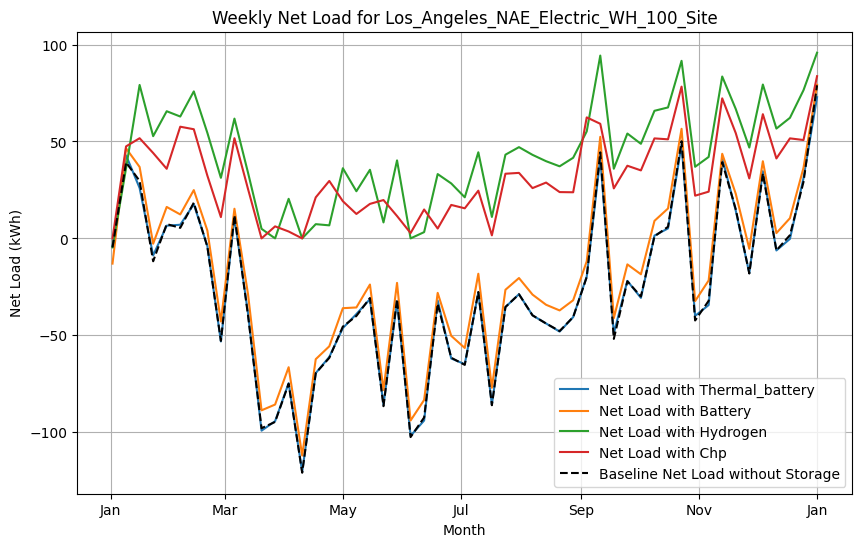

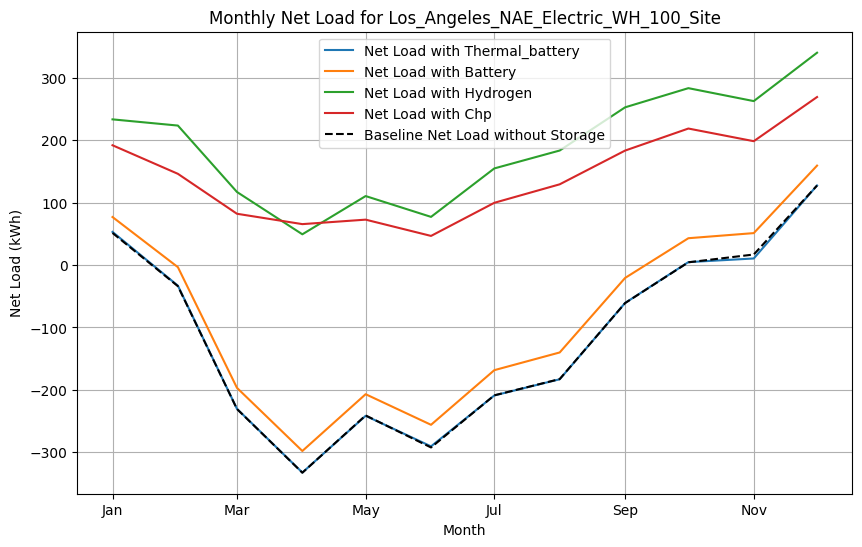

Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_NAE_Gas_WH_100_Site/Thermal_Battery_Results_Los_Angeles_NAE_Gas_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_NAE_Gas_WH_100_Site/Battery_Results_Los_Angeles_NAE_Gas_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_NAE_Gas_WH_100_Site/Hydrogen_Results_Los_Angeles_NAE_Gas_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_NAE_Gas_WH_100_Site/CHP_Results_Los_Angeles_NAE_Gas_WH_100_Site.csv


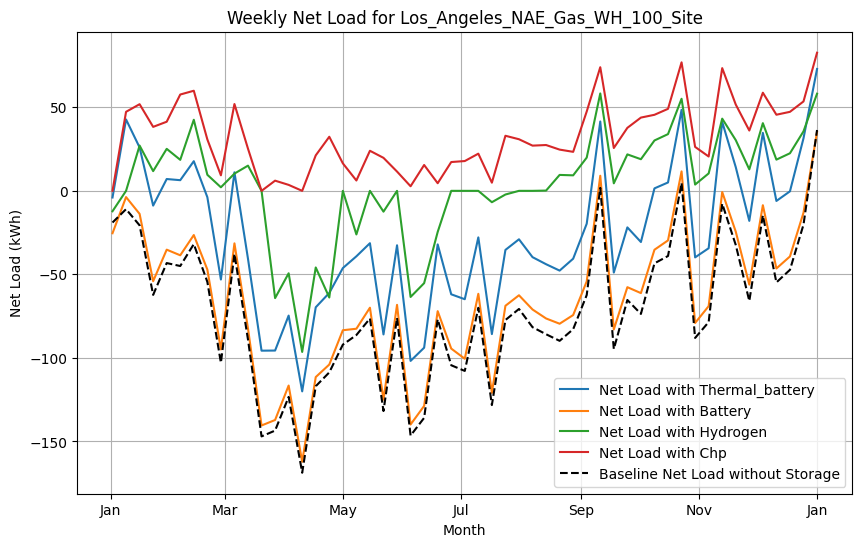

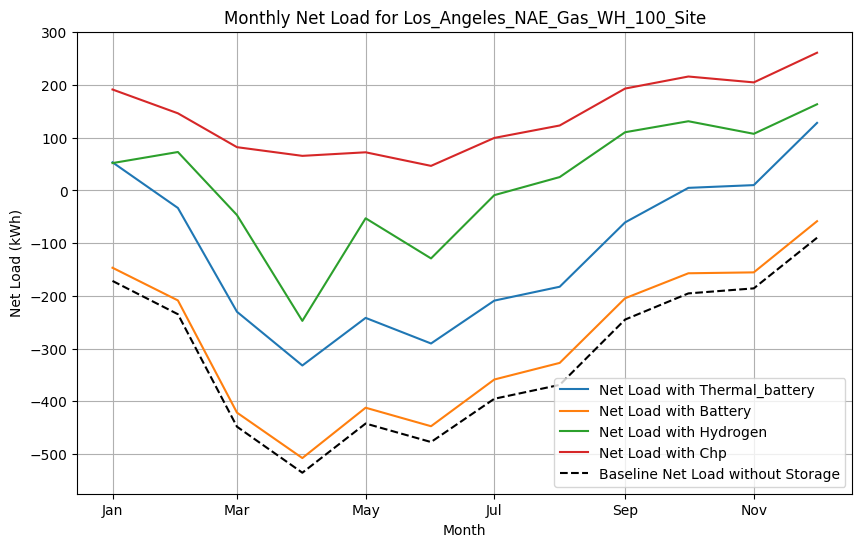

Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_AE_Electric_WH_100_Site/Thermal_Battery_Results_Los_Angeles_AE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_AE_Electric_WH_100_Site/Battery_Results_Los_Angeles_AE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_AE_Electric_WH_100_Site/Hydrogen_Results_Los_Angeles_AE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_AE_Electric_WH_100_Site/CHP_Results_Los_Angeles_AE_Electric_WH_100_Site.csv


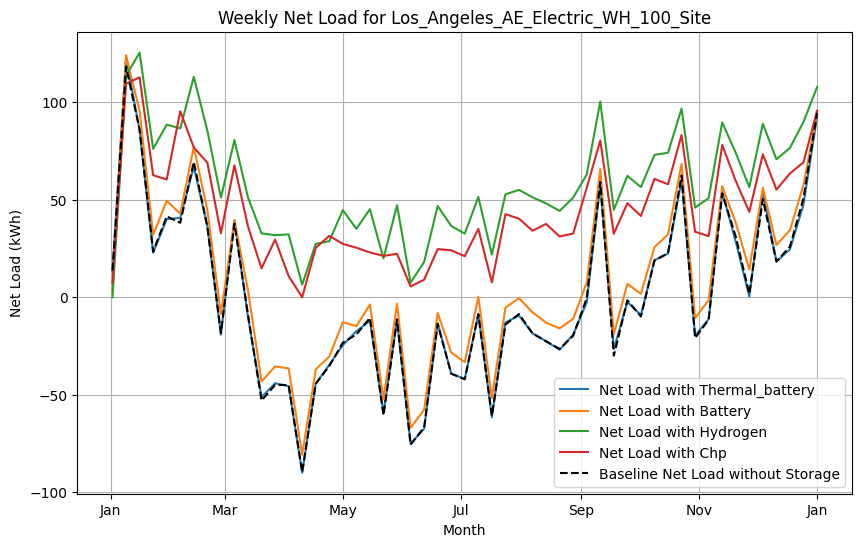

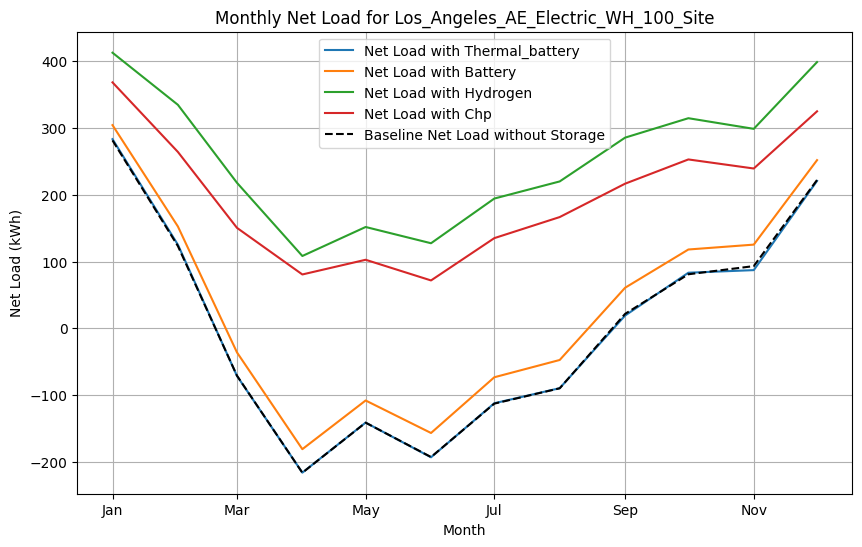

Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_NAE_Electric_WH_100_Site/Thermal_Battery_Results_Los_Angeles_NAE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_NAE_Electric_WH_100_Site/Battery_Results_Los_Angeles_NAE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_NAE_Electric_WH_100_Site/Hydrogen_Results_Los_Angeles_NAE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_NAE_Electric_WH_100_Site/CHP_Results_Los_Angeles_NAE_Electric_WH_100_Site.csv


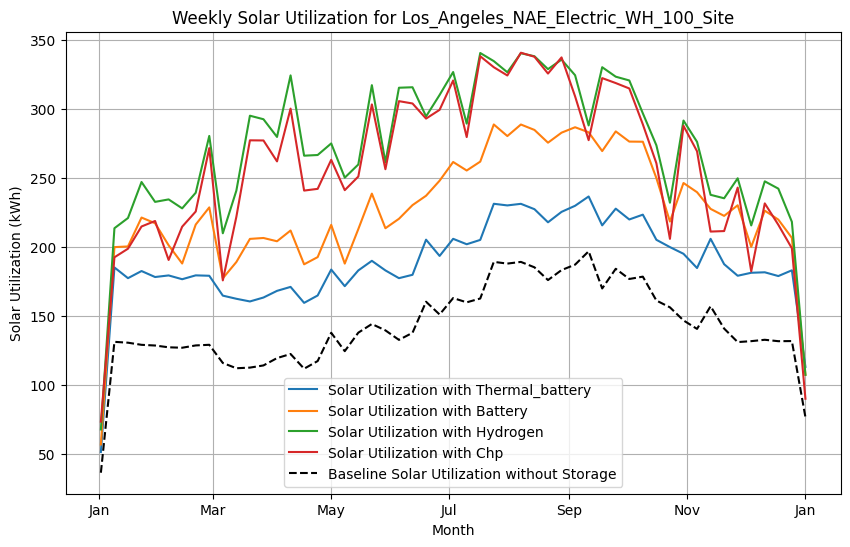

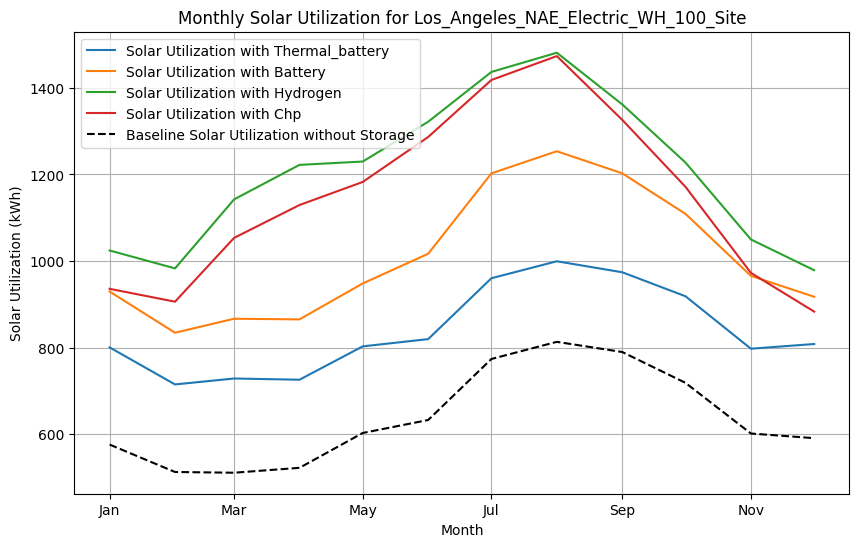

Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_NAE_Gas_WH_100_Site/Thermal_Battery_Results_Los_Angeles_NAE_Gas_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_NAE_Gas_WH_100_Site/Battery_Results_Los_Angeles_NAE_Gas_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_NAE_Gas_WH_100_Site/Hydrogen_Results_Los_Angeles_NAE_Gas_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_NAE_Gas_WH_100_Site/CHP_Results_Los_Angeles_NAE_Gas_WH_100_Site.csv


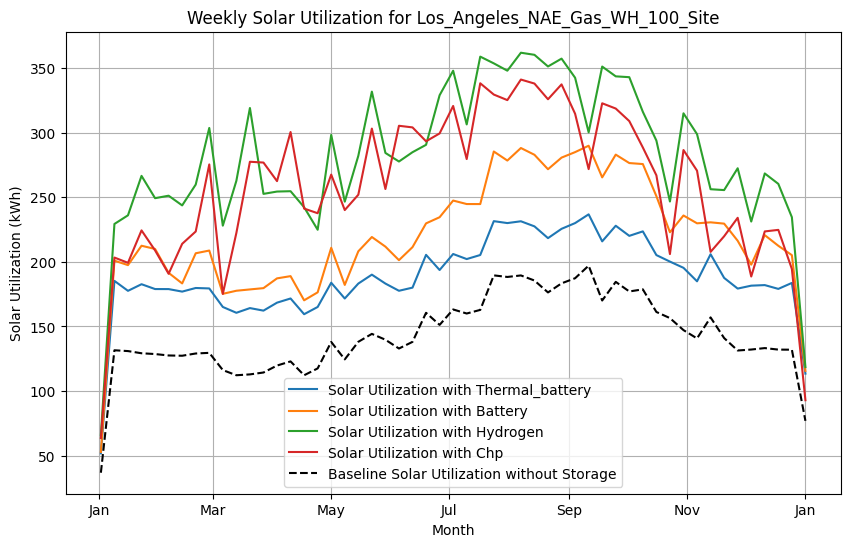

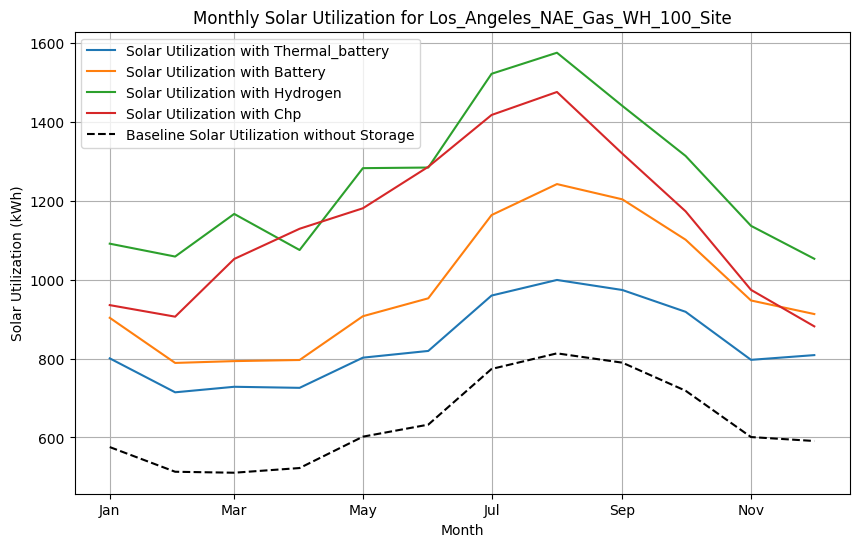

Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_AE_Electric_WH_100_Site/Thermal_Battery_Results_Los_Angeles_AE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_AE_Electric_WH_100_Site/Battery_Results_Los_Angeles_AE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_AE_Electric_WH_100_Site/Hydrogen_Results_Los_Angeles_AE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_AE_Electric_WH_100_Site/CHP_Results_Los_Angeles_AE_Electric_WH_100_Site.csv


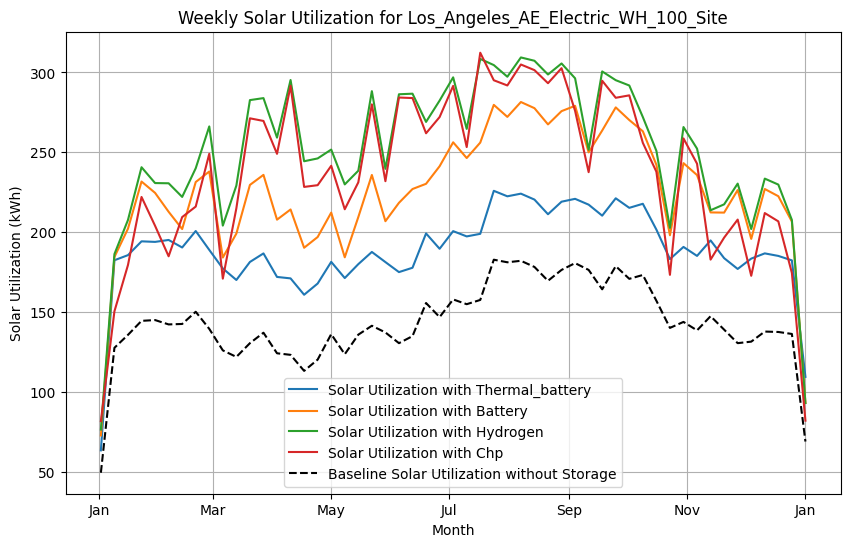

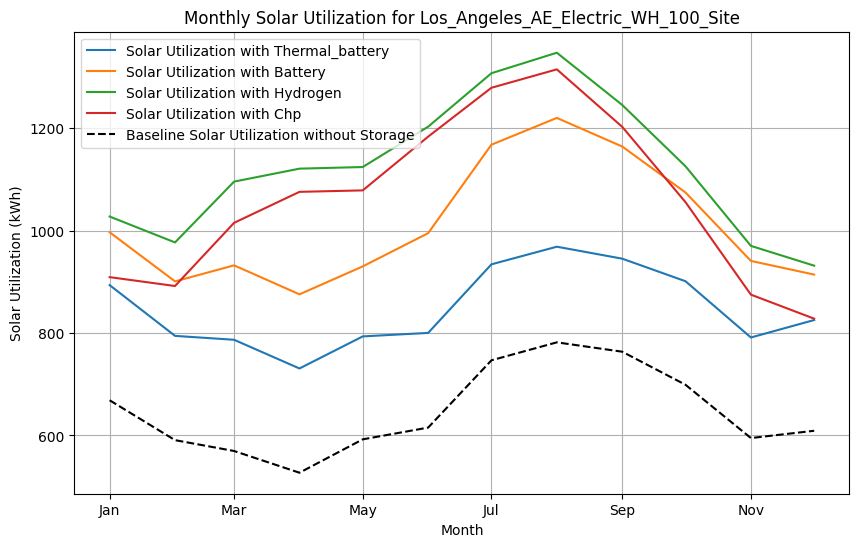

Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_NAE_Electric_WH_100_Site/Thermal_Battery_Results_Los_Angeles_NAE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_NAE_Electric_WH_100_Site/Battery_Results_Los_Angeles_NAE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_NAE_Electric_WH_100_Site/Hydrogen_Results_Los_Angeles_NAE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_NAE_Electric_WH_100_Site/CHP_Results_Los_Angeles_NAE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_NAE_Gas_WH_100_Site/Thermal_Battery_Results_Los_Angeles_NAE_Gas_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_NAE_Gas_WH_100_Site/Battery_Results_Los_Angeles_NAE_Gas_WH_100_Site.csv
Loaded results fr

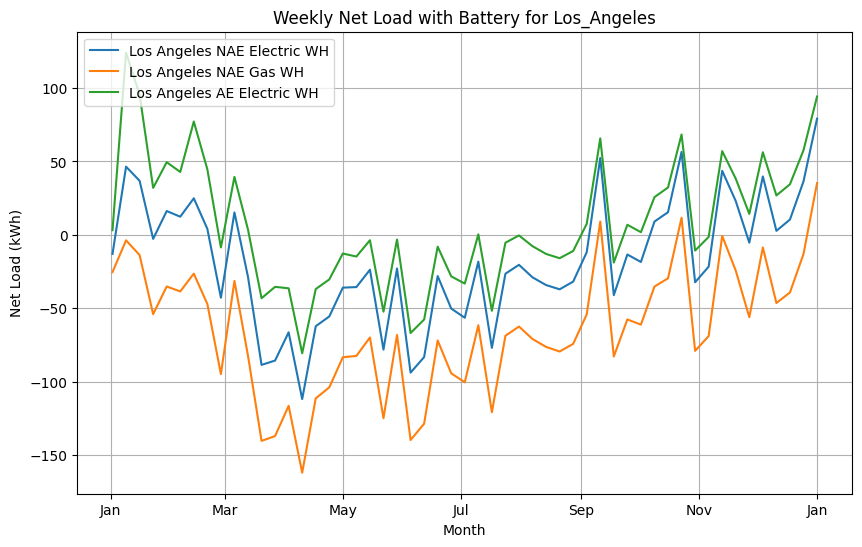

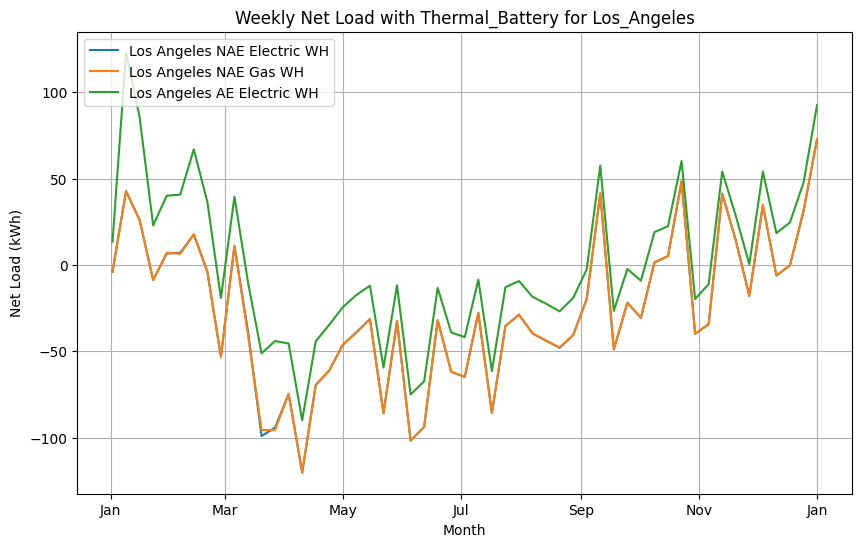

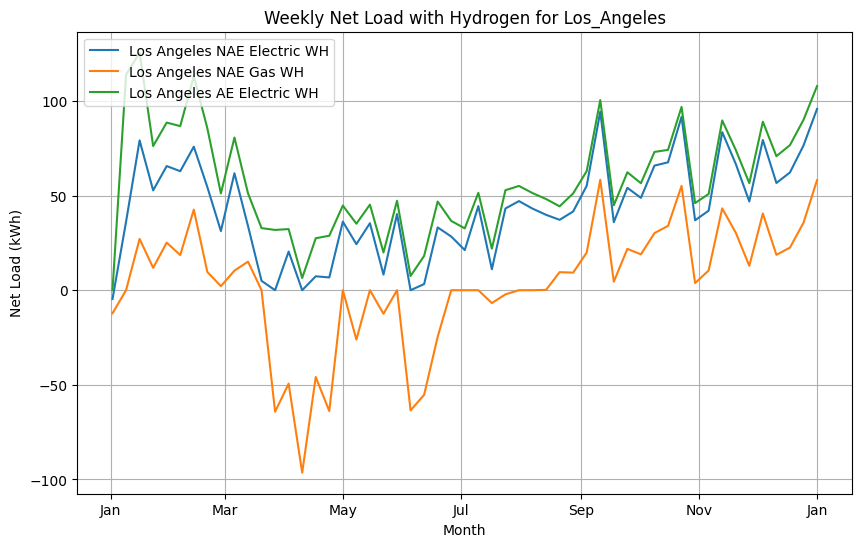

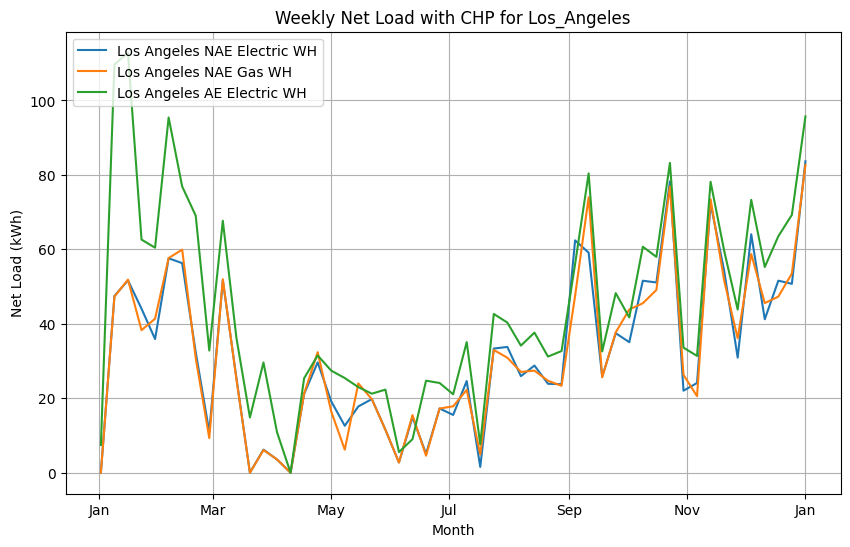

In [ ]:
# Run the analysis for a specific region
plot_net_load_for_all_configs("Los_Angeles")
plot_solar_utilization_for_all_configs("Los_Angeles")
plot_net_load_based_on_storage("Los_Angeles")

# Boulder



## Configuration

In [ ]:
create_default_configs("Boulder")

Configuration Created: Boulder_NAE_Electric_WH_100_Site
Results will be saved in: /content/drive/MyDrive/Thesis/Results/Boulder/Boulder_NAE_Electric_WH_100_Site

Configuration Created: Boulder_NAE_Gas_WH_100_Site
Results will be saved in: /content/drive/MyDrive/Thesis/Results/Boulder/Boulder_NAE_Gas_WH_100_Site

Configuration Created: Boulder_AE_Electric_WH_100_Site
Results will be saved in: /content/drive/MyDrive/Thesis/Results/Boulder/Boulder_AE_Electric_WH_100_Site

Default configurations created for Boulder. Results stored in: /content/drive/MyDrive/Thesis/Results/Boulder
Boulder_NAE_Electric_WH_100_Site
Boulder_NAE_Gas_WH_100_Site
Boulder_AE_Electric_WH_100_Site


## Run Model ("Boulder")


In [ ]:
run_model("Boulder")


Available Configurations for Boulder:
[1] Boulder_NAE_Electric_WH_100_Site
[2] Boulder_NAE_Gas_WH_100_Site
[3] Boulder_AE_Electric_WH_100_Site
Select configuration by index,
type 'all' to run all configurations,
or type multiple indexes separated by commas: all
Do you want to run all models for all configurations? (yes/no): yes

Running all models for configuration: Boulder_NAE_Electric_WH_100_Site


Running Thermal Battery Optimization Model
Loading PV data from: /content/drive/MyDrive/Thesis/Data/Boulder/Boulder PV Watts Hourly kW.csv
Loading load data from: /content/drive/MyDrive/Thesis/Data/Boulder/Boulder_NAE_Electric_WH_Loads.csv
Load Data Columns: Index(['Hours since 00:00 Jan 1', 'My Design - Energy Use:  Total (kBtu)',
       'My Design - Fuel Use:  Electricity: Total (kWh)',
       'My Design - End Use:  Electricity: Hot Water (kWh)'],
      dtype='object')
NZE Solar Array Size: 18.63 kWp
Sized to: Total Site Energy


Thermal Battery Optimization Progress (Fixed Model): 100%|██████████| 8760/8760 [03:41<00:00, 39.48it/s]



Thermal Battery Optimization completed.
Results saved to: /content/drive/MyDrive/Thesis/Results/Boulder/Boulder_NAE_Electric_WH_100_Site/Thermal_Battery_Results_Boulder_NAE_Electric_WH_100_Site.csv


Running Battery Optimization Model
Loading PV data from: /content/drive/MyDrive/Thesis/Data/Boulder/Boulder PV Watts Hourly kW.csv
Loading load data from: /content/drive/MyDrive/Thesis/Data/Boulder/Boulder_NAE_Electric_WH_Loads.csv
Load Data Columns: Index(['Hours since 00:00 Jan 1', 'My Design - Energy Use:  Total (kBtu)',
       'My Design - Fuel Use:  Electricity: Total (kWh)',
       'My Design - End Use:  Electricity: Hot Water (kWh)'],
      dtype='object')
NZE Solar Array Size: 18.63 kWp
Sized to: Total Site Energy


Battery Optimization Progress: 100%|██████████| 365/365 [00:13<00:00, 27.56it/s]



Battery Optimization completed.
Results saved to: /content/drive/MyDrive/Thesis/Results/Boulder/Boulder_NAE_Electric_WH_100_Site/Battery_Results_Boulder_NAE_Electric_WH_100_Site.csv


Running Hydrogen Optimization Model
Loading PV data from: /content/drive/MyDrive/Thesis/Data/Boulder/Boulder PV Watts Hourly kW.csv
Loading load data from: /content/drive/MyDrive/Thesis/Data/Boulder/Boulder_NAE_Electric_WH_Loads.csv
Load Data Columns: Index(['Hours since 00:00 Jan 1', 'My Design - Energy Use:  Total (kBtu)',
       'My Design - Fuel Use:  Electricity: Total (kWh)',
       'My Design - End Use:  Electricity: Hot Water (kWh)'],
      dtype='object')
NZE Solar Array Size: 18.63 kWp
Sized to: Total Site Energy


Hydrogen Optimization Progress: 100%|██████████| 365/365 [00:12<00:00, 28.48it/s]



Hydrogen Optimization completed.
Results saved to: /content/drive/MyDrive/Thesis/Results/Boulder/Boulder_NAE_Electric_WH_100_Site/Hydrogen_Results_Boulder_NAE_Electric_WH_100_Site.csv


Running CHP Optimization Model
Loading PV data from: /content/drive/MyDrive/Thesis/Data/Boulder/Boulder PV Watts Hourly kW.csv
Loading load data from: /content/drive/MyDrive/Thesis/Data/Boulder/Boulder_NAE_Electric_WH_Loads.csv
Load Data Columns: Index(['Hours since 00:00 Jan 1', 'My Design - Energy Use:  Total (kBtu)',
       'My Design - Fuel Use:  Electricity: Total (kWh)',
       'My Design - End Use:  Electricity: Hot Water (kWh)'],
      dtype='object')
NZE Solar Array Size: 18.63 kWp
Sized to: Total Site Energy


CHP Optimization Progress: 100%|██████████| 37/37 [00:05<00:00,  6.62it/s]



CHP Optimization completed.
Results saved to: /content/drive/MyDrive/Thesis/Results/Boulder/Boulder_NAE_Electric_WH_100_Site/CHP_Results_Boulder_NAE_Electric_WH_100_Site.csv


Running all models for configuration: Boulder_NAE_Gas_WH_100_Site


Running Thermal Battery Optimization Model
Loading PV data from: /content/drive/MyDrive/Thesis/Data/Boulder/Boulder PV Watts Hourly kW.csv
Loading load data from: /content/drive/MyDrive/Thesis/Data/Boulder/Boulder_NAE_Gas_WH_Loads.csv
Load Data Columns: Index(['Hours since 00:00 Jan 1', 'My Design - Energy Use:  Total (kBtu)',
       'My Design - Fuel Use:  Electricity: Total (kWh)',
       'My Design - End Use:  Natural Gas: Hot Water (kBtu)'],
      dtype='object')
NZE Solar Array Size: 18.63 kWp
Sized to: Total Site Energy


Thermal Battery Optimization Progress (Fixed Model): 100%|██████████| 8760/8760 [03:39<00:00, 39.94it/s]



Thermal Battery Optimization completed.
Results saved to: /content/drive/MyDrive/Thesis/Results/Boulder/Boulder_NAE_Gas_WH_100_Site/Thermal_Battery_Results_Boulder_NAE_Gas_WH_100_Site.csv


Running Battery Optimization Model
Loading PV data from: /content/drive/MyDrive/Thesis/Data/Boulder/Boulder PV Watts Hourly kW.csv
Loading load data from: /content/drive/MyDrive/Thesis/Data/Boulder/Boulder_NAE_Gas_WH_Loads.csv
Load Data Columns: Index(['Hours since 00:00 Jan 1', 'My Design - Energy Use:  Total (kBtu)',
       'My Design - Fuel Use:  Electricity: Total (kWh)',
       'My Design - End Use:  Natural Gas: Hot Water (kBtu)'],
      dtype='object')
NZE Solar Array Size: 18.63 kWp
Sized to: Total Site Energy


Battery Optimization Progress: 100%|██████████| 365/365 [00:12<00:00, 28.17it/s]



Battery Optimization completed.
Results saved to: /content/drive/MyDrive/Thesis/Results/Boulder/Boulder_NAE_Gas_WH_100_Site/Battery_Results_Boulder_NAE_Gas_WH_100_Site.csv


Running Hydrogen Optimization Model
Loading PV data from: /content/drive/MyDrive/Thesis/Data/Boulder/Boulder PV Watts Hourly kW.csv
Loading load data from: /content/drive/MyDrive/Thesis/Data/Boulder/Boulder_NAE_Gas_WH_Loads.csv
Load Data Columns: Index(['Hours since 00:00 Jan 1', 'My Design - Energy Use:  Total (kBtu)',
       'My Design - Fuel Use:  Electricity: Total (kWh)',
       'My Design - End Use:  Natural Gas: Hot Water (kBtu)'],
      dtype='object')
NZE Solar Array Size: 18.63 kWp
Sized to: Total Site Energy


Hydrogen Optimization Progress: 100%|██████████| 365/365 [00:12<00:00, 28.95it/s]



Hydrogen Optimization completed.
Results saved to: /content/drive/MyDrive/Thesis/Results/Boulder/Boulder_NAE_Gas_WH_100_Site/Hydrogen_Results_Boulder_NAE_Gas_WH_100_Site.csv


Running CHP Optimization Model
Loading PV data from: /content/drive/MyDrive/Thesis/Data/Boulder/Boulder PV Watts Hourly kW.csv
Loading load data from: /content/drive/MyDrive/Thesis/Data/Boulder/Boulder_NAE_Gas_WH_Loads.csv
Load Data Columns: Index(['Hours since 00:00 Jan 1', 'My Design - Energy Use:  Total (kBtu)',
       'My Design - Fuel Use:  Electricity: Total (kWh)',
       'My Design - End Use:  Natural Gas: Hot Water (kBtu)'],
      dtype='object')
NZE Solar Array Size: 18.63 kWp
Sized to: Total Site Energy


CHP Optimization Progress: 100%|██████████| 37/37 [00:05<00:00,  6.61it/s]



CHP Optimization completed.
Results saved to: /content/drive/MyDrive/Thesis/Results/Boulder/Boulder_NAE_Gas_WH_100_Site/CHP_Results_Boulder_NAE_Gas_WH_100_Site.csv


Running all models for configuration: Boulder_AE_Electric_WH_100_Site


Running Thermal Battery Optimization Model
Loading PV data from: /content/drive/MyDrive/Thesis/Data/Boulder/Boulder PV Watts Hourly kW.csv
Loading load data from: /content/drive/MyDrive/Thesis/Data/Boulder/Boulder_AE_Electric_WH_Loads.csv
Load Data Columns: Index(['Hours since 00:00 Jan 1', 'My Design - Energy Use:  Total (kBtu)',
       'My Design - Fuel Use:  Electricity: Total (kWh)',
       'My Design - End Use:  Electricity: Hot Water (kWh)'],
      dtype='object')
NZE Solar Array Size: 11.93 kWp
Sized to: Total Site Energy


Thermal Battery Optimization Progress (Fixed Model): 100%|██████████| 8760/8760 [03:35<00:00, 40.57it/s]



Thermal Battery Optimization completed.
Results saved to: /content/drive/MyDrive/Thesis/Results/Boulder/Boulder_AE_Electric_WH_100_Site/Thermal_Battery_Results_Boulder_AE_Electric_WH_100_Site.csv


Running Battery Optimization Model
Loading PV data from: /content/drive/MyDrive/Thesis/Data/Boulder/Boulder PV Watts Hourly kW.csv
Loading load data from: /content/drive/MyDrive/Thesis/Data/Boulder/Boulder_AE_Electric_WH_Loads.csv
Load Data Columns: Index(['Hours since 00:00 Jan 1', 'My Design - Energy Use:  Total (kBtu)',
       'My Design - Fuel Use:  Electricity: Total (kWh)',
       'My Design - End Use:  Electricity: Hot Water (kWh)'],
      dtype='object')
NZE Solar Array Size: 11.93 kWp
Sized to: Total Site Energy


Battery Optimization Progress: 100%|██████████| 365/365 [00:13<00:00, 27.71it/s]



Battery Optimization completed.
Results saved to: /content/drive/MyDrive/Thesis/Results/Boulder/Boulder_AE_Electric_WH_100_Site/Battery_Results_Boulder_AE_Electric_WH_100_Site.csv


Running Hydrogen Optimization Model
Loading PV data from: /content/drive/MyDrive/Thesis/Data/Boulder/Boulder PV Watts Hourly kW.csv
Loading load data from: /content/drive/MyDrive/Thesis/Data/Boulder/Boulder_AE_Electric_WH_Loads.csv
Load Data Columns: Index(['Hours since 00:00 Jan 1', 'My Design - Energy Use:  Total (kBtu)',
       'My Design - Fuel Use:  Electricity: Total (kWh)',
       'My Design - End Use:  Electricity: Hot Water (kWh)'],
      dtype='object')
NZE Solar Array Size: 11.93 kWp
Sized to: Total Site Energy


Hydrogen Optimization Progress: 100%|██████████| 365/365 [00:12<00:00, 29.14it/s]



Hydrogen Optimization completed.
Results saved to: /content/drive/MyDrive/Thesis/Results/Boulder/Boulder_AE_Electric_WH_100_Site/Hydrogen_Results_Boulder_AE_Electric_WH_100_Site.csv


Running CHP Optimization Model
Loading PV data from: /content/drive/MyDrive/Thesis/Data/Boulder/Boulder PV Watts Hourly kW.csv
Loading load data from: /content/drive/MyDrive/Thesis/Data/Boulder/Boulder_AE_Electric_WH_Loads.csv
Load Data Columns: Index(['Hours since 00:00 Jan 1', 'My Design - Energy Use:  Total (kBtu)',
       'My Design - Fuel Use:  Electricity: Total (kWh)',
       'My Design - End Use:  Electricity: Hot Water (kWh)'],
      dtype='object')
NZE Solar Array Size: 11.93 kWp
Sized to: Total Site Energy


CHP Optimization Progress: 100%|██████████| 37/37 [00:05<00:00,  6.47it/s]



CHP Optimization completed.
Results saved to: /content/drive/MyDrive/Thesis/Results/Boulder/Boulder_AE_Electric_WH_100_Site/CHP_Results_Boulder_AE_Electric_WH_100_Site.csv



## Analysis

In [ ]:
# Run the analysis for a specific region
plot_net_load_for_all_configs("Los_Angeles")

NameError: name 'plot_net_load_for_all_configs' is not defined

In [ ]:
plot_solar_utilization_for_all_configs("Los_Angeles")

NameError: name 'plot_solar_utilization_for_all_configs' is not defined

In [ ]:
plot_net_load_based_on_storage("Los_Angeles")

# Chicago


## Configuration

In [ ]:
create_default_configs("Chicago")

Configuration Created: Chicago_NAE_Electric_WH_100_Site
Results will be saved in: /content/drive/MyDrive/Thesis/Results/Chicago/Chicago_NAE_Electric_WH_100_Site

Configuration Created: Chicago_NAE_Gas_WH_100_Site
Results will be saved in: /content/drive/MyDrive/Thesis/Results/Chicago/Chicago_NAE_Gas_WH_100_Site

Configuration Created: Chicago_AE_Electric_WH_100_Site
Results will be saved in: /content/drive/MyDrive/Thesis/Results/Chicago/Chicago_AE_Electric_WH_100_Site

Default configurations created for Chicago. Results stored in: /content/drive/MyDrive/Thesis/Results/Chicago
Chicago_NAE_Electric_WH_100_Site
Chicago_NAE_Gas_WH_100_Site
Chicago_AE_Electric_WH_100_Site


## Run Model ("Chicago")

In [ ]:
run_model("Chicago")


Available Configurations for Chicago:
[1] Chicago_NAE_Electric_WH_100_Site
[2] Chicago_NAE_Gas_WH_100_Site
[3] Chicago_AE_Electric_WH_100_Site
Select configuration by index,
type 'all' to run all configurations,
or type multiple indexes separated by commas: all
Do you want to run all models for all configurations? (yes/no): yes

Running all models for configuration: Chicago_NAE_Electric_WH_100_Site


Running Thermal Battery Optimization Model
Loading PV data from: /content/drive/MyDrive/Thesis/Data/Chicago/Chicago PV Watts Hourly kW.csv
Loading load data from: /content/drive/MyDrive/Thesis/Data/Chicago/Chicago_NAE_Electric_WH_Loads.csv
Load Data Columns: Index(['Hours since 00:00 Jan 1', 'My Design - Energy Use:  Total (kBtu)',
       'My Design - Fuel Use:  Electricity: Total (kWh)',
       'My Design - End Use:  Electricity: Hot Water (kWh)'],
      dtype='object')
NZE Solar Array Size: 25.39 kWp
Sized to: Total Site Energy


Thermal Battery Optimization Progress (Fixed Model): 100%|██████████| 8760/8760 [04:38<00:00, 31.40it/s]



Thermal Battery Optimization completed.
Results saved to: /content/drive/MyDrive/Thesis/Results/Chicago/Chicago_NAE_Electric_WH_100_Site/Thermal_Battery_Results_Chicago_NAE_Electric_WH_100_Site.csv


Running Battery Optimization Model
Loading PV data from: /content/drive/MyDrive/Thesis/Data/Chicago/Chicago PV Watts Hourly kW.csv
Loading load data from: /content/drive/MyDrive/Thesis/Data/Chicago/Chicago_NAE_Electric_WH_Loads.csv
Load Data Columns: Index(['Hours since 00:00 Jan 1', 'My Design - Energy Use:  Total (kBtu)',
       'My Design - Fuel Use:  Electricity: Total (kWh)',
       'My Design - End Use:  Electricity: Hot Water (kWh)'],
      dtype='object')
NZE Solar Array Size: 25.39 kWp
Sized to: Total Site Energy


Battery Optimization Progress: 100%|██████████| 365/365 [00:14<00:00, 24.96it/s]



Battery Optimization completed.
Results saved to: /content/drive/MyDrive/Thesis/Results/Chicago/Chicago_NAE_Electric_WH_100_Site/Battery_Results_Chicago_NAE_Electric_WH_100_Site.csv


Running Hydrogen Optimization Model
Loading PV data from: /content/drive/MyDrive/Thesis/Data/Chicago/Chicago PV Watts Hourly kW.csv
Loading load data from: /content/drive/MyDrive/Thesis/Data/Chicago/Chicago_NAE_Electric_WH_Loads.csv
Load Data Columns: Index(['Hours since 00:00 Jan 1', 'My Design - Energy Use:  Total (kBtu)',
       'My Design - Fuel Use:  Electricity: Total (kWh)',
       'My Design - End Use:  Electricity: Hot Water (kWh)'],
      dtype='object')
NZE Solar Array Size: 25.39 kWp
Sized to: Total Site Energy


Hydrogen Optimization Progress: 100%|██████████| 365/365 [00:14<00:00, 26.05it/s]



Hydrogen Optimization completed.
Results saved to: /content/drive/MyDrive/Thesis/Results/Chicago/Chicago_NAE_Electric_WH_100_Site/Hydrogen_Results_Chicago_NAE_Electric_WH_100_Site.csv


Running CHP Optimization Model
Loading PV data from: /content/drive/MyDrive/Thesis/Data/Chicago/Chicago PV Watts Hourly kW.csv
Loading load data from: /content/drive/MyDrive/Thesis/Data/Chicago/Chicago_NAE_Electric_WH_Loads.csv
Load Data Columns: Index(['Hours since 00:00 Jan 1', 'My Design - Energy Use:  Total (kBtu)',
       'My Design - Fuel Use:  Electricity: Total (kWh)',
       'My Design - End Use:  Electricity: Hot Water (kWh)'],
      dtype='object')
NZE Solar Array Size: 25.39 kWp
Sized to: Total Site Energy


CHP Optimization Progress: 100%|██████████| 37/37 [00:06<00:00,  6.03it/s]



CHP Optimization completed.
Results saved to: /content/drive/MyDrive/Thesis/Results/Chicago/Chicago_NAE_Electric_WH_100_Site/CHP_Results_Chicago_NAE_Electric_WH_100_Site.csv


Running all models for configuration: Chicago_NAE_Gas_WH_100_Site


Running Thermal Battery Optimization Model
Loading PV data from: /content/drive/MyDrive/Thesis/Data/Chicago/Chicago PV Watts Hourly kW.csv
Loading load data from: /content/drive/MyDrive/Thesis/Data/Chicago/Chicago_NAE_Gas_WH_Loads.csv
Load Data Columns: Index(['Hours since 00:00 Jan 1', 'My Design - Energy Use:  Total (kBtu)',
       'My Design - Fuel Use:  Electricity: Total (kWh)',
       'My Design - End Use:  Natural Gas: Hot Water (kBtu)'],
      dtype='object')
NZE Solar Array Size: 25.39 kWp
Sized to: Total Site Energy


Thermal Battery Optimization Progress (Fixed Model): 100%|██████████| 8760/8760 [03:58<00:00, 36.71it/s]



Thermal Battery Optimization completed.
Results saved to: /content/drive/MyDrive/Thesis/Results/Chicago/Chicago_NAE_Gas_WH_100_Site/Thermal_Battery_Results_Chicago_NAE_Gas_WH_100_Site.csv


Running Battery Optimization Model
Loading PV data from: /content/drive/MyDrive/Thesis/Data/Chicago/Chicago PV Watts Hourly kW.csv
Loading load data from: /content/drive/MyDrive/Thesis/Data/Chicago/Chicago_NAE_Gas_WH_Loads.csv
Load Data Columns: Index(['Hours since 00:00 Jan 1', 'My Design - Energy Use:  Total (kBtu)',
       'My Design - Fuel Use:  Electricity: Total (kWh)',
       'My Design - End Use:  Natural Gas: Hot Water (kBtu)'],
      dtype='object')
NZE Solar Array Size: 25.39 kWp
Sized to: Total Site Energy


Battery Optimization Progress: 100%|██████████| 365/365 [00:14<00:00, 25.70it/s]



Battery Optimization completed.
Results saved to: /content/drive/MyDrive/Thesis/Results/Chicago/Chicago_NAE_Gas_WH_100_Site/Battery_Results_Chicago_NAE_Gas_WH_100_Site.csv


Running Hydrogen Optimization Model
Loading PV data from: /content/drive/MyDrive/Thesis/Data/Chicago/Chicago PV Watts Hourly kW.csv
Loading load data from: /content/drive/MyDrive/Thesis/Data/Chicago/Chicago_NAE_Gas_WH_Loads.csv
Load Data Columns: Index(['Hours since 00:00 Jan 1', 'My Design - Energy Use:  Total (kBtu)',
       'My Design - Fuel Use:  Electricity: Total (kWh)',
       'My Design - End Use:  Natural Gas: Hot Water (kBtu)'],
      dtype='object')
NZE Solar Array Size: 25.39 kWp
Sized to: Total Site Energy


Hydrogen Optimization Progress: 100%|██████████| 365/365 [00:13<00:00, 26.69it/s]



Hydrogen Optimization completed.
Results saved to: /content/drive/MyDrive/Thesis/Results/Chicago/Chicago_NAE_Gas_WH_100_Site/Hydrogen_Results_Chicago_NAE_Gas_WH_100_Site.csv


Running CHP Optimization Model
Loading PV data from: /content/drive/MyDrive/Thesis/Data/Chicago/Chicago PV Watts Hourly kW.csv
Loading load data from: /content/drive/MyDrive/Thesis/Data/Chicago/Chicago_NAE_Gas_WH_Loads.csv
Load Data Columns: Index(['Hours since 00:00 Jan 1', 'My Design - Energy Use:  Total (kBtu)',
       'My Design - Fuel Use:  Electricity: Total (kWh)',
       'My Design - End Use:  Natural Gas: Hot Water (kBtu)'],
      dtype='object')
NZE Solar Array Size: 25.39 kWp
Sized to: Total Site Energy


CHP Optimization Progress: 100%|██████████| 37/37 [00:08<00:00,  4.52it/s]



CHP Optimization completed.
Results saved to: /content/drive/MyDrive/Thesis/Results/Chicago/Chicago_NAE_Gas_WH_100_Site/CHP_Results_Chicago_NAE_Gas_WH_100_Site.csv


Running all models for configuration: Chicago_AE_Electric_WH_100_Site


Running Thermal Battery Optimization Model
Loading PV data from: /content/drive/MyDrive/Thesis/Data/Chicago/Chicago PV Watts Hourly kW.csv
Loading load data from: /content/drive/MyDrive/Thesis/Data/Chicago/Chicago_AE_Electric_WH_Loads.csv
Load Data Columns: Index(['Hours since 00:00 Jan 1', 'My Design - Energy Use:  Total (kBtu)',
       'My Design - Fuel Use:  Electricity: Total (kWh)',
       'My Design - End Use:  Electricity: Hot Water (kWh)'],
      dtype='object')
NZE Solar Array Size: 17.67 kWp
Sized to: Total Site Energy


Thermal Battery Optimization Progress (Fixed Model): 100%|██████████| 8760/8760 [04:05<00:00, 35.72it/s]



Thermal Battery Optimization completed.
Results saved to: /content/drive/MyDrive/Thesis/Results/Chicago/Chicago_AE_Electric_WH_100_Site/Thermal_Battery_Results_Chicago_AE_Electric_WH_100_Site.csv


Running Battery Optimization Model
Loading PV data from: /content/drive/MyDrive/Thesis/Data/Chicago/Chicago PV Watts Hourly kW.csv
Loading load data from: /content/drive/MyDrive/Thesis/Data/Chicago/Chicago_AE_Electric_WH_Loads.csv
Load Data Columns: Index(['Hours since 00:00 Jan 1', 'My Design - Energy Use:  Total (kBtu)',
       'My Design - Fuel Use:  Electricity: Total (kWh)',
       'My Design - End Use:  Electricity: Hot Water (kWh)'],
      dtype='object')
NZE Solar Array Size: 17.67 kWp
Sized to: Total Site Energy


Battery Optimization Progress: 100%|██████████| 365/365 [00:13<00:00, 26.64it/s]



Battery Optimization completed.
Results saved to: /content/drive/MyDrive/Thesis/Results/Chicago/Chicago_AE_Electric_WH_100_Site/Battery_Results_Chicago_AE_Electric_WH_100_Site.csv


Running Hydrogen Optimization Model
Loading PV data from: /content/drive/MyDrive/Thesis/Data/Chicago/Chicago PV Watts Hourly kW.csv
Loading load data from: /content/drive/MyDrive/Thesis/Data/Chicago/Chicago_AE_Electric_WH_Loads.csv
Load Data Columns: Index(['Hours since 00:00 Jan 1', 'My Design - Energy Use:  Total (kBtu)',
       'My Design - Fuel Use:  Electricity: Total (kWh)',
       'My Design - End Use:  Electricity: Hot Water (kWh)'],
      dtype='object')
NZE Solar Array Size: 17.67 kWp
Sized to: Total Site Energy


Hydrogen Optimization Progress: 100%|██████████| 365/365 [00:14<00:00, 25.49it/s]



Hydrogen Optimization completed.
Results saved to: /content/drive/MyDrive/Thesis/Results/Chicago/Chicago_AE_Electric_WH_100_Site/Hydrogen_Results_Chicago_AE_Electric_WH_100_Site.csv


Running CHP Optimization Model
Loading PV data from: /content/drive/MyDrive/Thesis/Data/Chicago/Chicago PV Watts Hourly kW.csv
Loading load data from: /content/drive/MyDrive/Thesis/Data/Chicago/Chicago_AE_Electric_WH_Loads.csv
Load Data Columns: Index(['Hours since 00:00 Jan 1', 'My Design - Energy Use:  Total (kBtu)',
       'My Design - Fuel Use:  Electricity: Total (kWh)',
       'My Design - End Use:  Electricity: Hot Water (kWh)'],
      dtype='object')
NZE Solar Array Size: 17.67 kWp
Sized to: Total Site Energy


CHP Optimization Progress: 100%|██████████| 37/37 [00:07<00:00,  4.68it/s]



CHP Optimization completed.
Results saved to: /content/drive/MyDrive/Thesis/Results/Chicago/Chicago_AE_Electric_WH_100_Site/CHP_Results_Chicago_AE_Electric_WH_100_Site.csv



## Analysis

Loaded results from: /content/drive/MyDrive/Thesis/Results/Chicago/Chicago_NAE_Electric_WH_100_Site/Thermal_Battery_Results_Chicago_NAE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Chicago/Chicago_NAE_Electric_WH_100_Site/Battery_Results_Chicago_NAE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Chicago/Chicago_NAE_Electric_WH_100_Site/Hydrogen_Results_Chicago_NAE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Chicago/Chicago_NAE_Electric_WH_100_Site/CHP_Results_Chicago_NAE_Electric_WH_100_Site.csv


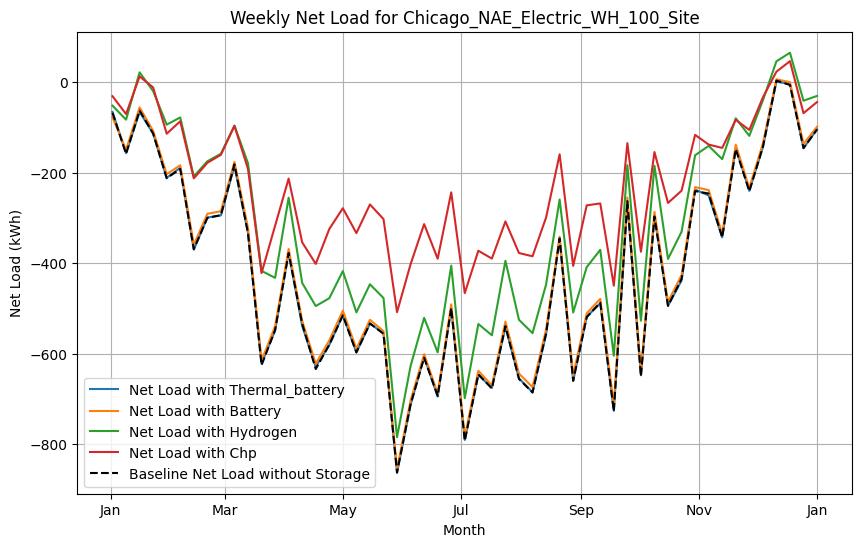

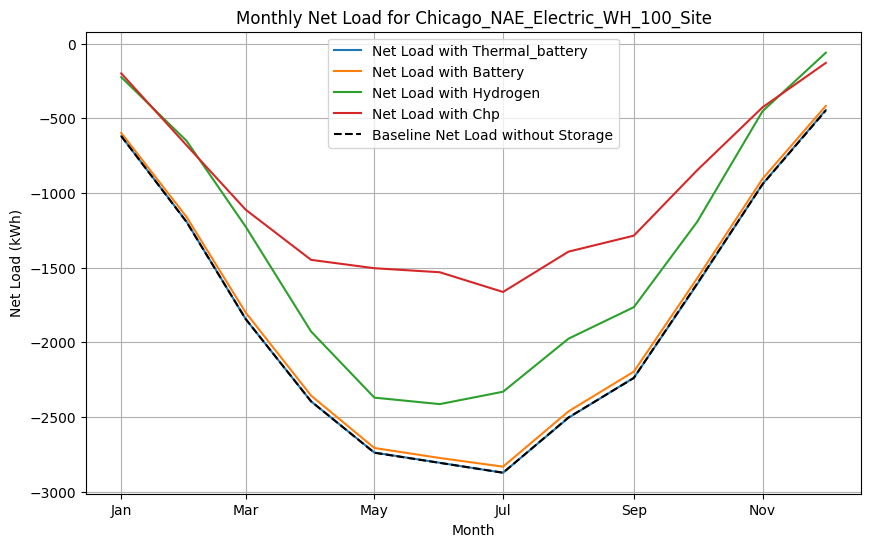

Loaded results from: /content/drive/MyDrive/Thesis/Results/Chicago/Chicago_NAE_Gas_WH_100_Site/Thermal_Battery_Results_Chicago_NAE_Gas_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Chicago/Chicago_NAE_Gas_WH_100_Site/Battery_Results_Chicago_NAE_Gas_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Chicago/Chicago_NAE_Gas_WH_100_Site/Hydrogen_Results_Chicago_NAE_Gas_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Chicago/Chicago_NAE_Gas_WH_100_Site/CHP_Results_Chicago_NAE_Gas_WH_100_Site.csv


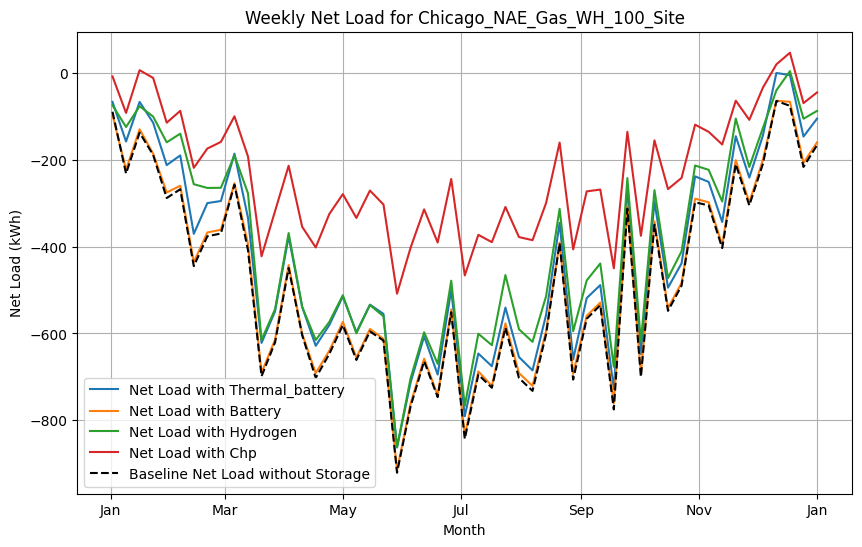

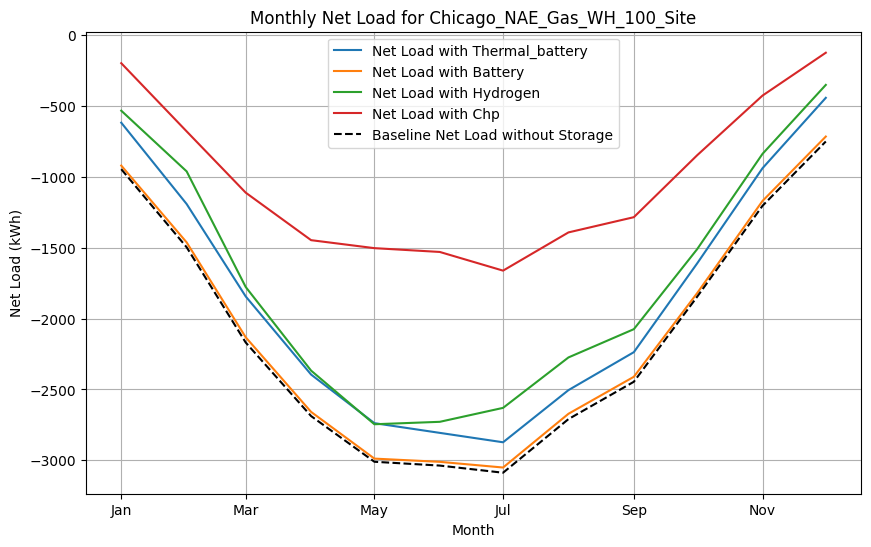

Loaded results from: /content/drive/MyDrive/Thesis/Results/Chicago/Chicago_AE_Electric_WH_100_Site/Thermal_Battery_Results_Chicago_AE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Chicago/Chicago_AE_Electric_WH_100_Site/Battery_Results_Chicago_AE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Chicago/Chicago_AE_Electric_WH_100_Site/Hydrogen_Results_Chicago_AE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Chicago/Chicago_AE_Electric_WH_100_Site/CHP_Results_Chicago_AE_Electric_WH_100_Site.csv


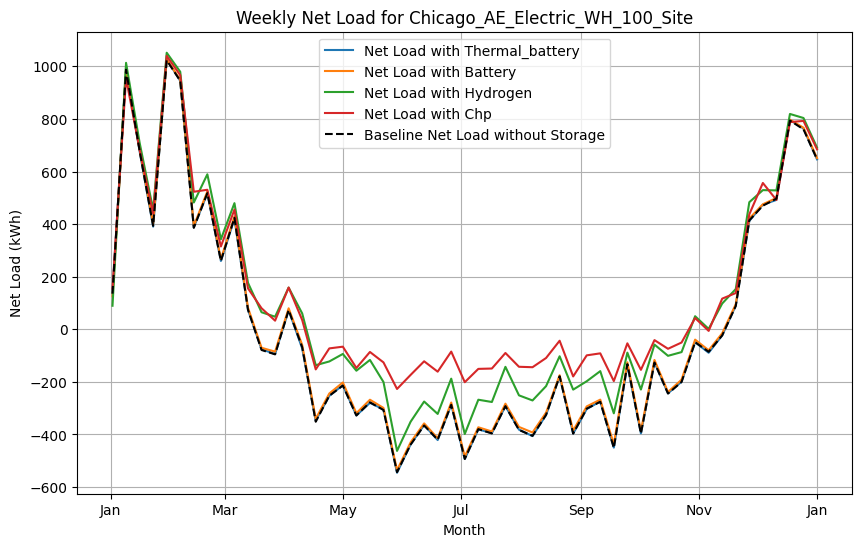

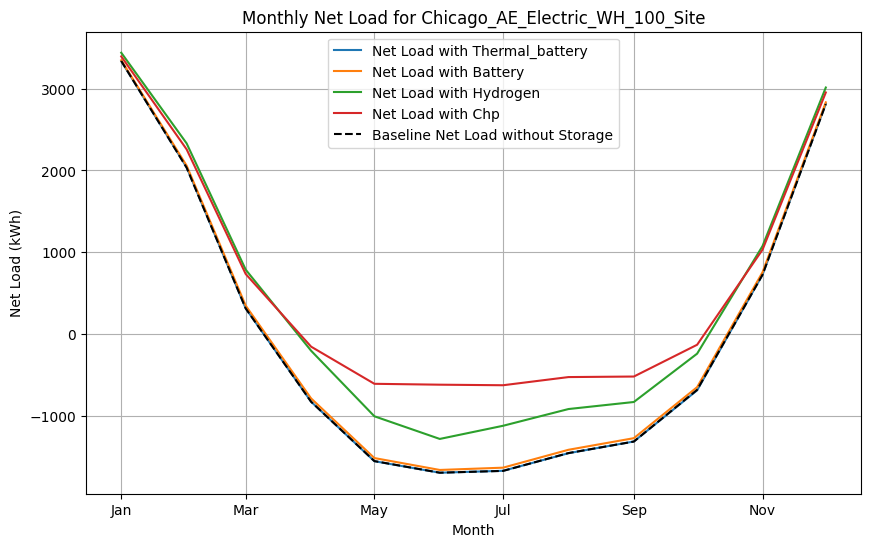

In [ ]:
# Run the analysis for a specific region
plot_net_load_for_all_configs("Chicago")

Loaded results from: /content/drive/MyDrive/Thesis/Results/Chicago/Chicago_NAE_Electric_WH_100_Site/Thermal_Battery_Results_Chicago_NAE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Chicago/Chicago_NAE_Electric_WH_100_Site/Battery_Results_Chicago_NAE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Chicago/Chicago_NAE_Electric_WH_100_Site/Hydrogen_Results_Chicago_NAE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Chicago/Chicago_NAE_Electric_WH_100_Site/CHP_Results_Chicago_NAE_Electric_WH_100_Site.csv


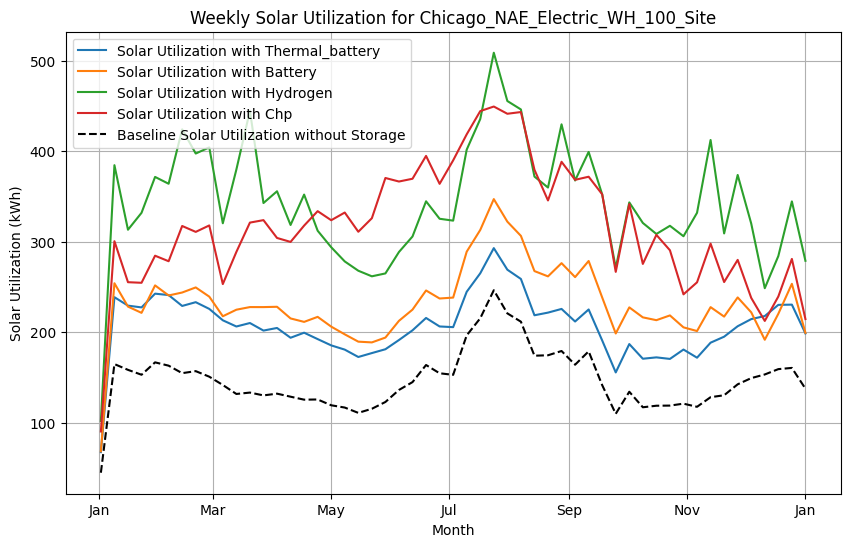

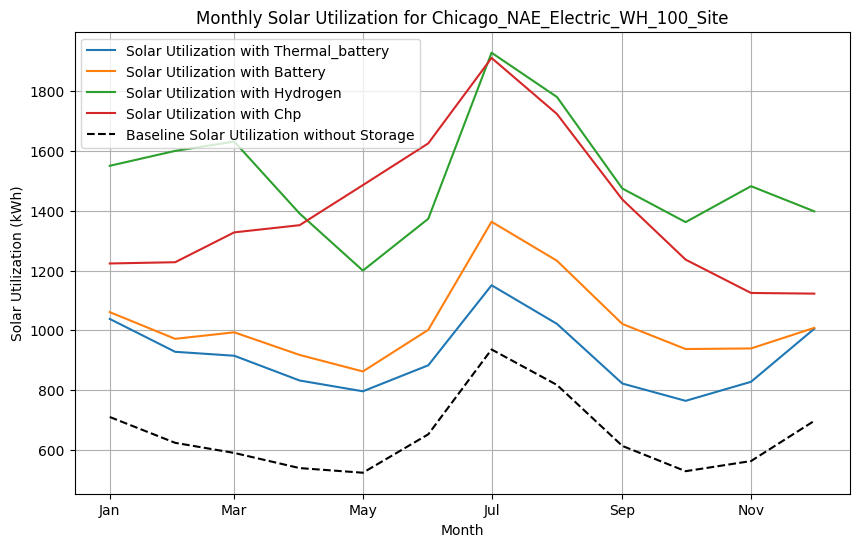

Loaded results from: /content/drive/MyDrive/Thesis/Results/Chicago/Chicago_NAE_Gas_WH_100_Site/Thermal_Battery_Results_Chicago_NAE_Gas_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Chicago/Chicago_NAE_Gas_WH_100_Site/Battery_Results_Chicago_NAE_Gas_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Chicago/Chicago_NAE_Gas_WH_100_Site/Hydrogen_Results_Chicago_NAE_Gas_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Chicago/Chicago_NAE_Gas_WH_100_Site/CHP_Results_Chicago_NAE_Gas_WH_100_Site.csv


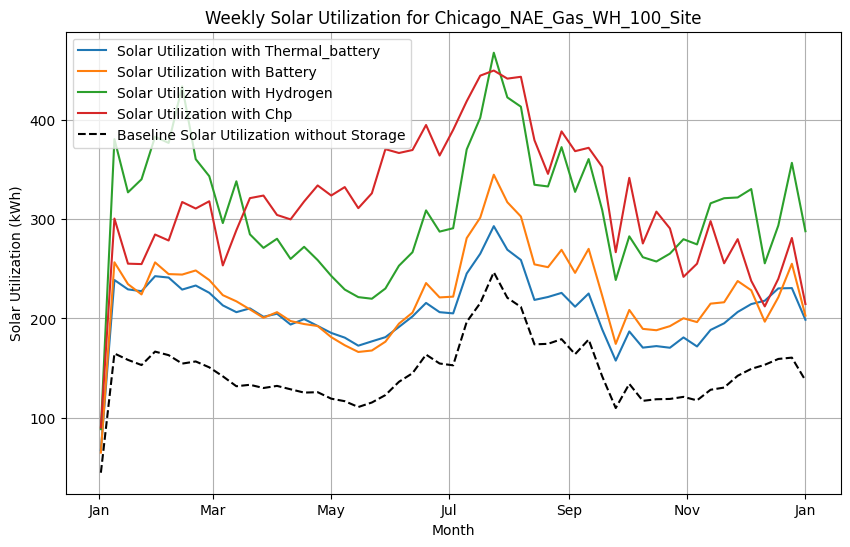

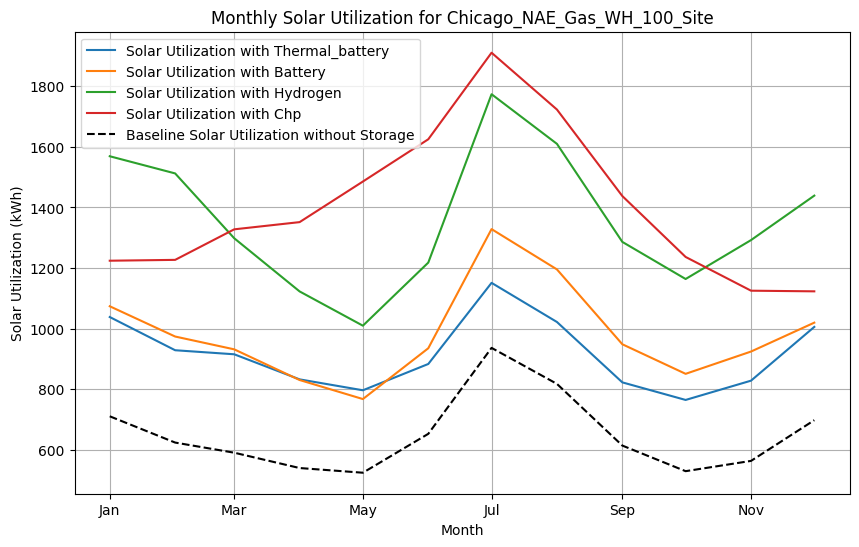

Loaded results from: /content/drive/MyDrive/Thesis/Results/Chicago/Chicago_AE_Electric_WH_100_Site/Thermal_Battery_Results_Chicago_AE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Chicago/Chicago_AE_Electric_WH_100_Site/Battery_Results_Chicago_AE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Chicago/Chicago_AE_Electric_WH_100_Site/Hydrogen_Results_Chicago_AE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Chicago/Chicago_AE_Electric_WH_100_Site/CHP_Results_Chicago_AE_Electric_WH_100_Site.csv


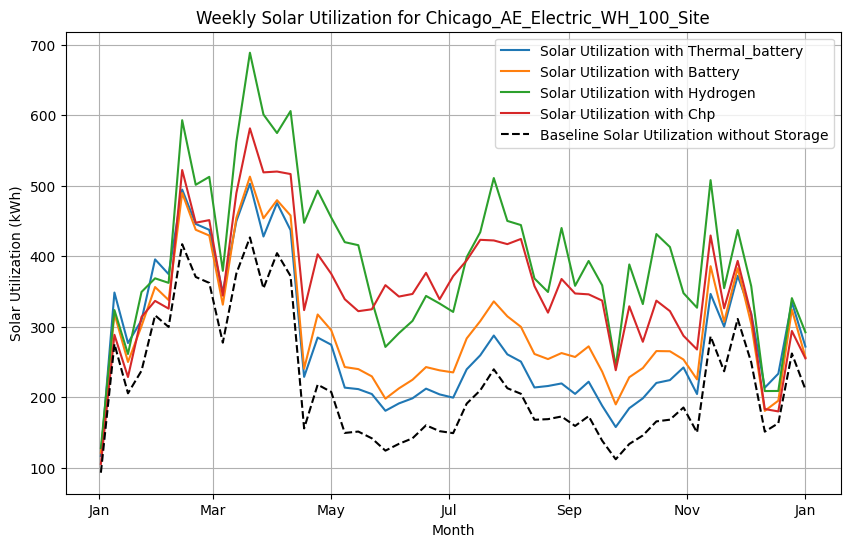

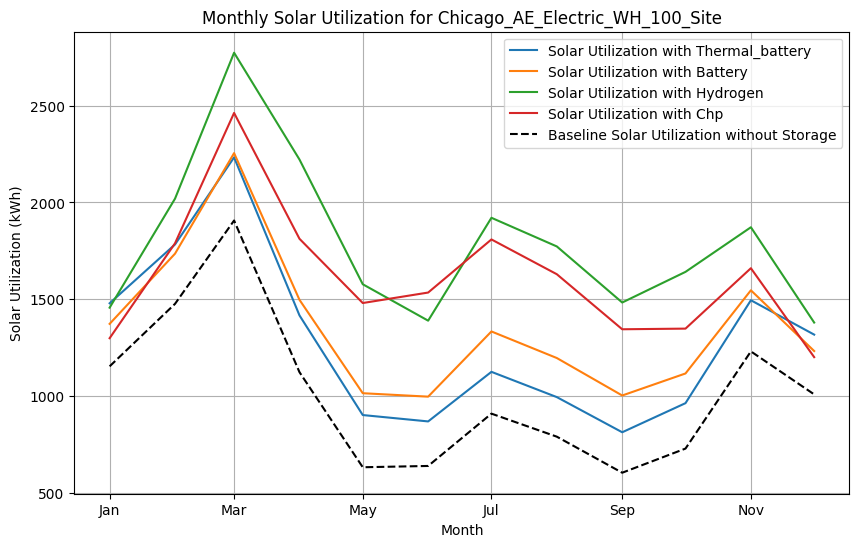

In [ ]:
plot_solar_utilization_for_all_configs("Chicago")

Loaded results from: /content/drive/MyDrive/Thesis/Results/Chicago/Chicago_NAE_Electric_WH_100_Site/Thermal_Battery_Results_Chicago_NAE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Chicago/Chicago_NAE_Electric_WH_100_Site/Battery_Results_Chicago_NAE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Chicago/Chicago_NAE_Electric_WH_100_Site/Hydrogen_Results_Chicago_NAE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Chicago/Chicago_NAE_Electric_WH_100_Site/CHP_Results_Chicago_NAE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Chicago/Chicago_NAE_Gas_WH_100_Site/Thermal_Battery_Results_Chicago_NAE_Gas_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Chicago/Chicago_NAE_Gas_WH_100_Site/Battery_Results_Chicago_NAE_Gas_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Chicago/Chicago_NAE_Gas_WH_100

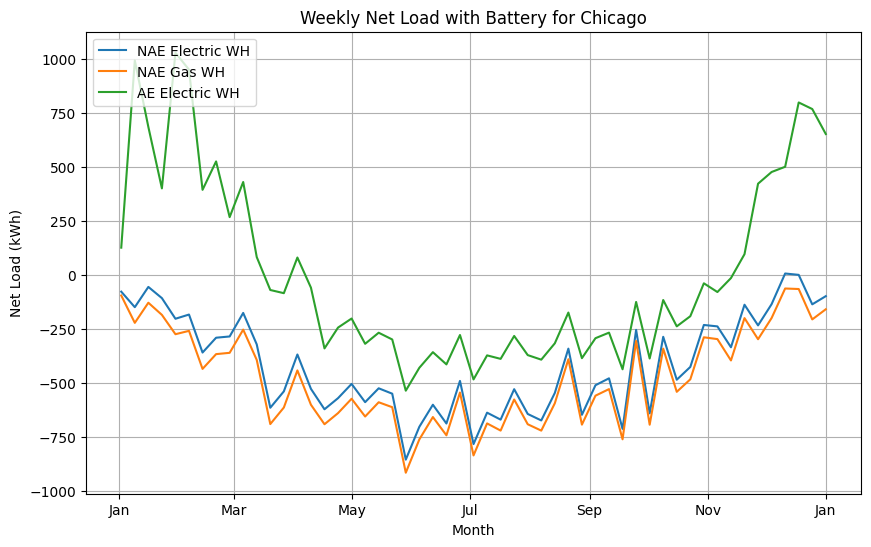

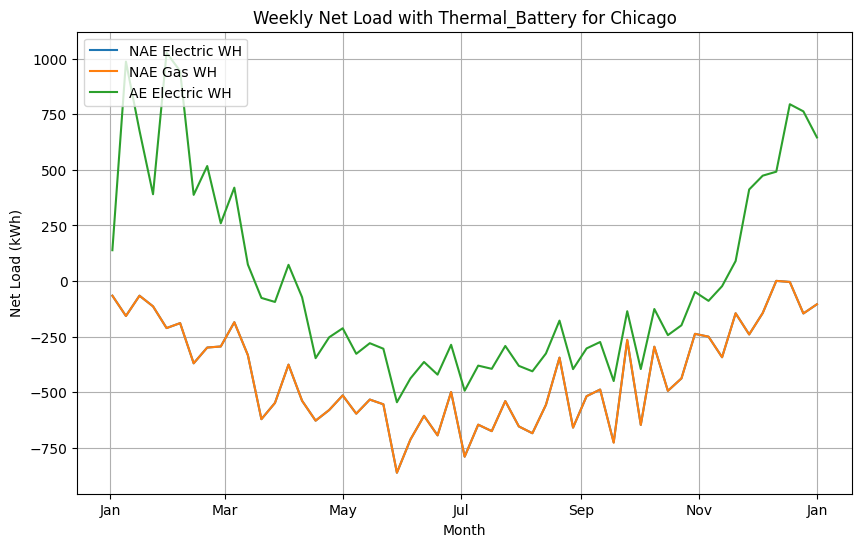

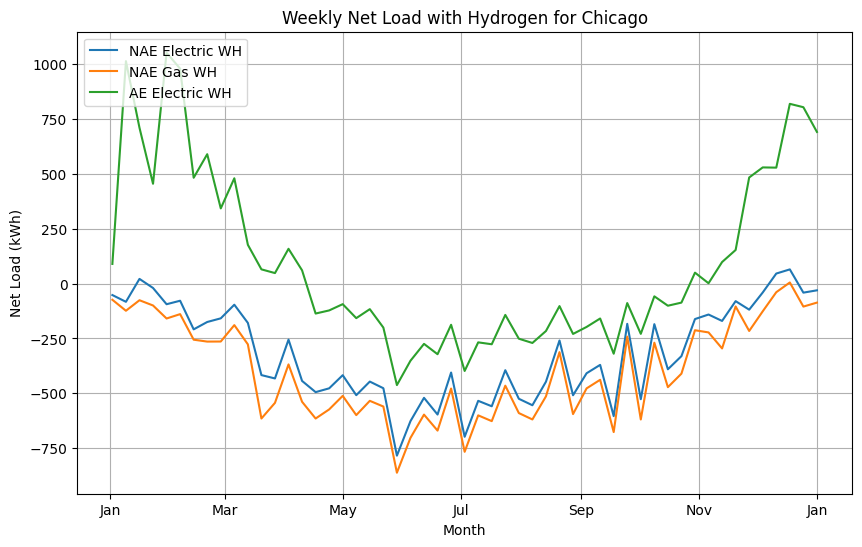

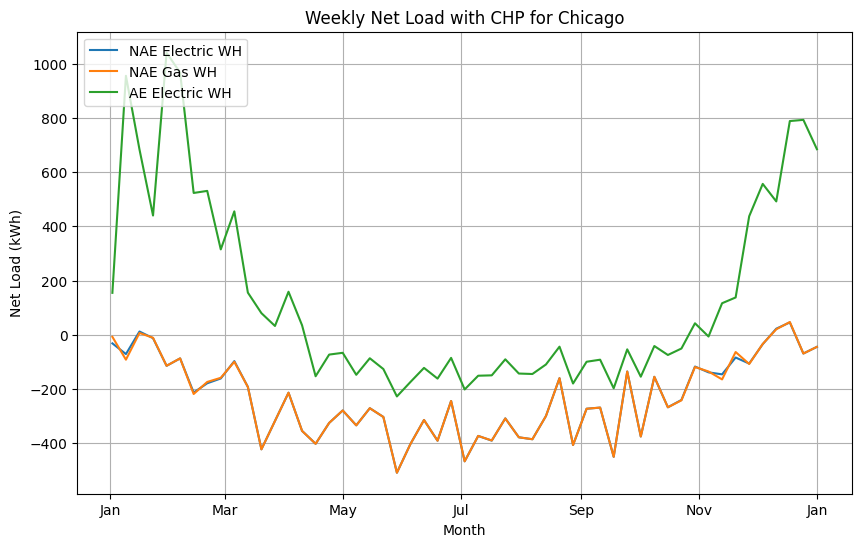

In [ ]:
plot_net_load_based_on_storage("Chicago")

# Atlanta

## Configuration


In [ ]:
create_default_configs("Atlanta")

Configuration Created: Atlanta_NAE_Electric_WH_100_Site
Results will be saved in: /content/drive/MyDrive/Thesis/Results/Atlanta/Atlanta_NAE_Electric_WH_100_Site

Configuration Created: Atlanta_NAE_Gas_WH_100_Site
Results will be saved in: /content/drive/MyDrive/Thesis/Results/Atlanta/Atlanta_NAE_Gas_WH_100_Site

Configuration Created: Atlanta_AE_Electric_WH_100_Site
Results will be saved in: /content/drive/MyDrive/Thesis/Results/Atlanta/Atlanta_AE_Electric_WH_100_Site

Default configurations created for Atlanta. Results stored in: /content/drive/MyDrive/Thesis/Results/Atlanta
Atlanta_NAE_Electric_WH_100_Site
Atlanta_NAE_Gas_WH_100_Site
Atlanta_AE_Electric_WH_100_Site


## Run Model ("Atlanta")

In [ ]:
run_model("Atlanta")


Available Configurations for Atlanta:
[1] Atlanta_NAE_Electric_WH_100_Site
[2] Atlanta_NAE_Gas_WH_100_Site
[3] Atlanta_AE_Electric_WH_100_Site
Select configuration by index,
type 'all' to run all configurations,
or type multiple indexes separated by commas: all
Do you want to run all models for all configurations? (yes/no): yes

Running all models for configuration: Atlanta_NAE_Electric_WH_100_Site


Running Thermal Battery Optimization Model
Loading PV data from: /content/drive/MyDrive/Thesis/Data/Atlanta/Atlanta PV Watts Hourly kW.csv
Loading load data from: /content/drive/MyDrive/Thesis/Data/Atlanta/Atlanta_NAE_Electric_WH_Loads.csv
Load Data Columns: Index(['Hours since 00:00 Jan 1', 'My Design - Energy Use:  Total (kBtu)',
       'My Design - Fuel Use:  Electricity: Total (kWh)',
       'My Design - End Use:  Electricity: Hot Water (kWh)'],
      dtype='object')
NZE Solar Array Size: 13.29 kWp
Sized to: Total Site Energy


Thermal Battery Optimization Progress (Fixed Model): 100%|██████████| 8760/8760 [04:12<00:00, 34.72it/s]



Thermal Battery Optimization completed.
Results saved to: /content/drive/MyDrive/Thesis/Results/Atlanta/Atlanta_NAE_Electric_WH_100_Site/Thermal_Battery_Results_Atlanta_NAE_Electric_WH_100_Site.csv


Running Battery Optimization Model
Loading PV data from: /content/drive/MyDrive/Thesis/Data/Atlanta/Atlanta PV Watts Hourly kW.csv
Loading load data from: /content/drive/MyDrive/Thesis/Data/Atlanta/Atlanta_NAE_Electric_WH_Loads.csv
Load Data Columns: Index(['Hours since 00:00 Jan 1', 'My Design - Energy Use:  Total (kBtu)',
       'My Design - Fuel Use:  Electricity: Total (kWh)',
       'My Design - End Use:  Electricity: Hot Water (kWh)'],
      dtype='object')
NZE Solar Array Size: 13.29 kWp
Sized to: Total Site Energy


Battery Optimization Progress: 100%|██████████| 365/365 [00:14<00:00, 24.88it/s]



Battery Optimization completed.
Results saved to: /content/drive/MyDrive/Thesis/Results/Atlanta/Atlanta_NAE_Electric_WH_100_Site/Battery_Results_Atlanta_NAE_Electric_WH_100_Site.csv


Running Hydrogen Optimization Model
Loading PV data from: /content/drive/MyDrive/Thesis/Data/Atlanta/Atlanta PV Watts Hourly kW.csv
Loading load data from: /content/drive/MyDrive/Thesis/Data/Atlanta/Atlanta_NAE_Electric_WH_Loads.csv
Load Data Columns: Index(['Hours since 00:00 Jan 1', 'My Design - Energy Use:  Total (kBtu)',
       'My Design - Fuel Use:  Electricity: Total (kWh)',
       'My Design - End Use:  Electricity: Hot Water (kWh)'],
      dtype='object')
NZE Solar Array Size: 13.29 kWp
Sized to: Total Site Energy


Hydrogen Optimization Progress: 100%|██████████| 365/365 [00:14<00:00, 25.92it/s]



Hydrogen Optimization completed.
Results saved to: /content/drive/MyDrive/Thesis/Results/Atlanta/Atlanta_NAE_Electric_WH_100_Site/Hydrogen_Results_Atlanta_NAE_Electric_WH_100_Site.csv


Running CHP Optimization Model
Loading PV data from: /content/drive/MyDrive/Thesis/Data/Atlanta/Atlanta PV Watts Hourly kW.csv
Loading load data from: /content/drive/MyDrive/Thesis/Data/Atlanta/Atlanta_NAE_Electric_WH_Loads.csv
Load Data Columns: Index(['Hours since 00:00 Jan 1', 'My Design - Energy Use:  Total (kBtu)',
       'My Design - Fuel Use:  Electricity: Total (kWh)',
       'My Design - End Use:  Electricity: Hot Water (kWh)'],
      dtype='object')
NZE Solar Array Size: 13.29 kWp
Sized to: Total Site Energy


CHP Optimization Progress: 100%|██████████| 37/37 [00:08<00:00,  4.54it/s]



CHP Optimization completed.
Results saved to: /content/drive/MyDrive/Thesis/Results/Atlanta/Atlanta_NAE_Electric_WH_100_Site/CHP_Results_Atlanta_NAE_Electric_WH_100_Site.csv


Running all models for configuration: Atlanta_NAE_Gas_WH_100_Site


Running Thermal Battery Optimization Model
Loading PV data from: /content/drive/MyDrive/Thesis/Data/Atlanta/Atlanta PV Watts Hourly kW.csv
Loading load data from: /content/drive/MyDrive/Thesis/Data/Atlanta/Atlanta_NAE_Gas_WH_Loads.csv
Load Data Columns: Index(['Hours since 00:00 Jan 1', 'My Design - Energy Use:  Total (kBtu)',
       'My Design - Fuel Use:  Electricity: Total (kWh)',
       'My Design - End Use:  Natural Gas: Hot Water (kBtu)'],
      dtype='object')
NZE Solar Array Size: 13.29 kWp
Sized to: Total Site Energy


Thermal Battery Optimization Progress (Fixed Model): 100%|██████████| 8760/8760 [04:07<00:00, 35.46it/s]



Thermal Battery Optimization completed.
Results saved to: /content/drive/MyDrive/Thesis/Results/Atlanta/Atlanta_NAE_Gas_WH_100_Site/Thermal_Battery_Results_Atlanta_NAE_Gas_WH_100_Site.csv


Running Battery Optimization Model
Loading PV data from: /content/drive/MyDrive/Thesis/Data/Atlanta/Atlanta PV Watts Hourly kW.csv
Loading load data from: /content/drive/MyDrive/Thesis/Data/Atlanta/Atlanta_NAE_Gas_WH_Loads.csv
Load Data Columns: Index(['Hours since 00:00 Jan 1', 'My Design - Energy Use:  Total (kBtu)',
       'My Design - Fuel Use:  Electricity: Total (kWh)',
       'My Design - End Use:  Natural Gas: Hot Water (kBtu)'],
      dtype='object')
NZE Solar Array Size: 13.29 kWp
Sized to: Total Site Energy


Battery Optimization Progress: 100%|██████████| 365/365 [00:14<00:00, 25.84it/s]



Battery Optimization completed.
Results saved to: /content/drive/MyDrive/Thesis/Results/Atlanta/Atlanta_NAE_Gas_WH_100_Site/Battery_Results_Atlanta_NAE_Gas_WH_100_Site.csv


Running Hydrogen Optimization Model
Loading PV data from: /content/drive/MyDrive/Thesis/Data/Atlanta/Atlanta PV Watts Hourly kW.csv
Loading load data from: /content/drive/MyDrive/Thesis/Data/Atlanta/Atlanta_NAE_Gas_WH_Loads.csv
Load Data Columns: Index(['Hours since 00:00 Jan 1', 'My Design - Energy Use:  Total (kBtu)',
       'My Design - Fuel Use:  Electricity: Total (kWh)',
       'My Design - End Use:  Natural Gas: Hot Water (kBtu)'],
      dtype='object')
NZE Solar Array Size: 13.29 kWp
Sized to: Total Site Energy


Hydrogen Optimization Progress: 100%|██████████| 365/365 [00:13<00:00, 26.47it/s]



Hydrogen Optimization completed.
Results saved to: /content/drive/MyDrive/Thesis/Results/Atlanta/Atlanta_NAE_Gas_WH_100_Site/Hydrogen_Results_Atlanta_NAE_Gas_WH_100_Site.csv


Running CHP Optimization Model
Loading PV data from: /content/drive/MyDrive/Thesis/Data/Atlanta/Atlanta PV Watts Hourly kW.csv
Loading load data from: /content/drive/MyDrive/Thesis/Data/Atlanta/Atlanta_NAE_Gas_WH_Loads.csv
Load Data Columns: Index(['Hours since 00:00 Jan 1', 'My Design - Energy Use:  Total (kBtu)',
       'My Design - Fuel Use:  Electricity: Total (kWh)',
       'My Design - End Use:  Natural Gas: Hot Water (kBtu)'],
      dtype='object')
NZE Solar Array Size: 13.29 kWp
Sized to: Total Site Energy


CHP Optimization Progress: 100%|██████████| 37/37 [00:08<00:00,  4.57it/s]



CHP Optimization completed.
Results saved to: /content/drive/MyDrive/Thesis/Results/Atlanta/Atlanta_NAE_Gas_WH_100_Site/CHP_Results_Atlanta_NAE_Gas_WH_100_Site.csv


Running all models for configuration: Atlanta_AE_Electric_WH_100_Site


Running Thermal Battery Optimization Model
Loading PV data from: /content/drive/MyDrive/Thesis/Data/Atlanta/Atlanta PV Watts Hourly kW.csv
Loading load data from: /content/drive/MyDrive/Thesis/Data/Atlanta/Atlanta_AE_Electric_WH_Loads.csv
Load Data Columns: Index(['Hours since 00:00 Jan 1', 'My Design - Energy Use:  Total (kBtu)',
       'My Design - Fuel Use:  Electricity: Total (kWh)',
       'My Design - End Use:  Electricity: Hot Water (kWh)'],
      dtype='object')
NZE Solar Array Size: 9.88 kWp
Sized to: Total Site Energy


Thermal Battery Optimization Progress (Fixed Model): 100%|██████████| 8760/8760 [04:04<00:00, 35.84it/s]



Thermal Battery Optimization completed.
Results saved to: /content/drive/MyDrive/Thesis/Results/Atlanta/Atlanta_AE_Electric_WH_100_Site/Thermal_Battery_Results_Atlanta_AE_Electric_WH_100_Site.csv


Running Battery Optimization Model
Loading PV data from: /content/drive/MyDrive/Thesis/Data/Atlanta/Atlanta PV Watts Hourly kW.csv
Loading load data from: /content/drive/MyDrive/Thesis/Data/Atlanta/Atlanta_AE_Electric_WH_Loads.csv
Load Data Columns: Index(['Hours since 00:00 Jan 1', 'My Design - Energy Use:  Total (kBtu)',
       'My Design - Fuel Use:  Electricity: Total (kWh)',
       'My Design - End Use:  Electricity: Hot Water (kWh)'],
      dtype='object')
NZE Solar Array Size: 9.88 kWp
Sized to: Total Site Energy


Battery Optimization Progress: 100%|██████████| 365/365 [00:13<00:00, 26.34it/s]



Battery Optimization completed.
Results saved to: /content/drive/MyDrive/Thesis/Results/Atlanta/Atlanta_AE_Electric_WH_100_Site/Battery_Results_Atlanta_AE_Electric_WH_100_Site.csv


Running Hydrogen Optimization Model
Loading PV data from: /content/drive/MyDrive/Thesis/Data/Atlanta/Atlanta PV Watts Hourly kW.csv
Loading load data from: /content/drive/MyDrive/Thesis/Data/Atlanta/Atlanta_AE_Electric_WH_Loads.csv
Load Data Columns: Index(['Hours since 00:00 Jan 1', 'My Design - Energy Use:  Total (kBtu)',
       'My Design - Fuel Use:  Electricity: Total (kWh)',
       'My Design - End Use:  Electricity: Hot Water (kWh)'],
      dtype='object')
NZE Solar Array Size: 9.88 kWp
Sized to: Total Site Energy


Hydrogen Optimization Progress: 100%|██████████| 365/365 [00:13<00:00, 26.26it/s]



Hydrogen Optimization completed.
Results saved to: /content/drive/MyDrive/Thesis/Results/Atlanta/Atlanta_AE_Electric_WH_100_Site/Hydrogen_Results_Atlanta_AE_Electric_WH_100_Site.csv


Running CHP Optimization Model
Loading PV data from: /content/drive/MyDrive/Thesis/Data/Atlanta/Atlanta PV Watts Hourly kW.csv
Loading load data from: /content/drive/MyDrive/Thesis/Data/Atlanta/Atlanta_AE_Electric_WH_Loads.csv
Load Data Columns: Index(['Hours since 00:00 Jan 1', 'My Design - Energy Use:  Total (kBtu)',
       'My Design - Fuel Use:  Electricity: Total (kWh)',
       'My Design - End Use:  Electricity: Hot Water (kWh)'],
      dtype='object')
NZE Solar Array Size: 9.88 kWp
Sized to: Total Site Energy


CHP Optimization Progress: 100%|██████████| 37/37 [00:07<00:00,  4.76it/s]



CHP Optimization completed.
Results saved to: /content/drive/MyDrive/Thesis/Results/Atlanta/Atlanta_AE_Electric_WH_100_Site/CHP_Results_Atlanta_AE_Electric_WH_100_Site.csv



## Analysis

Loaded results from: /content/drive/MyDrive/Thesis/Results/Atlanta/Atlanta_NAE_Electric_WH_100_Site/Thermal_Battery_Results_Atlanta_NAE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Atlanta/Atlanta_NAE_Electric_WH_100_Site/Battery_Results_Atlanta_NAE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Atlanta/Atlanta_NAE_Electric_WH_100_Site/Hydrogen_Results_Atlanta_NAE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Atlanta/Atlanta_NAE_Electric_WH_100_Site/CHP_Results_Atlanta_NAE_Electric_WH_100_Site.csv


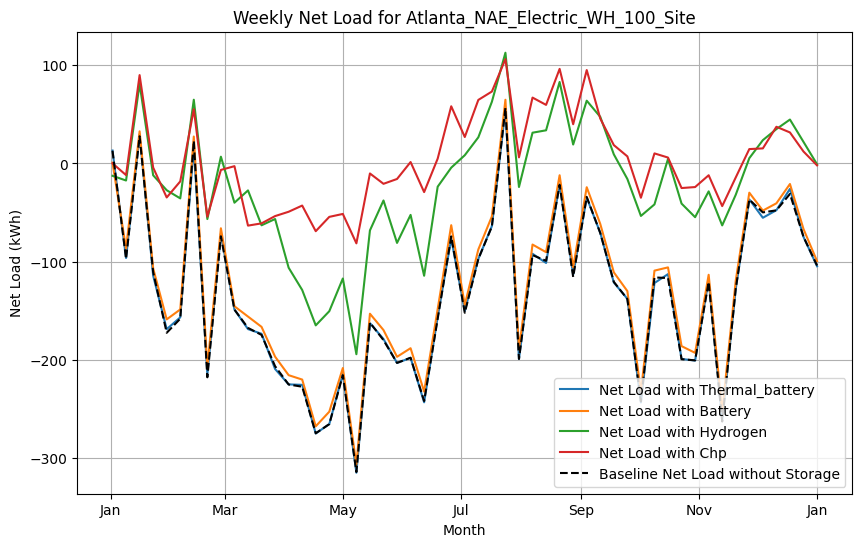

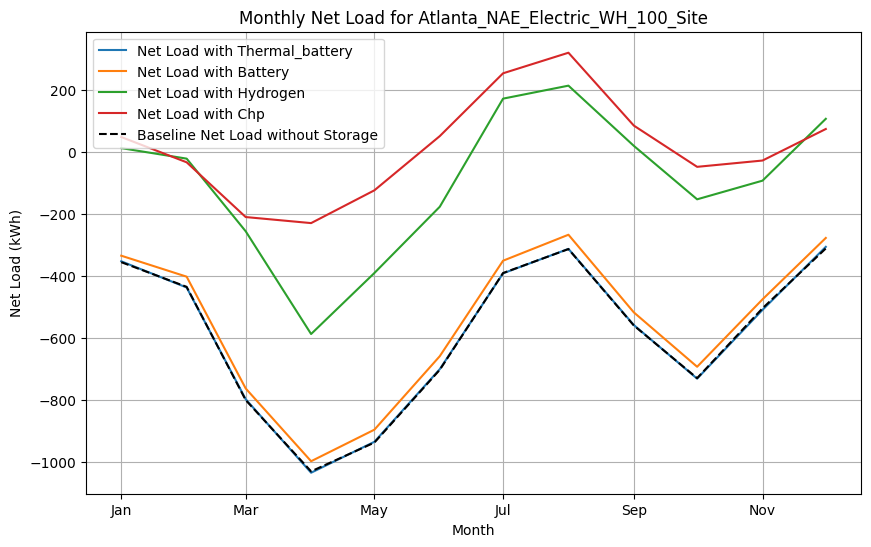

Loaded results from: /content/drive/MyDrive/Thesis/Results/Atlanta/Atlanta_NAE_Gas_WH_100_Site/Thermal_Battery_Results_Atlanta_NAE_Gas_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Atlanta/Atlanta_NAE_Gas_WH_100_Site/Battery_Results_Atlanta_NAE_Gas_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Atlanta/Atlanta_NAE_Gas_WH_100_Site/Hydrogen_Results_Atlanta_NAE_Gas_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Atlanta/Atlanta_NAE_Gas_WH_100_Site/CHP_Results_Atlanta_NAE_Gas_WH_100_Site.csv


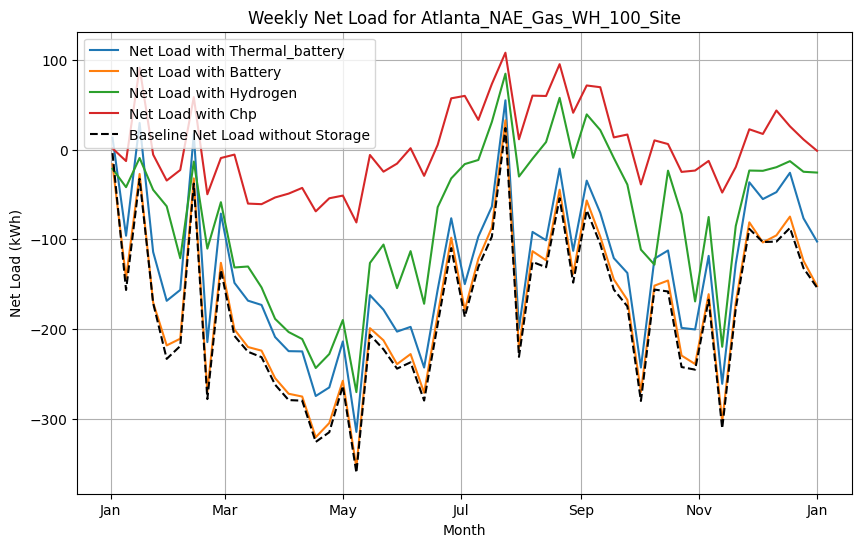

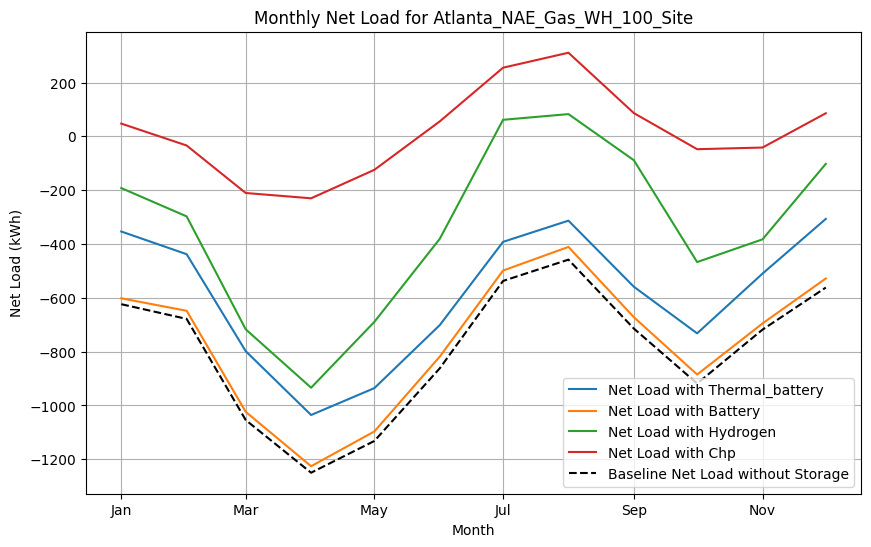

Loaded results from: /content/drive/MyDrive/Thesis/Results/Atlanta/Atlanta_AE_Electric_WH_100_Site/Thermal_Battery_Results_Atlanta_AE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Atlanta/Atlanta_AE_Electric_WH_100_Site/Battery_Results_Atlanta_AE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Atlanta/Atlanta_AE_Electric_WH_100_Site/Hydrogen_Results_Atlanta_AE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Atlanta/Atlanta_AE_Electric_WH_100_Site/CHP_Results_Atlanta_AE_Electric_WH_100_Site.csv


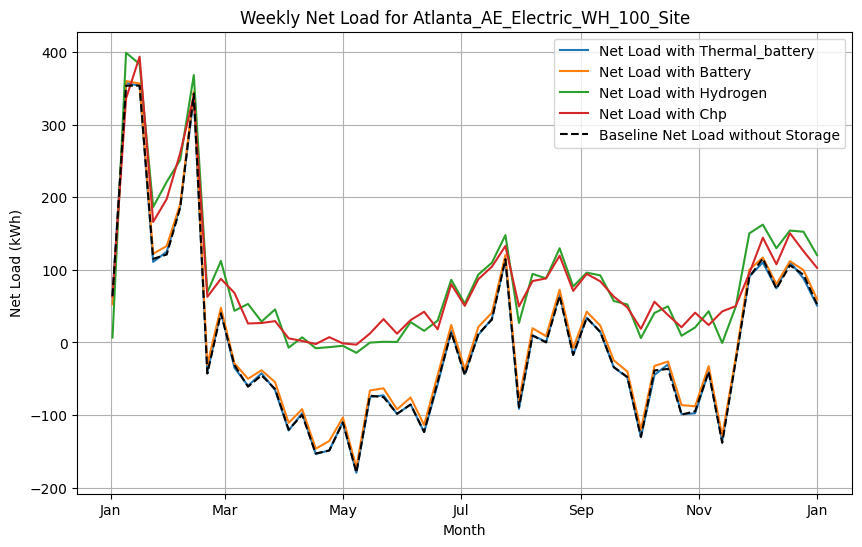

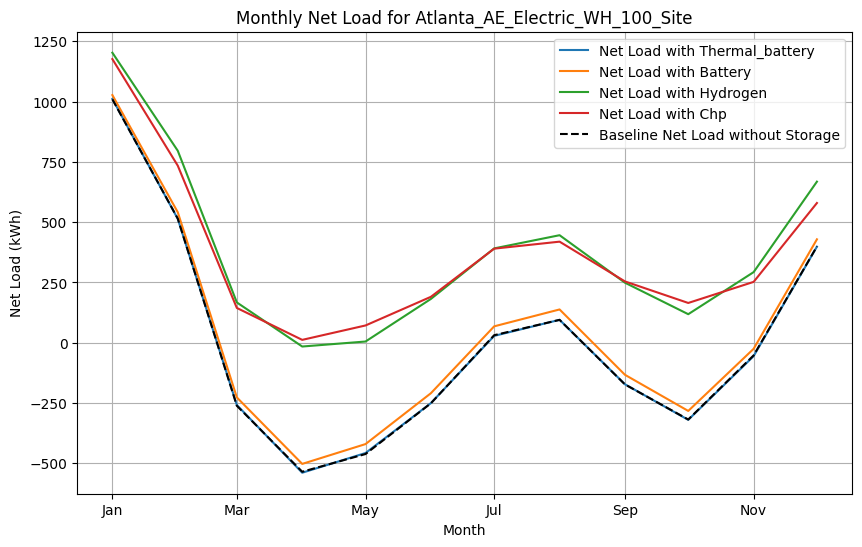

In [ ]:
# Run the analysis for a specific region
plot_net_load_for_all_configs("Atlanta")

Loaded results from: /content/drive/MyDrive/Thesis/Results/Atlanta/Atlanta_NAE_Electric_WH_100_Site/Thermal_Battery_Results_Atlanta_NAE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Atlanta/Atlanta_NAE_Electric_WH_100_Site/Battery_Results_Atlanta_NAE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Atlanta/Atlanta_NAE_Electric_WH_100_Site/Hydrogen_Results_Atlanta_NAE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Atlanta/Atlanta_NAE_Electric_WH_100_Site/CHP_Results_Atlanta_NAE_Electric_WH_100_Site.csv


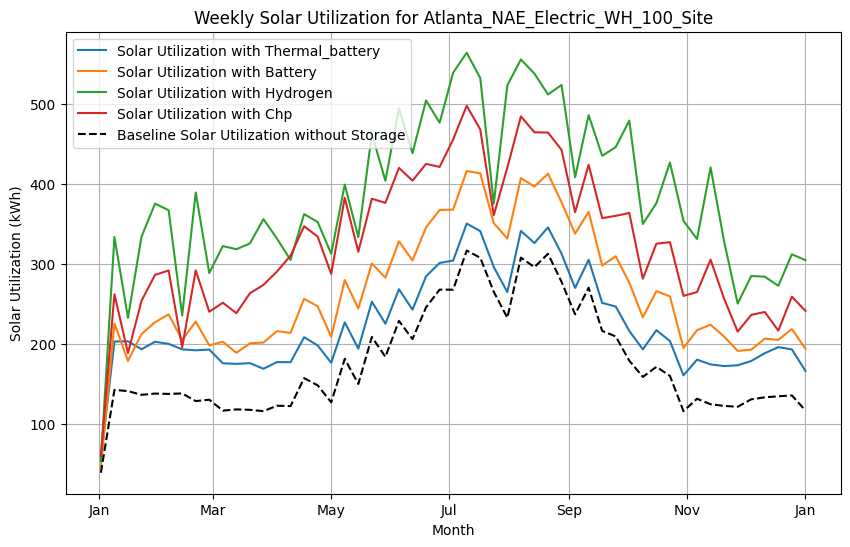

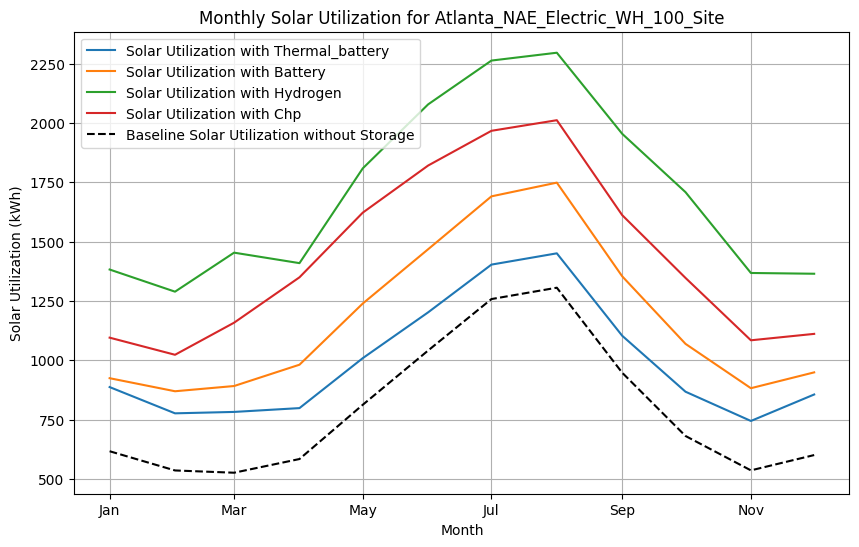

Loaded results from: /content/drive/MyDrive/Thesis/Results/Atlanta/Atlanta_NAE_Gas_WH_100_Site/Thermal_Battery_Results_Atlanta_NAE_Gas_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Atlanta/Atlanta_NAE_Gas_WH_100_Site/Battery_Results_Atlanta_NAE_Gas_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Atlanta/Atlanta_NAE_Gas_WH_100_Site/Hydrogen_Results_Atlanta_NAE_Gas_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Atlanta/Atlanta_NAE_Gas_WH_100_Site/CHP_Results_Atlanta_NAE_Gas_WH_100_Site.csv


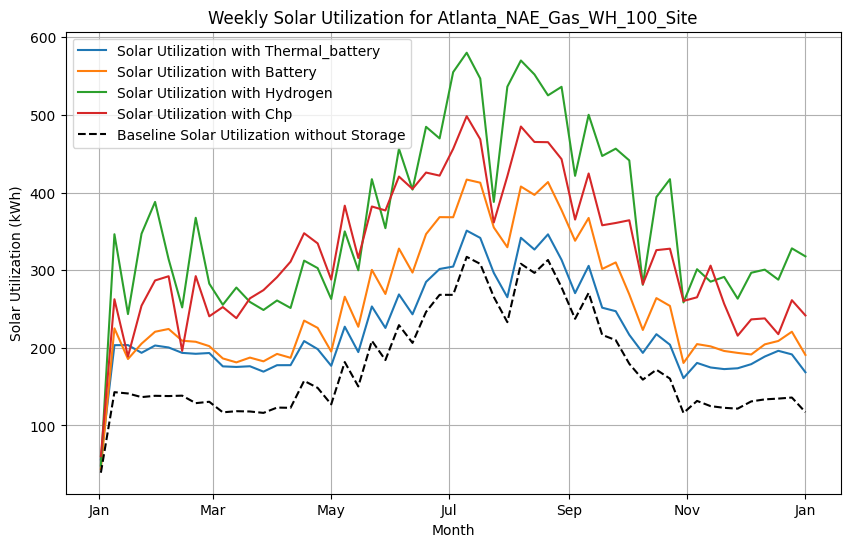

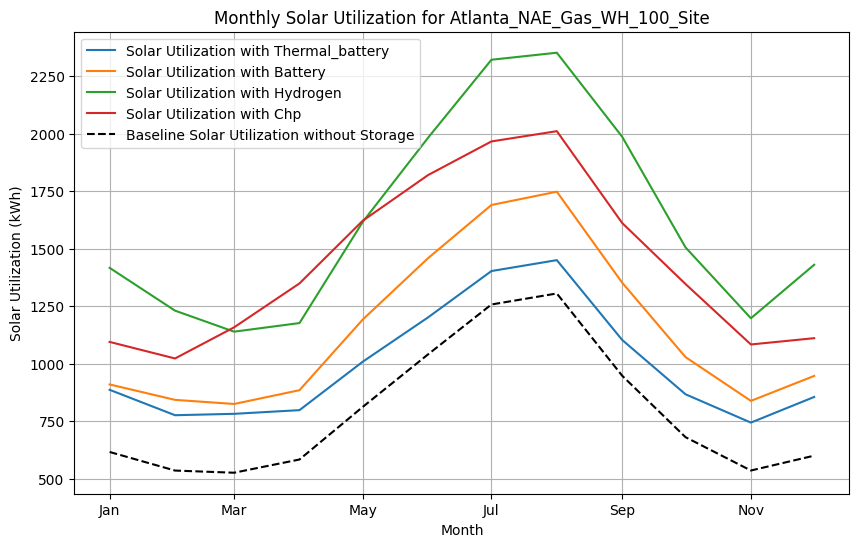

Loaded results from: /content/drive/MyDrive/Thesis/Results/Atlanta/Atlanta_AE_Electric_WH_100_Site/Thermal_Battery_Results_Atlanta_AE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Atlanta/Atlanta_AE_Electric_WH_100_Site/Battery_Results_Atlanta_AE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Atlanta/Atlanta_AE_Electric_WH_100_Site/Hydrogen_Results_Atlanta_AE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Atlanta/Atlanta_AE_Electric_WH_100_Site/CHP_Results_Atlanta_AE_Electric_WH_100_Site.csv


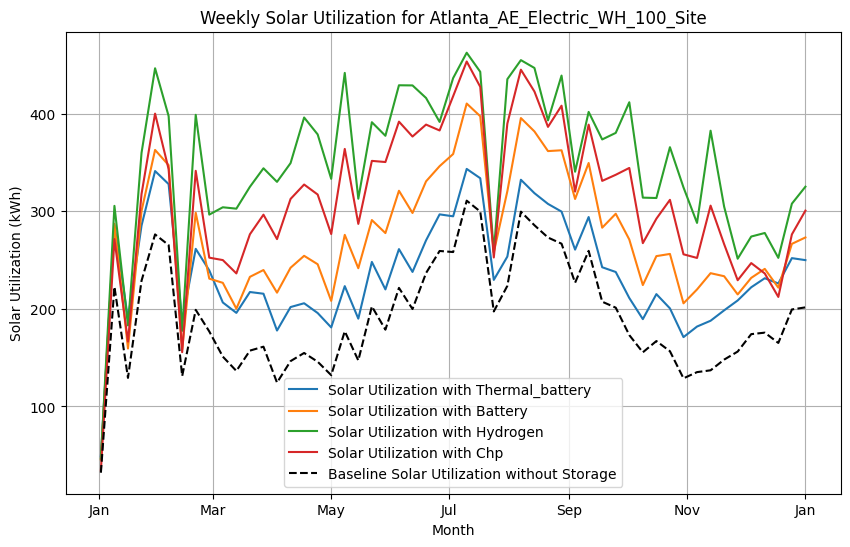

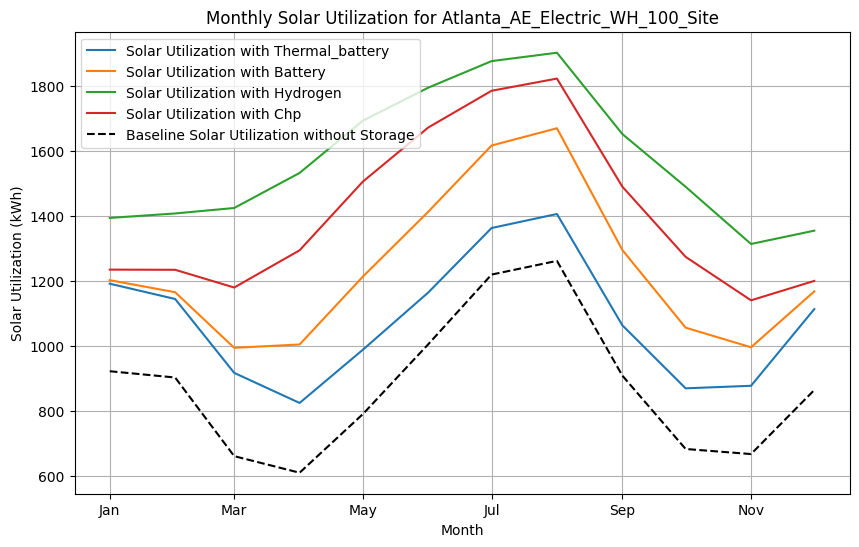

In [ ]:
plot_solar_utilization_for_all_configs("Atlanta")

Loaded results from: /content/drive/MyDrive/Thesis/Results/Atlanta/Atlanta_NAE_Electric_WH_100_Site/Thermal_Battery_Results_Atlanta_NAE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Atlanta/Atlanta_NAE_Electric_WH_100_Site/Battery_Results_Atlanta_NAE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Atlanta/Atlanta_NAE_Electric_WH_100_Site/Hydrogen_Results_Atlanta_NAE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Atlanta/Atlanta_NAE_Electric_WH_100_Site/CHP_Results_Atlanta_NAE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Atlanta/Atlanta_NAE_Gas_WH_100_Site/Thermal_Battery_Results_Atlanta_NAE_Gas_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Atlanta/Atlanta_NAE_Gas_WH_100_Site/Battery_Results_Atlanta_NAE_Gas_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Atlanta/Atlanta_NAE_Gas_WH_100

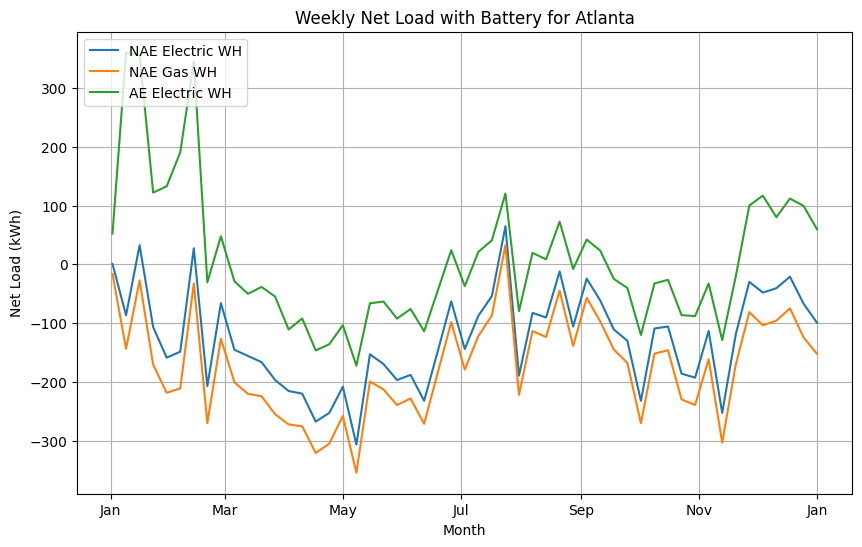

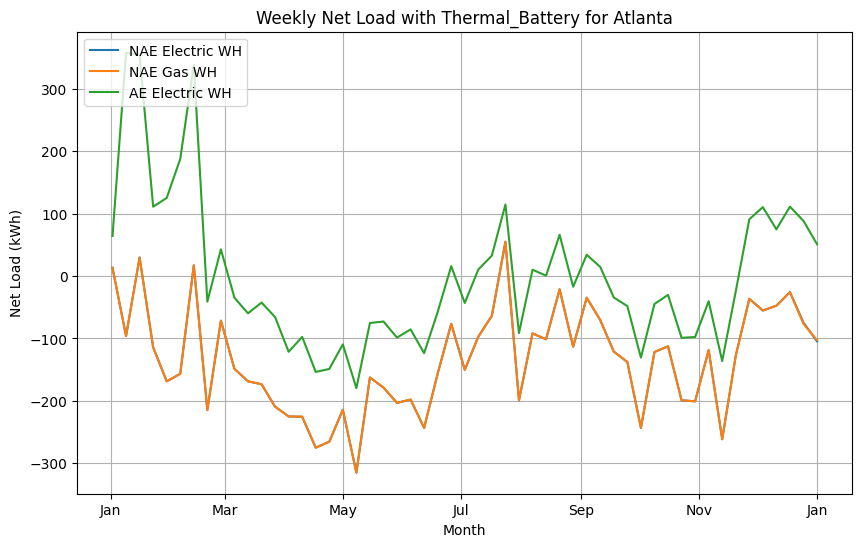

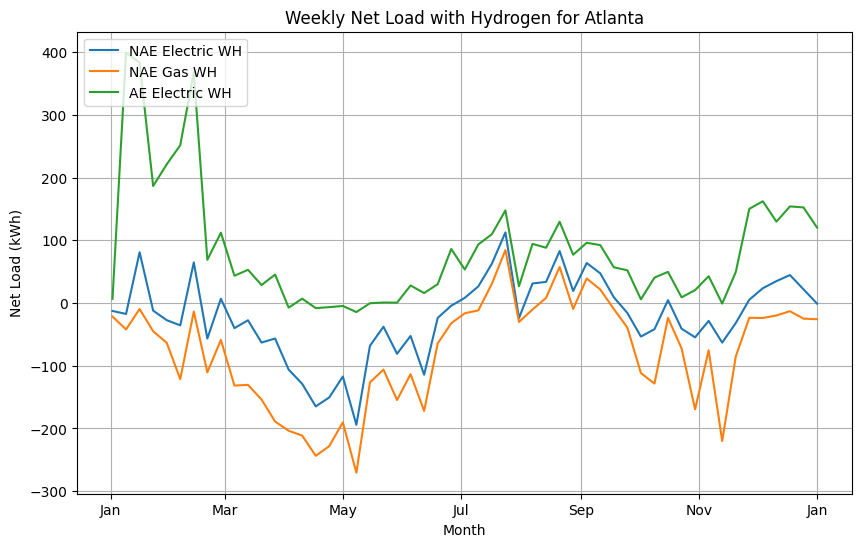

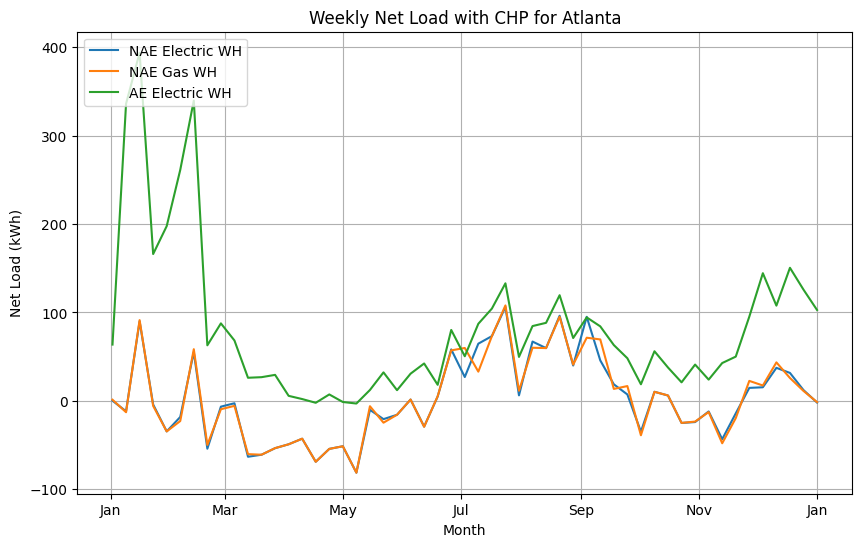

In [ ]:
plot_net_load_based_on_storage("Atlanta")

# Phoenix


## Configuration

In [ ]:
create_default_configs("Phoenix")

Configuration Created: Pheonix_NAE_Electric_WH_100_Site
Results will be saved in: /content/drive/MyDrive/Thesis/Results/Pheonix/Pheonix_NAE_Electric_WH_100_Site

Configuration Created: Pheonix_NAE_Gas_WH_100_Site
Results will be saved in: /content/drive/MyDrive/Thesis/Results/Pheonix/Pheonix_NAE_Gas_WH_100_Site

Configuration Created: Pheonix_AE_Electric_WH_100_Site
Results will be saved in: /content/drive/MyDrive/Thesis/Results/Pheonix/Pheonix_AE_Electric_WH_100_Site

Default configurations created for Pheonix. Results stored in: /content/drive/MyDrive/Thesis/Results/Pheonix
Pheonix_NAE_Electric_WH_100_Site
Pheonix_NAE_Gas_WH_100_Site
Pheonix_AE_Electric_WH_100_Site


## Run Model ("Pheonix")



In [ ]:
run_model("Phoenix")


Available Configurations for Pheonix:
[1] Pheonix_NAE_Electric_WH_100_Site
[2] Pheonix_NAE_Gas_WH_100_Site
[3] Pheonix_AE_Electric_WH_100_Site
Select configuration by index,
type 'all' to run all configurations,
or type multiple indexes separated by commas: all
Do you want to run all models for all configurations? (yes/no): yes

Running all models for configuration: Pheonix_NAE_Electric_WH_100_Site


Running Thermal Battery Optimization Model
Loading PV data from: /content/drive/MyDrive/Thesis/Data/Pheonix/Pheonix PV Watts Hourly kW.csv
Loading load data from: /content/drive/MyDrive/Thesis/Data/Pheonix/Pheonix_NAE_Electric_WH_Loads.csv
Load Data Columns: Index(['Hours since 00:00 Jan 1', 'My Design - Energy Use:  Total (kBtu)',
       'My Design - Fuel Use:  Electricity: Total (kWh)',
       'My Design - End Use:  Electricity: Hot Water (kWh)'],
      dtype='object')
NZE Solar Array Size: 9.62 kWp
Sized to: Total Site Energy


Thermal Battery Optimization Progress (Fixed Model): 100%|██████████| 8760/8760 [04:07<00:00, 35.46it/s]



Thermal Battery Optimization completed.
Results saved to: /content/drive/MyDrive/Thesis/Results/Pheonix/Pheonix_NAE_Electric_WH_100_Site/Thermal_Battery_Results_Pheonix_NAE_Electric_WH_100_Site.csv


Running Battery Optimization Model
Loading PV data from: /content/drive/MyDrive/Thesis/Data/Pheonix/Pheonix PV Watts Hourly kW.csv
Loading load data from: /content/drive/MyDrive/Thesis/Data/Pheonix/Pheonix_NAE_Electric_WH_Loads.csv
Load Data Columns: Index(['Hours since 00:00 Jan 1', 'My Design - Energy Use:  Total (kBtu)',
       'My Design - Fuel Use:  Electricity: Total (kWh)',
       'My Design - End Use:  Electricity: Hot Water (kWh)'],
      dtype='object')
NZE Solar Array Size: 9.62 kWp
Sized to: Total Site Energy


Battery Optimization Progress: 100%|██████████| 365/365 [00:14<00:00, 25.21it/s]



Battery Optimization completed.
Results saved to: /content/drive/MyDrive/Thesis/Results/Pheonix/Pheonix_NAE_Electric_WH_100_Site/Battery_Results_Pheonix_NAE_Electric_WH_100_Site.csv


Running Hydrogen Optimization Model
Loading PV data from: /content/drive/MyDrive/Thesis/Data/Pheonix/Pheonix PV Watts Hourly kW.csv
Loading load data from: /content/drive/MyDrive/Thesis/Data/Pheonix/Pheonix_NAE_Electric_WH_Loads.csv
Load Data Columns: Index(['Hours since 00:00 Jan 1', 'My Design - Energy Use:  Total (kBtu)',
       'My Design - Fuel Use:  Electricity: Total (kWh)',
       'My Design - End Use:  Electricity: Hot Water (kWh)'],
      dtype='object')
NZE Solar Array Size: 9.62 kWp
Sized to: Total Site Energy


Hydrogen Optimization Progress: 100%|██████████| 365/365 [00:14<00:00, 24.88it/s]



Hydrogen Optimization completed.
Results saved to: /content/drive/MyDrive/Thesis/Results/Pheonix/Pheonix_NAE_Electric_WH_100_Site/Hydrogen_Results_Pheonix_NAE_Electric_WH_100_Site.csv


Running CHP Optimization Model
Loading PV data from: /content/drive/MyDrive/Thesis/Data/Pheonix/Pheonix PV Watts Hourly kW.csv
Loading load data from: /content/drive/MyDrive/Thesis/Data/Pheonix/Pheonix_NAE_Electric_WH_Loads.csv
Load Data Columns: Index(['Hours since 00:00 Jan 1', 'My Design - Energy Use:  Total (kBtu)',
       'My Design - Fuel Use:  Electricity: Total (kWh)',
       'My Design - End Use:  Electricity: Hot Water (kWh)'],
      dtype='object')
NZE Solar Array Size: 9.62 kWp
Sized to: Total Site Energy


CHP Optimization Progress: 100%|██████████| 37/37 [00:07<00:00,  4.68it/s]



CHP Optimization completed.
Results saved to: /content/drive/MyDrive/Thesis/Results/Pheonix/Pheonix_NAE_Electric_WH_100_Site/CHP_Results_Pheonix_NAE_Electric_WH_100_Site.csv


Running all models for configuration: Pheonix_NAE_Gas_WH_100_Site


Running Thermal Battery Optimization Model
Loading PV data from: /content/drive/MyDrive/Thesis/Data/Pheonix/Pheonix PV Watts Hourly kW.csv
Loading load data from: /content/drive/MyDrive/Thesis/Data/Pheonix/Pheonix_NAE_Gas_WH_Loads.csv
Load Data Columns: Index(['Hours since 00:00 Jan 1', 'My Design - Energy Use:  Total (kBtu)',
       'My Design - Fuel Use:  Electricity: Total (kWh)',
       'My Design - End Use:  Natural Gas: Hot Water (kBtu)'],
      dtype='object')
NZE Solar Array Size: 9.62 kWp
Sized to: Total Site Energy


Thermal Battery Optimization Progress (Fixed Model): 100%|██████████| 8760/8760 [04:06<00:00, 35.60it/s]



Thermal Battery Optimization completed.
Results saved to: /content/drive/MyDrive/Thesis/Results/Pheonix/Pheonix_NAE_Gas_WH_100_Site/Thermal_Battery_Results_Pheonix_NAE_Gas_WH_100_Site.csv


Running Battery Optimization Model
Loading PV data from: /content/drive/MyDrive/Thesis/Data/Pheonix/Pheonix PV Watts Hourly kW.csv
Loading load data from: /content/drive/MyDrive/Thesis/Data/Pheonix/Pheonix_NAE_Gas_WH_Loads.csv
Load Data Columns: Index(['Hours since 00:00 Jan 1', 'My Design - Energy Use:  Total (kBtu)',
       'My Design - Fuel Use:  Electricity: Total (kWh)',
       'My Design - End Use:  Natural Gas: Hot Water (kBtu)'],
      dtype='object')
NZE Solar Array Size: 9.62 kWp
Sized to: Total Site Energy


Battery Optimization Progress: 100%|██████████| 365/365 [00:15<00:00, 23.74it/s]



Battery Optimization completed.
Results saved to: /content/drive/MyDrive/Thesis/Results/Pheonix/Pheonix_NAE_Gas_WH_100_Site/Battery_Results_Pheonix_NAE_Gas_WH_100_Site.csv


Running Hydrogen Optimization Model
Loading PV data from: /content/drive/MyDrive/Thesis/Data/Pheonix/Pheonix PV Watts Hourly kW.csv
Loading load data from: /content/drive/MyDrive/Thesis/Data/Pheonix/Pheonix_NAE_Gas_WH_Loads.csv
Load Data Columns: Index(['Hours since 00:00 Jan 1', 'My Design - Energy Use:  Total (kBtu)',
       'My Design - Fuel Use:  Electricity: Total (kWh)',
       'My Design - End Use:  Natural Gas: Hot Water (kBtu)'],
      dtype='object')
NZE Solar Array Size: 9.62 kWp
Sized to: Total Site Energy


Hydrogen Optimization Progress: 100%|██████████| 365/365 [00:14<00:00, 25.96it/s]



Hydrogen Optimization completed.
Results saved to: /content/drive/MyDrive/Thesis/Results/Pheonix/Pheonix_NAE_Gas_WH_100_Site/Hydrogen_Results_Pheonix_NAE_Gas_WH_100_Site.csv


Running CHP Optimization Model
Loading PV data from: /content/drive/MyDrive/Thesis/Data/Pheonix/Pheonix PV Watts Hourly kW.csv
Loading load data from: /content/drive/MyDrive/Thesis/Data/Pheonix/Pheonix_NAE_Gas_WH_Loads.csv
Load Data Columns: Index(['Hours since 00:00 Jan 1', 'My Design - Energy Use:  Total (kBtu)',
       'My Design - Fuel Use:  Electricity: Total (kWh)',
       'My Design - End Use:  Natural Gas: Hot Water (kBtu)'],
      dtype='object')
NZE Solar Array Size: 9.62 kWp
Sized to: Total Site Energy


CHP Optimization Progress: 100%|██████████| 37/37 [00:06<00:00,  5.37it/s]



CHP Optimization completed.
Results saved to: /content/drive/MyDrive/Thesis/Results/Pheonix/Pheonix_NAE_Gas_WH_100_Site/CHP_Results_Pheonix_NAE_Gas_WH_100_Site.csv


Running all models for configuration: Pheonix_AE_Electric_WH_100_Site


Running Thermal Battery Optimization Model
Loading PV data from: /content/drive/MyDrive/Thesis/Data/Pheonix/Pheonix PV Watts Hourly kW.csv
Loading load data from: /content/drive/MyDrive/Thesis/Data/Pheonix/Pheonix_AE_Electric_WH_Loads.csv
Load Data Columns: Index(['Hours since 00:00 Jan 1', 'My Design - Energy Use:  Total (kBtu)',
       'My Design - Fuel Use:  Electricity: Total (kWh)',
       'My Design - End Use:  Electricity: Hot Water (kWh)'],
      dtype='object')
NZE Solar Array Size: 9.13 kWp
Sized to: Total Site Energy


Thermal Battery Optimization Progress (Fixed Model): 100%|██████████| 8760/8760 [04:10<00:00, 34.91it/s]



Thermal Battery Optimization completed.
Results saved to: /content/drive/MyDrive/Thesis/Results/Pheonix/Pheonix_AE_Electric_WH_100_Site/Thermal_Battery_Results_Pheonix_AE_Electric_WH_100_Site.csv


Running Battery Optimization Model
Loading PV data from: /content/drive/MyDrive/Thesis/Data/Pheonix/Pheonix PV Watts Hourly kW.csv
Loading load data from: /content/drive/MyDrive/Thesis/Data/Pheonix/Pheonix_AE_Electric_WH_Loads.csv
Load Data Columns: Index(['Hours since 00:00 Jan 1', 'My Design - Energy Use:  Total (kBtu)',
       'My Design - Fuel Use:  Electricity: Total (kWh)',
       'My Design - End Use:  Electricity: Hot Water (kWh)'],
      dtype='object')
NZE Solar Array Size: 9.13 kWp
Sized to: Total Site Energy


Battery Optimization Progress: 100%|██████████| 365/365 [00:16<00:00, 22.37it/s]



Battery Optimization completed.
Results saved to: /content/drive/MyDrive/Thesis/Results/Pheonix/Pheonix_AE_Electric_WH_100_Site/Battery_Results_Pheonix_AE_Electric_WH_100_Site.csv


Running Hydrogen Optimization Model
Loading PV data from: /content/drive/MyDrive/Thesis/Data/Pheonix/Pheonix PV Watts Hourly kW.csv
Loading load data from: /content/drive/MyDrive/Thesis/Data/Pheonix/Pheonix_AE_Electric_WH_Loads.csv
Load Data Columns: Index(['Hours since 00:00 Jan 1', 'My Design - Energy Use:  Total (kBtu)',
       'My Design - Fuel Use:  Electricity: Total (kWh)',
       'My Design - End Use:  Electricity: Hot Water (kWh)'],
      dtype='object')
NZE Solar Array Size: 9.13 kWp
Sized to: Total Site Energy


Hydrogen Optimization Progress: 100%|██████████| 365/365 [00:14<00:00, 24.66it/s]



Hydrogen Optimization completed.
Results saved to: /content/drive/MyDrive/Thesis/Results/Pheonix/Pheonix_AE_Electric_WH_100_Site/Hydrogen_Results_Pheonix_AE_Electric_WH_100_Site.csv


Running CHP Optimization Model
Loading PV data from: /content/drive/MyDrive/Thesis/Data/Pheonix/Pheonix PV Watts Hourly kW.csv
Loading load data from: /content/drive/MyDrive/Thesis/Data/Pheonix/Pheonix_AE_Electric_WH_Loads.csv
Load Data Columns: Index(['Hours since 00:00 Jan 1', 'My Design - Energy Use:  Total (kBtu)',
       'My Design - Fuel Use:  Electricity: Total (kWh)',
       'My Design - End Use:  Electricity: Hot Water (kWh)'],
      dtype='object')
NZE Solar Array Size: 9.13 kWp
Sized to: Total Site Energy


CHP Optimization Progress: 100%|██████████| 37/37 [00:08<00:00,  4.45it/s]



CHP Optimization completed.
Results saved to: /content/drive/MyDrive/Thesis/Results/Pheonix/Pheonix_AE_Electric_WH_100_Site/CHP_Results_Pheonix_AE_Electric_WH_100_Site.csv



## Analysis

Loaded results from: /content/drive/MyDrive/Thesis/Results/Pheonix/Pheonix_NAE_Electric_WH_100_Site/Thermal_Battery_Results_Pheonix_NAE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Pheonix/Pheonix_NAE_Electric_WH_100_Site/Battery_Results_Pheonix_NAE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Pheonix/Pheonix_NAE_Electric_WH_100_Site/Hydrogen_Results_Pheonix_NAE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Pheonix/Pheonix_NAE_Electric_WH_100_Site/CHP_Results_Pheonix_NAE_Electric_WH_100_Site.csv


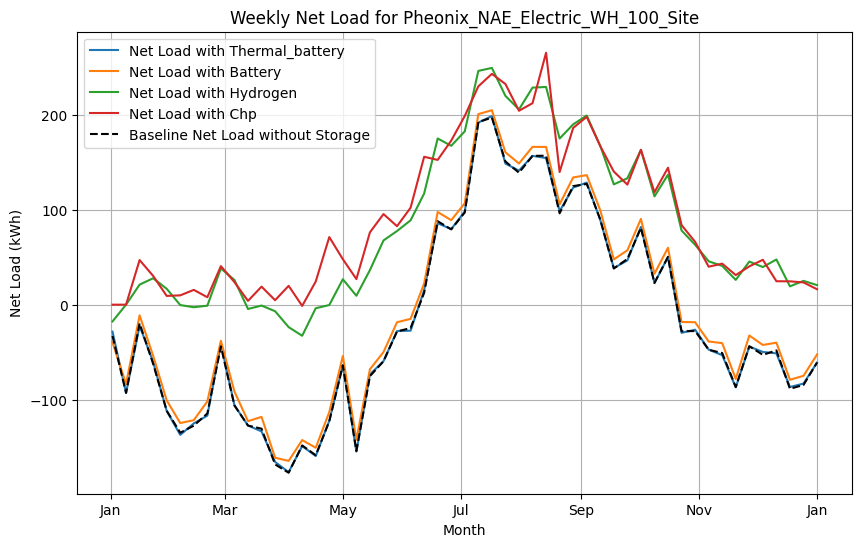

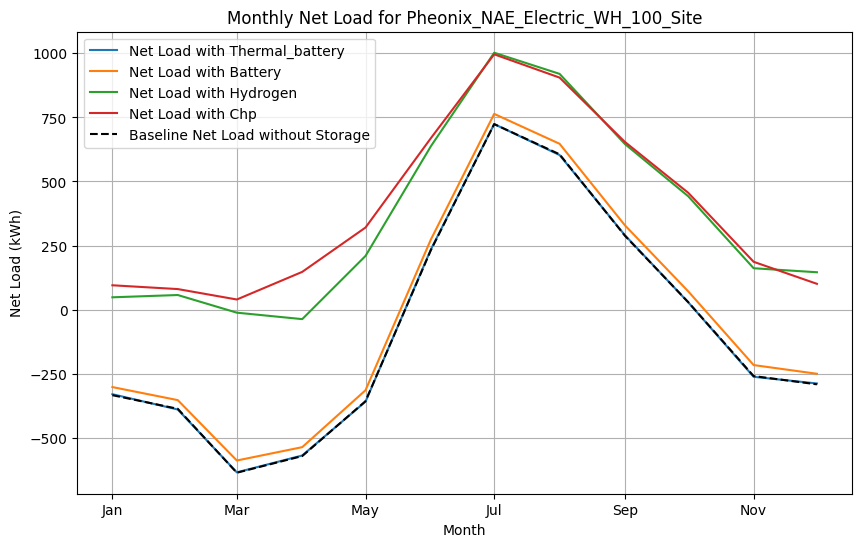

Loaded results from: /content/drive/MyDrive/Thesis/Results/Pheonix/Pheonix_NAE_Gas_WH_100_Site/Thermal_Battery_Results_Pheonix_NAE_Gas_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Pheonix/Pheonix_NAE_Gas_WH_100_Site/Battery_Results_Pheonix_NAE_Gas_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Pheonix/Pheonix_NAE_Gas_WH_100_Site/Hydrogen_Results_Pheonix_NAE_Gas_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Pheonix/Pheonix_NAE_Gas_WH_100_Site/CHP_Results_Pheonix_NAE_Gas_WH_100_Site.csv


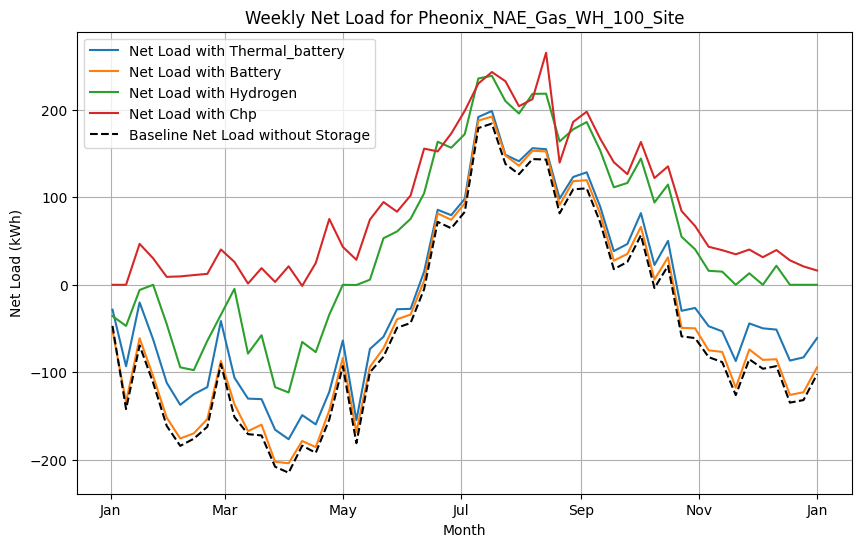

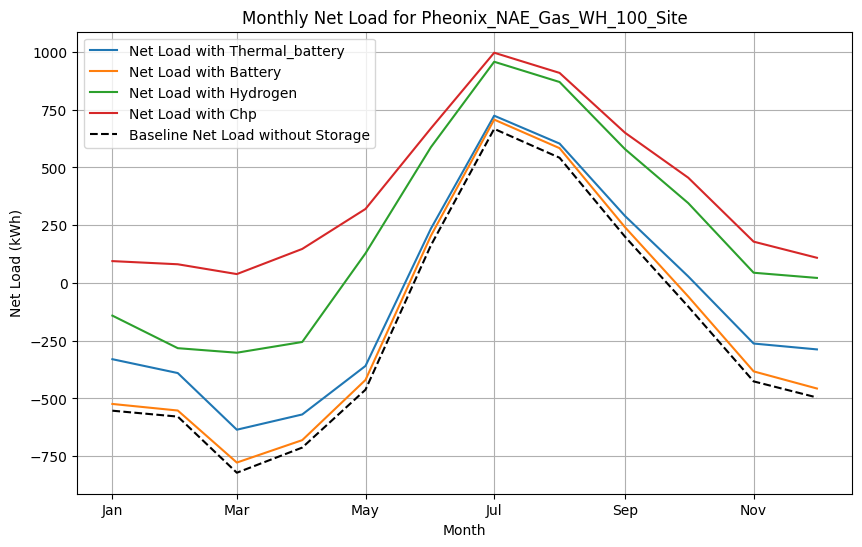

Loaded results from: /content/drive/MyDrive/Thesis/Results/Pheonix/Pheonix_AE_Electric_WH_100_Site/Thermal_Battery_Results_Pheonix_AE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Pheonix/Pheonix_AE_Electric_WH_100_Site/Battery_Results_Pheonix_AE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Pheonix/Pheonix_AE_Electric_WH_100_Site/Hydrogen_Results_Pheonix_AE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Pheonix/Pheonix_AE_Electric_WH_100_Site/CHP_Results_Pheonix_AE_Electric_WH_100_Site.csv


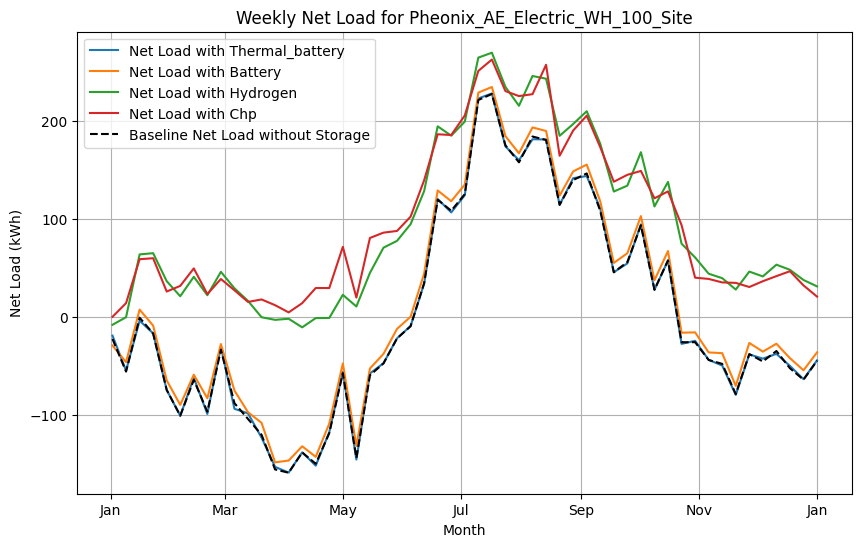

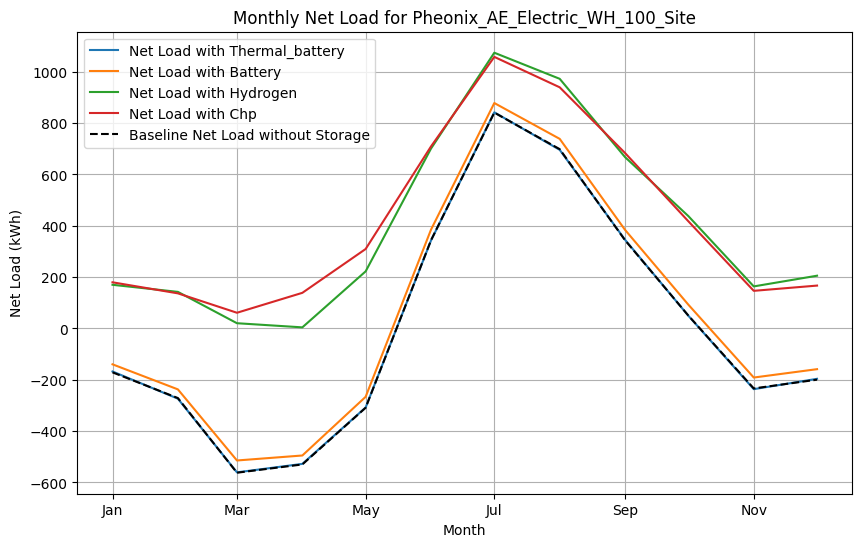

In [ ]:
# Run the analysis for a specific region
plot_net_load_for_all_configs("Phoenix")

Loaded results from: /content/drive/MyDrive/Thesis/Results/Pheonix/Pheonix_NAE_Electric_WH_100_Site/Thermal_Battery_Results_Pheonix_NAE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Pheonix/Pheonix_NAE_Electric_WH_100_Site/Battery_Results_Pheonix_NAE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Pheonix/Pheonix_NAE_Electric_WH_100_Site/Hydrogen_Results_Pheonix_NAE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Pheonix/Pheonix_NAE_Electric_WH_100_Site/CHP_Results_Pheonix_NAE_Electric_WH_100_Site.csv


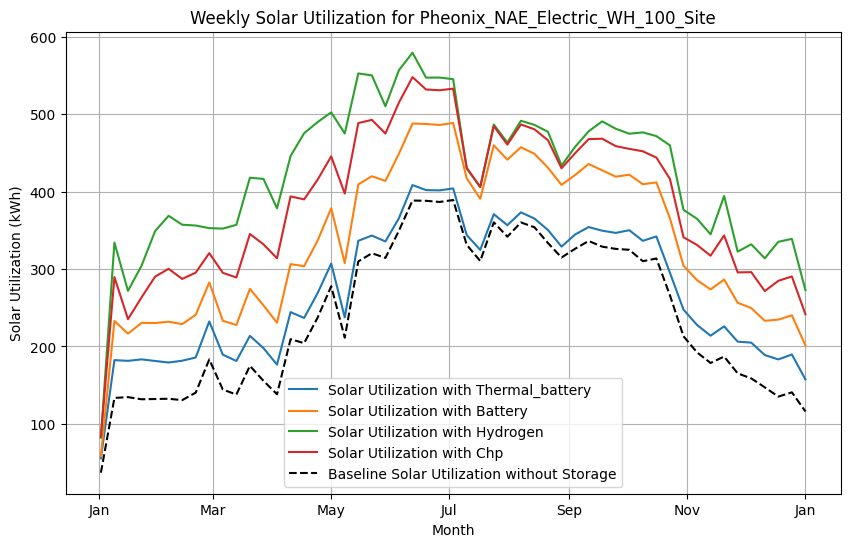

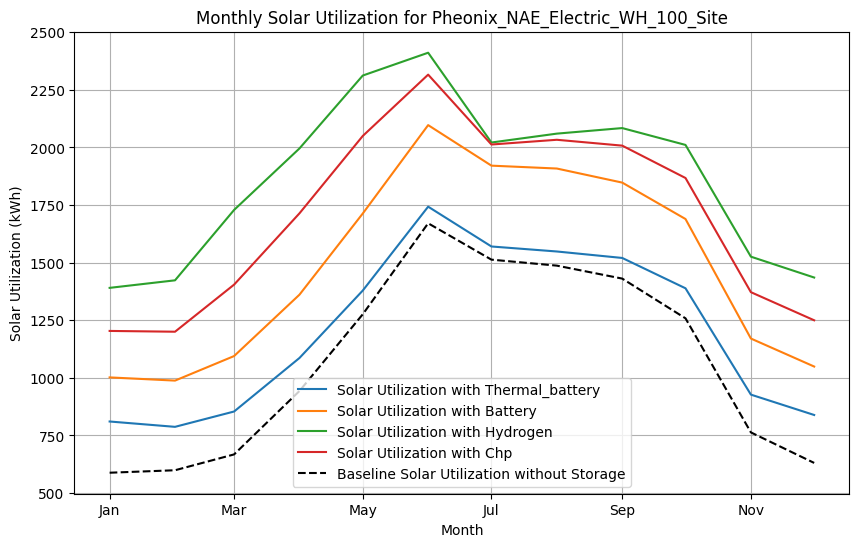

Loaded results from: /content/drive/MyDrive/Thesis/Results/Pheonix/Pheonix_NAE_Gas_WH_100_Site/Thermal_Battery_Results_Pheonix_NAE_Gas_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Pheonix/Pheonix_NAE_Gas_WH_100_Site/Battery_Results_Pheonix_NAE_Gas_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Pheonix/Pheonix_NAE_Gas_WH_100_Site/Hydrogen_Results_Pheonix_NAE_Gas_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Pheonix/Pheonix_NAE_Gas_WH_100_Site/CHP_Results_Pheonix_NAE_Gas_WH_100_Site.csv


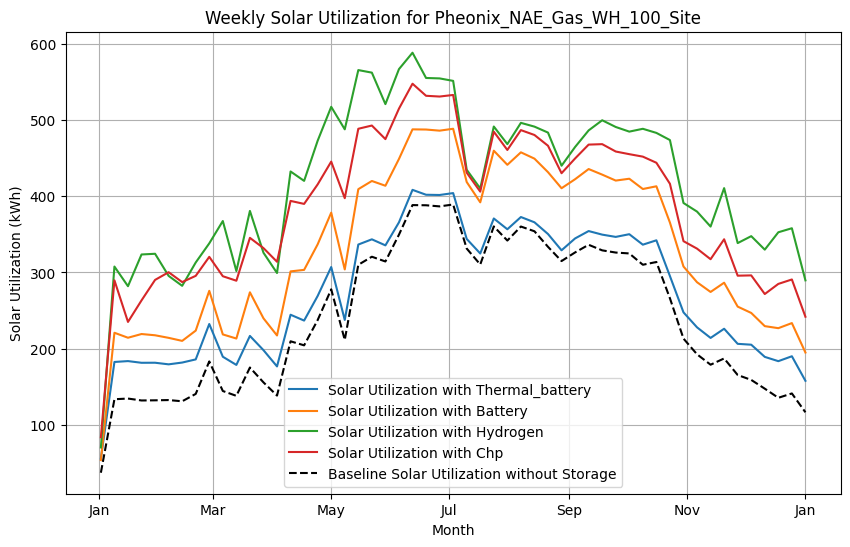

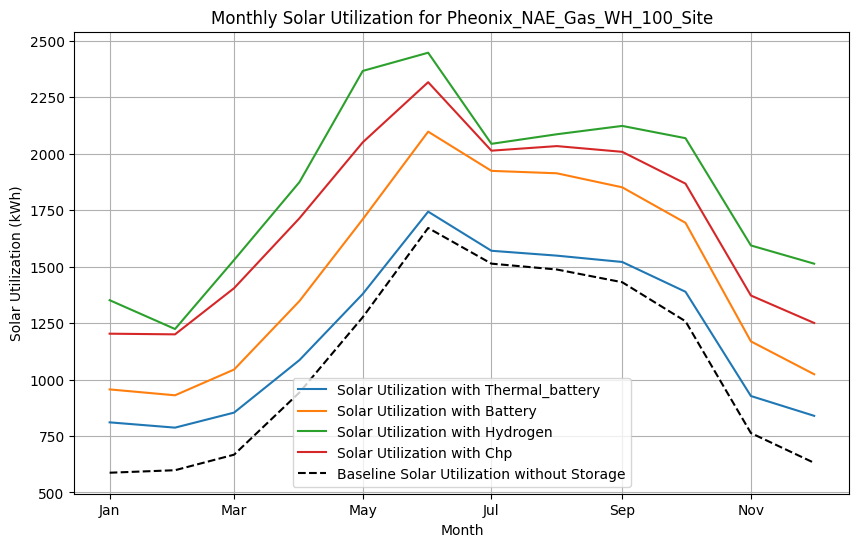

Loaded results from: /content/drive/MyDrive/Thesis/Results/Pheonix/Pheonix_AE_Electric_WH_100_Site/Thermal_Battery_Results_Pheonix_AE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Pheonix/Pheonix_AE_Electric_WH_100_Site/Battery_Results_Pheonix_AE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Pheonix/Pheonix_AE_Electric_WH_100_Site/Hydrogen_Results_Pheonix_AE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Pheonix/Pheonix_AE_Electric_WH_100_Site/CHP_Results_Pheonix_AE_Electric_WH_100_Site.csv


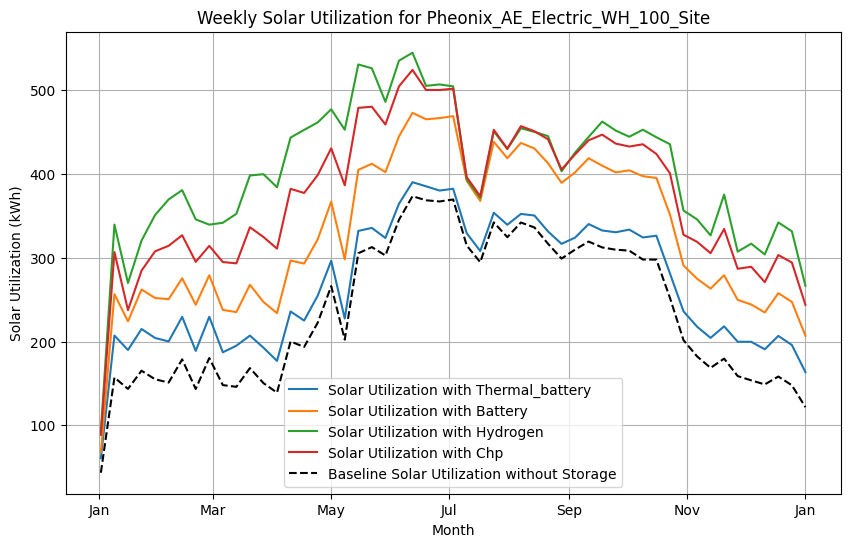

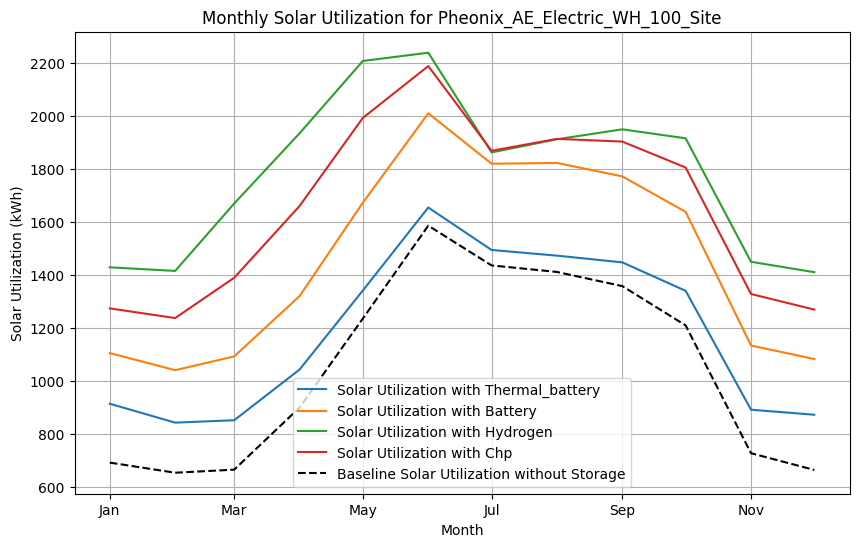

In [ ]:
plot_solar_utilization_for_all_configs("Pheonix")

Loaded results from: /content/drive/MyDrive/Thesis/Results/Pheonix/Pheonix_NAE_Electric_WH_100_Site/Thermal_Battery_Results_Pheonix_NAE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Pheonix/Pheonix_NAE_Electric_WH_100_Site/Battery_Results_Pheonix_NAE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Pheonix/Pheonix_NAE_Electric_WH_100_Site/Hydrogen_Results_Pheonix_NAE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Pheonix/Pheonix_NAE_Electric_WH_100_Site/CHP_Results_Pheonix_NAE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Pheonix/Pheonix_NAE_Gas_WH_100_Site/Thermal_Battery_Results_Pheonix_NAE_Gas_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Pheonix/Pheonix_NAE_Gas_WH_100_Site/Battery_Results_Pheonix_NAE_Gas_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Pheonix/Pheonix_NAE_Gas_WH_100

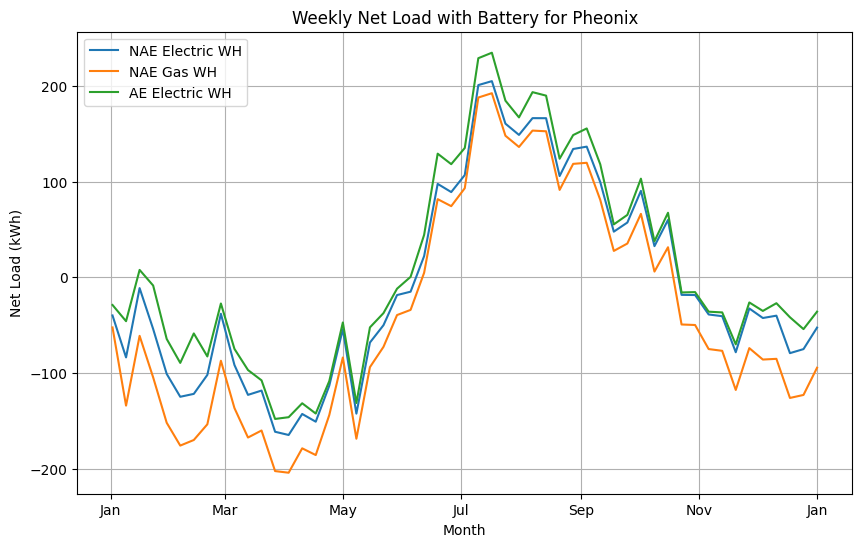

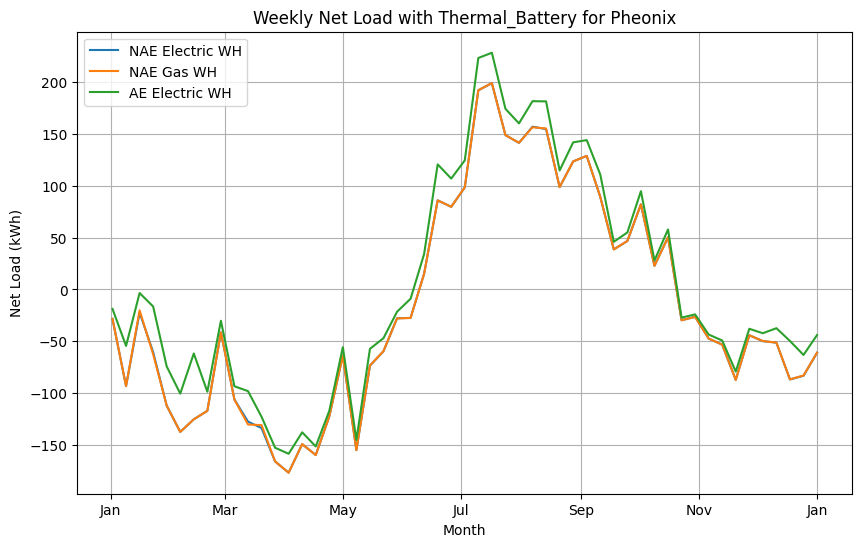

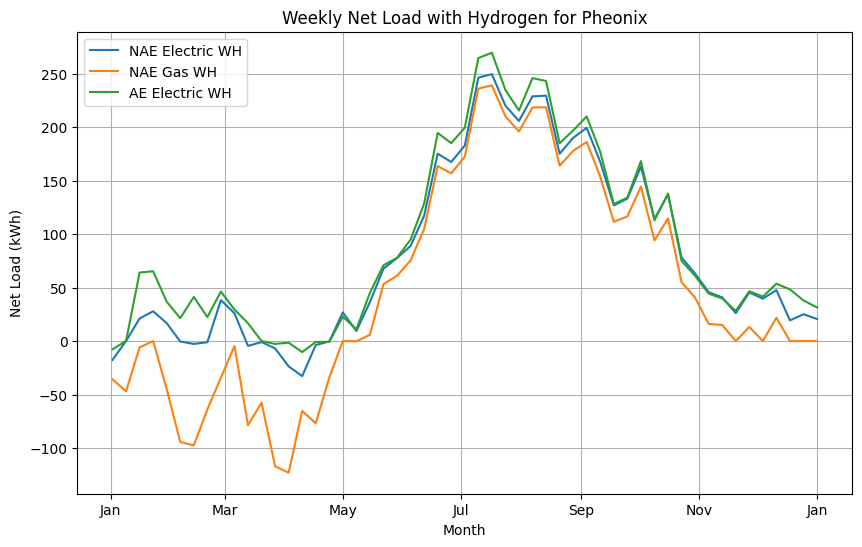

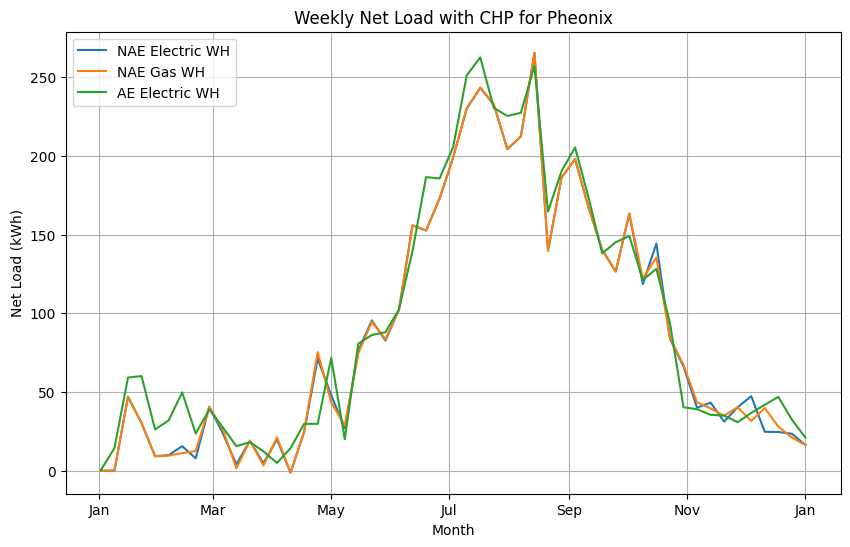

In [ ]:
plot_net_load_based_on_storage("Pheonix")

# Compare Cities

Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_NAE_Electric_WH_100_Site/Thermal_Battery_Results_Los_Angeles_NAE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_NAE_Electric_WH_100_Site/Battery_Results_Los_Angeles_NAE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_NAE_Electric_WH_100_Site/Hydrogen_Results_Los_Angeles_NAE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_NAE_Electric_WH_100_Site/CHP_Results_Los_Angeles_NAE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Boulder/Boulder_NAE_Electric_WH_100_Site/Thermal_Battery_Results_Boulder_NAE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Boulder/Boulder_NAE_Electric_WH_100_Site/Battery_Results_Boulder_NAE_Electric_WH_100_Site.csv
Loaded results from: 

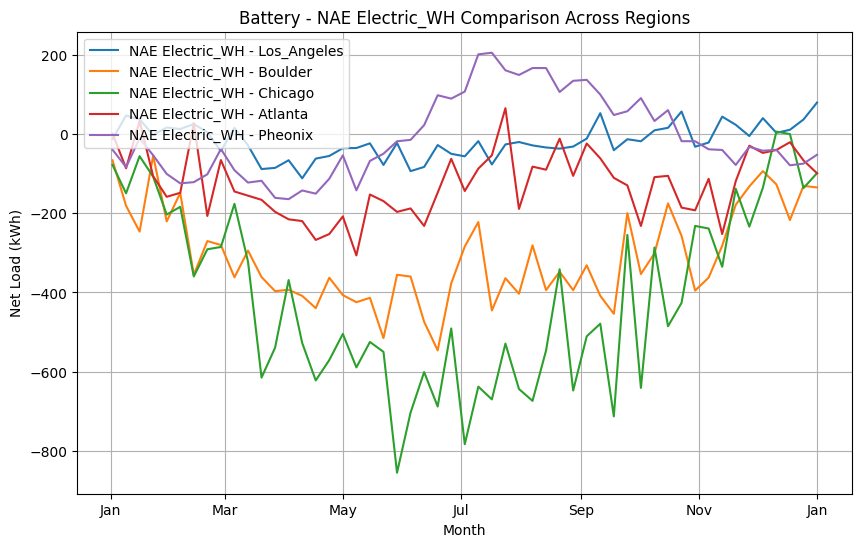

Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_NAE_Gas_WH_100_Site/Thermal_Battery_Results_Los_Angeles_NAE_Gas_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_NAE_Gas_WH_100_Site/Battery_Results_Los_Angeles_NAE_Gas_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_NAE_Gas_WH_100_Site/Hydrogen_Results_Los_Angeles_NAE_Gas_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_NAE_Gas_WH_100_Site/CHP_Results_Los_Angeles_NAE_Gas_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Boulder/Boulder_NAE_Gas_WH_100_Site/Thermal_Battery_Results_Boulder_NAE_Gas_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Boulder/Boulder_NAE_Gas_WH_100_Site/Battery_Results_Boulder_NAE_Gas_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Boulder/Boulder_NAE_Ga

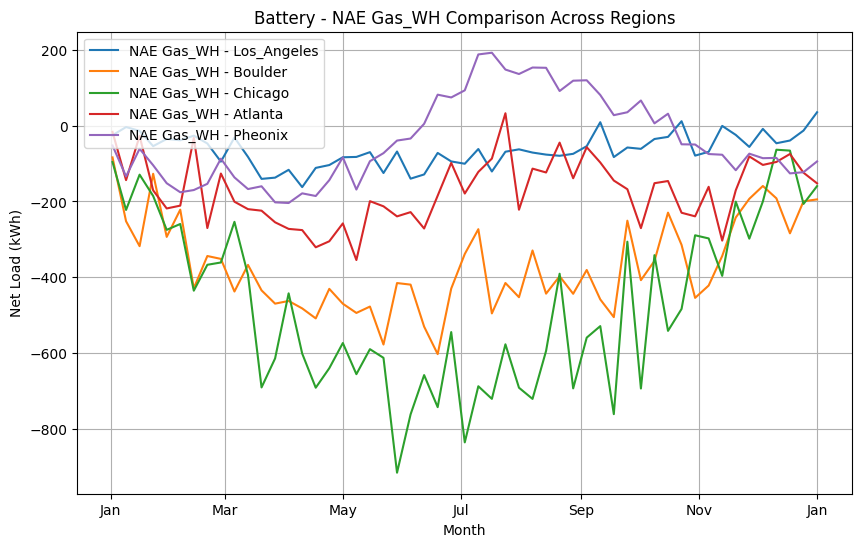

Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_AE_Electric_WH_100_Site/Thermal_Battery_Results_Los_Angeles_AE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_AE_Electric_WH_100_Site/Battery_Results_Los_Angeles_AE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_AE_Electric_WH_100_Site/Hydrogen_Results_Los_Angeles_AE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_AE_Electric_WH_100_Site/CHP_Results_Los_Angeles_AE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Boulder/Boulder_AE_Electric_WH_100_Site/Thermal_Battery_Results_Boulder_AE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Boulder/Boulder_AE_Electric_WH_100_Site/Battery_Results_Boulder_AE_Electric_WH_100_Site.csv
Loaded results from: /content/dri

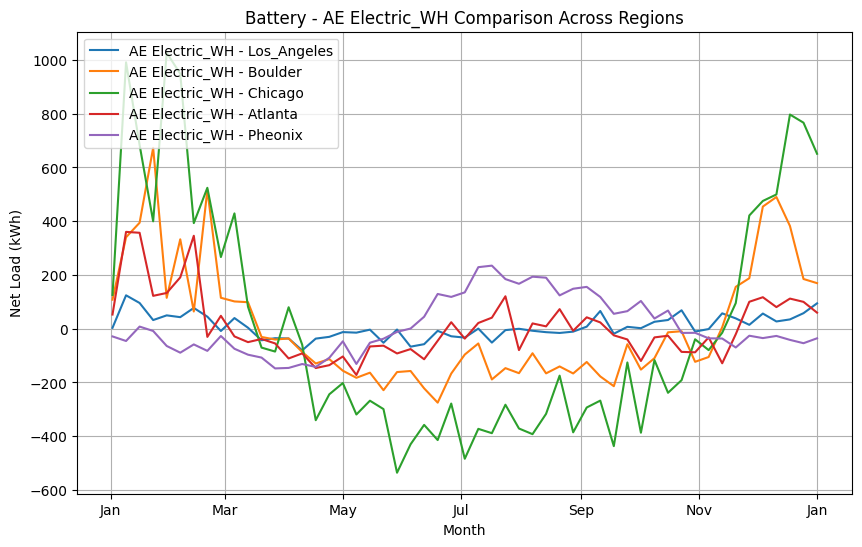

Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_NAE_Electric_WH_100_Site/Thermal_Battery_Results_Los_Angeles_NAE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_NAE_Electric_WH_100_Site/Battery_Results_Los_Angeles_NAE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_NAE_Electric_WH_100_Site/Hydrogen_Results_Los_Angeles_NAE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_NAE_Electric_WH_100_Site/CHP_Results_Los_Angeles_NAE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Boulder/Boulder_NAE_Electric_WH_100_Site/Thermal_Battery_Results_Boulder_NAE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Boulder/Boulder_NAE_Electric_WH_100_Site/Battery_Results_Boulder_NAE_Electric_WH_100_Site.csv
Loaded results from: 

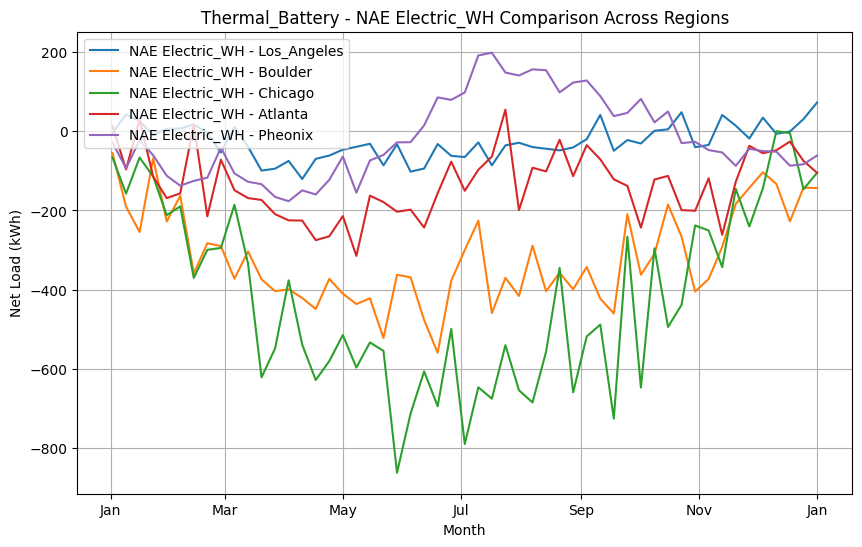

Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_NAE_Gas_WH_100_Site/Thermal_Battery_Results_Los_Angeles_NAE_Gas_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_NAE_Gas_WH_100_Site/Battery_Results_Los_Angeles_NAE_Gas_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_NAE_Gas_WH_100_Site/Hydrogen_Results_Los_Angeles_NAE_Gas_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_NAE_Gas_WH_100_Site/CHP_Results_Los_Angeles_NAE_Gas_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Boulder/Boulder_NAE_Gas_WH_100_Site/Thermal_Battery_Results_Boulder_NAE_Gas_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Boulder/Boulder_NAE_Gas_WH_100_Site/Battery_Results_Boulder_NAE_Gas_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Boulder/Boulder_NAE_Ga

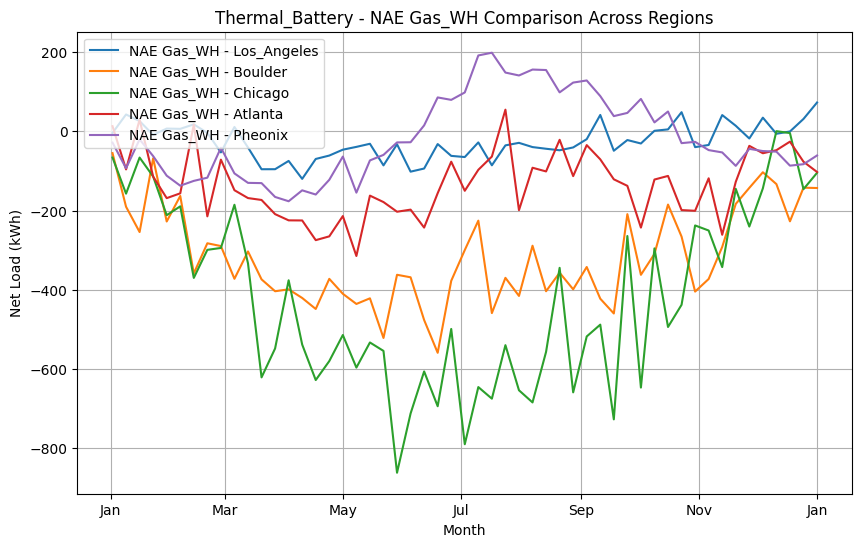

Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_AE_Electric_WH_100_Site/Thermal_Battery_Results_Los_Angeles_AE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_AE_Electric_WH_100_Site/Battery_Results_Los_Angeles_AE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_AE_Electric_WH_100_Site/Hydrogen_Results_Los_Angeles_AE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_AE_Electric_WH_100_Site/CHP_Results_Los_Angeles_AE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Boulder/Boulder_AE_Electric_WH_100_Site/Thermal_Battery_Results_Boulder_AE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Boulder/Boulder_AE_Electric_WH_100_Site/Battery_Results_Boulder_AE_Electric_WH_100_Site.csv
Loaded results from: /content/dri

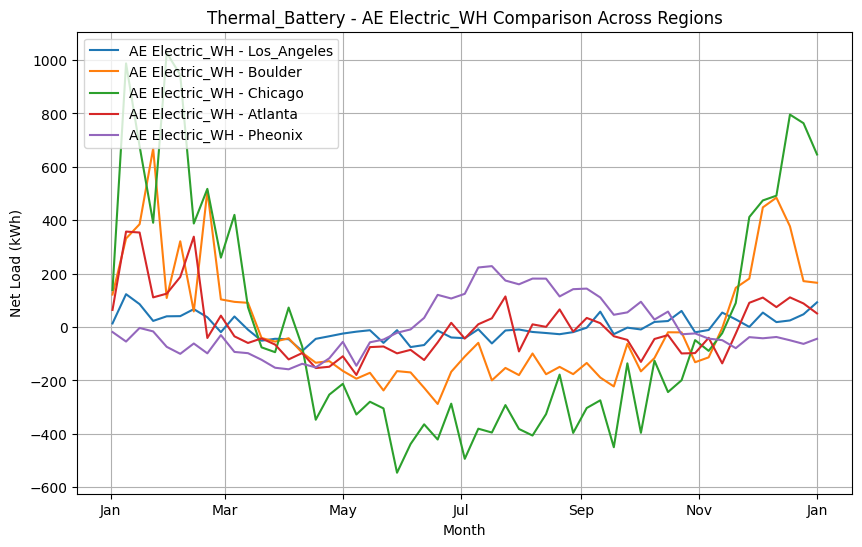

Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_NAE_Electric_WH_100_Site/Thermal_Battery_Results_Los_Angeles_NAE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_NAE_Electric_WH_100_Site/Battery_Results_Los_Angeles_NAE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_NAE_Electric_WH_100_Site/Hydrogen_Results_Los_Angeles_NAE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_NAE_Electric_WH_100_Site/CHP_Results_Los_Angeles_NAE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Boulder/Boulder_NAE_Electric_WH_100_Site/Thermal_Battery_Results_Boulder_NAE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Boulder/Boulder_NAE_Electric_WH_100_Site/Battery_Results_Boulder_NAE_Electric_WH_100_Site.csv
Loaded results from: 

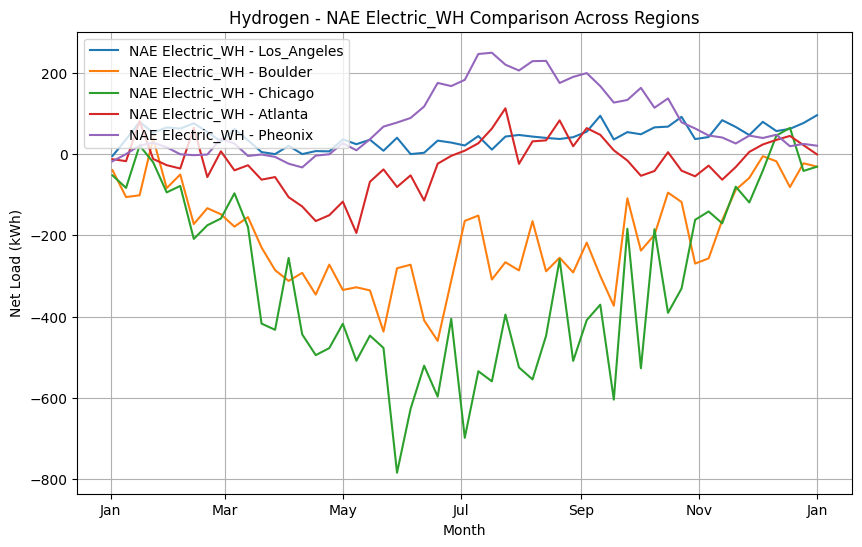

Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_NAE_Gas_WH_100_Site/Thermal_Battery_Results_Los_Angeles_NAE_Gas_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_NAE_Gas_WH_100_Site/Battery_Results_Los_Angeles_NAE_Gas_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_NAE_Gas_WH_100_Site/Hydrogen_Results_Los_Angeles_NAE_Gas_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_NAE_Gas_WH_100_Site/CHP_Results_Los_Angeles_NAE_Gas_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Boulder/Boulder_NAE_Gas_WH_100_Site/Thermal_Battery_Results_Boulder_NAE_Gas_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Boulder/Boulder_NAE_Gas_WH_100_Site/Battery_Results_Boulder_NAE_Gas_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Boulder/Boulder_NAE_Ga

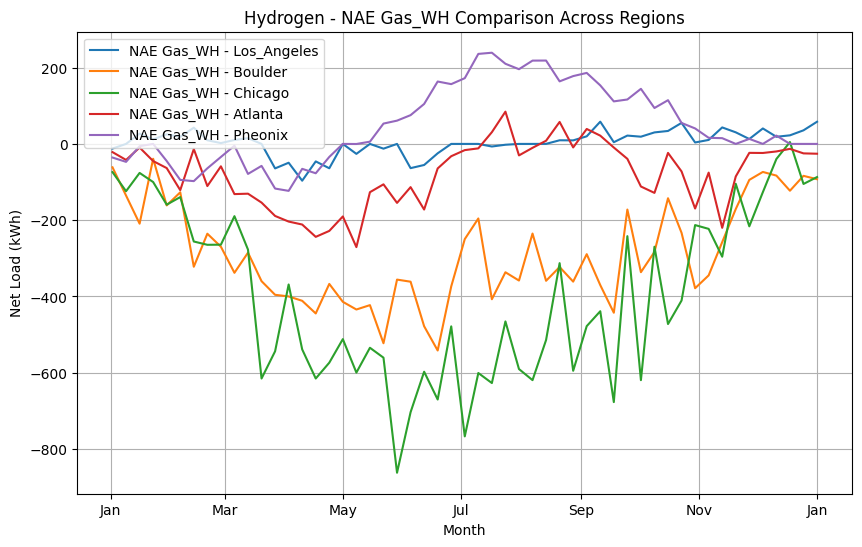

Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_AE_Electric_WH_100_Site/Thermal_Battery_Results_Los_Angeles_AE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_AE_Electric_WH_100_Site/Battery_Results_Los_Angeles_AE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_AE_Electric_WH_100_Site/Hydrogen_Results_Los_Angeles_AE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_AE_Electric_WH_100_Site/CHP_Results_Los_Angeles_AE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Boulder/Boulder_AE_Electric_WH_100_Site/Thermal_Battery_Results_Boulder_AE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Boulder/Boulder_AE_Electric_WH_100_Site/Battery_Results_Boulder_AE_Electric_WH_100_Site.csv
Loaded results from: /content/dri

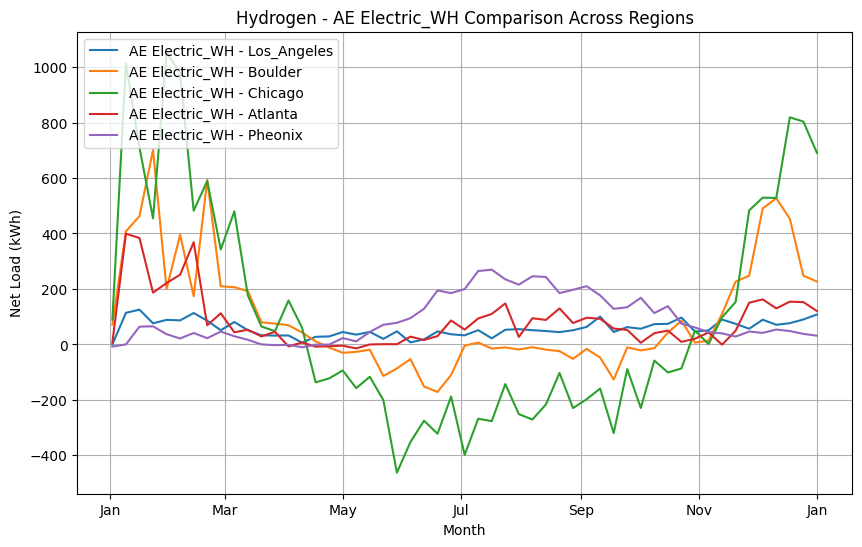

Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_NAE_Electric_WH_100_Site/Thermal_Battery_Results_Los_Angeles_NAE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_NAE_Electric_WH_100_Site/Battery_Results_Los_Angeles_NAE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_NAE_Electric_WH_100_Site/Hydrogen_Results_Los_Angeles_NAE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_NAE_Electric_WH_100_Site/CHP_Results_Los_Angeles_NAE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Boulder/Boulder_NAE_Electric_WH_100_Site/Thermal_Battery_Results_Boulder_NAE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Boulder/Boulder_NAE_Electric_WH_100_Site/Battery_Results_Boulder_NAE_Electric_WH_100_Site.csv
Loaded results from: 

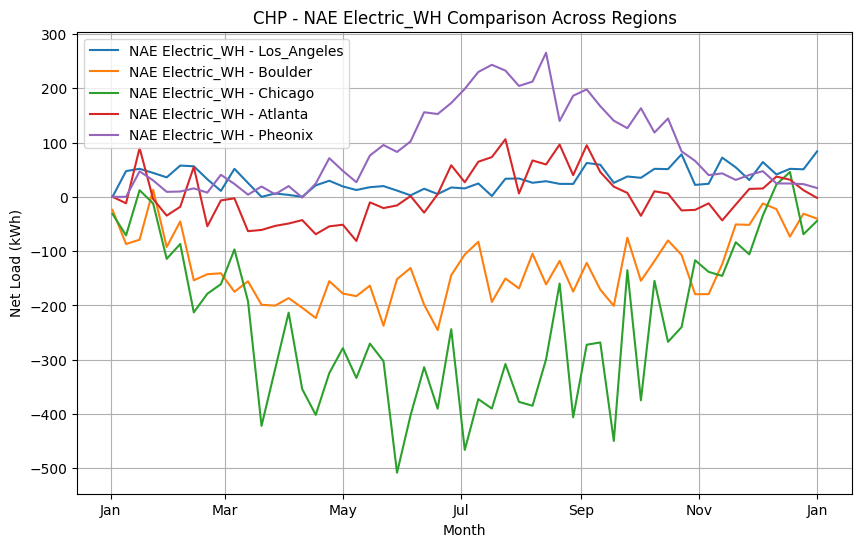

Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_NAE_Gas_WH_100_Site/Thermal_Battery_Results_Los_Angeles_NAE_Gas_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_NAE_Gas_WH_100_Site/Battery_Results_Los_Angeles_NAE_Gas_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_NAE_Gas_WH_100_Site/Hydrogen_Results_Los_Angeles_NAE_Gas_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_NAE_Gas_WH_100_Site/CHP_Results_Los_Angeles_NAE_Gas_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Boulder/Boulder_NAE_Gas_WH_100_Site/Thermal_Battery_Results_Boulder_NAE_Gas_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Boulder/Boulder_NAE_Gas_WH_100_Site/Battery_Results_Boulder_NAE_Gas_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Boulder/Boulder_NAE_Ga

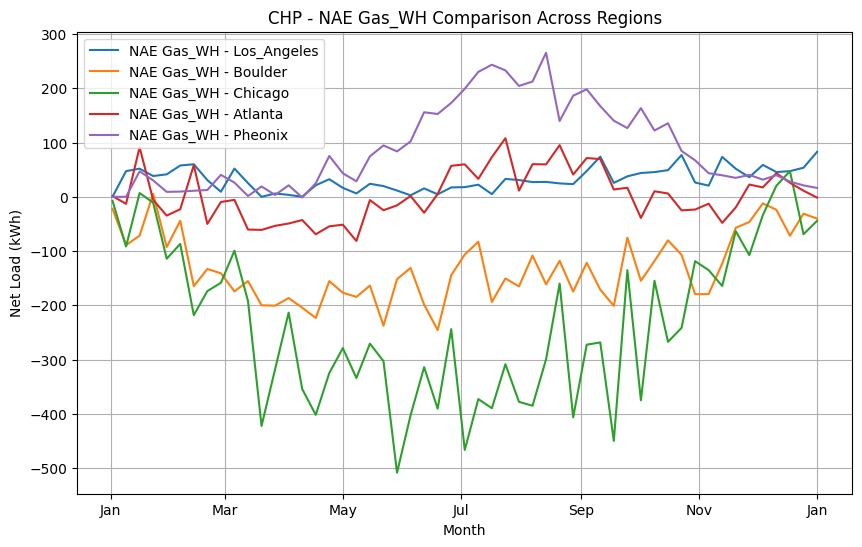

Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_AE_Electric_WH_100_Site/Thermal_Battery_Results_Los_Angeles_AE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_AE_Electric_WH_100_Site/Battery_Results_Los_Angeles_AE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_AE_Electric_WH_100_Site/Hydrogen_Results_Los_Angeles_AE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_AE_Electric_WH_100_Site/CHP_Results_Los_Angeles_AE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Boulder/Boulder_AE_Electric_WH_100_Site/Thermal_Battery_Results_Boulder_AE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Boulder/Boulder_AE_Electric_WH_100_Site/Battery_Results_Boulder_AE_Electric_WH_100_Site.csv
Loaded results from: /content/dri

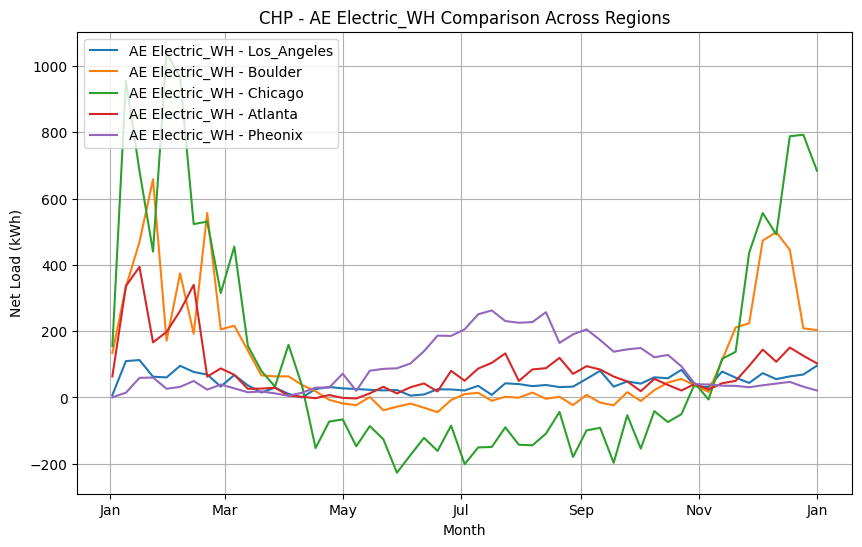

Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_NAE_Electric_WH_100_Site/Thermal_Battery_Results_Los_Angeles_NAE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_NAE_Electric_WH_100_Site/Battery_Results_Los_Angeles_NAE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_NAE_Electric_WH_100_Site/Hydrogen_Results_Los_Angeles_NAE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_NAE_Electric_WH_100_Site/CHP_Results_Los_Angeles_NAE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Boulder/Boulder_NAE_Electric_WH_100_Site/Thermal_Battery_Results_Boulder_NAE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Boulder/Boulder_NAE_Electric_WH_100_Site/Battery_Results_Boulder_NAE_Electric_WH_100_Site.csv
Loaded results from: 

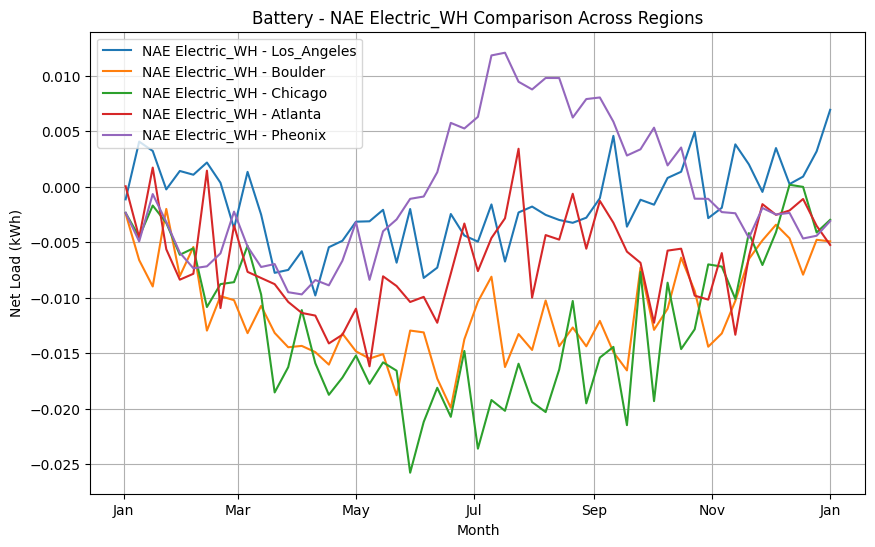

Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_NAE_Gas_WH_100_Site/Thermal_Battery_Results_Los_Angeles_NAE_Gas_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_NAE_Gas_WH_100_Site/Battery_Results_Los_Angeles_NAE_Gas_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_NAE_Gas_WH_100_Site/Hydrogen_Results_Los_Angeles_NAE_Gas_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_NAE_Gas_WH_100_Site/CHP_Results_Los_Angeles_NAE_Gas_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Boulder/Boulder_NAE_Gas_WH_100_Site/Thermal_Battery_Results_Boulder_NAE_Gas_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Boulder/Boulder_NAE_Gas_WH_100_Site/Battery_Results_Boulder_NAE_Gas_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Boulder/Boulder_NAE_Ga

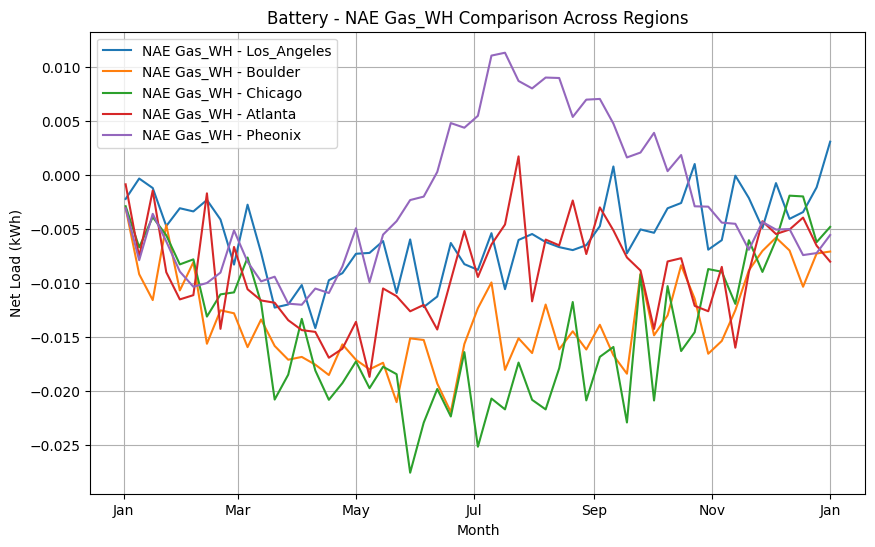

Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_AE_Electric_WH_100_Site/Thermal_Battery_Results_Los_Angeles_AE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_AE_Electric_WH_100_Site/Battery_Results_Los_Angeles_AE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_AE_Electric_WH_100_Site/Hydrogen_Results_Los_Angeles_AE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_AE_Electric_WH_100_Site/CHP_Results_Los_Angeles_AE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Boulder/Boulder_AE_Electric_WH_100_Site/Thermal_Battery_Results_Boulder_AE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Boulder/Boulder_AE_Electric_WH_100_Site/Battery_Results_Boulder_AE_Electric_WH_100_Site.csv
Loaded results from: /content/dri

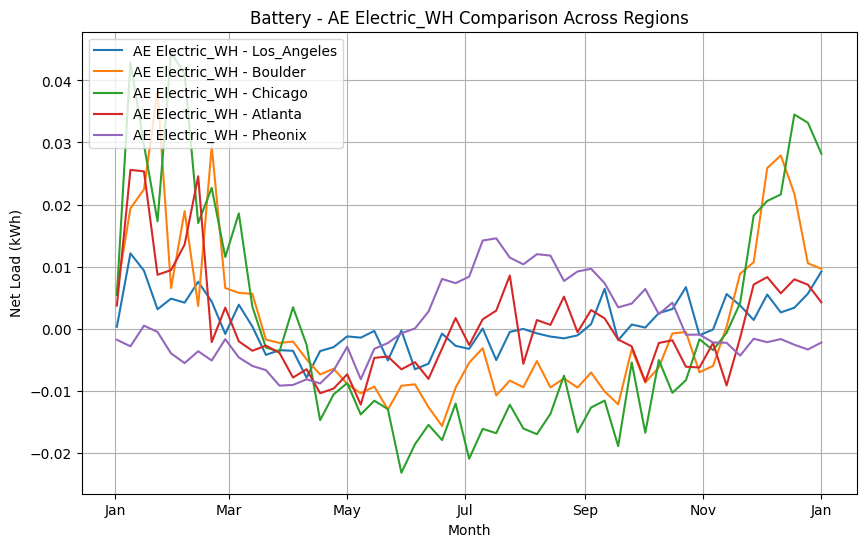

Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_NAE_Electric_WH_100_Site/Thermal_Battery_Results_Los_Angeles_NAE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_NAE_Electric_WH_100_Site/Battery_Results_Los_Angeles_NAE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_NAE_Electric_WH_100_Site/Hydrogen_Results_Los_Angeles_NAE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_NAE_Electric_WH_100_Site/CHP_Results_Los_Angeles_NAE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Boulder/Boulder_NAE_Electric_WH_100_Site/Thermal_Battery_Results_Boulder_NAE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Boulder/Boulder_NAE_Electric_WH_100_Site/Battery_Results_Boulder_NAE_Electric_WH_100_Site.csv
Loaded results from: 

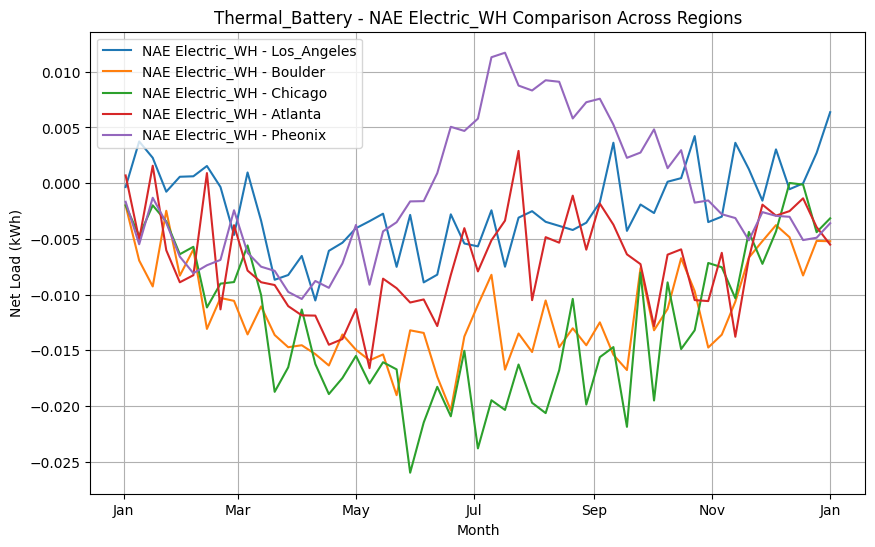

Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_NAE_Gas_WH_100_Site/Thermal_Battery_Results_Los_Angeles_NAE_Gas_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_NAE_Gas_WH_100_Site/Battery_Results_Los_Angeles_NAE_Gas_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_NAE_Gas_WH_100_Site/Hydrogen_Results_Los_Angeles_NAE_Gas_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_NAE_Gas_WH_100_Site/CHP_Results_Los_Angeles_NAE_Gas_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Boulder/Boulder_NAE_Gas_WH_100_Site/Thermal_Battery_Results_Boulder_NAE_Gas_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Boulder/Boulder_NAE_Gas_WH_100_Site/Battery_Results_Boulder_NAE_Gas_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Boulder/Boulder_NAE_Ga

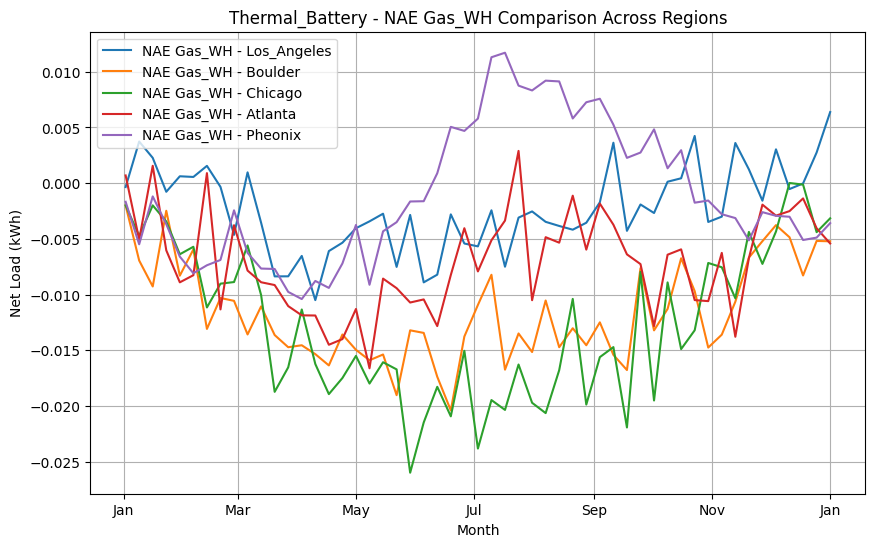

Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_AE_Electric_WH_100_Site/Thermal_Battery_Results_Los_Angeles_AE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_AE_Electric_WH_100_Site/Battery_Results_Los_Angeles_AE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_AE_Electric_WH_100_Site/Hydrogen_Results_Los_Angeles_AE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_AE_Electric_WH_100_Site/CHP_Results_Los_Angeles_AE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Boulder/Boulder_AE_Electric_WH_100_Site/Thermal_Battery_Results_Boulder_AE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Boulder/Boulder_AE_Electric_WH_100_Site/Battery_Results_Boulder_AE_Electric_WH_100_Site.csv
Loaded results from: /content/dri

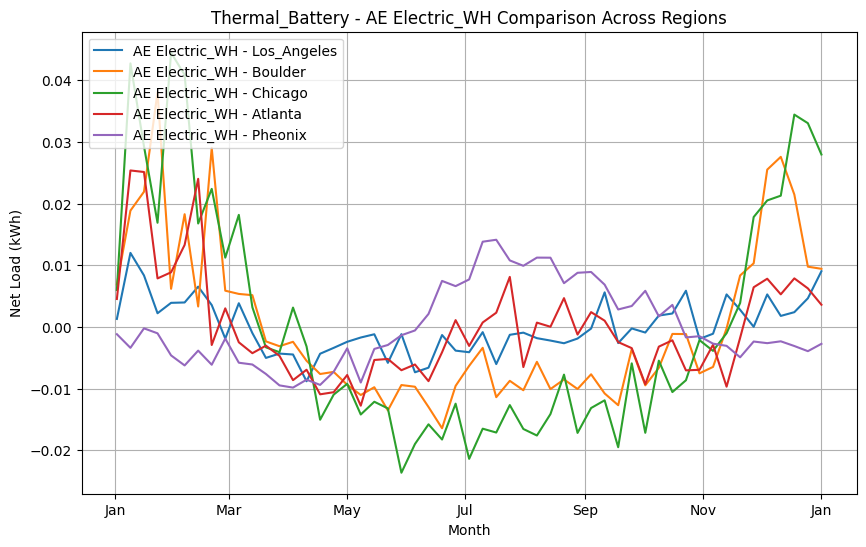

Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_NAE_Electric_WH_100_Site/Thermal_Battery_Results_Los_Angeles_NAE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_NAE_Electric_WH_100_Site/Battery_Results_Los_Angeles_NAE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_NAE_Electric_WH_100_Site/Hydrogen_Results_Los_Angeles_NAE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_NAE_Electric_WH_100_Site/CHP_Results_Los_Angeles_NAE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Boulder/Boulder_NAE_Electric_WH_100_Site/Thermal_Battery_Results_Boulder_NAE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Boulder/Boulder_NAE_Electric_WH_100_Site/Battery_Results_Boulder_NAE_Electric_WH_100_Site.csv
Loaded results from: 

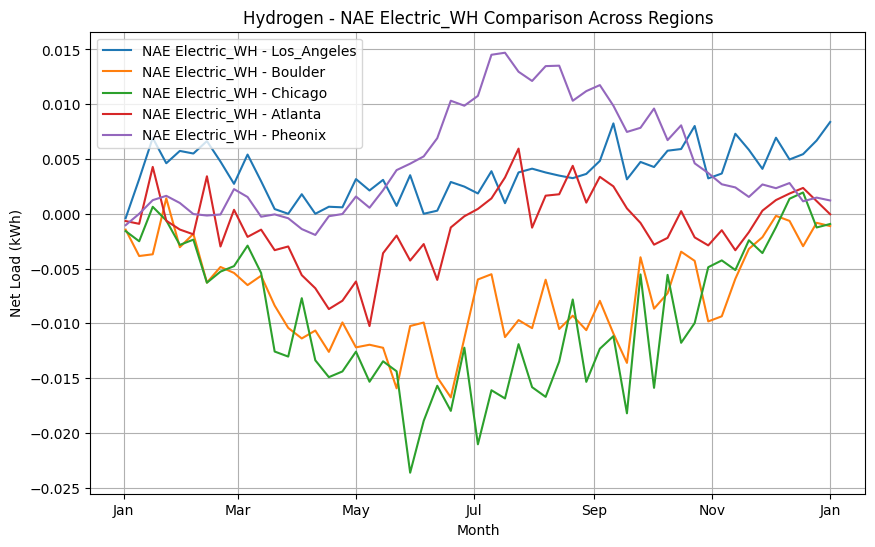

Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_NAE_Gas_WH_100_Site/Thermal_Battery_Results_Los_Angeles_NAE_Gas_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_NAE_Gas_WH_100_Site/Battery_Results_Los_Angeles_NAE_Gas_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_NAE_Gas_WH_100_Site/Hydrogen_Results_Los_Angeles_NAE_Gas_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_NAE_Gas_WH_100_Site/CHP_Results_Los_Angeles_NAE_Gas_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Boulder/Boulder_NAE_Gas_WH_100_Site/Thermal_Battery_Results_Boulder_NAE_Gas_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Boulder/Boulder_NAE_Gas_WH_100_Site/Battery_Results_Boulder_NAE_Gas_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Boulder/Boulder_NAE_Ga

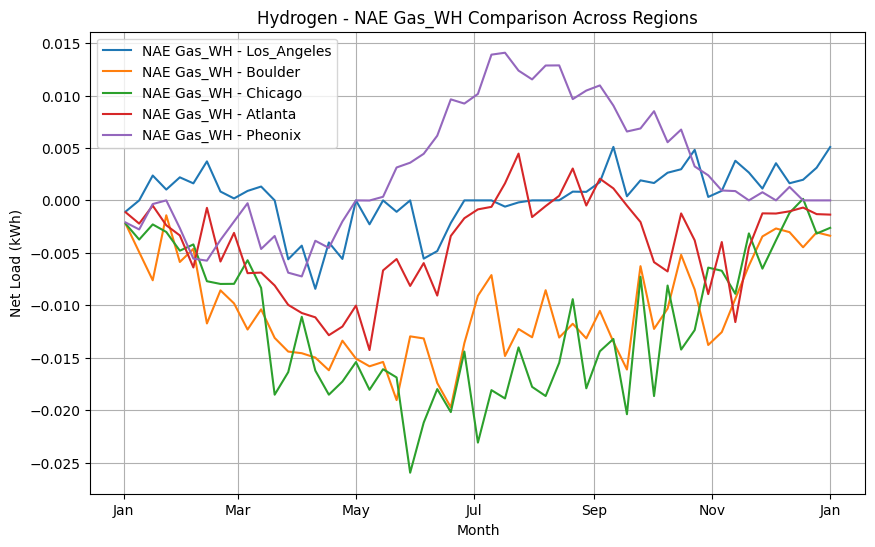

Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_AE_Electric_WH_100_Site/Thermal_Battery_Results_Los_Angeles_AE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_AE_Electric_WH_100_Site/Battery_Results_Los_Angeles_AE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_AE_Electric_WH_100_Site/Hydrogen_Results_Los_Angeles_AE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_AE_Electric_WH_100_Site/CHP_Results_Los_Angeles_AE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Boulder/Boulder_AE_Electric_WH_100_Site/Thermal_Battery_Results_Boulder_AE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Boulder/Boulder_AE_Electric_WH_100_Site/Battery_Results_Boulder_AE_Electric_WH_100_Site.csv
Loaded results from: /content/dri

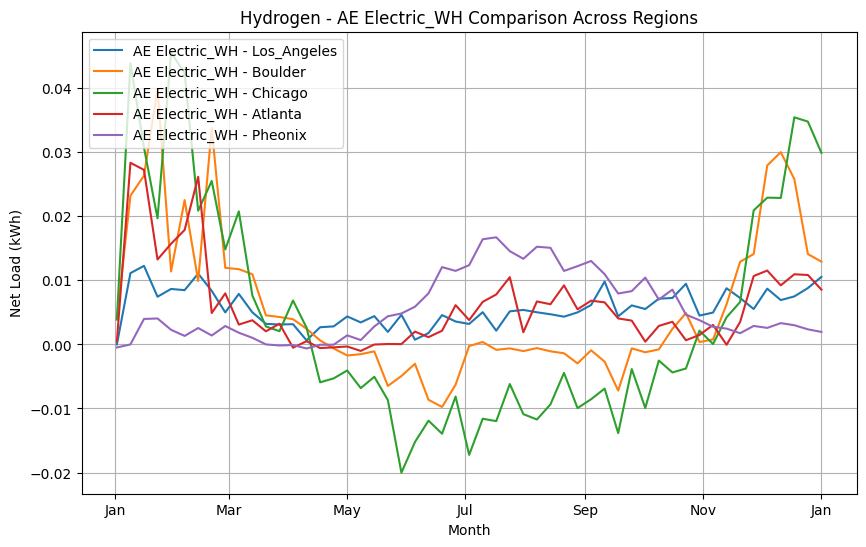

Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_NAE_Electric_WH_100_Site/Thermal_Battery_Results_Los_Angeles_NAE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_NAE_Electric_WH_100_Site/Battery_Results_Los_Angeles_NAE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_NAE_Electric_WH_100_Site/Hydrogen_Results_Los_Angeles_NAE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_NAE_Electric_WH_100_Site/CHP_Results_Los_Angeles_NAE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Boulder/Boulder_NAE_Electric_WH_100_Site/Thermal_Battery_Results_Boulder_NAE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Boulder/Boulder_NAE_Electric_WH_100_Site/Battery_Results_Boulder_NAE_Electric_WH_100_Site.csv
Loaded results from: 

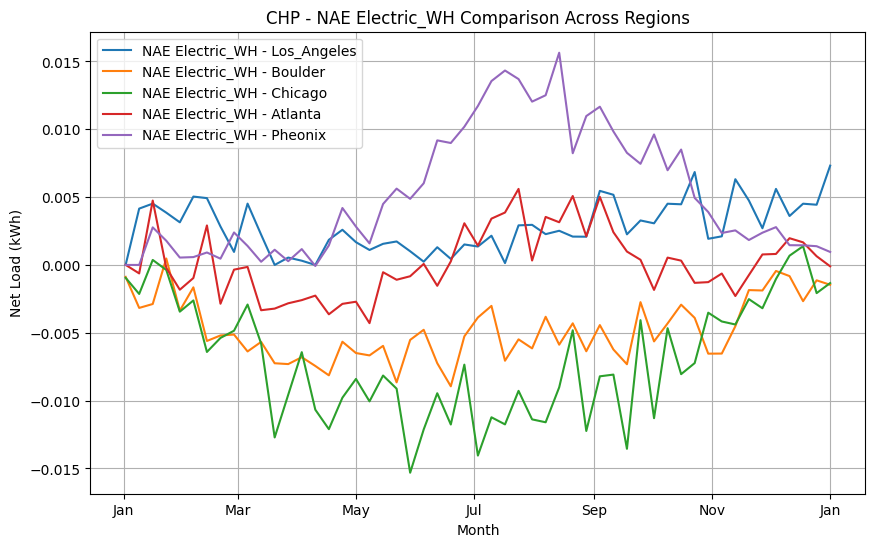

Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_NAE_Gas_WH_100_Site/Thermal_Battery_Results_Los_Angeles_NAE_Gas_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_NAE_Gas_WH_100_Site/Battery_Results_Los_Angeles_NAE_Gas_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_NAE_Gas_WH_100_Site/Hydrogen_Results_Los_Angeles_NAE_Gas_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_NAE_Gas_WH_100_Site/CHP_Results_Los_Angeles_NAE_Gas_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Boulder/Boulder_NAE_Gas_WH_100_Site/Thermal_Battery_Results_Boulder_NAE_Gas_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Boulder/Boulder_NAE_Gas_WH_100_Site/Battery_Results_Boulder_NAE_Gas_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Boulder/Boulder_NAE_Ga

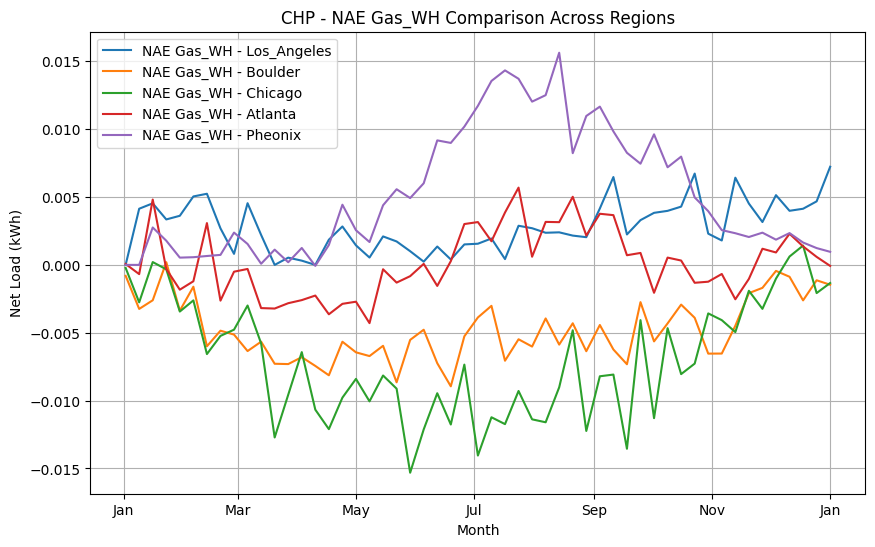

Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_AE_Electric_WH_100_Site/Thermal_Battery_Results_Los_Angeles_AE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_AE_Electric_WH_100_Site/Battery_Results_Los_Angeles_AE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_AE_Electric_WH_100_Site/Hydrogen_Results_Los_Angeles_AE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_AE_Electric_WH_100_Site/CHP_Results_Los_Angeles_AE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Boulder/Boulder_AE_Electric_WH_100_Site/Thermal_Battery_Results_Boulder_AE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Boulder/Boulder_AE_Electric_WH_100_Site/Battery_Results_Boulder_AE_Electric_WH_100_Site.csv
Loaded results from: /content/dri

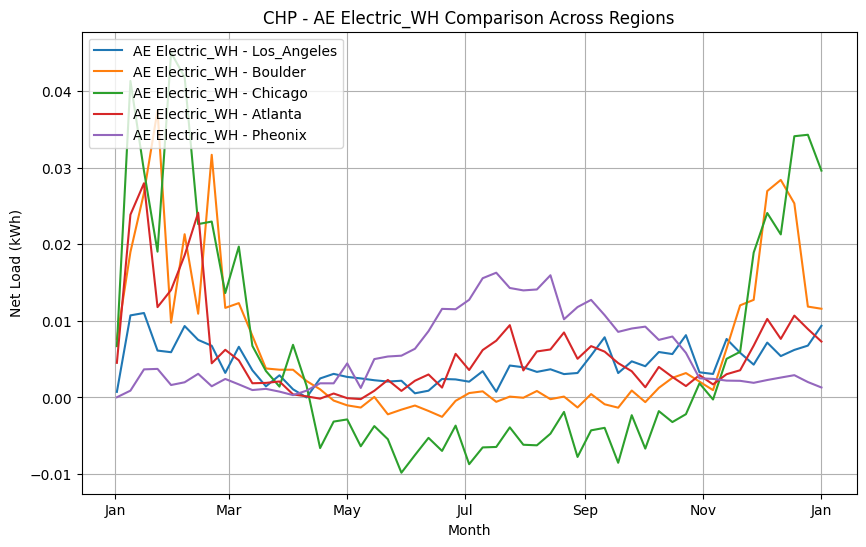

In [ ]:
# To compare cities without normalization (default setting):
compare_cities_net_load_storage("Los_Angeles", "Boulder", "Chicago", "Atlanta", "Pheonix")
# To compare cities with normalized net load (normalizing by PV generation size):
compare_cities_net_load_storage("Los_Angeles", "Boulder", "Chicago", "Atlanta", "Pheonix", normalize=True)

# Analysis


## New Try Wed

In [ ]:
import pandas as pd
import os
import numpy as np

# Function to calculate self-consumption for electric battery only
def calculate_self_consumption(results):
    # Baseline calculations (without energy storage)
    results['Self_Consumption_Baseline_1'] = np.minimum(results['P_PV'], results['P_Total_Load'])
    results['Self_Consumption_Baseline_2'] = results['P_PV'] - results['P_Grid_To_Without_B']
    results['Self_Consumption_Baseline_3'] = results['P_Total_Load'] - results['P_Grid_From_Without_B']

    # Methods considering energy storage
    results['Self_Consumption_Method_1'] = results['P_PV'] - results['P_Grid_To']why
    results['Self_Consumption_Method_2'] = results['Self_Consumption'] + results['P_B_Ch']
    results['Self_Consumption_Method_3'] = results['Self_Consumption'] + results['P_B_Dis']
    return results

# Function to calculate on-site solar utilization
def calculate_on_site_utilization(results):
    # On-site solar utilization calculations
    results['On_Site_Utilization_1'] = results['P_PV'] - results['P_Grid_To']
    results['On_Site_Utilization_2'] = results['Self_Consumption'] + results['P_B_Dis']
    results['On_Site_Utilization_3'] = results['P_Total_Load'] - results['P_Grid_From'] + results['P_B_Dis']
    return results

# Function to load a result file, calculate self-consumption, and print the results
def validate_self_consumption(file_path):
    try:
        # Load the results file
        results = pd.read_csv(file_path)

        # Calculate self-consumption using different approaches
        results = calculate_self_consumption(results)

        # Calculate on-site solar utilization
        results = calculate_on_site_utilization(results)

        # Print self-consumption results
        print("\nSelf-consumption calculations for file:", os.path.basename(file_path))
        for method in ['Self_Consumption_Baseline_1', 'Self_Consumption_Baseline_2', 'Self_Consumption_Baseline_3', 'Self_Consumption_Method_1', 'Self_Consumption_Method_2', 'Self_Consumption_Method_3']:
            total = results[method].sum()
            percentage = (total / results['P_PV'].sum()) * 100 if results['P_PV'].sum() > 0 else 0
            print(f"{method} (Total): {total}, Percentage: {percentage:.2f}%")

        # Print on-site solar utilization results
        print("\nOn-site solar utilization calculations for file:", os.path.basename(file_path))
        for method in ['On_Site_Utilization_1', 'On_Site_Utilization_2', 'On_Site_Utilization_3']:
            total = results[method].sum()
            percentage = (total / results['P_PV'].sum()) * 100 if results['P_PV'].sum() > 0 else 0
            print(f"{method} (Total): {total}, Percentage: {percentage:.2f}%")

    except Exception as e:
        print(f"Error processing file {os.path.basename(file_path)}: {e}")

# User input to specify file path
file_path = input("Enter the full path to the results file: ").strip()

# Run validation if the file exists
if os.path.exists(file_path):
    validate_self_consumption(file_path)
else:
    print("File not found. Please check the path and try again.")


Enter the full path to the results file: /content/drive/MyDrive/Thesis/Results/Boulder/Boulder_AE_Electric_WH_100_Site/Battery_Results_Boulder_AE_Electric_WH_100_Site.csv

Self-consumption calculations for file: Battery_Results_Boulder_AE_Electric_WH_100_Site.csv
Self_Consumption_Baseline_1 (Total): 6052.578635414877, Percentage: 34.47%
Self_Consumption_Baseline_2 (Total): 6052.578635414877, Percentage: 34.47%
Self_Consumption_Baseline_3 (Total): 6052.578635414878, Percentage: 34.47%
Self_Consumption_Method_1 (Total): 10599.93823129774, Percentage: 60.36%
Self_Consumption_Method_2 (Total): 10599.938231100465, Percentage: 60.36%
Self_Consumption_Method_3 (Total): 10169.395670521119, Percentage: 57.91%

On-site solar utilization calculations for file: Battery_Results_Boulder_AE_Electric_WH_100_Site.csv
On_Site_Utilization_1 (Total): 10599.93823129774, Percentage: 60.36%
On_Site_Utilization_2 (Total): 10169.395670521119, Percentage: 57.91%
On_Site_Utilization_3 (Total): 14286.212705627357

In [ ]:
/content/drive/MyDrive/Thesis/Results/Boulder/Boulder_AE_Electric_WH_100_Site/Battery_Results_Boulder_AE_Electric_WH_100_Site.csv

In [ ]:
import pandas as pd
import os
import numpy as np

# Function to calculate self-consumption for electric battery only
def calculate_self_consumption(results):
    # Baseline calculations (without energy storage)
    results['Self_Consumption_Baseline_1'] = results['P_PV'] - results['Surplus_Solar']
    results['Self_Consumption_Baseline_2'] = np.minimum(results['P_PV'], results['P_Total_Load'])
    results['Self_Consumption_Baseline_3'] = results['P_PV'] - results['P_Grid_To_Without_B']

    # Methods considering energy storage
    results['Self_Consumption_Method_1'] = results['P_PV'] - results['P_Grid_To']
    results['Self_Consumption_Method_2'] = results['Self_Consumption'] + results['P_B_Ch']
    results['Self_Consumption_Method_3'] = results['Self_Consumption'] + results['P_B_Dis']
    return results

# Function to calculate on-site solar utilization
def calculate_on_site_utilization(results):
    # On-site solar utilization calculations
    results['On_Site_Utilization_1'] = results['P_PV'] - results['P_Grid_To']
    results['On_Site_Utilization_2'] = results['Self_Consumption'] + results['P_B_Dis']
    results['On_Site_Utilization_3'] = results['P_Total_Load'] - results['P_Grid_From'] + results['P_B_Dis']
    return results

# Function to load a result file, calculate self-consumption, and print the results
def validate_self_consumption(file_path):
    try:
        # Load the results file
        results = pd.read_csv(file_path)

        # Calculate self-consumption using different approaches
        results = calculate_self_consumption(results)

        # Calculate on-site solar utilization
        results = calculate_on_site_utilization(results)

        # Print self-consumption results
        print("\nSelf-consumption calculations for file:", os.path.basename(file_path))
        for method in ['Self_Consumption_Baseline_1', 'Self_Consumption_Baseline_2', 'Self_Consumption_Baseline_3', 'Self_Consumption_Method_1', 'Self_Consumption_Method_2', 'Self_Consumption_Method_3']:
            total = results[method].sum()
            percentage = (total / results['P_PV'].sum()) * 100 if results['P_PV'].sum() > 0 else 0
            print(f"{method} (Total): {total}, Percentage: {percentage:.2f}%")

        # Print on-site solar utilization results
        print("\nOn-site solar utilization calculations for file:", os.path.basename(file_path))
        for method in ['On_Site_Utilization_1', 'On_Site_Utilization_2', 'On_Site_Utilization_3']:
            total = results[method].sum()
            percentage = (total / results['P_PV'].sum()) * 100 if results['P_PV'].sum() > 0 else 0
            print(f"{method} (Total): {total}, Percentage: {percentage:.2f}%")

    except Exception as e:
        print(f"Error processing file {os.path.basename(file_path)}: {e}")

# User input to specify file path
file_path = input("Enter the full path to the results file: ").strip()

# Run validation if the file exists
if os.path.exists(file_path):
    validate_self_consumption(file_path)
else:
    print("File not found. Please check the path and try again.")


Enter the full path to the results file: /content/drive/MyDrive/Thesis/Results/Boulder/Boulder_AE_Electric_WH_100_Site/Battery_Results_Boulder_AE_Electric_WH_100_Site.csv

Self-consumption calculations for file: Battery_Results_Boulder_AE_Electric_WH_100_Site.csv
Self_Consumption_Baseline_1 (Total): 6052.578635414877, Percentage: 34.47%
Self_Consumption_Baseline_2 (Total): 6052.578635414877, Percentage: 34.47%
Self_Consumption_Baseline_3 (Total): 6052.578635414877, Percentage: 34.47%
Self_Consumption_Method_1 (Total): 10599.93823129774, Percentage: 60.36%
Self_Consumption_Method_2 (Total): 10599.938231100465, Percentage: 60.36%
Self_Consumption_Method_3 (Total): 10169.395670521119, Percentage: 57.91%

On-site solar utilization calculations for file: Battery_Results_Boulder_AE_Electric_WH_100_Site.csv
On_Site_Utilization_1 (Total): 10599.93823129774, Percentage: 60.36%
On_Site_Utilization_2 (Total): 10169.395670521119, Percentage: 57.91%
On_Site_Utilization_3 (Total): 14286.212705627357

In [ ]:
import pandas as pd
import os
import numpy as np

# Function to calculate self-consumption for electric battery only
def calculate_self_consumption(results):
    # Baseline calculations (without energy storage)
    results['Self_Consumption_Baseline_1'] = results['P_PV'] - results['Surplus_Solar']
    results['Self_Consumption_Baseline_2'] = np.minimum(results['P_PV'], results['P_Total_Load'])
    results['Self_Consumption_Baseline_3'] = results['P_PV'] - results['P_Grid_To_Without_B']

    # Methods considering energy storage
    results['Self_Consumption_Method_1'] = results['P_PV'] - results['P_Grid_To']
    results['Self_Consumption_Method_2'] = results['P_PV'] - results['P_Grid_To'] + results['P_B_Ch']
    results['Self_Consumption_Method_3'] = results['Self_Consumption'] + results['P_B_Ch']
    return results

# Function to calculate on-site solar utilization
def calculate_on_site_utilization(results):
    # On-site solar utilization calculations
    results['On_Site_Utilization_1'] = results['P_PV'] - results['P_Grid_To']
    results['On_Site_Utilization_2'] = results['Self_Consumption_Method_1'] + results['P_B_Dis'] * results.get('Battery_Efficiency', 1)
    results['On_Site_Utilization_3'] = results['P_Total_Load'] - results['P_Grid_From']
    return results

# Function to load a result file, calculate self-consumption, and print the results
def validate_self_consumption(file_path):
    try:
        # Load the results file
        results = pd.read_csv(file_path)

        # Calculate self-consumption using different approaches
        results = calculate_self_consumption(results)

        # Calculate on-site solar utilization
        results = calculate_on_site_utilization(results)

        # Print self-consumption results
        print("\nSelf-consumption calculations for file:", os.path.basename(file_path))
        for method in ['Self_Consumption_Baseline_1', 'Self_Consumption_Baseline_2', 'Self_Consumption_Baseline_3', 'Self_Consumption_Method_1', 'Self_Consumption_Method_2', 'Self_Consumption_Method_3']:
            total = results[method].sum()
            percentage = (total / results['P_PV'].sum()) * 100 if results['P_PV'].sum() > 0 else 0
            print(f"{method} (Total): {total}, Percentage: {percentage:.2f}%")

        # Print on-site solar utilization results
        print("\nOn-site solar utilization calculations for file:", os.path.basename(file_path))
        for method in ['On_Site_Utilization_1', 'On_Site_Utilization_2', 'On_Site_Utilization_3']:
            total = results[method].sum()
            percentage = (total / results['P_PV'].sum()) * 100 if results['P_PV'].sum() > 0 else 0
            print(f"{method} (Total): {total}, Percentage: {percentage:.2f}%")

    except Exception as e:
        print(f"Error processing file {os.path.basename(file_path)}: {e}")

# User input to specify file path
file_path = input("Enter the full path to the results file: ").strip()

# Run validation if the file exists
if os.path.exists(file_path):
    validate_self_consumption(file_path)
else:
    print("File not found. Please check the path and try again.")


Enter the full path to the results file: /content/drive/MyDrive/Thesis/Results/Boulder/Boulder_AE_Electric_WH_100_Site/Battery_Results_Boulder_AE_Electric_WH_100_Site.csv

Self-consumption calculations for file: Battery_Results_Boulder_AE_Electric_WH_100_Site.csv
Self_Consumption_Baseline_1 (Total): 6052.578635414877, Percentage: 34.47%
Self_Consumption_Baseline_2 (Total): 6052.578635414877, Percentage: 34.47%
Self_Consumption_Baseline_3 (Total): 6052.578635414877, Percentage: 34.47%
Self_Consumption_Method_1 (Total): 10599.93823129774, Percentage: 60.36%
Self_Consumption_Method_2 (Total): 15147.29782698333, Percentage: 86.26%
Self_Consumption_Method_3 (Total): 10599.938231100465, Percentage: 60.36%

On-site solar utilization calculations for file: Battery_Results_Boulder_AE_Electric_WH_100_Site.csv
On_Site_Utilization_1 (Total): 10599.93823129774, Percentage: 60.36%
On_Site_Utilization_2 (Total): 14716.755266403985, Percentage: 83.81%
On_Site_Utilization_3 (Total): 10169.395670521115,

In [ ]:
import pandas as pd
import os
import numpy as np

# Function to calculate self-consumption for all models
def calculate_self_consumption(results):
    # Baseline calculations (without energy storage)
    results['Self_Consumption_Baseline_1'] = results['P_PV'] - results['Surplus_Solar']
    results['Self_Consumption_Baseline_2'] = np.minimum(results['P_PV'], results['P_Total_Load'])
    results['Self_Consumption_Baseline_3'] = results['P_PV'] - results['P_Grid_To_Without_B']

    # Method considering energy storage
    results['Self_Consumption'] = results['P_PV'] - results['P_Grid_To']
    results['Self_Consumption_Method_2'] = results['Self_Consumption'] + results['P_B_Dis']
    return results

# Function to calculate on-site solar utilization
def calculate_on_site_utilization(results):
    # On-site solar utilization calculations
    results['On_Site_Utilization_1'] = results['Self_Consumption'] + results['P_B_Dis']
    results['On_Site_Utilization_2'] = results['Self_Consumption_Method_2']  # Same as Method 2 for consistency
    results['On_Site_Utilization_3'] = (results['Self_Consumption'] + results['P_B_Dis']) / results['P_Total_Load']

    # Additional method considering battery efficiency
    if 'Battery_Efficiency' in results.columns:
        results['On_Site_Utilization_4'] = results['Self_Consumption'] + (results['P_B_Dis'] * results['Battery_Efficiency'])
    return results

# Function to calculate Solar Utilization Index (SUI)
def calculate_solar_utilization_index(results):
    # Calculate the load (L) as per the given formula
    results['Load_L'] = (results['P_Grid_From'] + results['P_PV'] - results['P_Grid_To'])
    results['SUI'] = results['P_PV'] / results['Load_L']
    return results

# Function to calculate grid impact metrics
def calculate_grid_impact(results):
    # Grid Impact Metrics
    results['Grid_Import_Ratio'] = (results['P_Grid_From'] / results['P_Total_Load']) * 100
    results['Grid_Export_Ratio'] = (results['P_Grid_To'] / results['P_PV']) * 100
    results['Grid_Impact'] = results['P_Grid_From'] - results['P_Grid_To']
    results['Percentage_Load_Met_By_Grid'] = (results['P_Grid_From'].sum() / results['P_Total_Load'].sum()) * 100
    return results

# Function to load a result file, calculate self-consumption, and print the results
def validate_self_consumption(file_path):
    try:
        # Load the results file
        results = pd.read_csv(file_path)

        # Calculate self-consumption using different approaches
        results = calculate_self_consumption(results)

        # Calculate on-site solar utilization
        results = calculate_on_site_utilization(results)

        # Calculate Solar Utilization Index
        results = calculate_solar_utilization_index(results)

        # Calculate grid impact metrics
        results = calculate_grid_impact(results)

        # Print self-consumption results
        print("\nSelf-consumption calculations for file:", os.path.basename(file_path))
        for method in ['Self_Consumption_Baseline_1', 'Self_Consumption_Baseline_2', 'Self_Consumption_Baseline_3', 'Self_Consumption', 'Self_Consumption_Method_2']:
            total = results[method].sum()
            percentage = (total / results['P_PV'].sum()) * 100 if results['P_PV'].sum() > 0 else 0
            print(f"{method} (Total): {total}, Percentage: {percentage:.2f}%")

        # Print on-site solar utilization results
        print("\nOn-site solar utilization calculations for file:", os.path.basename(file_path))
        for method in ['On_Site_Utilization_1', 'On_Site_Utilization_2', 'On_Site_Utilization_3', 'On_Site_Utilization_4']:
            if method in results.columns:
                total = results[method].sum()
                percentage = (total / results['P_PV'].sum()) * 100 if results['P_PV'].sum() > 0 else 0
                print(f"{method} (Total): {total}, Percentage: {percentage:.2f}%")

        # Print Solar Utilization Index
        print("\nSolar Utilization Index (SUI) calculations for file:", os.path.basename(file_path))
        sui_total = results['SUI'].mean() * 100
        print(f"Solar Utilization Index (Average): {sui_total:.2f}%")

        # Print grid impact metrics
        print("\nGrid impact metrics for file:", os.path.basename(file_path))
        print(f"Grid Import Ratio (Average Percentage of Load Supplied by Grid): {results['Grid_Import_Ratio'].mean():.2f}%")
        print(f"Grid Export Ratio (Average Percentage of PV Exported to Grid): {results['Grid_Export_Ratio'].mean():.2f}%")
        print(f"Net Grid Impact (Total Imports - Total Exports): {results['Grid_Impact'].sum()}")
        print(f"Percentage of Load Met by the Grid: {results['Percentage_Load_Met_By_Grid']:.2f}%")

    except Exception as e:
        print(f"Error processing file {os.path.basename(file_path)}: {e}")

# User input to specify file path
file_path = input("Enter the full path to the results file: ").strip()

# Run validation if the file exists
if os.path.exists(file_path):
    validate_self_consumption(file_path)
else:
    print("File not found. Please check the path and try again.")


Enter the full path to the results file: /content/drive/MyDrive/Thesis/Results/Boulder/Boulder_AE_Electric_WH_100_Site/Battery_Results_Boulder_AE_Electric_WH_100_Site.csv

Self-consumption calculations for file: Battery_Results_Boulder_AE_Electric_WH_100_Site.csv
Self_Consumption_Baseline_1 (Total): 6052.578635414877, Percentage: 34.47%
Self_Consumption_Baseline_2 (Total): 6052.578635414877, Percentage: 34.47%
Self_Consumption_Baseline_3 (Total): 6052.578635414877, Percentage: 34.47%
Self_Consumption (Total): 10599.93823129774, Percentage: 60.36%
Self_Consumption_Method_2 (Total): 14716.755266403985, Percentage: 83.81%

On-site solar utilization calculations for file: Battery_Results_Boulder_AE_Electric_WH_100_Site.csv
On_Site_Utilization_1 (Total): 14716.755266403985, Percentage: 83.81%
On_Site_Utilization_2 (Total): 14716.755266403985, Percentage: 83.81%
On_Site_Utilization_3 (Total): 9374.781448613054, Percentage: 53.39%

Solar Utilization Index (SUI) calculations for file: Battery_

In [ ]:
import pandas as pd
import os
import numpy as np

# Function to calculate self-consumption for all models
def calculate_self_consumption(results):
    # Baseline calculations (without energy storage)
    results['Self_Consumption_Baseline_1'] = results['P_PV'] - results['Surplus_Solar']
    results['Self_Consumption_Baseline_2'] = np.minimum(results['P_PV'], results['P_Total_Load'])
    results['Self_Consumption_Baseline_3'] = results['P_PV'] - results['P_Grid_To_Without_B']

    # Method considering energy storage
    results['Self_Consumption'] = results['P_PV'] - results['P_Grid_To']
    results['Self_Consumption_Method_2'] = results['Self_Consumption'] + results['P_B_Dis']
    return results

# Function to calculate on-site solar utilization
def calculate_on_site_utilization(results):
    # On-site solar utilization calculations for baseline
    results['On_Site_Utilization_Baseline_1'] = results['Self_Consumption_Baseline_1']
    results['On_Site_Utilization_Baseline_2'] = results['Self_Consumption_Baseline_2']
    results['On_Site_Utilization_Baseline_3'] = results['Self_Consumption_Baseline_3']

    # On-site solar utilization with energy storage
    results['On_Site_Utilization_1'] = results['Self_Consumption'] + results['P_B_Dis']
    results['On_Site_Utilization_2'] = results['Self_Consumption_Method_2']
    results['On_Site_Utilization_3'] = results['P_PV'] - results['P_Grid_From']

    # Additional methods considering grid import and self-consumption
    results['On_Site_Utilization_4'] = results['Self_Consumption'] + (results['P_Total_Load'] - results['P_Grid_From'])
    results['On_Site_Utilization_5'] = results['Self_Consumption'] + (results['P_B_Dis'] / results['P_PV']) * results['P_Total_Load']
    return results

# Function to calculate Solar Utilization Index (SUI)
def calculate_solar_utilization_index(results):
    # Baseline SUI calculations (without energy storage)
    results['SUI_Baseline'] = results['P_PV'] / (results['P_Grid_From_Without_B'] + results['P_PV'] - results['P_Grid_To_Without_B'])

    # SUI with energy storage
    results['SUI'] = results['P_PV'] / (results['P_Grid_From'] + results['P_PV'] - results['P_Grid_To'])
    return results

# Function to calculate grid impact metrics
def calculate_grid_impact(results):
    # Grid Impact Metrics
    results['Grid_Import_Ratio'] = (results['P_Grid_From'] / results['P_Total_Load']) * 100
    results['Grid_Export_Ratio'] = (results['P_Grid_To'] / results['P_PV']) * 100
    results['Grid_Impact'] = results['P_Grid_From'] - results['P_Grid_To']
    results['Percentage_Load_Met_By_Grid'] = (results['P_Grid_From'].sum() / results['P_Total_Load'].sum()) * 100
    return results

# Function to load a result file, calculate self-consumption, and print the results
def validate_self_consumption(file_path):
    try:
        # Load the results file
        results = pd.read_csv(file_path)

        # Calculate self-consumption using different approaches
        results = calculate_self_consumption(results)

        # Calculate on-site solar utilization
        results = calculate_on_site_utilization(results)

        # Calculate Solar Utilization Index
        results = calculate_solar_utilization_index(results)

        # Calculate grid impact metrics
        results = calculate_grid_impact(results)

        # Print self-consumption results
        print("\nSelf-consumption calculations for file:", os.path.basename(file_path))
        for method in ['Self_Consumption_Baseline_1', 'Self_Consumption_Baseline_2', 'Self_Consumption_Baseline_3', 'Self_Consumption', 'Self_Consumption_Method_2']:
            total = results[method].sum()
            percentage = (total / results['P_PV'].sum()) * 100 if results['P_PV'].sum() > 0 else 0
            print(f"{method} (Total): {total}, Percentage: {percentage:.2f}%")

        # Print on-site solar utilization results
        print("\nOn-site solar utilization calculations for file:", os.path.basename(file_path))
        for method in ['On_Site_Utilization_Baseline_1', 'On_Site_Utilization_Baseline_2', 'On_Site_Utilization_Baseline_3', 'On_Site_Utilization_1', 'On_Site_Utilization_2', 'On_Site_Utilization_3', 'On_Site_Utilization_4', 'On_Site_Utilization_5']:
            if method in results.columns:
                total = results[method].sum()
                percentage = (total / results['P_PV'].sum()) * 100 if results['P_PV'].sum() > 0 else 0
                print(f"{method} (Total): {total}, Percentage: {percentage:.2f}%")

        # Print Solar Utilization Index
        print("\nSolar Utilization Index (SUI) calculations for file:", os.path.basename(file_path))
        sui_total = results['SUI'].mean() * 100
        sui_baseline_total = results['SUI_Baseline'].mean() * 100
        print(f"Solar Utilization Index (Average with Storage): {sui_total:.2f}%")
        print(f"Solar Utilization Index (Baseline without Storage): {sui_baseline_total:.2f}%")

        # Print grid impact metrics
        print("\nGrid impact metrics for file:", os.path.basename(file_path))
        print(f"Grid Import Ratio (Average Percentage of Load Supplied by Grid): {results['Grid_Import_Ratio'].mean():.2f}%")
        print(f"Grid Export Ratio (Average Percentage of PV Exported to Grid): {results['Grid_Export_Ratio'].mean():.2f}%")
        print(f"Net Grid Impact (Total Imports - Total Exports): {results['Grid_Impact'].sum()}")
        print(f"Percentage of Load Met by the Grid: {results['Percentage_Load_Met_By_Grid']:.2f}%")

    except Exception as e:
        print(f"Error processing file {os.path.basename(file_path)}: {e}")

# User input to specify file path
file_path = input("Enter the full path to the results file: ").strip()

# Run validation if the file exists
if os.path.exists(file_path):
    validate_self_consumption(file_path)
else:
    print("File not found. Please check the path and try again.")


Enter the full path to the results file: /content/drive/MyDrive/Thesis/Results/Boulder/Boulder_AE_Electric_WH_100_Site/Battery_Results_Boulder_AE_Electric_WH_100_Site.csv

Self-consumption calculations for file: Battery_Results_Boulder_AE_Electric_WH_100_Site.csv
Self_Consumption_Baseline_1 (Total): 6052.578635414877, Percentage: 34.47%
Self_Consumption_Baseline_2 (Total): 6052.578635414877, Percentage: 34.47%
Self_Consumption_Baseline_3 (Total): 6052.578635414877, Percentage: 34.47%
Self_Consumption (Total): 10599.93823129774, Percentage: 60.36%
Self_Consumption_Method_2 (Total): 14716.755266403985, Percentage: 83.81%

On-site solar utilization calculations for file: Battery_Results_Boulder_AE_Electric_WH_100_Site.csv
On_Site_Utilization_Baseline_1 (Total): 6052.578635414877, Percentage: 34.47%
On_Site_Utilization_Baseline_2 (Total): 6052.578635414877, Percentage: 34.47%
On_Site_Utilization_Baseline_3 (Total): 6052.578635414877, Percentage: 34.47%
On_Site_Utilization_1 (Total): 14716.

## Load Results From CSV

In [ ]:
# Function to load results from CSV files
def load_results_from_csv(region, config_suffix):
    results_base_path = f"/content/drive/MyDrive/Thesis/Results/{region}/{config_suffix}"
    results = {}
    for model_type in ["Thermal_Battery", "Battery", "Hydrogen", "CHP"]:
        file_path = f"{results_base_path}/{model_type}_Results_{config_suffix}.csv"
        try:
            df = pd.read_csv(file_path)
            if 'Date' in df.columns:
                df['Date'] = pd.to_datetime(df['Date'])
            results[model_type.lower()] = df
            print(f"Loaded results from: {file_path}")
        except FileNotFoundError:
            pass
        except Exception as e:
            pass
    return results

## Key Metrics

## Plot Net Load For Configs

In [ ]:
# Plotting function
def generate_combined_plots(config_results, config_suffix):
    plt.figure(figsize=(10, 6))
    baseline_net_load = None

    for model_type, results in config_results.items():
        if 'Date' not in results.columns:
            continue

        results['Date'] = pd.to_datetime(results['Date'])
        weekly_results = results.set_index('Date').resample('W').sum()

        plt.plot(weekly_results.index, weekly_results['Net_Load_Grid'], label=f'Net Load with {model_type.capitalize()}')
        # Attempt to set the baseline net load without storage
        for col in results.columns:
            if 'Net_Load_Grid_Without' in col:
                if baseline_net_load is None:
                    baseline_net_load = weekly_results[col]

    # Adding baseline net load without storage for comparison
    if baseline_net_load is not None:
        plt.plot(baseline_net_load.index, baseline_net_load, linestyle='--', color='black', linewidth=1.5, label='Baseline Net Load without Storage')

    plt.xlabel('Month')
    plt.ylabel('Net Load (kWh)')
    plt.title(f'Weekly Net Load for {config_suffix}')
    plt.legend()
    plt.grid(True)
    plt.gca().xaxis.set_major_formatter(plt.matplotlib.dates.DateFormatter('%b'))  # Show month on x-axis
    plt.xticks(rotation=0)
    plt.show()

    plt.figure(figsize=(10, 6))
    baseline_net_load_monthly = None
    for model_type, results in config_results.items():
        if 'Date' not in results.columns:
            continue

        results['Date'] = pd.to_datetime(results['Date'])
        monthly_results = results.set_index('Date').resample('MS').sum()

        plt.plot(monthly_results.index, monthly_results['Net_Load_Grid'], label=f'Net Load with {model_type.capitalize()}')
        # Attempt to set the baseline net load without storage (monthly)
        for col in results.columns:
            if 'Net_Load_Grid_Without' in col:
                if baseline_net_load_monthly is None:
                    baseline_net_load_monthly = monthly_results[col]

    # Adding baseline net load without storage for comparison (monthly)
    if baseline_net_load_monthly is not None:
        plt.plot(baseline_net_load_monthly.index, baseline_net_load_monthly, linestyle='--', color='black', linewidth=1.5, label='Baseline Net Load without Storage')

    plt.xlabel('Month')
    plt.ylabel('Net Load (kWh)')
    plt.title(f'Monthly Net Load for {config_suffix}')
    plt.legend()
    plt.grid(True)
    plt.gca().xaxis.set_major_formatter(plt.matplotlib.dates.DateFormatter('%b'))  # Show month on x-axis
    plt.xticks(rotation=0)
    plt.show()

# Run the analysis and plotting
def plot_net_load_for_all_configs(region):
    config_names = [
        f"{region}_{home_type}_{wh_type}_{int(nze_percentage*100)}_Site"
        for home_type in ["NAE", "AE"]
        for wh_type in ["Electric_WH", "Gas_WH"]
        for nze_percentage in [1.0]
    ]

    results_dict = {}
    for config_suffix in config_names:
        results = load_results_from_csv(region, config_suffix)
        if not results:
            continue

        results_dict[config_suffix] = results
        generate_combined_plots(results, config_suffix)

Loaded results from: /content/drive/MyDrive/Thesis/Results/Boulder/Boulder_NAE_Electric_WH_100_Site/Thermal_Battery_Results_Boulder_NAE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Boulder/Boulder_NAE_Electric_WH_100_Site/Battery_Results_Boulder_NAE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Boulder/Boulder_NAE_Electric_WH_100_Site/Hydrogen_Results_Boulder_NAE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Boulder/Boulder_NAE_Electric_WH_100_Site/CHP_Results_Boulder_NAE_Electric_WH_100_Site.csv


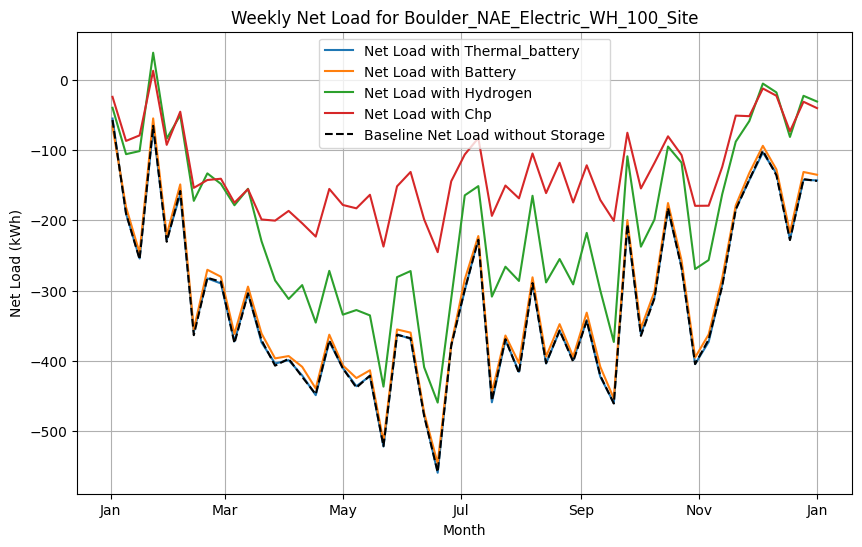

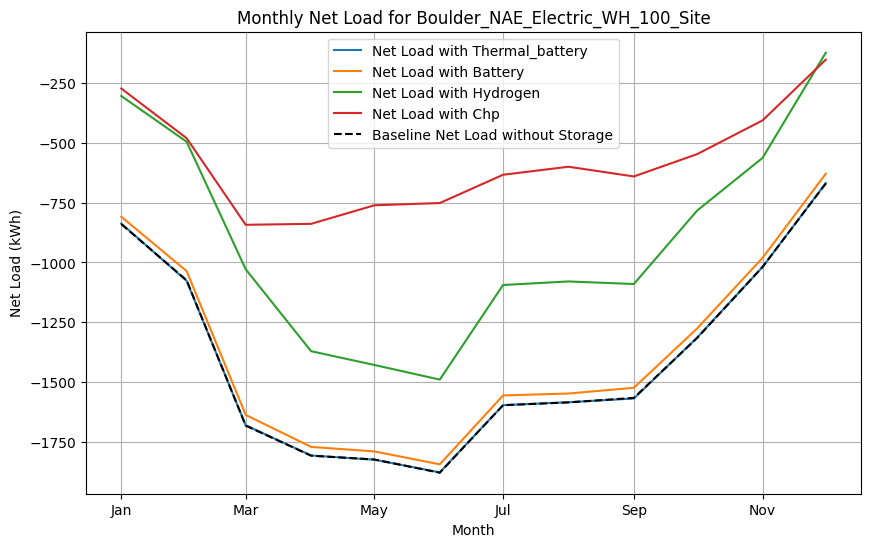

Loaded results from: /content/drive/MyDrive/Thesis/Results/Boulder/Boulder_NAE_Gas_WH_100_Site/Thermal_Battery_Results_Boulder_NAE_Gas_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Boulder/Boulder_NAE_Gas_WH_100_Site/Battery_Results_Boulder_NAE_Gas_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Boulder/Boulder_NAE_Gas_WH_100_Site/Hydrogen_Results_Boulder_NAE_Gas_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Boulder/Boulder_NAE_Gas_WH_100_Site/CHP_Results_Boulder_NAE_Gas_WH_100_Site.csv


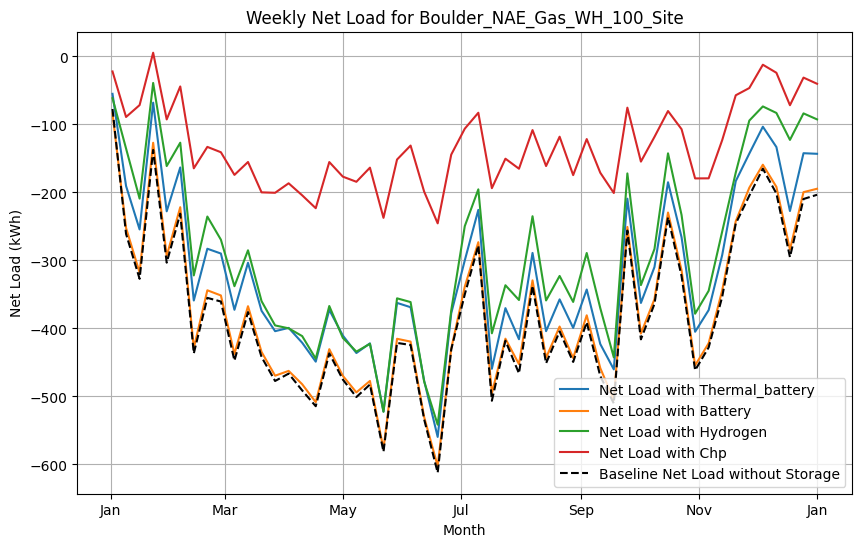

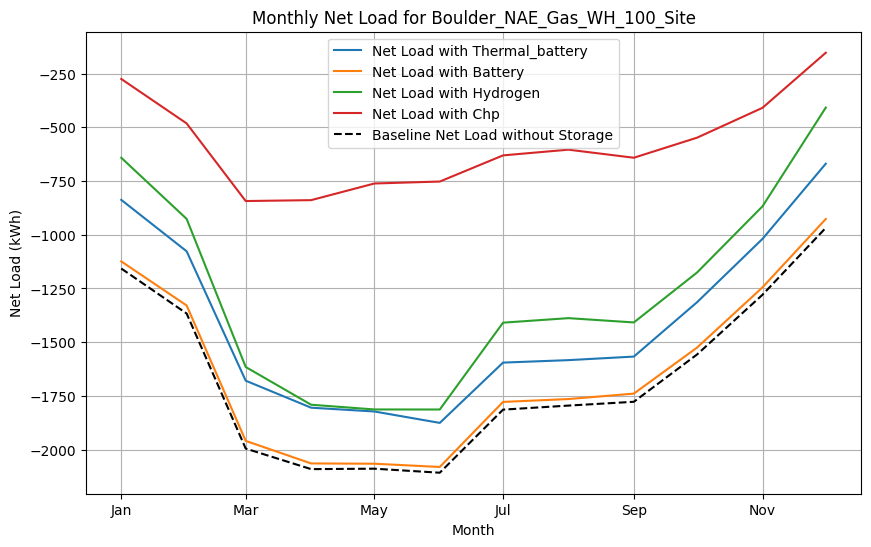

Loaded results from: /content/drive/MyDrive/Thesis/Results/Boulder/Boulder_AE_Electric_WH_100_Site/Thermal_Battery_Results_Boulder_AE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Boulder/Boulder_AE_Electric_WH_100_Site/Battery_Results_Boulder_AE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Boulder/Boulder_AE_Electric_WH_100_Site/Hydrogen_Results_Boulder_AE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Boulder/Boulder_AE_Electric_WH_100_Site/CHP_Results_Boulder_AE_Electric_WH_100_Site.csv


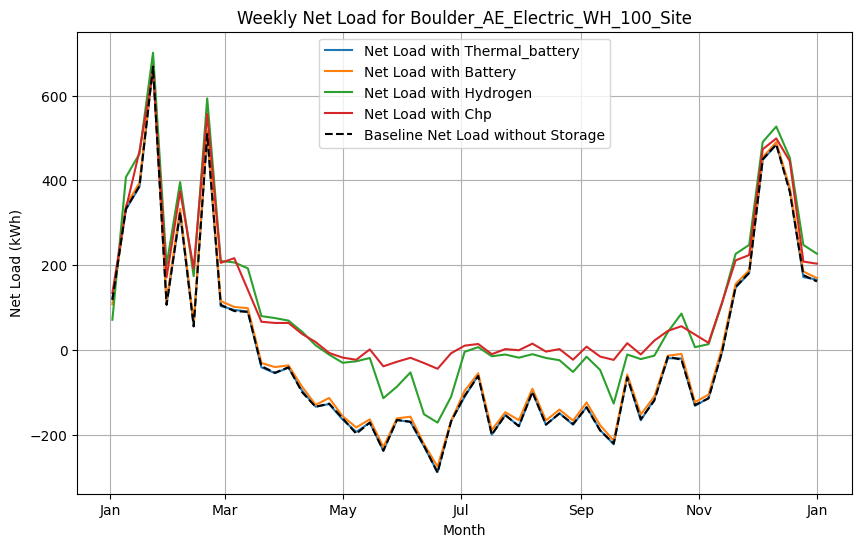

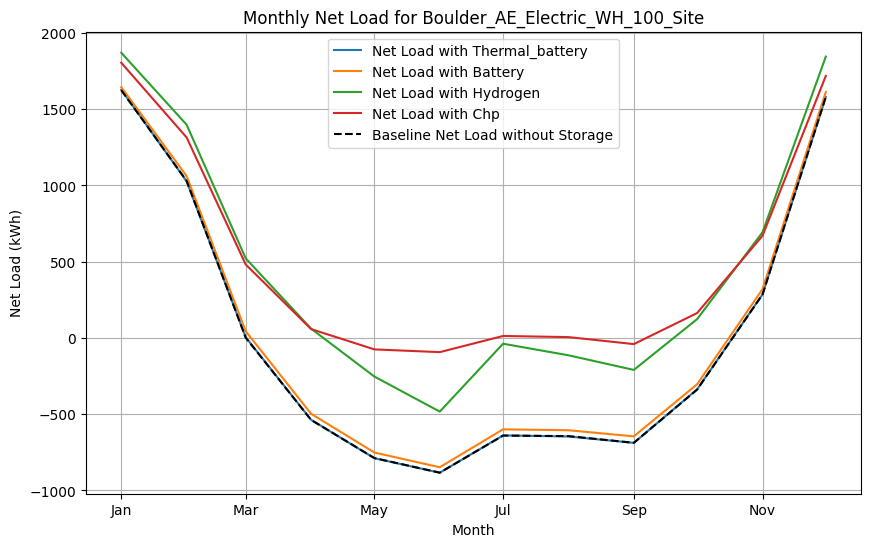

In [ ]:
# Run the analysis for a specific region
plot_net_load_for_all_configs("Boulder")


In [ ]:
import pandas as pd
import matplotlib.pyplot as plt

# Function to normalize the results by PV size and plot the net loads
def generate_normalized_combined_plots(config_results, config_suffix):
    plt.figure(figsize=(12, 8))
    baseline_net_load = None

    for model_type, results in config_results.items():
        if 'Date' not in results.columns:
            continue

        # Convert 'Date' to datetime
        results['Date'] = pd.to_datetime(results['Date'])

        # Calculate weekly aggregation
        weekly_results = results.set_index('Date').resample('W').sum()

        # Normalizing by NZE PV Size
        if 'NZE_PV_Size' in results.columns:
            pv_size = results['NZE_PV_Size'].iloc[0]
        else:
            # Placeholder if the PV size is not explicitly in the DataFrame
            print(f"Warning: NZE_PV_Size not found in {model_type}. Using default value of 1.")
            pv_size = 1

        # Normalize the Net Load Grid by the PV size
        weekly_results_normalized = weekly_results['Net_Load_Grid'] / pv_size

        # Plotting the normalized net load
        plt.plot(weekly_results_normalized.index, weekly_results_normalized,
                 label=f'{model_type.capitalize()}')

        # Adding baseline net load without storage for comparison
        for col in results.columns:
            if 'Net_Load_Grid_Without' in col:
                if baseline_net_load is None:
                    baseline_net_load = weekly_results[col] / pv_size

    # Adding the baseline net load without storage to the plot
    if baseline_net_load is not None:
        plt.plot(baseline_net_load.index, baseline_net_load,
                 linestyle='--', color='black', linewidth=1.5,
                 label='No Storage')

    # Plot settings
    plt.xlabel('Week')
    plt.ylabel('Normalized Net Load (kWh per kWp)')
    plt.title(f'Weekly Normalized Net Load for {config_suffix}')
    plt.legend(title='Model')
    plt.grid(True)
    plt.gca().xaxis.set_major_formatter(plt.matplotlib.dates.DateFormatter('%b'))
    plt.xticks(rotation=0)
    plt.show()

# Run the analysis and plotting for all configurations
def plot_normalized_net_load_for_all_configs(region):
    config_names = [
        f"{region}_{home_type}_{wh_type}_{int(nze_percentage*100)}_Site"
        for home_type in ["NAE", "AE"]
        for wh_type in ["Electric_WH", "Gas_WH"]
        for nze_percentage in [1.0]
    ]

    # Assuming load_results_from_csv is a function that loads the results DataFrame from CSV
    for config_suffix in config_names:
        config_results = {
            'thermal_battery': load_results_from_csv(region, f'{config_suffix}_Thermal_Battery'),
            'battery': load_results_from_csv(region, f'{config_suffix}_Battery'),
            'hydrogen': load_results_from_csv(region, f'{config_suffix}_Hydrogen'),
            'chp': load_results_from_csv(region, f'{config_suffix}_CHP'),
        }

        # Removing None or empty results
        config_results = {k: v for k, v in config_results.items() if v is not None and not v.empty}

        if config_results:
            generate_normalized_combined_plots(config_results, config_suffix)




In [ ]:
# Example call to plot the normalized net loads
plot_normalized_net_load_for_all_configs("Los_Angeles")

AttributeError: 'dict' object has no attribute 'empty'

Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_NAE_Electric_WH_100_Site/Thermal_Battery_Results_Los_Angeles_NAE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_NAE_Electric_WH_100_Site/Battery_Results_Los_Angeles_NAE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_NAE_Electric_WH_100_Site/Hydrogen_Results_Los_Angeles_NAE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_NAE_Electric_WH_100_Site/CHP_Results_Los_Angeles_NAE_Electric_WH_100_Site.csv


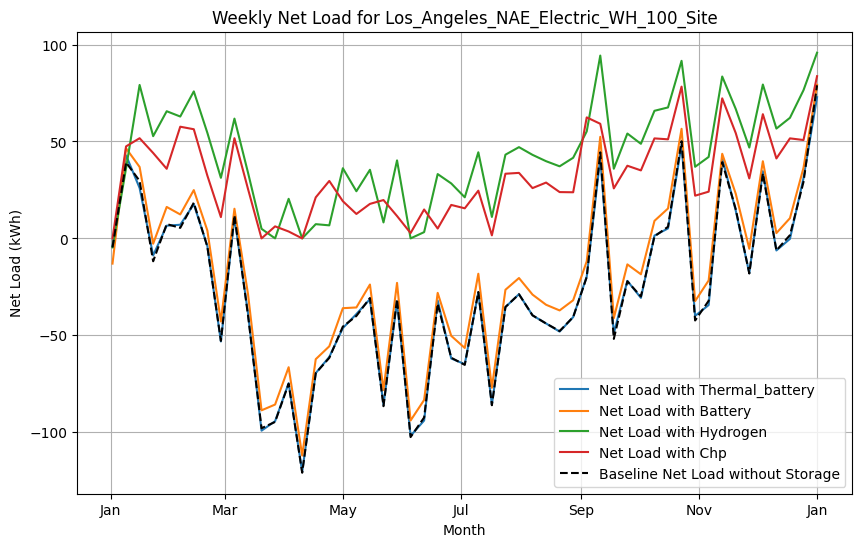

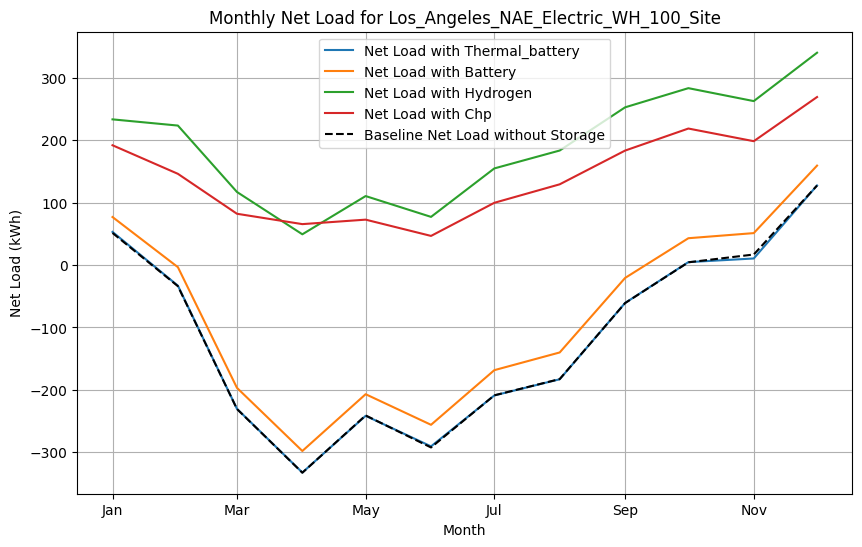

Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_NAE_Gas_WH_100_Site/Thermal_Battery_Results_Los_Angeles_NAE_Gas_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_NAE_Gas_WH_100_Site/Battery_Results_Los_Angeles_NAE_Gas_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_NAE_Gas_WH_100_Site/Hydrogen_Results_Los_Angeles_NAE_Gas_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_NAE_Gas_WH_100_Site/CHP_Results_Los_Angeles_NAE_Gas_WH_100_Site.csv


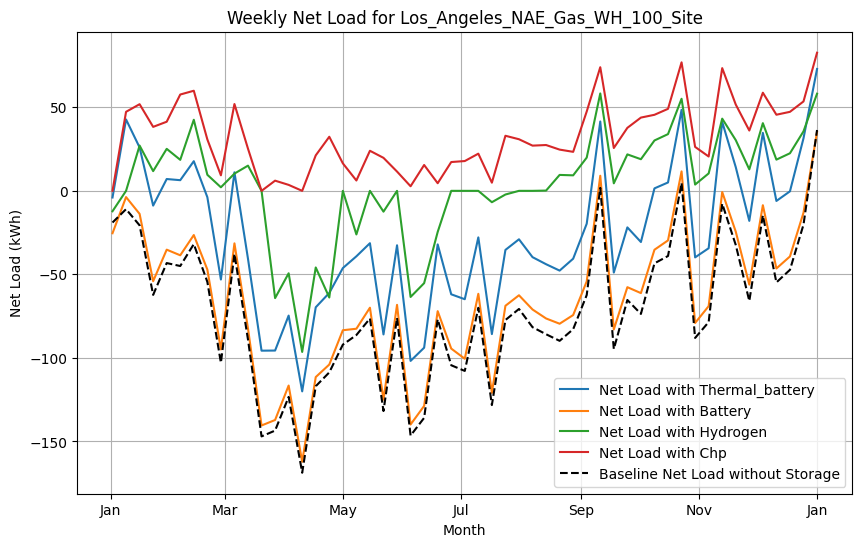

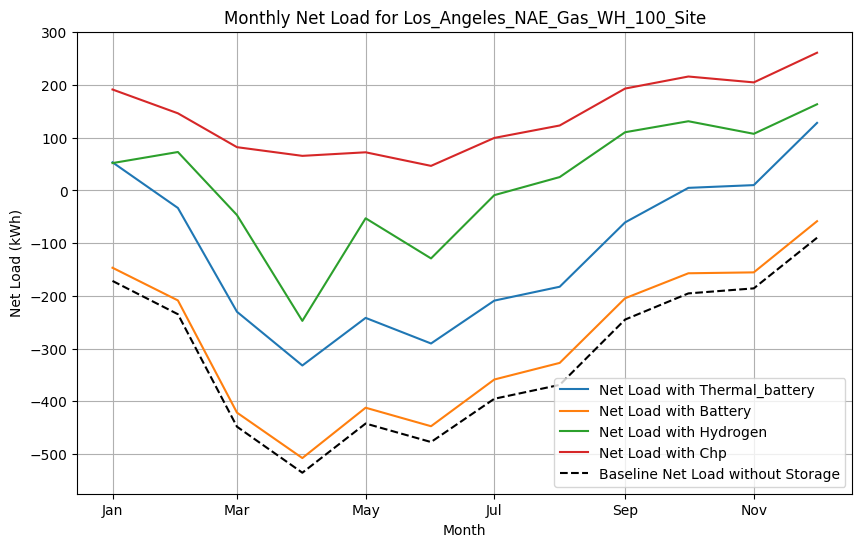

Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_AE_Electric_WH_100_Site/Thermal_Battery_Results_Los_Angeles_AE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_AE_Electric_WH_100_Site/Battery_Results_Los_Angeles_AE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_AE_Electric_WH_100_Site/Hydrogen_Results_Los_Angeles_AE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_AE_Electric_WH_100_Site/CHP_Results_Los_Angeles_AE_Electric_WH_100_Site.csv


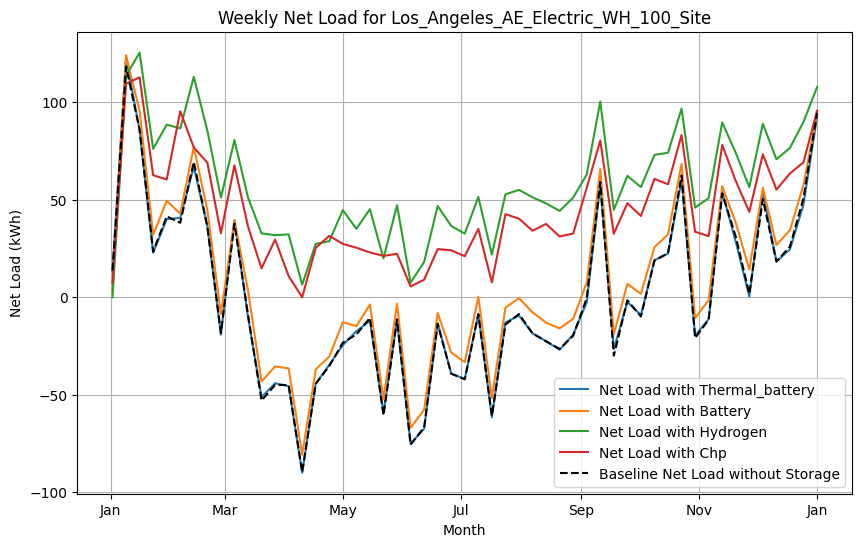

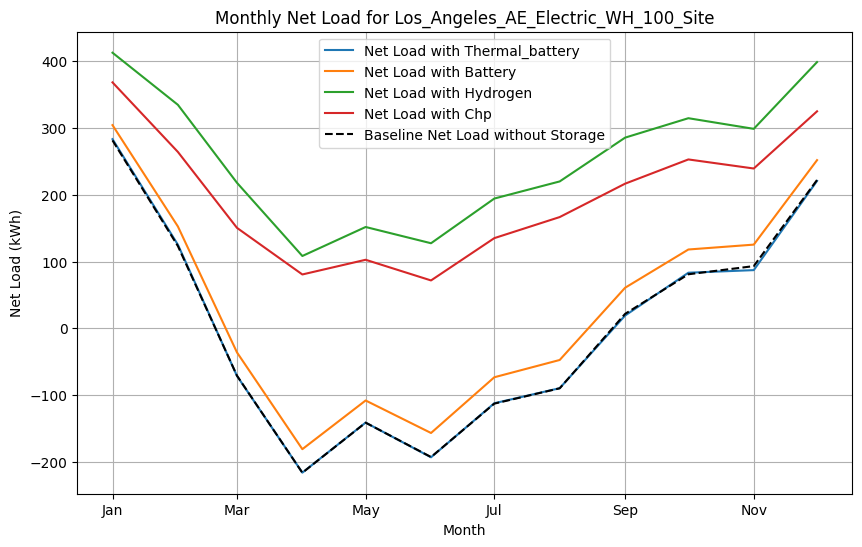

In [ ]:
# Run the analysis for a specific region
plot_net_load_for_all_configs("Los_Angeles")

## Plot Solar Utilization For All Configs

In [ ]:
def generate_solar_utilization_plots(config_results, config_suffix):
    plt.figure(figsize=(10, 6))
    baseline_solar_utilization = None

    for model_type, results in config_results.items():
        if 'Date' not in results.columns:
            continue

        results['Date'] = pd.to_datetime(results['Date'])
        weekly_results = results.set_index('Date').resample('W').sum()

        # Calculate solar utilization with storage for the model
        if 'P_B_Ch' in weekly_results.columns:
            solar_utilization_with_storage = np.minimum(weekly_results['P_PV'], weekly_results['P_Load']) + weekly_results['P_B_Ch']
        elif 'P_TB_Ch' in weekly_results.columns:
            solar_utilization_with_storage = np.minimum(weekly_results['P_PV'], weekly_results['P_Load']) + weekly_results['P_TB_Ch']
        elif 'P_EL' in weekly_results.columns:
            solar_utilization_with_storage = np.minimum(weekly_results['P_PV'], weekly_results['P_Load']) + weekly_results['P_EL']
        else:
            solar_utilization_with_storage = np.minimum(weekly_results['P_PV'], weekly_results['P_Load'])

        plt.plot(weekly_results.index, solar_utilization_with_storage, label=f'Solar Utilization with {model_type.capitalize()}')

        # Attempt to set the baseline solar utilization without storage
        if baseline_solar_utilization is None:
            baseline_solar_utilization = np.minimum(weekly_results['P_PV'], weekly_results['P_Load'])

    # Adding baseline solar utilization without storage for comparison
    if baseline_solar_utilization is not None:
        plt.plot(baseline_solar_utilization.index, baseline_solar_utilization, linestyle='--', color='black', linewidth=1.5, label='Baseline Solar Utilization without Storage')

    plt.xlabel('Month')
    plt.ylabel('Solar Utilization (kWh)')
    plt.title(f'Weekly Solar Utilization for {config_suffix}')
    plt.legend()
    plt.grid(True)
    plt.gca().xaxis.set_major_formatter(plt.matplotlib.dates.DateFormatter('%b'))  # Show month on x-axis
    plt.xticks(rotation=0)
    plt.show()

    plt.figure(figsize=(10, 6))
    baseline_solar_utilization_monthly = None
    for model_type, results in config_results.items():
        if 'Date' not in results.columns:
            continue

        results['Date'] = pd.to_datetime(results['Date'])
        monthly_results = results.set_index('Date').resample('MS').sum()

        # Calculate solar utilization with storage for the model (monthly)
        if 'P_B_Ch' in monthly_results.columns:
            solar_utilization_with_storage_monthly = np.minimum(monthly_results['P_PV'], monthly_results['P_Load']) + monthly_results['P_B_Ch']
        elif 'P_TB_Ch' in monthly_results.columns:
            solar_utilization_with_storage_monthly = np.minimum(monthly_results['P_PV'], monthly_results['P_Load']) + monthly_results['P_TB_Ch']
        elif 'P_EL' in monthly_results.columns:
            solar_utilization_with_storage_monthly = np.minimum(monthly_results['P_PV'], monthly_results['P_Load']) + monthly_results['P_EL']
        else:
            solar_utilization_with_storage_monthly = np.minimum(monthly_results['P_PV'], monthly_results['P_Load'])

        plt.plot(monthly_results.index, solar_utilization_with_storage_monthly, label=f'Solar Utilization with {model_type.capitalize()}')

        # Attempt to set the baseline solar utilization without storage (monthly)
        if baseline_solar_utilization_monthly is None:
            baseline_solar_utilization_monthly = np.minimum(monthly_results['P_PV'], monthly_results['P_Load'])

    # Adding baseline solar utilization without storage for comparison (monthly)
    if baseline_solar_utilization_monthly is not None:
        plt.plot(baseline_solar_utilization_monthly.index, baseline_solar_utilization_monthly, linestyle='--', color='black', linewidth=1.5, label='Baseline Solar Utilization without Storage')

    plt.xlabel('Month')
    plt.ylabel('Solar Utilization (kWh)')
    plt.title(f'Monthly Solar Utilization for {config_suffix}')
    plt.legend()
    plt.grid(True)
    plt.gca().xaxis.set_major_formatter(plt.matplotlib.dates.DateFormatter('%b'))  # Show month on x-axis
    plt.xticks(rotation=0)
    plt.show()

# Run the analysis and plotting for Solar Utilization
def plot_solar_utilization_for_all_configs(region):
    config_names = [
        f"{region}_{home_type}_{wh_type}_{int(nze_percentage*100)}_Site"
        for home_type in ["NAE", "AE"]
        for wh_type in ["Electric_WH", "Gas_WH"]
        for nze_percentage in [1.0]
    ]

    results_dict = {}
    for config_suffix in config_names:
        results = load_results_from_csv(region, config_suffix)
        if not results:
            continue

        results_dict[config_suffix] = results
        generate_solar_utilization_plots(results, config_suffix)


Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_NAE_Electric_WH_100_Site/Thermal_Battery_Results_Los_Angeles_NAE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_NAE_Electric_WH_100_Site/Battery_Results_Los_Angeles_NAE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_NAE_Electric_WH_100_Site/Hydrogen_Results_Los_Angeles_NAE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_NAE_Electric_WH_100_Site/CHP_Results_Los_Angeles_NAE_Electric_WH_100_Site.csv


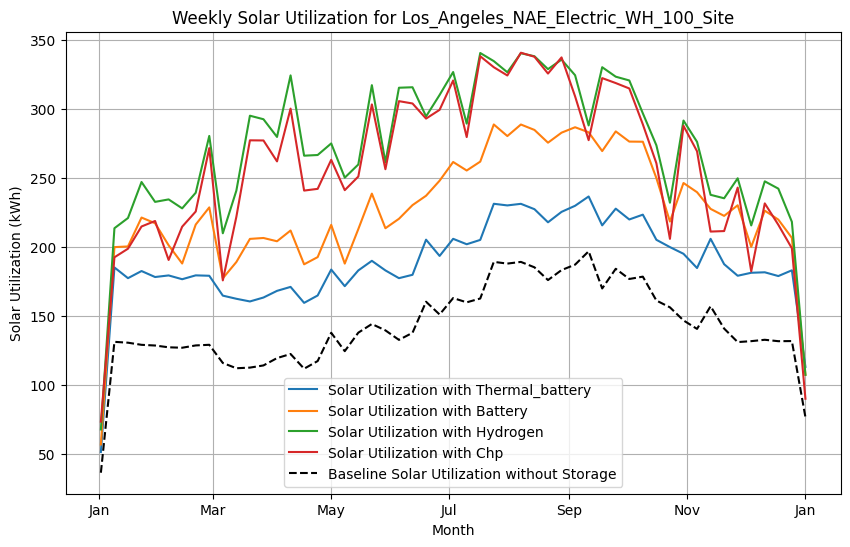

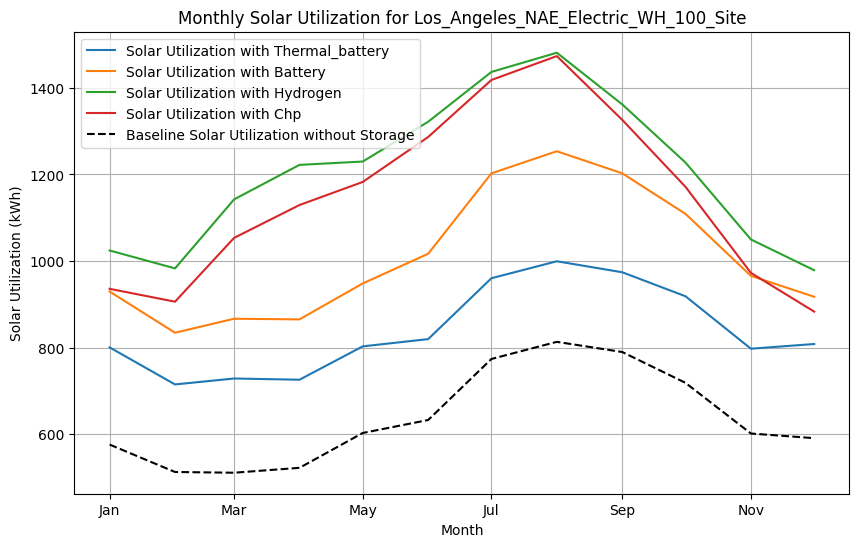

Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_NAE_Gas_WH_100_Site/Thermal_Battery_Results_Los_Angeles_NAE_Gas_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_NAE_Gas_WH_100_Site/Battery_Results_Los_Angeles_NAE_Gas_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_NAE_Gas_WH_100_Site/Hydrogen_Results_Los_Angeles_NAE_Gas_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_NAE_Gas_WH_100_Site/CHP_Results_Los_Angeles_NAE_Gas_WH_100_Site.csv


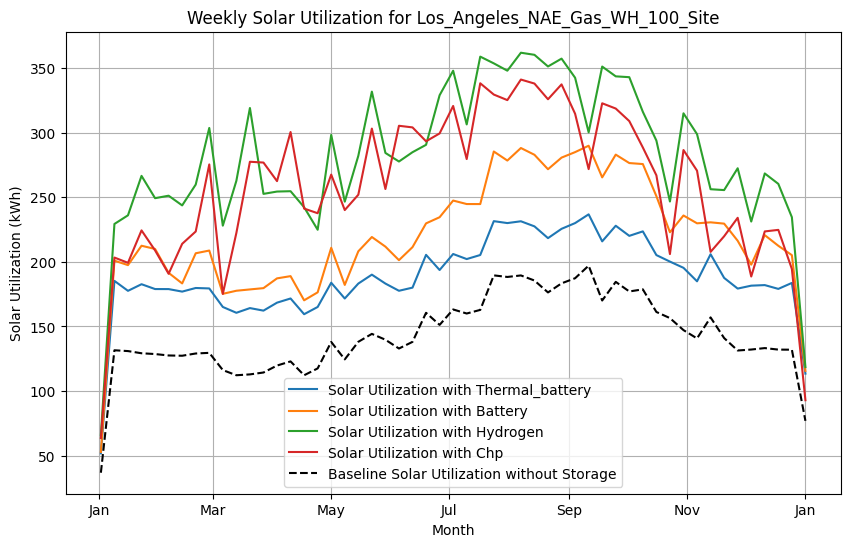

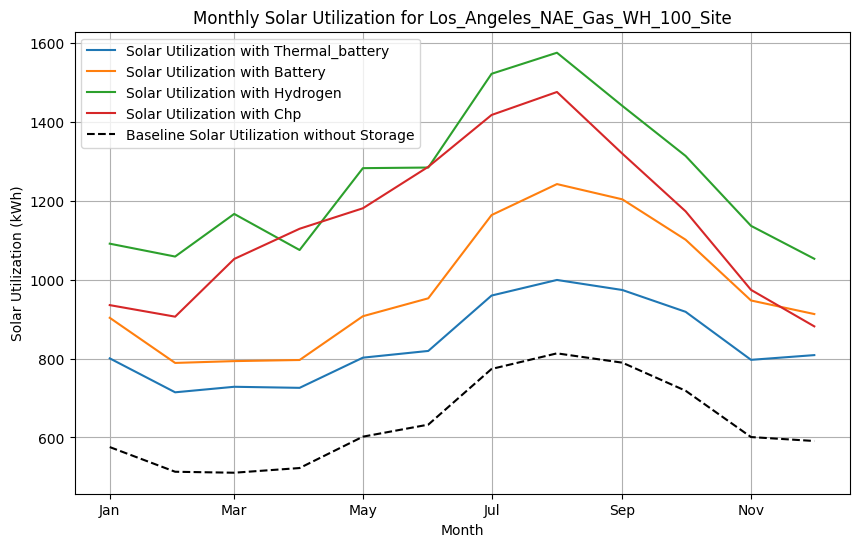

Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_AE_Electric_WH_100_Site/Thermal_Battery_Results_Los_Angeles_AE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_AE_Electric_WH_100_Site/Battery_Results_Los_Angeles_AE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_AE_Electric_WH_100_Site/Hydrogen_Results_Los_Angeles_AE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_AE_Electric_WH_100_Site/CHP_Results_Los_Angeles_AE_Electric_WH_100_Site.csv


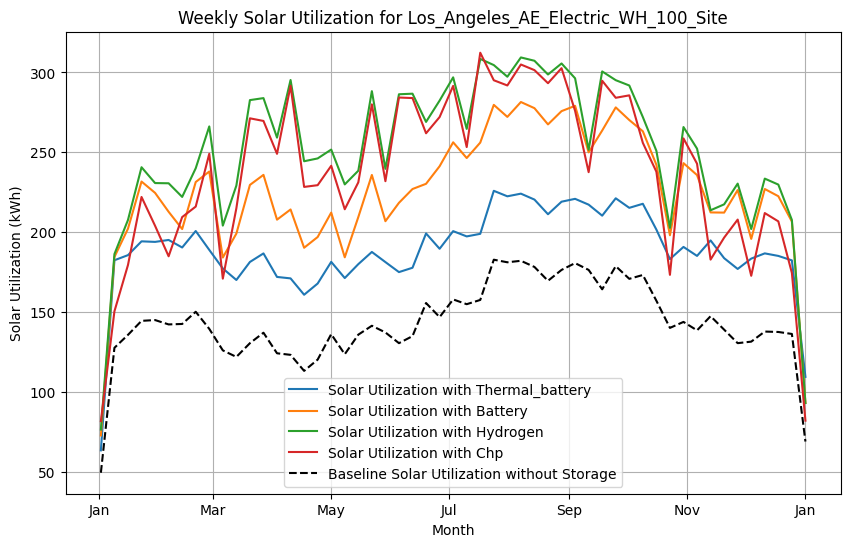

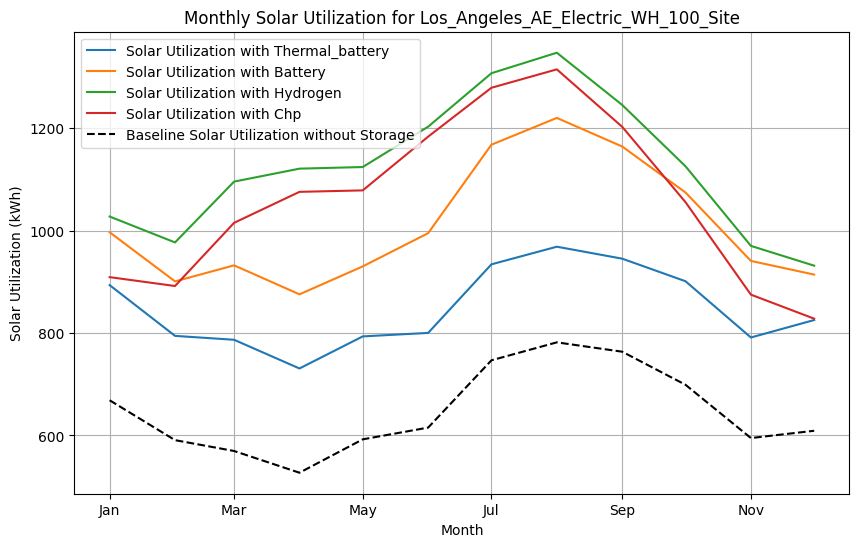

In [ ]:
plot_solar_utilization_for_all_configs("Los_Angeles")

Loaded results from: /content/drive/MyDrive/Thesis/Results/Boulder/Boulder_NAE_Electric_WH_100_Site/Thermal_Battery_Results_Boulder_NAE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Boulder/Boulder_NAE_Electric_WH_100_Site/Battery_Results_Boulder_NAE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Boulder/Boulder_NAE_Electric_WH_100_Site/Hydrogen_Results_Boulder_NAE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Boulder/Boulder_NAE_Electric_WH_100_Site/CHP_Results_Boulder_NAE_Electric_WH_100_Site.csv


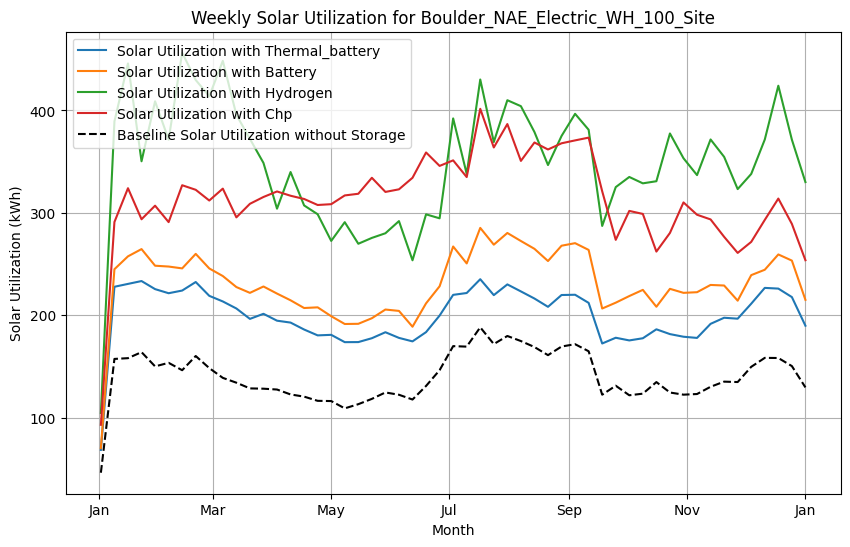

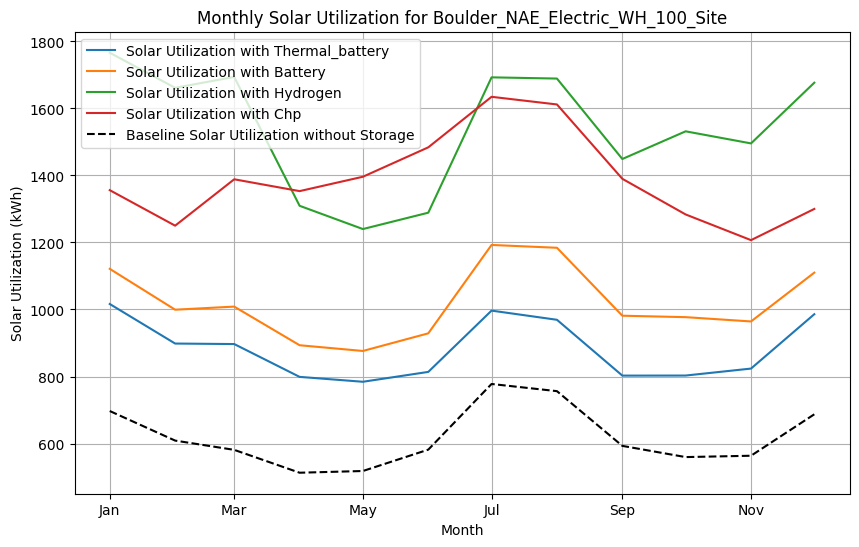

Loaded results from: /content/drive/MyDrive/Thesis/Results/Boulder/Boulder_NAE_Gas_WH_100_Site/Thermal_Battery_Results_Boulder_NAE_Gas_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Boulder/Boulder_NAE_Gas_WH_100_Site/Battery_Results_Boulder_NAE_Gas_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Boulder/Boulder_NAE_Gas_WH_100_Site/Hydrogen_Results_Boulder_NAE_Gas_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Boulder/Boulder_NAE_Gas_WH_100_Site/CHP_Results_Boulder_NAE_Gas_WH_100_Site.csv


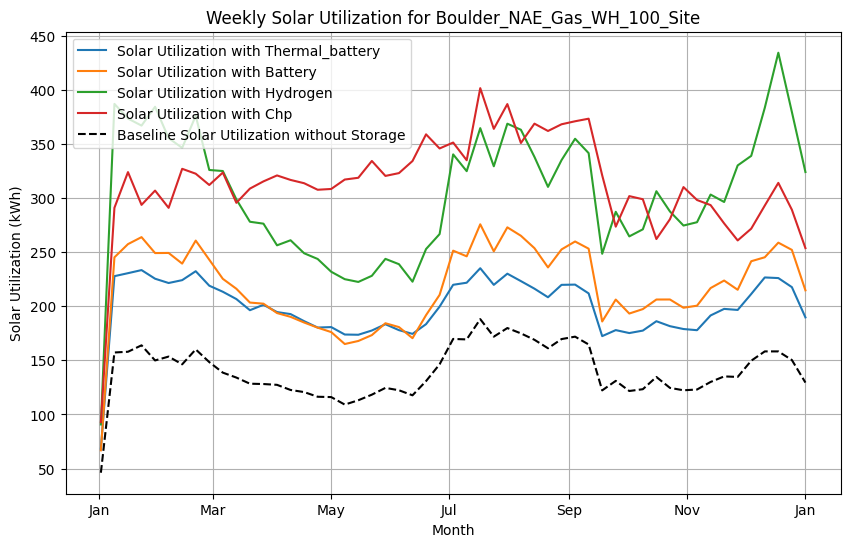

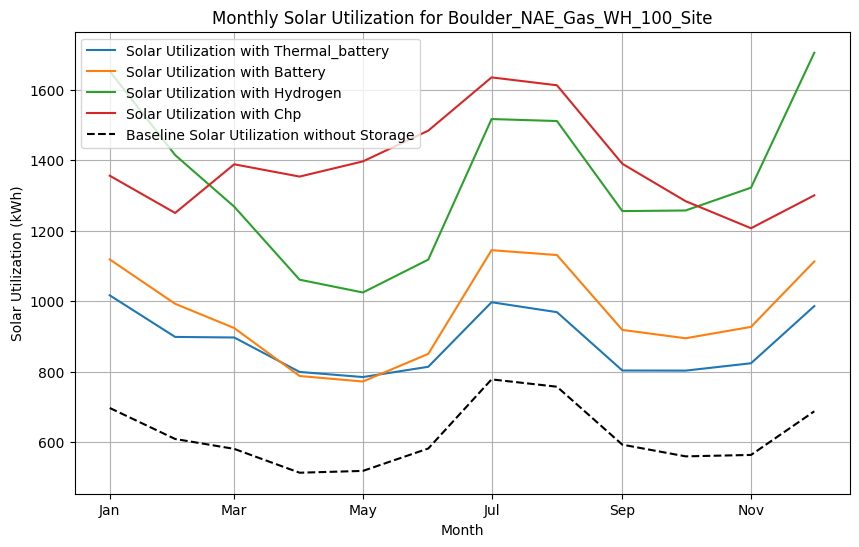

Loaded results from: /content/drive/MyDrive/Thesis/Results/Boulder/Boulder_AE_Electric_WH_100_Site/Thermal_Battery_Results_Boulder_AE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Boulder/Boulder_AE_Electric_WH_100_Site/Battery_Results_Boulder_AE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Boulder/Boulder_AE_Electric_WH_100_Site/Hydrogen_Results_Boulder_AE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Boulder/Boulder_AE_Electric_WH_100_Site/CHP_Results_Boulder_AE_Electric_WH_100_Site.csv


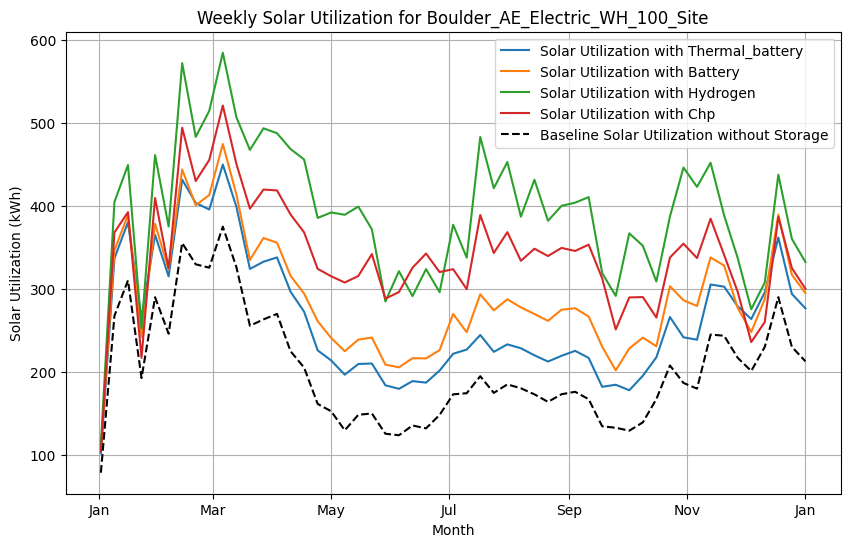

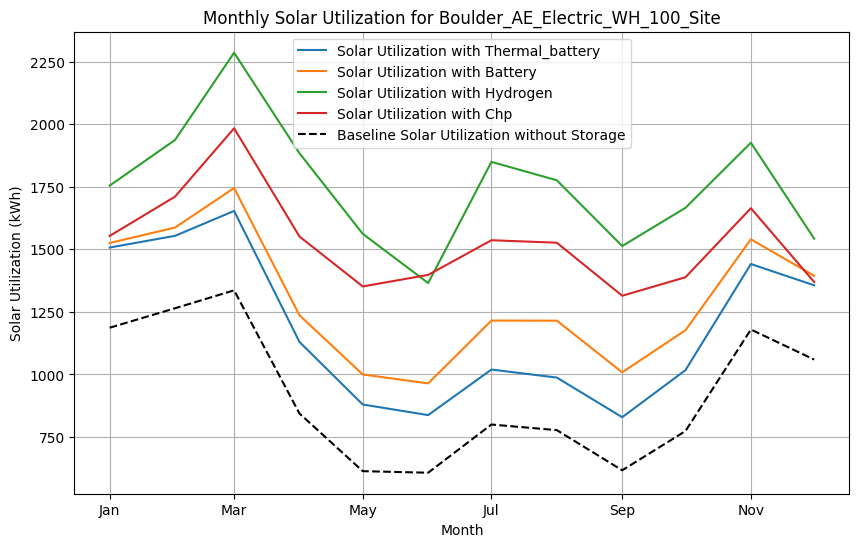

In [ ]:
plot_solar_utilization_for_all_configs("Boulder")

## Plot Net Load By Storage

In [ ]:
def generate_net_load_storage_plots(config_results, region, energy_storage_type):
    plt.figure(figsize=(10, 6))
    baseline_net_load = None

    # Sort config_suffix keys to control the order of plotting
    sorted_configs = sorted(config_results.keys(), key=lambda x: ("AE" in x, "NAE" in x, "Electric_WH" in x, "Gas_WH" in x), reverse=True)

    for config_suffix in sorted_configs:
        results_dict = config_results[config_suffix]
        # Loop through each model's results within the configuration
        for model_type, results in results_dict.items():
            if 'Date' not in results.columns:
                continue

            results['Date'] = pd.to_datetime(results['Date'])
            weekly_results = results.set_index('Date').resample('W').sum()

            # Plot net load with the selected energy storage type
            if energy_storage_type.lower() in model_type.lower() and model_type.lower() == energy_storage_type.lower():
                label = config_suffix.replace('_', ' ').replace(region, '').replace(' 100 Site', '').strip()
                plt.plot(weekly_results.index, weekly_results['Net_Load_Grid'], label=label)

            # Attempt to set the baseline net load without storage
            if 'Net_Load_Grid_Without' in results.columns:
                if baseline_net_load is None:
                    baseline_net_load = weekly_results['Net_Load_Grid_Without']
                else:
                    baseline_net_load = weekly_results['Net_Load_Grid_Without']  # Use only one instance as baseline

    # Adding baseline net load without storage for comparison
    if baseline_net_load is not None:
        plt.plot(baseline_net_load.index, baseline_net_load, linestyle='--', color='black', linewidth=1.5, label='Baseline')

    plt.xlabel('Month')
    plt.ylabel('Net Load (kWh)')
    plt.title(f'Weekly Net Load with {energy_storage_type} for {region}')
    plt.legend(title='', loc='upper left')
    plt.grid(True)
    plt.gca().xaxis.set_major_formatter(plt.matplotlib.dates.DateFormatter('%b'))  # Show month on x-axis
    plt.xticks(rotation=0)
    plt.show()

# Run the analysis and plotting for each region based on energy storage
def plot_net_load_based_on_storage(region):
    config_names = [
        f"{region}_{home_type}_{wh_type}_{int(nze_percentage*100)}_Site"
        for home_type in ["NAE", "AE"]
        for wh_type in ["Electric_WH", "Gas_WH"]
        for nze_percentage in [1.0]
    ]

    results_dict = {}
    for config_suffix in config_names:
        results = load_results_from_csv(region, config_suffix)
        if not results:
            continue

        results_dict[config_suffix] = results

    # Plotting for each energy storage type
    for energy_storage_type in ["Battery", "Thermal_Battery", "Hydrogen", "CHP"]:
        generate_net_load_storage_plots(results_dict, region, energy_storage_type)


Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_NAE_Electric_WH_100_Site/Thermal_Battery_Results_Los_Angeles_NAE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_NAE_Electric_WH_100_Site/Battery_Results_Los_Angeles_NAE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_NAE_Electric_WH_100_Site/Hydrogen_Results_Los_Angeles_NAE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_NAE_Electric_WH_100_Site/CHP_Results_Los_Angeles_NAE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_NAE_Gas_WH_100_Site/Thermal_Battery_Results_Los_Angeles_NAE_Gas_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_NAE_Gas_WH_100_Site/Battery_Results_Los_Angeles_NAE_Gas_WH_100_Site.csv
Loaded results fr

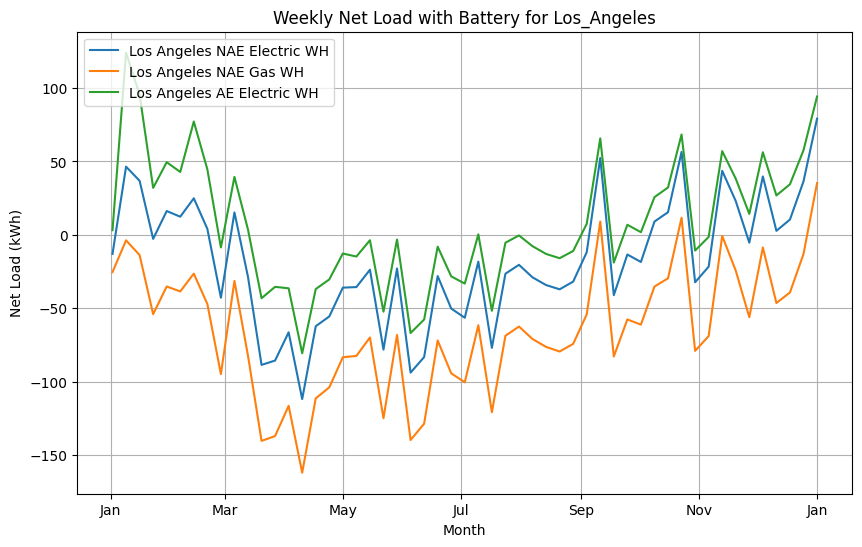

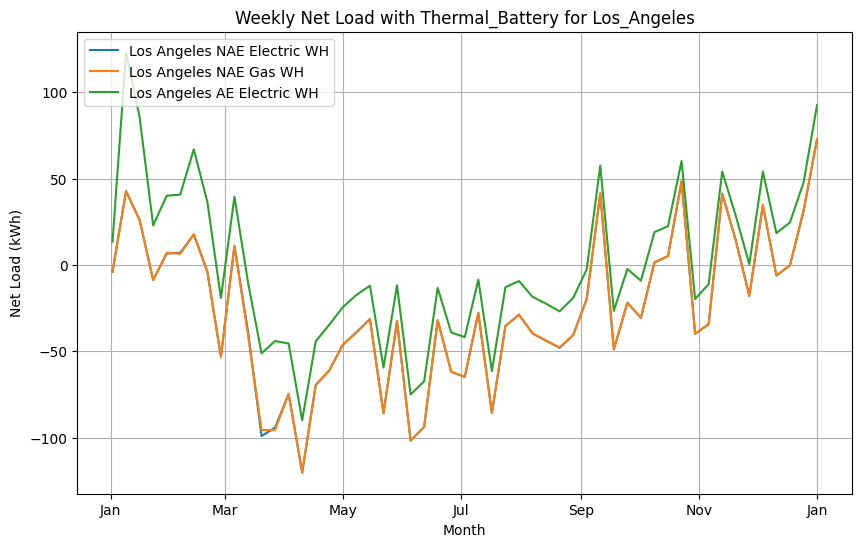

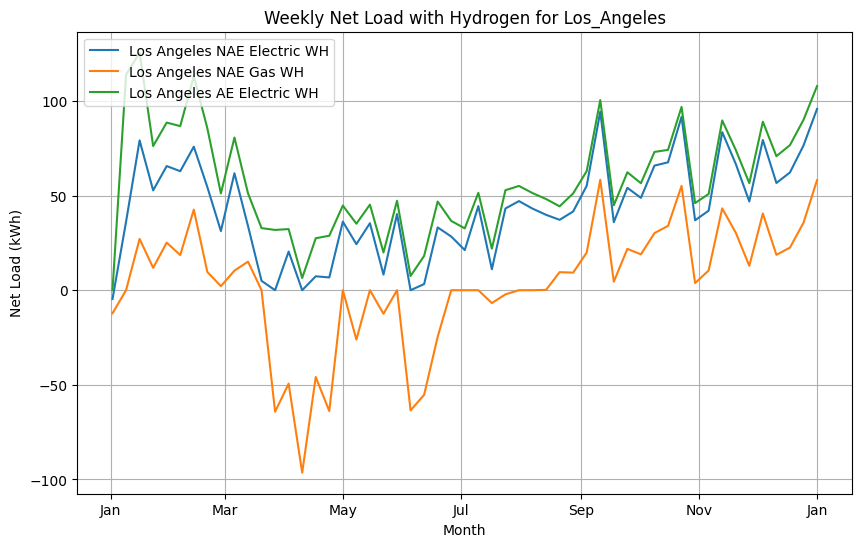

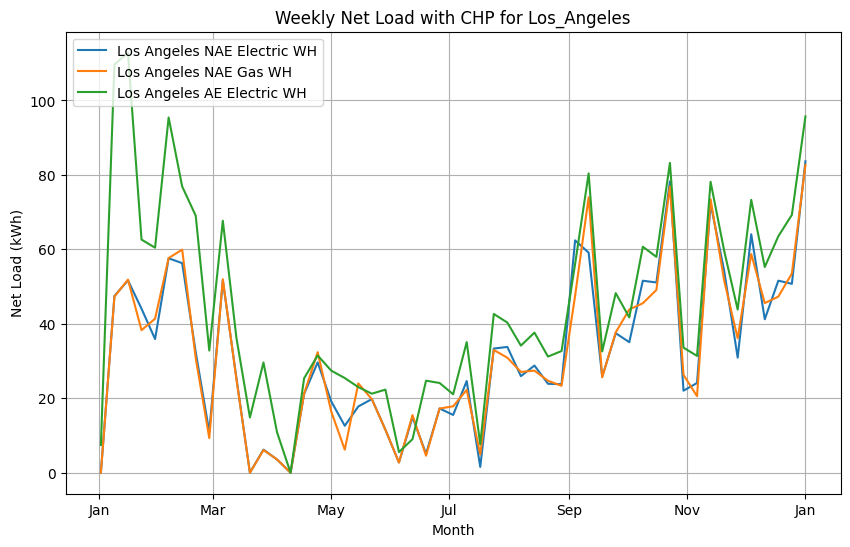

In [ ]:
plot_net_load_based_on_storage("Los_Angeles")


Loaded results from: /content/drive/MyDrive/Thesis/Results/Boulder/Boulder_NAE_Electric_WH_100_Site/Thermal_Battery_Results_Boulder_NAE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Boulder/Boulder_NAE_Electric_WH_100_Site/Battery_Results_Boulder_NAE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Boulder/Boulder_NAE_Electric_WH_100_Site/Hydrogen_Results_Boulder_NAE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Boulder/Boulder_NAE_Electric_WH_100_Site/CHP_Results_Boulder_NAE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Boulder/Boulder_NAE_Gas_WH_100_Site/Thermal_Battery_Results_Boulder_NAE_Gas_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Boulder/Boulder_NAE_Gas_WH_100_Site/Battery_Results_Boulder_NAE_Gas_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Boulder/Boulder_NAE_Gas_WH_100

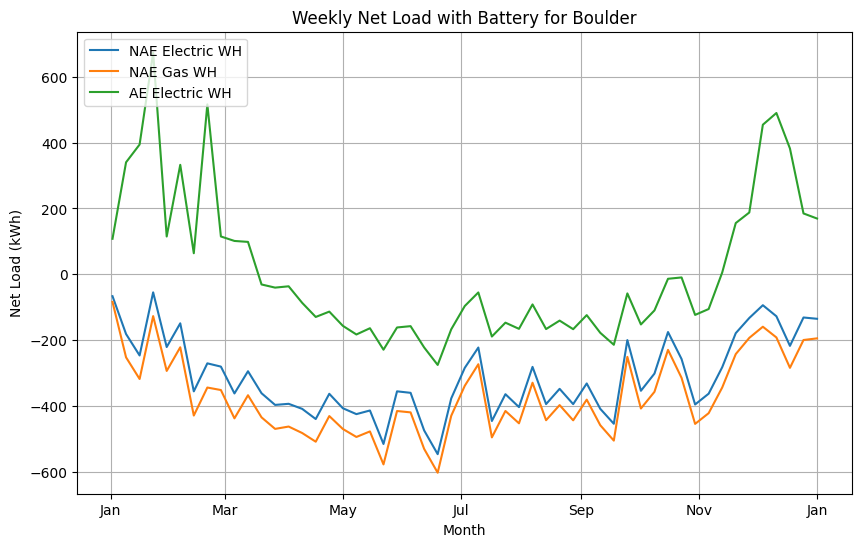

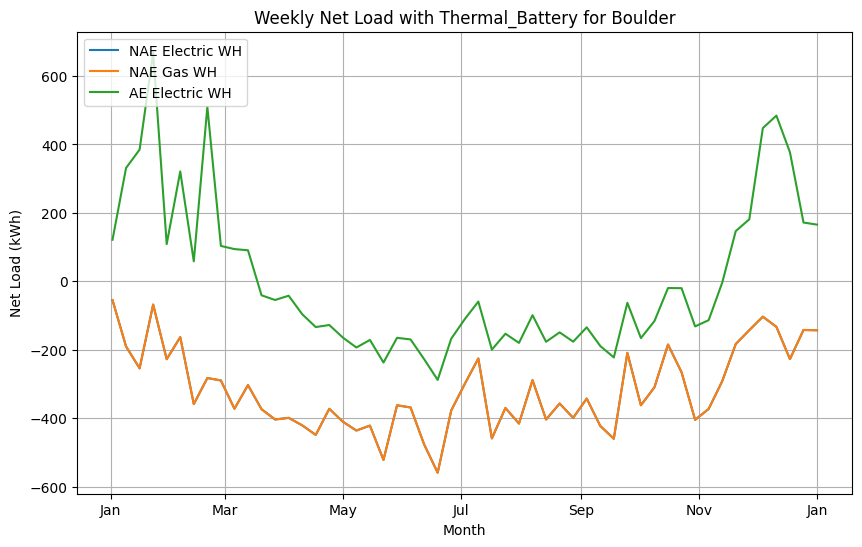

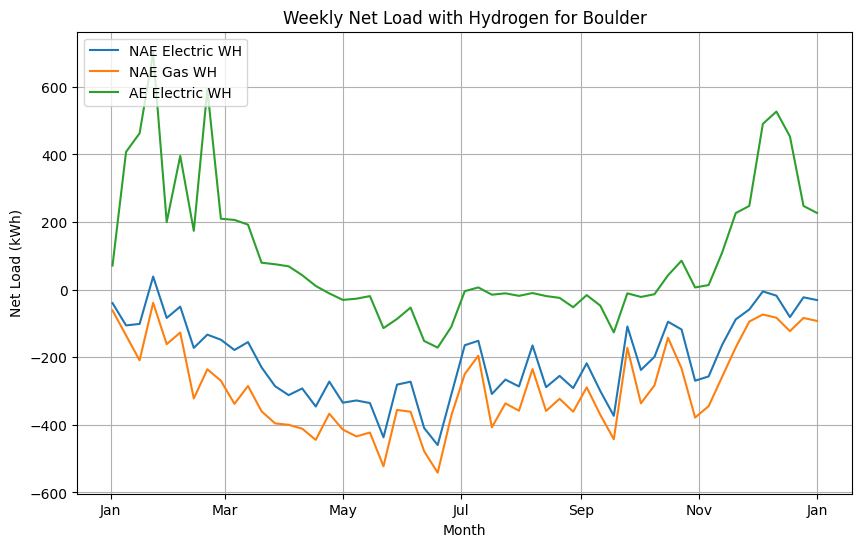

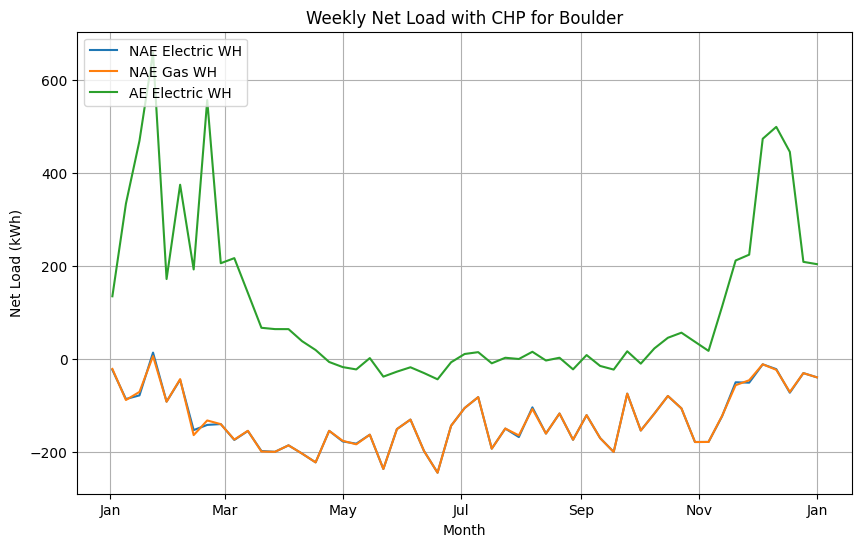

In [ ]:
plot_net_load_based_on_storage("Boulder")

## Plot Compare Cities By Storage

In [ ]:
def generate_net_load_storage_plots(config_results, region, energy_storage_type):
    plt.figure(figsize=(10, 6))
    baseline_net_load = None

    # Sort config_suffix keys to control the order of plotting
    sorted_configs = sorted(config_results.keys(), key=lambda x: ("AE" in x, "NAE" in x, "Electric_WH" in x, "Gas_WH" in x), reverse=True)

    for config_suffix in sorted_configs:
        results_dict = config_results[config_suffix]
        # Loop through each model's results within the configuration
        for model_type, results in results_dict.items():
            if 'Date' not in results.columns:
                continue

            results['Date'] = pd.to_datetime(results['Date'])
            weekly_results = results.set_index('Date').resample('W').sum()

            # Plot net load with the selected energy storage type
            if energy_storage_type.lower() in model_type.lower() and model_type.lower() == energy_storage_type.lower():
                label = config_suffix.replace('_', ' ').replace(region, '').replace(' 100 Site', '').strip()
                plt.plot(weekly_results.index, weekly_results['Net_Load_Grid'], label=label)

            # Attempt to set the baseline net load without storage
            if 'Net_Load_Grid_Without' in results.columns:
                if baseline_net_load is None:
                    baseline_net_load = weekly_results['Net_Load_Grid_Without']
                else:
                    baseline_net_load = weekly_results['Net_Load_Grid_Without']  # Use only one instance as baseline

    # Adding baseline net load without storage for comparison
    if baseline_net_load is not None:
        plt.plot(baseline_net_load.index, baseline_net_load, linestyle='--', color='black', linewidth=1.5, label='Baseline')

    plt.xlabel('Month')
    plt.ylabel('Net Load (kWh)')
    plt.title(f'Weekly Net Load with {energy_storage_type} for {region}')
    plt.legend(title='', loc='upper left')
    plt.grid(True)
    plt.gca().xaxis.set_major_formatter(plt.matplotlib.dates.DateFormatter('%b'))  # Show month on x-axis
    plt.xticks(rotation=0)
    plt.show()

# Run the analysis and plotting for each region based on energy storage
def plot_net_load_based_on_storage(region):
    config_names = [
        f"{region}_{home_type}_{wh_type}_{int(nze_percentage*100)}_Site"
        for home_type in ["NAE", "AE"]
        for wh_type in ["Electric_WH", "Gas_WH"]
        for nze_percentage in [1.0]
    ]

    results_dict = {}
    for config_suffix in config_names:
        if "AE" in config_suffix and "Gas_WH" in config_suffix:
            continue
        results = load_results_from_csv(region, config_suffix)
        if not results:
            continue

        results_dict[config_suffix] = results

    # Plotting for each energy storage type
    for energy_storage_type in ["Battery", "Thermal_Battery", "Hydrogen", "CHP"]:
        generate_net_load_storage_plots(results_dict, region, energy_storage_type)

# Compare cities for the same energy storage configuration
def compare_cities_net_load_storage(*regions, energy_storage_type=None):
    energy_storage_types = ["Battery", "Thermal_Battery", "Hydrogen", "CHP"] if energy_storage_type is None else [energy_storage_type]

    for energy_storage_type in energy_storage_types:
        for home_type in ["NAE", "AE"]:
            for wh_type in ["Electric_WH", "Gas_WH"]:
                if home_type == "AE" and wh_type == "Gas_WH":
                    continue
                plt.figure(figsize=(10, 6))
                baseline_net_load = None
                for region in regions:
                    config_suffix = f"{region}_{home_type}_{wh_type}_100_Site"
                    results = load_results_from_csv(region, config_suffix)
                    if not results:
                        continue

                    if energy_storage_type.lower() in results.keys():
                        results_dict = results[energy_storage_type.lower()]
                        if 'Date' not in results_dict.columns:
                            continue

                        results_dict['Date'] = pd.to_datetime(results_dict['Date'])
                        weekly_results = results_dict.set_index('Date').resample('W').sum()

                        label = f"{home_type} {wh_type} - {region}"
                        plt.plot(weekly_results.index, weekly_results['Net_Load_Grid'], label=label)

                        if 'Net_Load_Grid_Without' in results_dict.columns and baseline_net_load is None:
                            baseline_net_load = weekly_results['Net_Load_Grid_Without']

                # Adding baseline net load without storage for comparison
                if baseline_net_load is not None:
                    plt.plot(baseline_net_load.index, baseline_net_load, linestyle='--', color='black', linewidth=1.5, label='Baseline')

                plt.xlabel('Month')
                plt.ylabel('Net Load (kWh)')
                plt.title(f'{energy_storage_type} - {home_type} {wh_type} Comparison Across Regions')
                plt.legend(title='', loc='upper left')
                plt.grid(True)
                plt.gca().xaxis.set_major_formatter(plt.matplotlib.dates.DateFormatter('%b'))
                plt.xticks(rotation=0)
                plt.show()


Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_NAE_Electric_WH_100_Site/Thermal_Battery_Results_Los_Angeles_NAE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_NAE_Electric_WH_100_Site/Battery_Results_Los_Angeles_NAE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_NAE_Electric_WH_100_Site/Hydrogen_Results_Los_Angeles_NAE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_NAE_Electric_WH_100_Site/CHP_Results_Los_Angeles_NAE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Boulder/Boulder_NAE_Electric_WH_100_Site/Thermal_Battery_Results_Boulder_NAE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Boulder/Boulder_NAE_Electric_WH_100_Site/Battery_Results_Boulder_NAE_Electric_WH_100_Site.csv
Loaded results from: 

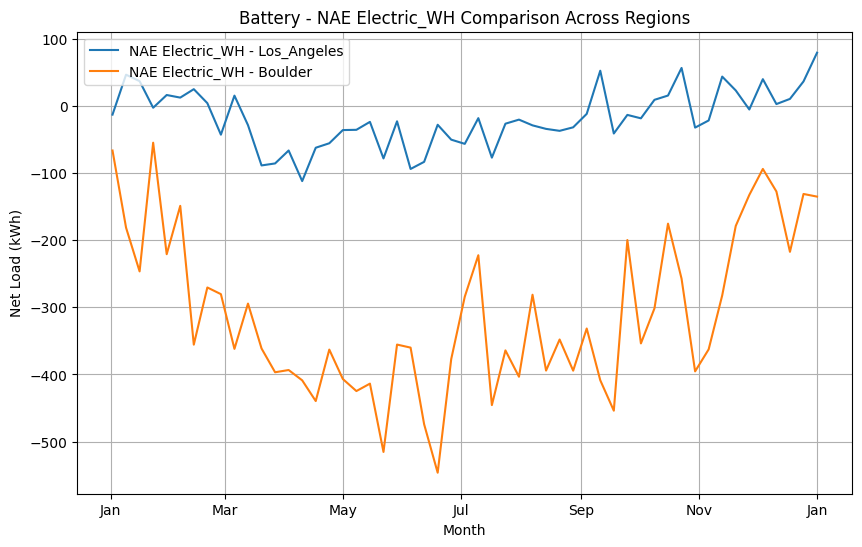

Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_NAE_Gas_WH_100_Site/Thermal_Battery_Results_Los_Angeles_NAE_Gas_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_NAE_Gas_WH_100_Site/Battery_Results_Los_Angeles_NAE_Gas_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_NAE_Gas_WH_100_Site/Hydrogen_Results_Los_Angeles_NAE_Gas_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_NAE_Gas_WH_100_Site/CHP_Results_Los_Angeles_NAE_Gas_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Boulder/Boulder_NAE_Gas_WH_100_Site/Thermal_Battery_Results_Boulder_NAE_Gas_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Boulder/Boulder_NAE_Gas_WH_100_Site/Battery_Results_Boulder_NAE_Gas_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Boulder/Boulder_NAE_Ga

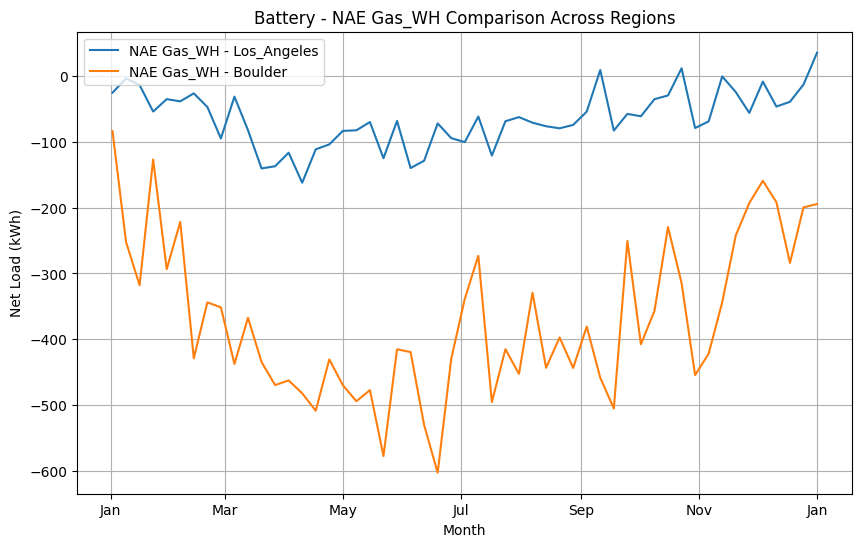

Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_AE_Electric_WH_100_Site/Thermal_Battery_Results_Los_Angeles_AE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_AE_Electric_WH_100_Site/Battery_Results_Los_Angeles_AE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_AE_Electric_WH_100_Site/Hydrogen_Results_Los_Angeles_AE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_AE_Electric_WH_100_Site/CHP_Results_Los_Angeles_AE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Boulder/Boulder_AE_Electric_WH_100_Site/Thermal_Battery_Results_Boulder_AE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Boulder/Boulder_AE_Electric_WH_100_Site/Battery_Results_Boulder_AE_Electric_WH_100_Site.csv
Loaded results from: /content/dri

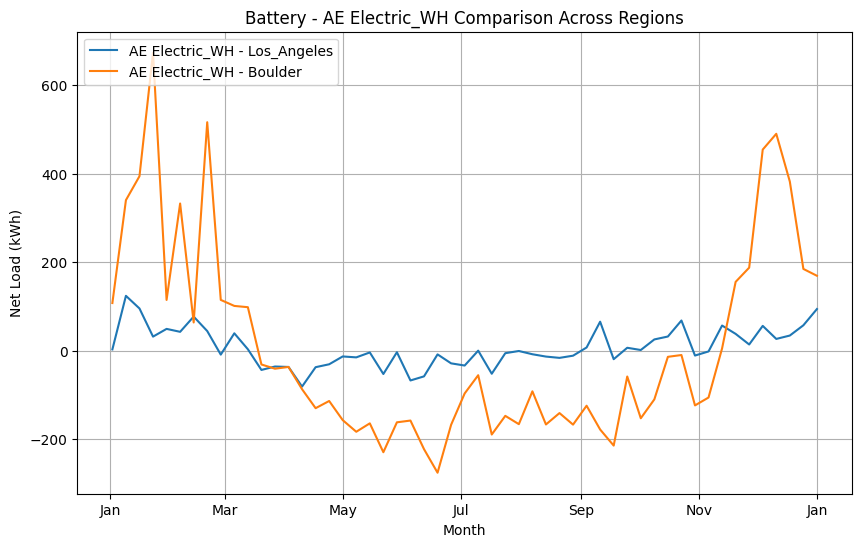

Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_NAE_Electric_WH_100_Site/Thermal_Battery_Results_Los_Angeles_NAE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_NAE_Electric_WH_100_Site/Battery_Results_Los_Angeles_NAE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_NAE_Electric_WH_100_Site/Hydrogen_Results_Los_Angeles_NAE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_NAE_Electric_WH_100_Site/CHP_Results_Los_Angeles_NAE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Boulder/Boulder_NAE_Electric_WH_100_Site/Thermal_Battery_Results_Boulder_NAE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Boulder/Boulder_NAE_Electric_WH_100_Site/Battery_Results_Boulder_NAE_Electric_WH_100_Site.csv
Loaded results from: 

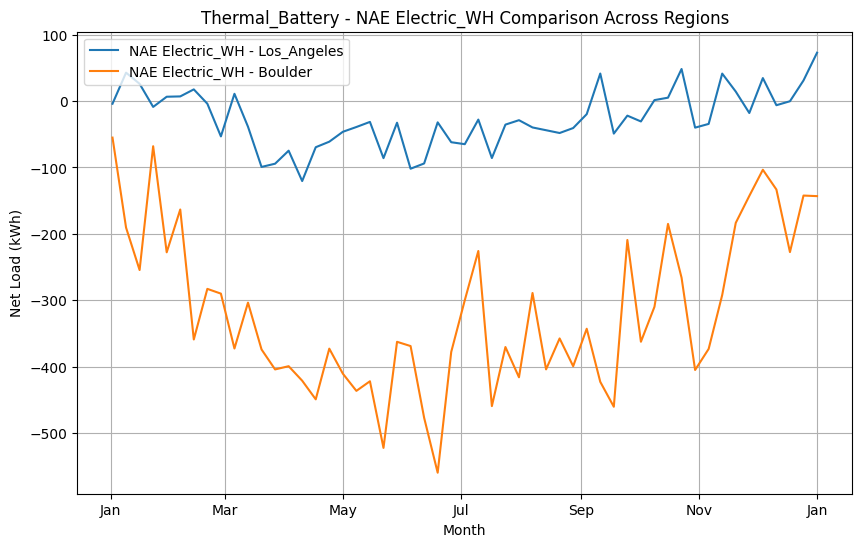

Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_NAE_Gas_WH_100_Site/Thermal_Battery_Results_Los_Angeles_NAE_Gas_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_NAE_Gas_WH_100_Site/Battery_Results_Los_Angeles_NAE_Gas_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_NAE_Gas_WH_100_Site/Hydrogen_Results_Los_Angeles_NAE_Gas_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_NAE_Gas_WH_100_Site/CHP_Results_Los_Angeles_NAE_Gas_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Boulder/Boulder_NAE_Gas_WH_100_Site/Thermal_Battery_Results_Boulder_NAE_Gas_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Boulder/Boulder_NAE_Gas_WH_100_Site/Battery_Results_Boulder_NAE_Gas_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Boulder/Boulder_NAE_Ga

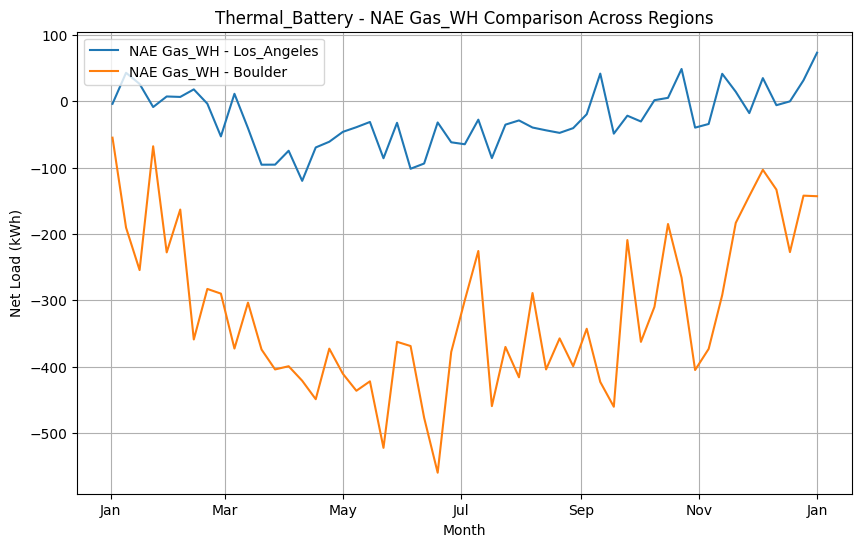

Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_AE_Electric_WH_100_Site/Thermal_Battery_Results_Los_Angeles_AE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_AE_Electric_WH_100_Site/Battery_Results_Los_Angeles_AE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_AE_Electric_WH_100_Site/Hydrogen_Results_Los_Angeles_AE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_AE_Electric_WH_100_Site/CHP_Results_Los_Angeles_AE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Boulder/Boulder_AE_Electric_WH_100_Site/Thermal_Battery_Results_Boulder_AE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Boulder/Boulder_AE_Electric_WH_100_Site/Battery_Results_Boulder_AE_Electric_WH_100_Site.csv
Loaded results from: /content/dri

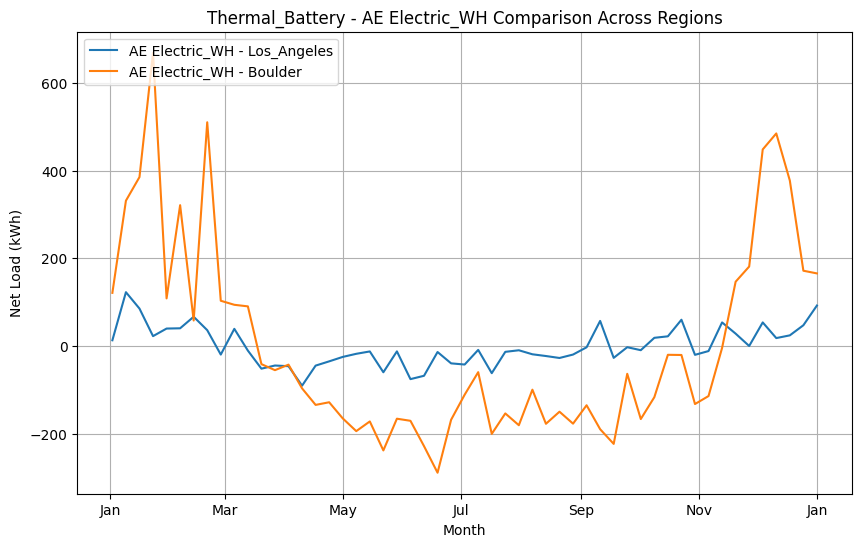

Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_NAE_Electric_WH_100_Site/Thermal_Battery_Results_Los_Angeles_NAE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_NAE_Electric_WH_100_Site/Battery_Results_Los_Angeles_NAE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_NAE_Electric_WH_100_Site/Hydrogen_Results_Los_Angeles_NAE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_NAE_Electric_WH_100_Site/CHP_Results_Los_Angeles_NAE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Boulder/Boulder_NAE_Electric_WH_100_Site/Thermal_Battery_Results_Boulder_NAE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Boulder/Boulder_NAE_Electric_WH_100_Site/Battery_Results_Boulder_NAE_Electric_WH_100_Site.csv
Loaded results from: 

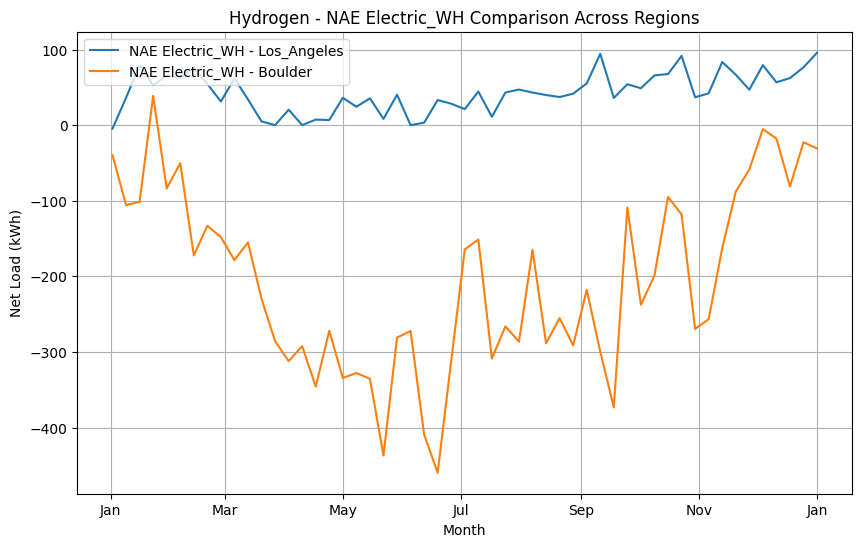

Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_NAE_Gas_WH_100_Site/Thermal_Battery_Results_Los_Angeles_NAE_Gas_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_NAE_Gas_WH_100_Site/Battery_Results_Los_Angeles_NAE_Gas_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_NAE_Gas_WH_100_Site/Hydrogen_Results_Los_Angeles_NAE_Gas_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_NAE_Gas_WH_100_Site/CHP_Results_Los_Angeles_NAE_Gas_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Boulder/Boulder_NAE_Gas_WH_100_Site/Thermal_Battery_Results_Boulder_NAE_Gas_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Boulder/Boulder_NAE_Gas_WH_100_Site/Battery_Results_Boulder_NAE_Gas_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Boulder/Boulder_NAE_Ga

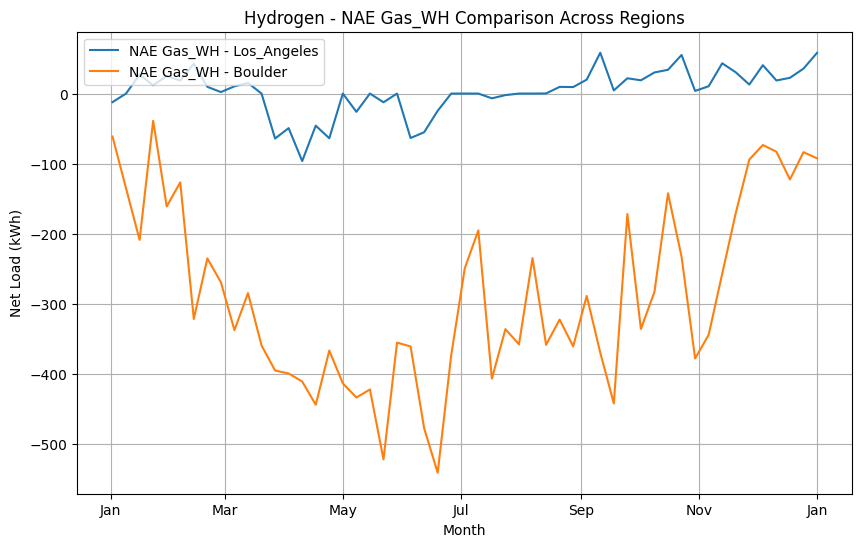

Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_AE_Electric_WH_100_Site/Thermal_Battery_Results_Los_Angeles_AE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_AE_Electric_WH_100_Site/Battery_Results_Los_Angeles_AE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_AE_Electric_WH_100_Site/Hydrogen_Results_Los_Angeles_AE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_AE_Electric_WH_100_Site/CHP_Results_Los_Angeles_AE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Boulder/Boulder_AE_Electric_WH_100_Site/Thermal_Battery_Results_Boulder_AE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Boulder/Boulder_AE_Electric_WH_100_Site/Battery_Results_Boulder_AE_Electric_WH_100_Site.csv
Loaded results from: /content/dri

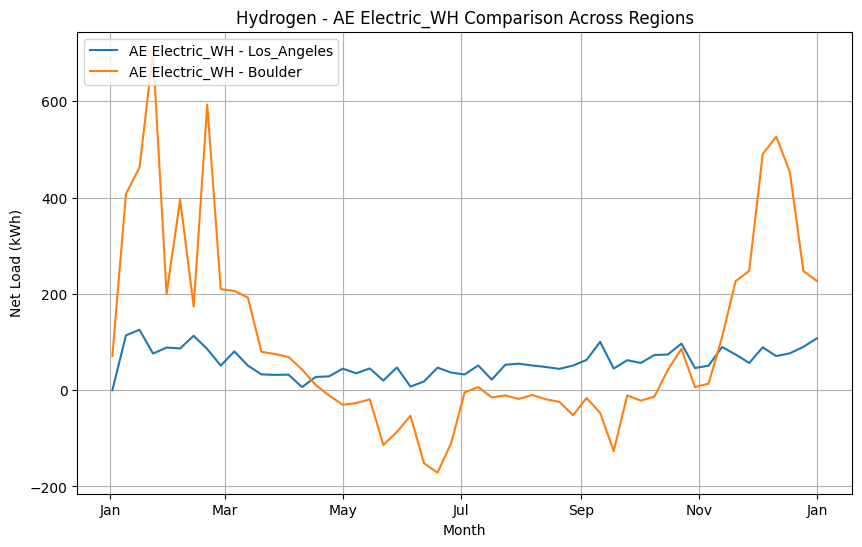

Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_NAE_Electric_WH_100_Site/Thermal_Battery_Results_Los_Angeles_NAE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_NAE_Electric_WH_100_Site/Battery_Results_Los_Angeles_NAE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_NAE_Electric_WH_100_Site/Hydrogen_Results_Los_Angeles_NAE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_NAE_Electric_WH_100_Site/CHP_Results_Los_Angeles_NAE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Boulder/Boulder_NAE_Electric_WH_100_Site/Thermal_Battery_Results_Boulder_NAE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Boulder/Boulder_NAE_Electric_WH_100_Site/Battery_Results_Boulder_NAE_Electric_WH_100_Site.csv
Loaded results from: 

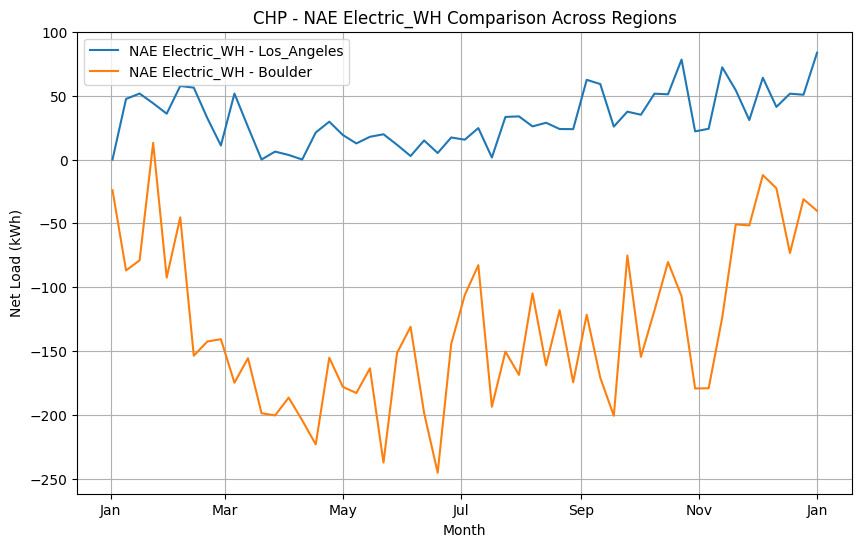

Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_NAE_Gas_WH_100_Site/Thermal_Battery_Results_Los_Angeles_NAE_Gas_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_NAE_Gas_WH_100_Site/Battery_Results_Los_Angeles_NAE_Gas_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_NAE_Gas_WH_100_Site/Hydrogen_Results_Los_Angeles_NAE_Gas_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_NAE_Gas_WH_100_Site/CHP_Results_Los_Angeles_NAE_Gas_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Boulder/Boulder_NAE_Gas_WH_100_Site/Thermal_Battery_Results_Boulder_NAE_Gas_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Boulder/Boulder_NAE_Gas_WH_100_Site/Battery_Results_Boulder_NAE_Gas_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Boulder/Boulder_NAE_Ga

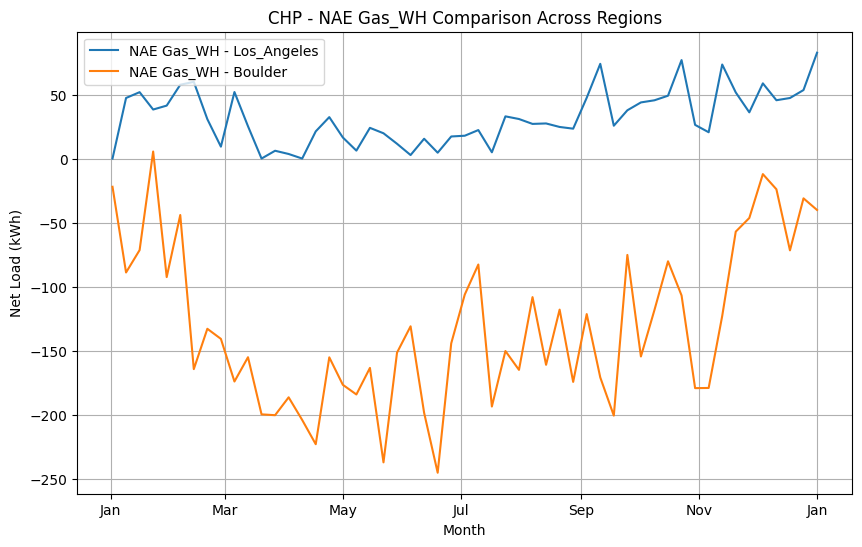

Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_AE_Electric_WH_100_Site/Thermal_Battery_Results_Los_Angeles_AE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_AE_Electric_WH_100_Site/Battery_Results_Los_Angeles_AE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_AE_Electric_WH_100_Site/Hydrogen_Results_Los_Angeles_AE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_AE_Electric_WH_100_Site/CHP_Results_Los_Angeles_AE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Boulder/Boulder_AE_Electric_WH_100_Site/Thermal_Battery_Results_Boulder_AE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Boulder/Boulder_AE_Electric_WH_100_Site/Battery_Results_Boulder_AE_Electric_WH_100_Site.csv
Loaded results from: /content/dri

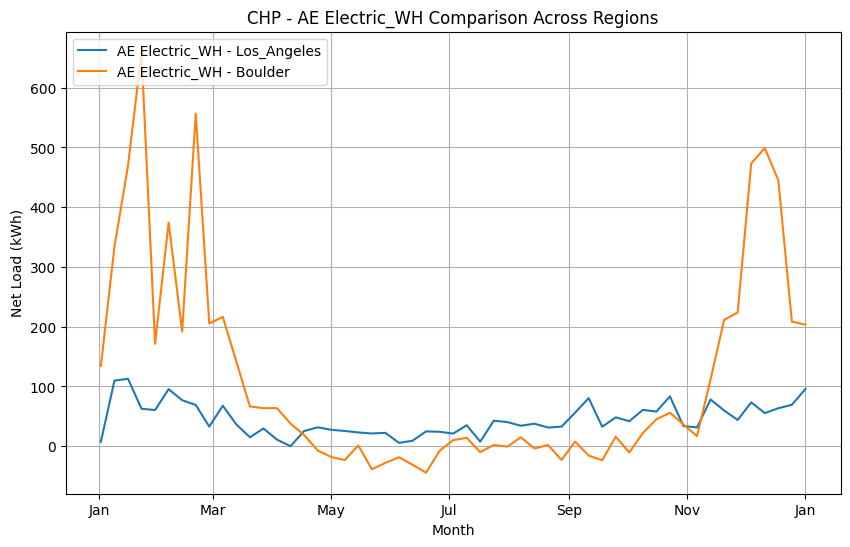

In [ ]:
compare_cities_net_load_storage("Los_Angeles", "Boulder")

## Plot Compare Cities By Storage (Normalized)

In [ ]:
def generate_net_load_storage_plots(config_results, region, energy_storage_type, normalize=False):
    plt.figure(figsize=(10, 6))
    baseline_net_load = None

    # Sort config_suffix keys to control the order of plotting
    sorted_configs = sorted(config_results.keys(), key=lambda x: ("AE" in x, "NAE" in x, "Electric_WH" in x, "Gas_WH" in x), reverse=True)

    for config_suffix in sorted_configs:
        results_dict = config_results[config_suffix]
        # Loop through each model's results within the configuration
        for model_type, results in results_dict.items():
            if 'Date' not in results.columns:
                continue

            results['Date'] = pd.to_datetime(results['Date'])
            weekly_results = results.set_index('Date').resample('W').sum()

            # Normalize the results if required
            if normalize:
                normalization_factor = max(results['P_PV'].sum(), 1e-9)  # Avoid division by zero
                weekly_results = weekly_results / normalization_factor

            # Plot net load with the selected energy storage type
            if energy_storage_type.lower() in model_type.lower() and model_type.lower() == energy_storage_type.lower():
                label = config_suffix.replace('_', ' ').replace(region, '').replace(' 100 Site', '').strip()
                plt.plot(weekly_results.index, weekly_results['Net_Load_Grid'], label=label)

            # Attempt to set the baseline net load without storage
            if 'Net_Load_Grid_Without' in results.columns:
                if baseline_net_load is None:
                    baseline_net_load = weekly_results['Net_Load_Grid_Without']
                else:
                    baseline_net_load = weekly_results['Net_Load_Grid_Without']  # Use only one instance as baseline

    # Adding baseline net load without storage for comparison
    if baseline_net_load is not None:
        plt.plot(baseline_net_load.index, baseline_net_load, linestyle='--', color='black', linewidth=1.5, label='Baseline')

    plt.xlabel('Month')
    plt.ylabel('Net Load (kWh)')
    plt.title(f'Weekly Net Load with {energy_storage_type} for {region}')
    plt.legend(title='', loc='upper left')
    plt.grid(True)
    plt.gca().xaxis.set_major_formatter(plt.matplotlib.dates.DateFormatter('%b'))  # Show month on x-axis
    plt.xticks(rotation=0)
    plt.show()

# Run the analysis and plotting for each region based on energy storage
def plot_net_load_based_on_storage(region, normalize=False):
    config_names = [
        f"{region}_{home_type}_{wh_type}_{int(nze_percentage*100)}_Site"
        for home_type in ["NAE", "AE"]
        for wh_type in ["Electric_WH", "Gas_WH"]
        for nze_percentage in [1.0]
    ]

    results_dict = {}
    for config_suffix in config_names:
        if "AE" in config_suffix and "Gas_WH" in config_suffix:
            continue
        results = load_results_from_csv(region, config_suffix)
        if not results:
            continue

        results_dict[config_suffix] = results

    # Plotting for each energy storage type
    for energy_storage_type in ["Battery", "Thermal_Battery", "Hydrogen", "CHP"]:
        generate_net_load_storage_plots(results_dict, region, energy_storage_type, normalize=normalize)

# Compare cities for the same energy storage configuration
def compare_cities_net_load_storage(*regions, energy_storage_type=None, normalize=False):
    energy_storage_types = ["Battery", "Thermal_Battery", "Hydrogen", "CHP"] if energy_storage_type is None else [energy_storage_type]

    for energy_storage_type in energy_storage_types:
        for home_type in ["NAE", "AE"]:
            for wh_type in ["Electric_WH", "Gas_WH"]:
                if home_type == "AE" and wh_type == "Gas_WH":
                    continue
                plt.figure(figsize=(10, 6))
                baseline_net_load = None
                for region in regions:
                    config_suffix = f"{region}_{home_type}_{wh_type}_100_Site"
                    results = load_results_from_csv(region, config_suffix)
                    if not results:
                        continue

                    if energy_storage_type.lower() in results.keys():
                        results_dict = results[energy_storage_type.lower()]
                        if 'Date' not in results_dict.columns:
                            continue

                        results_dict['Date'] = pd.to_datetime(results_dict['Date'])
                        weekly_results = results_dict.set_index('Date').resample('W').sum()

                        # Normalize the results if required
                        if normalize:
                            normalization_factor = max(results_dict['P_PV'].sum(), 1e-9)  # Avoid division by zero
                            weekly_results = weekly_results / normalization_factor

                        label = f"{home_type} {wh_type} - {region}"
                        plt.plot(weekly_results.index, weekly_results['Net_Load_Grid'], label=label)

                        if 'Net_Load_Grid_Without' in results_dict.columns and baseline_net_load is None:
                            baseline_net_load = weekly_results['Net_Load_Grid_Without']

                # Adding baseline net load without storage for comparison
                if baseline_net_load is not None:
                    plt.plot(baseline_net_load.index, baseline_net_load, linestyle='--', color='black', linewidth=1.5, label='Baseline')

                plt.xlabel('Month')
                plt.ylabel('Net Load (kWh)')
                plt.title(f'{energy_storage_type} - {home_type} {wh_type} Comparison Across Regions')
                plt.legend(title='', loc='upper left')
                plt.grid(True)
                plt.gca().xaxis.set_major_formatter(plt.matplotlib.dates.DateFormatter('%b'))
                plt.xticks(rotation=0)
                plt.show()

Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_NAE_Electric_WH_100_Site/Thermal_Battery_Results_Los_Angeles_NAE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_NAE_Electric_WH_100_Site/Battery_Results_Los_Angeles_NAE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_NAE_Electric_WH_100_Site/Hydrogen_Results_Los_Angeles_NAE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_NAE_Electric_WH_100_Site/CHP_Results_Los_Angeles_NAE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Boulder/Boulder_NAE_Electric_WH_100_Site/Thermal_Battery_Results_Boulder_NAE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Boulder/Boulder_NAE_Electric_WH_100_Site/Battery_Results_Boulder_NAE_Electric_WH_100_Site.csv
Loaded results from: 

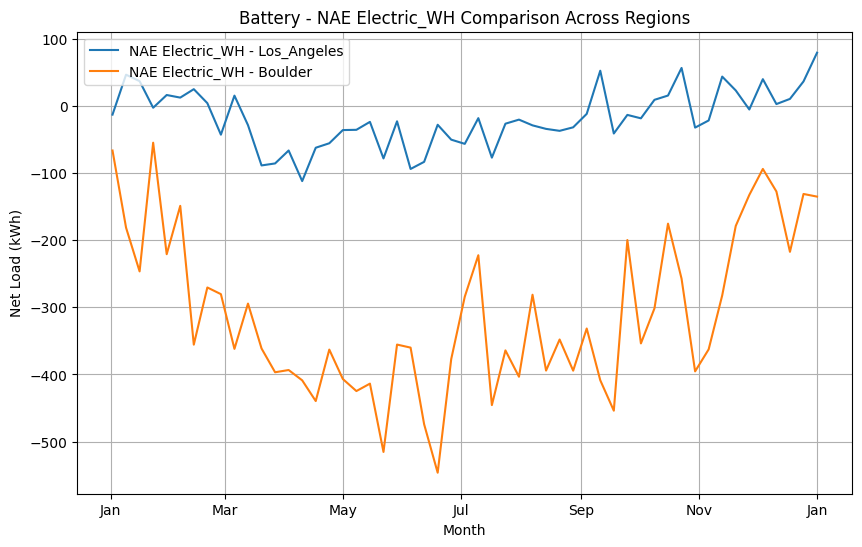

Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_NAE_Gas_WH_100_Site/Thermal_Battery_Results_Los_Angeles_NAE_Gas_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_NAE_Gas_WH_100_Site/Battery_Results_Los_Angeles_NAE_Gas_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_NAE_Gas_WH_100_Site/Hydrogen_Results_Los_Angeles_NAE_Gas_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_NAE_Gas_WH_100_Site/CHP_Results_Los_Angeles_NAE_Gas_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Boulder/Boulder_NAE_Gas_WH_100_Site/Thermal_Battery_Results_Boulder_NAE_Gas_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Boulder/Boulder_NAE_Gas_WH_100_Site/Battery_Results_Boulder_NAE_Gas_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Boulder/Boulder_NAE_Ga

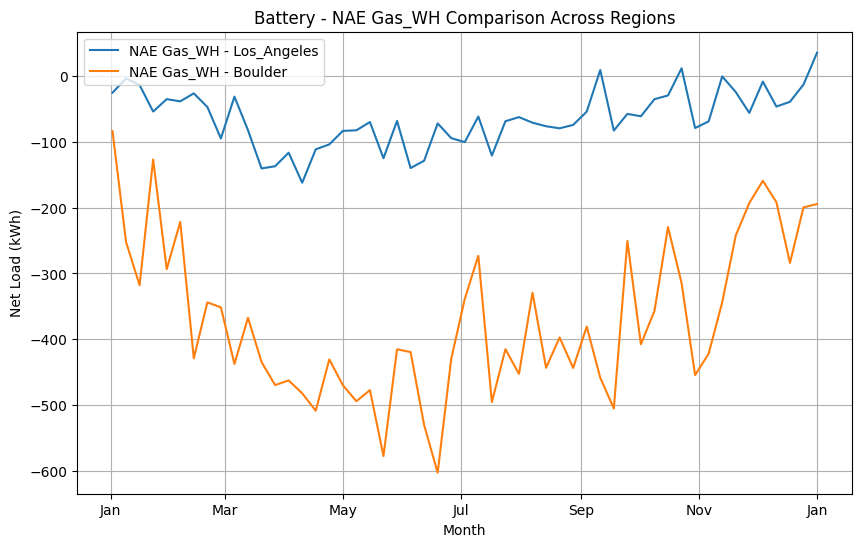

Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_AE_Electric_WH_100_Site/Thermal_Battery_Results_Los_Angeles_AE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_AE_Electric_WH_100_Site/Battery_Results_Los_Angeles_AE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_AE_Electric_WH_100_Site/Hydrogen_Results_Los_Angeles_AE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_AE_Electric_WH_100_Site/CHP_Results_Los_Angeles_AE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Boulder/Boulder_AE_Electric_WH_100_Site/Thermal_Battery_Results_Boulder_AE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Boulder/Boulder_AE_Electric_WH_100_Site/Battery_Results_Boulder_AE_Electric_WH_100_Site.csv
Loaded results from: /content/dri

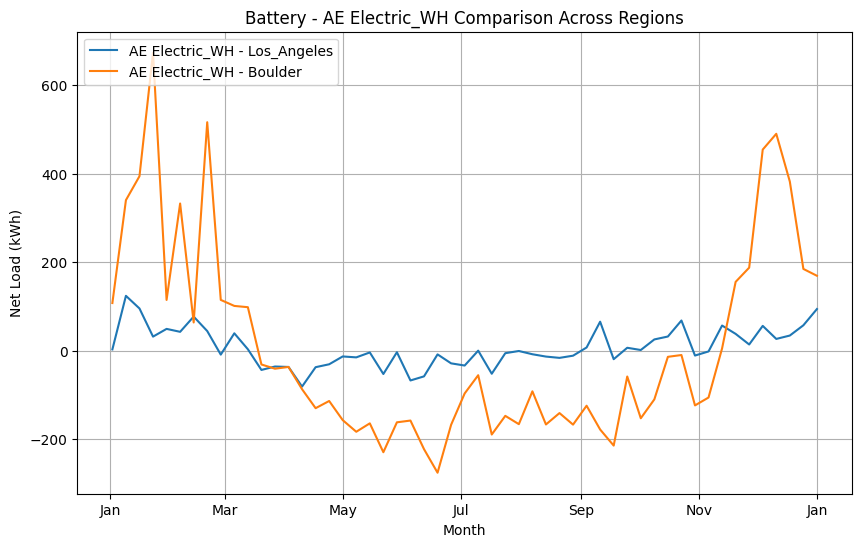

Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_NAE_Electric_WH_100_Site/Thermal_Battery_Results_Los_Angeles_NAE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_NAE_Electric_WH_100_Site/Battery_Results_Los_Angeles_NAE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_NAE_Electric_WH_100_Site/Hydrogen_Results_Los_Angeles_NAE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_NAE_Electric_WH_100_Site/CHP_Results_Los_Angeles_NAE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Boulder/Boulder_NAE_Electric_WH_100_Site/Thermal_Battery_Results_Boulder_NAE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Boulder/Boulder_NAE_Electric_WH_100_Site/Battery_Results_Boulder_NAE_Electric_WH_100_Site.csv
Loaded results from: 

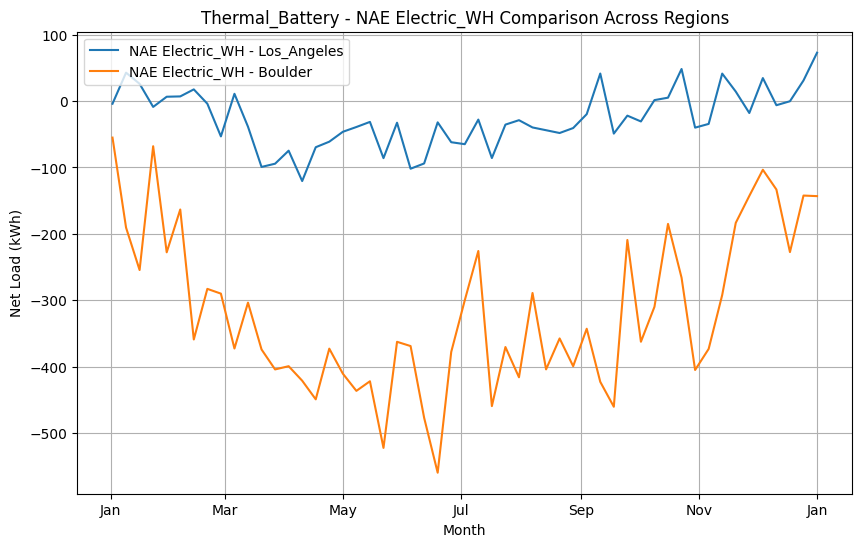

Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_NAE_Gas_WH_100_Site/Thermal_Battery_Results_Los_Angeles_NAE_Gas_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_NAE_Gas_WH_100_Site/Battery_Results_Los_Angeles_NAE_Gas_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_NAE_Gas_WH_100_Site/Hydrogen_Results_Los_Angeles_NAE_Gas_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_NAE_Gas_WH_100_Site/CHP_Results_Los_Angeles_NAE_Gas_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Boulder/Boulder_NAE_Gas_WH_100_Site/Thermal_Battery_Results_Boulder_NAE_Gas_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Boulder/Boulder_NAE_Gas_WH_100_Site/Battery_Results_Boulder_NAE_Gas_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Boulder/Boulder_NAE_Ga

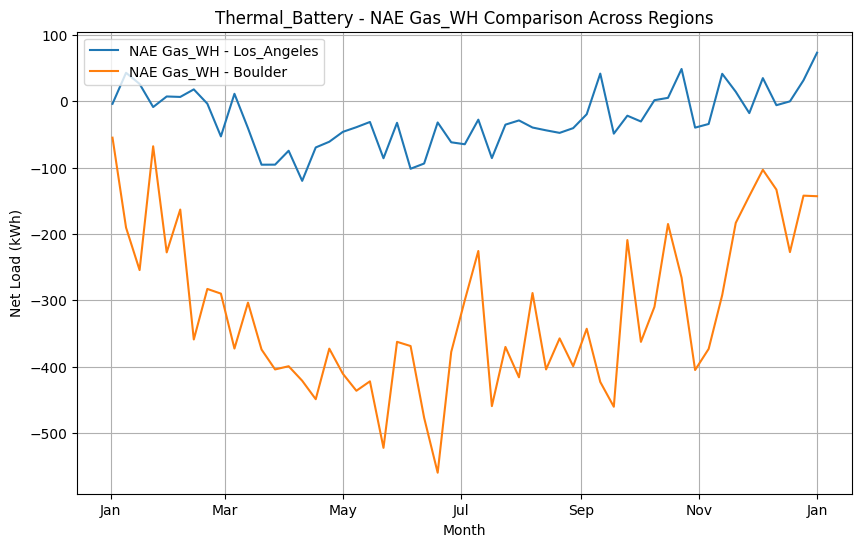

Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_AE_Electric_WH_100_Site/Thermal_Battery_Results_Los_Angeles_AE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_AE_Electric_WH_100_Site/Battery_Results_Los_Angeles_AE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_AE_Electric_WH_100_Site/Hydrogen_Results_Los_Angeles_AE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_AE_Electric_WH_100_Site/CHP_Results_Los_Angeles_AE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Boulder/Boulder_AE_Electric_WH_100_Site/Thermal_Battery_Results_Boulder_AE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Boulder/Boulder_AE_Electric_WH_100_Site/Battery_Results_Boulder_AE_Electric_WH_100_Site.csv
Loaded results from: /content/dri

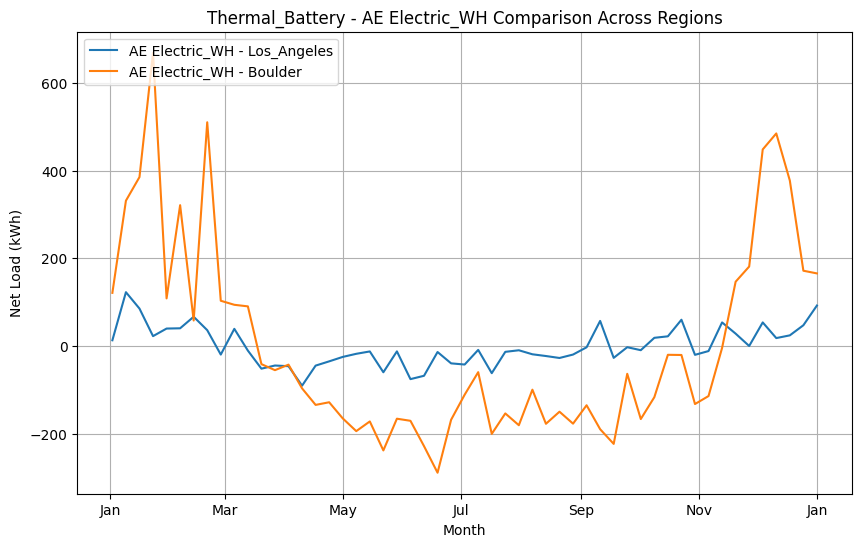

Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_NAE_Electric_WH_100_Site/Thermal_Battery_Results_Los_Angeles_NAE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_NAE_Electric_WH_100_Site/Battery_Results_Los_Angeles_NAE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_NAE_Electric_WH_100_Site/Hydrogen_Results_Los_Angeles_NAE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_NAE_Electric_WH_100_Site/CHP_Results_Los_Angeles_NAE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Boulder/Boulder_NAE_Electric_WH_100_Site/Thermal_Battery_Results_Boulder_NAE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Boulder/Boulder_NAE_Electric_WH_100_Site/Battery_Results_Boulder_NAE_Electric_WH_100_Site.csv
Loaded results from: 

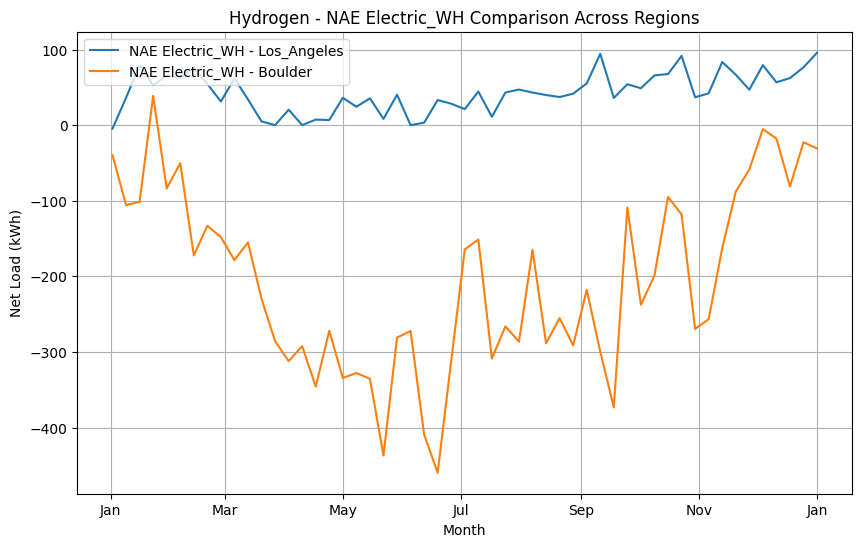

Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_NAE_Gas_WH_100_Site/Thermal_Battery_Results_Los_Angeles_NAE_Gas_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_NAE_Gas_WH_100_Site/Battery_Results_Los_Angeles_NAE_Gas_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_NAE_Gas_WH_100_Site/Hydrogen_Results_Los_Angeles_NAE_Gas_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_NAE_Gas_WH_100_Site/CHP_Results_Los_Angeles_NAE_Gas_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Boulder/Boulder_NAE_Gas_WH_100_Site/Thermal_Battery_Results_Boulder_NAE_Gas_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Boulder/Boulder_NAE_Gas_WH_100_Site/Battery_Results_Boulder_NAE_Gas_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Boulder/Boulder_NAE_Ga

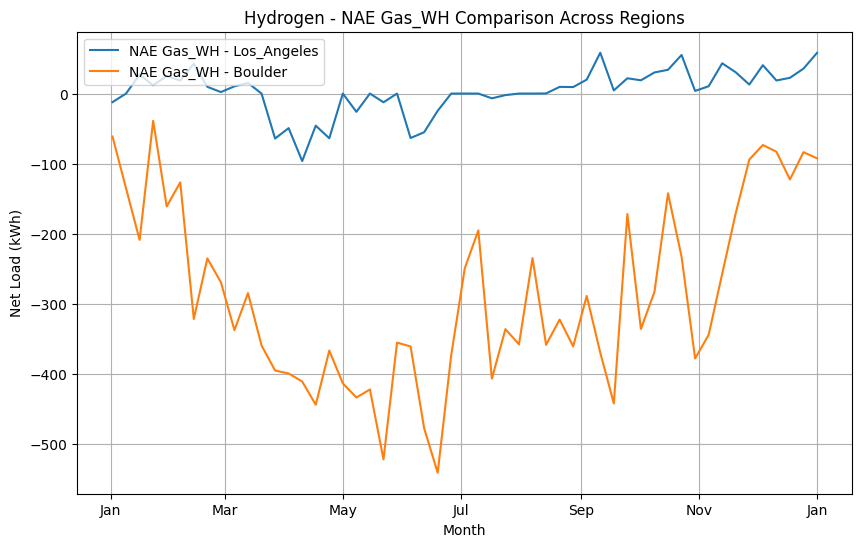

Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_AE_Electric_WH_100_Site/Thermal_Battery_Results_Los_Angeles_AE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_AE_Electric_WH_100_Site/Battery_Results_Los_Angeles_AE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_AE_Electric_WH_100_Site/Hydrogen_Results_Los_Angeles_AE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_AE_Electric_WH_100_Site/CHP_Results_Los_Angeles_AE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Boulder/Boulder_AE_Electric_WH_100_Site/Thermal_Battery_Results_Boulder_AE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Boulder/Boulder_AE_Electric_WH_100_Site/Battery_Results_Boulder_AE_Electric_WH_100_Site.csv
Loaded results from: /content/dri

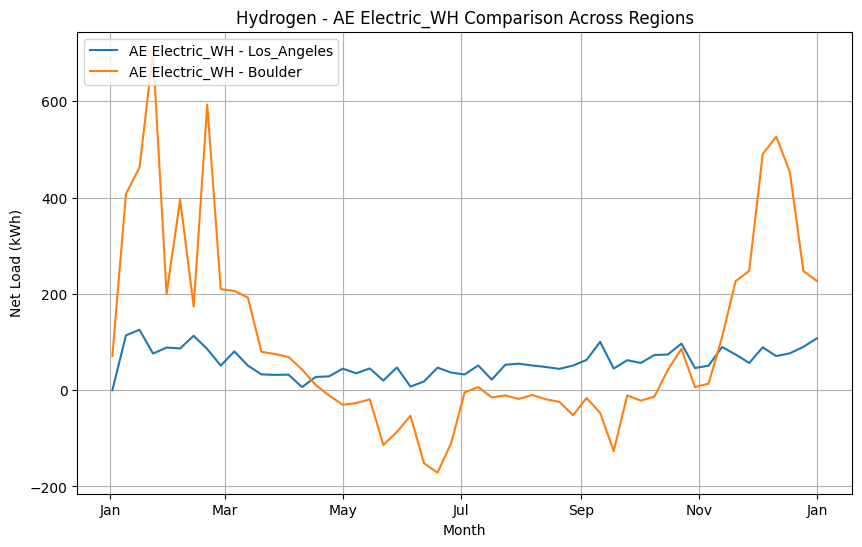

Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_NAE_Electric_WH_100_Site/Thermal_Battery_Results_Los_Angeles_NAE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_NAE_Electric_WH_100_Site/Battery_Results_Los_Angeles_NAE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_NAE_Electric_WH_100_Site/Hydrogen_Results_Los_Angeles_NAE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_NAE_Electric_WH_100_Site/CHP_Results_Los_Angeles_NAE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Boulder/Boulder_NAE_Electric_WH_100_Site/Thermal_Battery_Results_Boulder_NAE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Boulder/Boulder_NAE_Electric_WH_100_Site/Battery_Results_Boulder_NAE_Electric_WH_100_Site.csv
Loaded results from: 

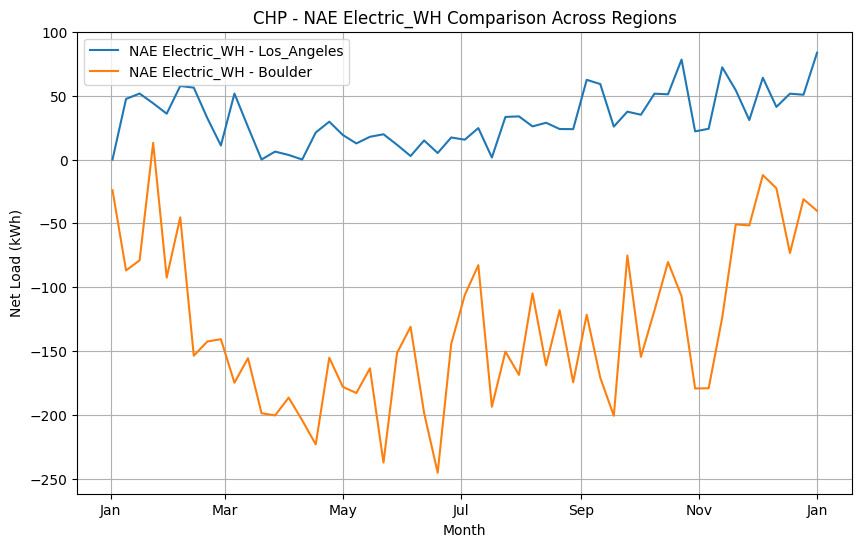

Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_NAE_Gas_WH_100_Site/Thermal_Battery_Results_Los_Angeles_NAE_Gas_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_NAE_Gas_WH_100_Site/Battery_Results_Los_Angeles_NAE_Gas_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_NAE_Gas_WH_100_Site/Hydrogen_Results_Los_Angeles_NAE_Gas_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_NAE_Gas_WH_100_Site/CHP_Results_Los_Angeles_NAE_Gas_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Boulder/Boulder_NAE_Gas_WH_100_Site/Thermal_Battery_Results_Boulder_NAE_Gas_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Boulder/Boulder_NAE_Gas_WH_100_Site/Battery_Results_Boulder_NAE_Gas_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Boulder/Boulder_NAE_Ga

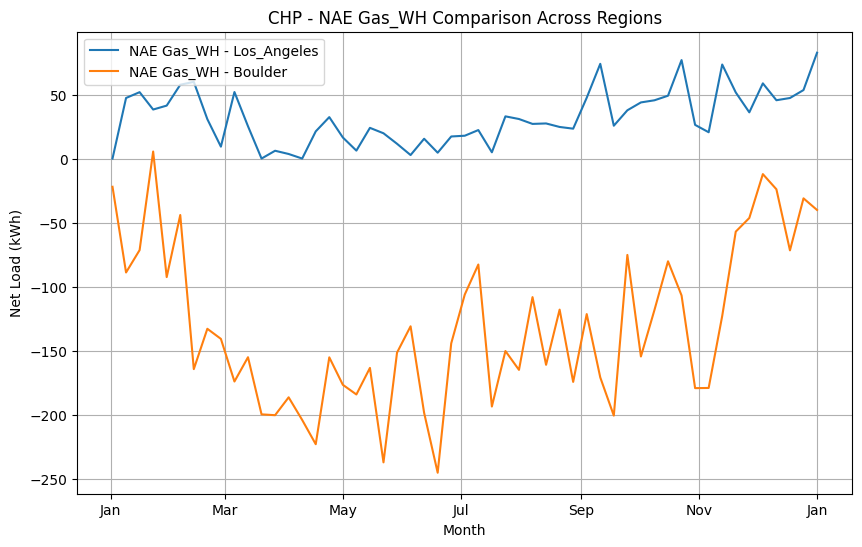

Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_AE_Electric_WH_100_Site/Thermal_Battery_Results_Los_Angeles_AE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_AE_Electric_WH_100_Site/Battery_Results_Los_Angeles_AE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_AE_Electric_WH_100_Site/Hydrogen_Results_Los_Angeles_AE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_AE_Electric_WH_100_Site/CHP_Results_Los_Angeles_AE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Boulder/Boulder_AE_Electric_WH_100_Site/Thermal_Battery_Results_Boulder_AE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Boulder/Boulder_AE_Electric_WH_100_Site/Battery_Results_Boulder_AE_Electric_WH_100_Site.csv
Loaded results from: /content/dri

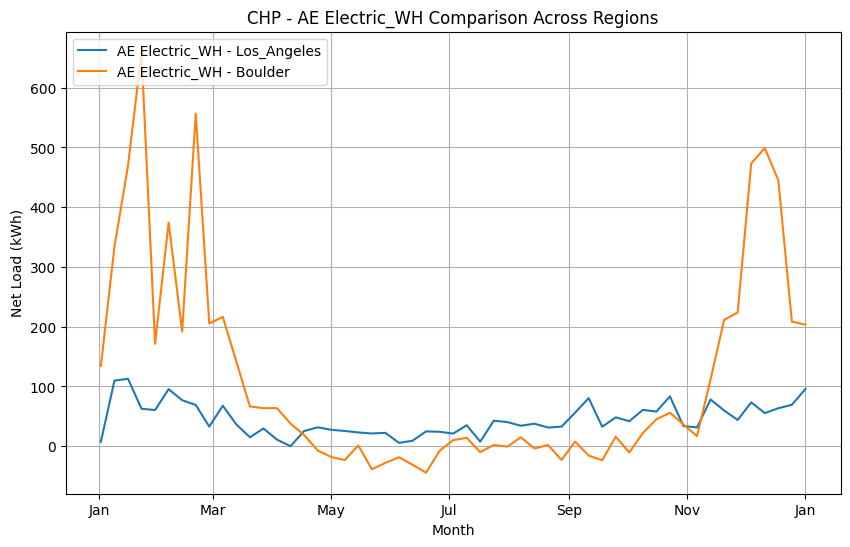

Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_NAE_Electric_WH_100_Site/Thermal_Battery_Results_Los_Angeles_NAE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_NAE_Electric_WH_100_Site/Battery_Results_Los_Angeles_NAE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_NAE_Electric_WH_100_Site/Hydrogen_Results_Los_Angeles_NAE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_NAE_Electric_WH_100_Site/CHP_Results_Los_Angeles_NAE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Boulder/Boulder_NAE_Electric_WH_100_Site/Thermal_Battery_Results_Boulder_NAE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Boulder/Boulder_NAE_Electric_WH_100_Site/Battery_Results_Boulder_NAE_Electric_WH_100_Site.csv
Loaded results from: 

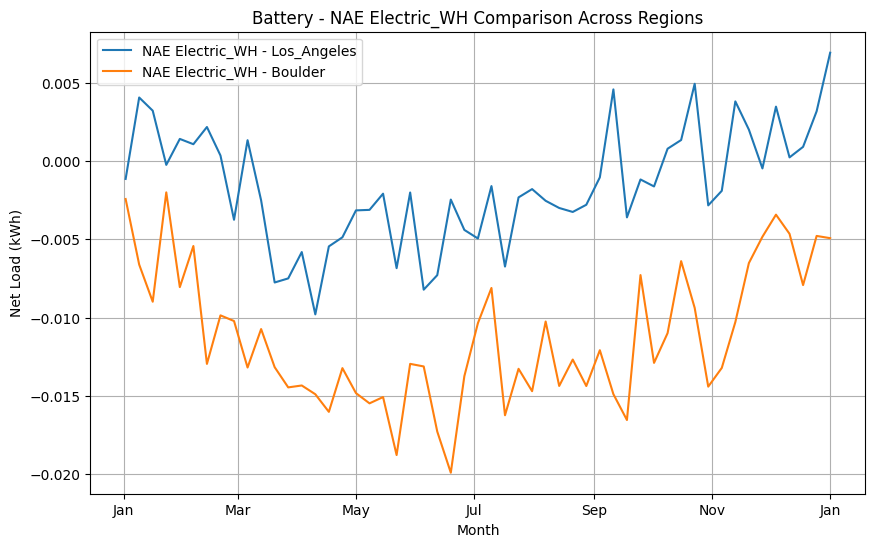

Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_NAE_Gas_WH_100_Site/Thermal_Battery_Results_Los_Angeles_NAE_Gas_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_NAE_Gas_WH_100_Site/Battery_Results_Los_Angeles_NAE_Gas_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_NAE_Gas_WH_100_Site/Hydrogen_Results_Los_Angeles_NAE_Gas_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_NAE_Gas_WH_100_Site/CHP_Results_Los_Angeles_NAE_Gas_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Boulder/Boulder_NAE_Gas_WH_100_Site/Thermal_Battery_Results_Boulder_NAE_Gas_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Boulder/Boulder_NAE_Gas_WH_100_Site/Battery_Results_Boulder_NAE_Gas_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Boulder/Boulder_NAE_Ga

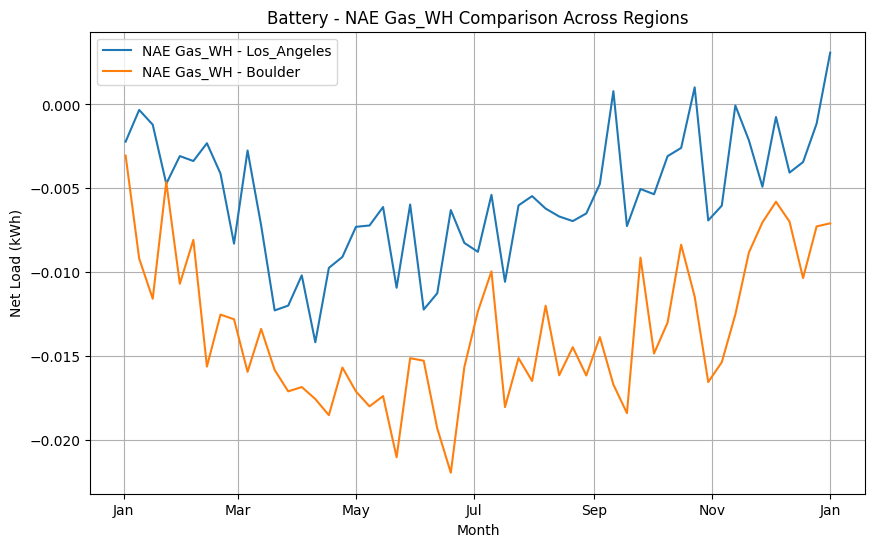

Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_AE_Electric_WH_100_Site/Thermal_Battery_Results_Los_Angeles_AE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_AE_Electric_WH_100_Site/Battery_Results_Los_Angeles_AE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_AE_Electric_WH_100_Site/Hydrogen_Results_Los_Angeles_AE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_AE_Electric_WH_100_Site/CHP_Results_Los_Angeles_AE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Boulder/Boulder_AE_Electric_WH_100_Site/Thermal_Battery_Results_Boulder_AE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Boulder/Boulder_AE_Electric_WH_100_Site/Battery_Results_Boulder_AE_Electric_WH_100_Site.csv
Loaded results from: /content/dri

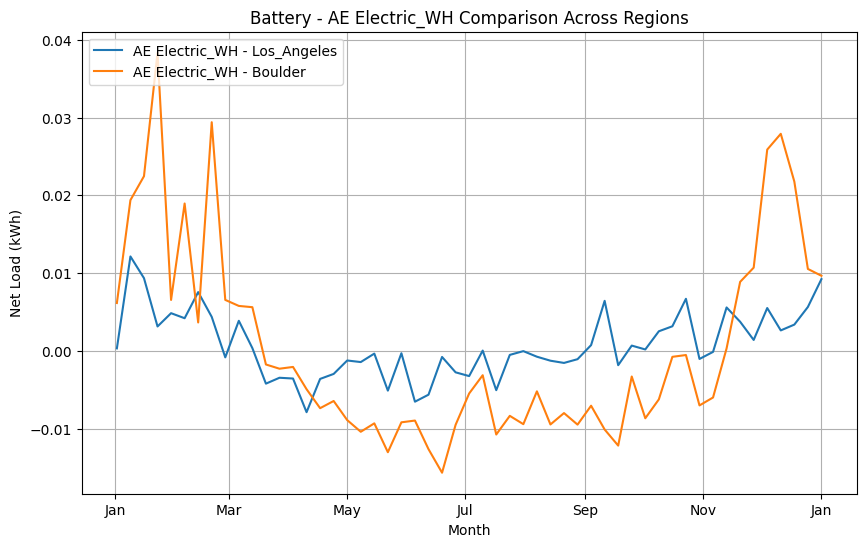

Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_NAE_Electric_WH_100_Site/Thermal_Battery_Results_Los_Angeles_NAE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_NAE_Electric_WH_100_Site/Battery_Results_Los_Angeles_NAE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_NAE_Electric_WH_100_Site/Hydrogen_Results_Los_Angeles_NAE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_NAE_Electric_WH_100_Site/CHP_Results_Los_Angeles_NAE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Boulder/Boulder_NAE_Electric_WH_100_Site/Thermal_Battery_Results_Boulder_NAE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Boulder/Boulder_NAE_Electric_WH_100_Site/Battery_Results_Boulder_NAE_Electric_WH_100_Site.csv
Loaded results from: 

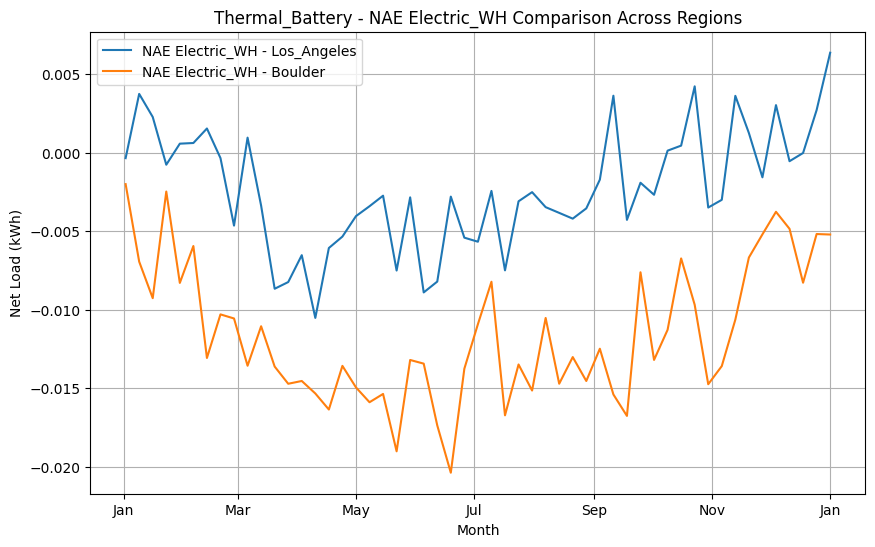

Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_NAE_Gas_WH_100_Site/Thermal_Battery_Results_Los_Angeles_NAE_Gas_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_NAE_Gas_WH_100_Site/Battery_Results_Los_Angeles_NAE_Gas_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_NAE_Gas_WH_100_Site/Hydrogen_Results_Los_Angeles_NAE_Gas_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_NAE_Gas_WH_100_Site/CHP_Results_Los_Angeles_NAE_Gas_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Boulder/Boulder_NAE_Gas_WH_100_Site/Thermal_Battery_Results_Boulder_NAE_Gas_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Boulder/Boulder_NAE_Gas_WH_100_Site/Battery_Results_Boulder_NAE_Gas_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Boulder/Boulder_NAE_Ga

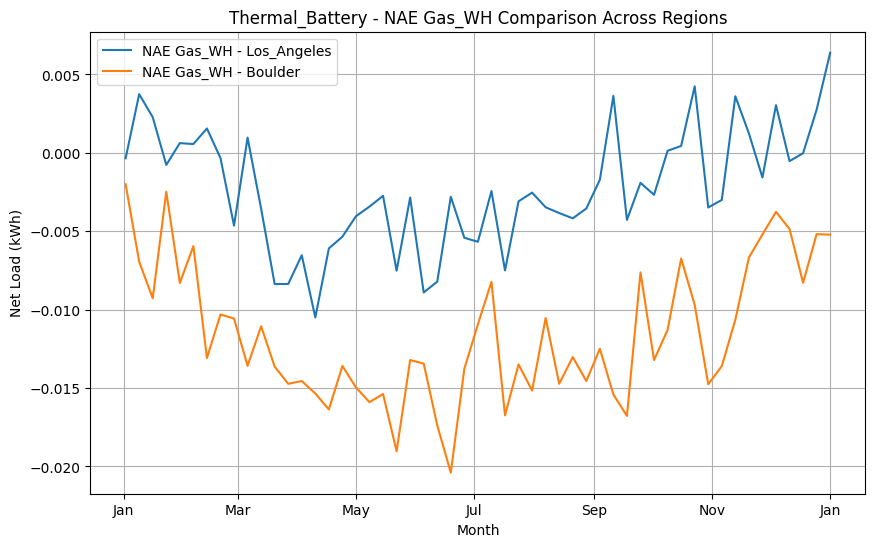

Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_AE_Electric_WH_100_Site/Thermal_Battery_Results_Los_Angeles_AE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_AE_Electric_WH_100_Site/Battery_Results_Los_Angeles_AE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_AE_Electric_WH_100_Site/Hydrogen_Results_Los_Angeles_AE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_AE_Electric_WH_100_Site/CHP_Results_Los_Angeles_AE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Boulder/Boulder_AE_Electric_WH_100_Site/Thermal_Battery_Results_Boulder_AE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Boulder/Boulder_AE_Electric_WH_100_Site/Battery_Results_Boulder_AE_Electric_WH_100_Site.csv
Loaded results from: /content/dri

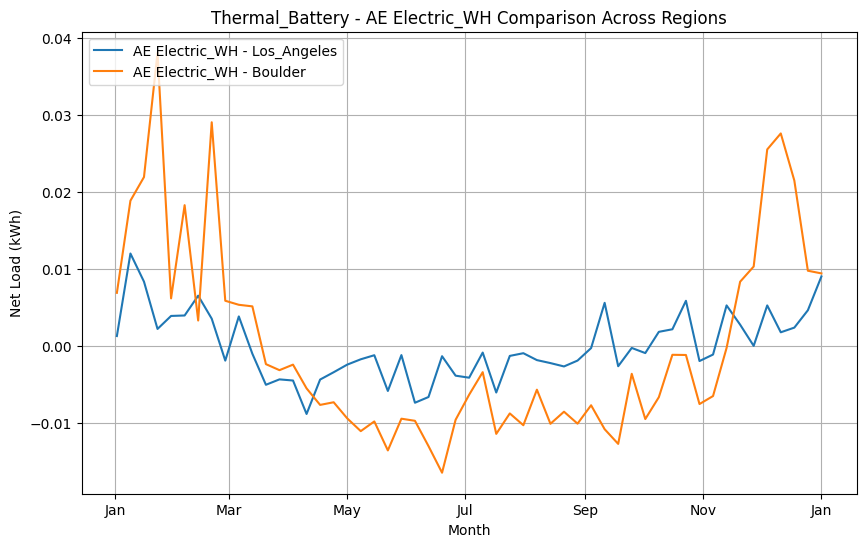

Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_NAE_Electric_WH_100_Site/Thermal_Battery_Results_Los_Angeles_NAE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_NAE_Electric_WH_100_Site/Battery_Results_Los_Angeles_NAE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_NAE_Electric_WH_100_Site/Hydrogen_Results_Los_Angeles_NAE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_NAE_Electric_WH_100_Site/CHP_Results_Los_Angeles_NAE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Boulder/Boulder_NAE_Electric_WH_100_Site/Thermal_Battery_Results_Boulder_NAE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Boulder/Boulder_NAE_Electric_WH_100_Site/Battery_Results_Boulder_NAE_Electric_WH_100_Site.csv
Loaded results from: 

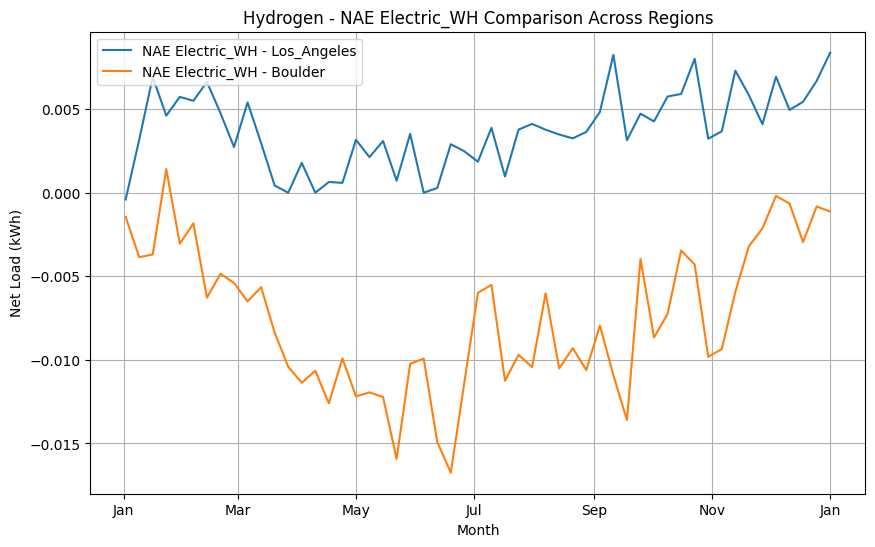

Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_NAE_Gas_WH_100_Site/Thermal_Battery_Results_Los_Angeles_NAE_Gas_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_NAE_Gas_WH_100_Site/Battery_Results_Los_Angeles_NAE_Gas_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_NAE_Gas_WH_100_Site/Hydrogen_Results_Los_Angeles_NAE_Gas_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_NAE_Gas_WH_100_Site/CHP_Results_Los_Angeles_NAE_Gas_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Boulder/Boulder_NAE_Gas_WH_100_Site/Thermal_Battery_Results_Boulder_NAE_Gas_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Boulder/Boulder_NAE_Gas_WH_100_Site/Battery_Results_Boulder_NAE_Gas_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Boulder/Boulder_NAE_Ga

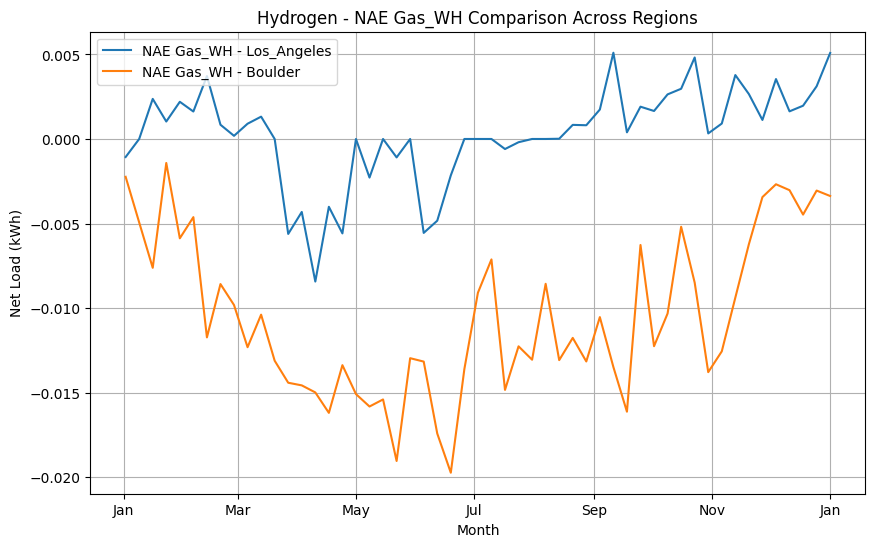

Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_AE_Electric_WH_100_Site/Thermal_Battery_Results_Los_Angeles_AE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_AE_Electric_WH_100_Site/Battery_Results_Los_Angeles_AE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_AE_Electric_WH_100_Site/Hydrogen_Results_Los_Angeles_AE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_AE_Electric_WH_100_Site/CHP_Results_Los_Angeles_AE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Boulder/Boulder_AE_Electric_WH_100_Site/Thermal_Battery_Results_Boulder_AE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Boulder/Boulder_AE_Electric_WH_100_Site/Battery_Results_Boulder_AE_Electric_WH_100_Site.csv
Loaded results from: /content/dri

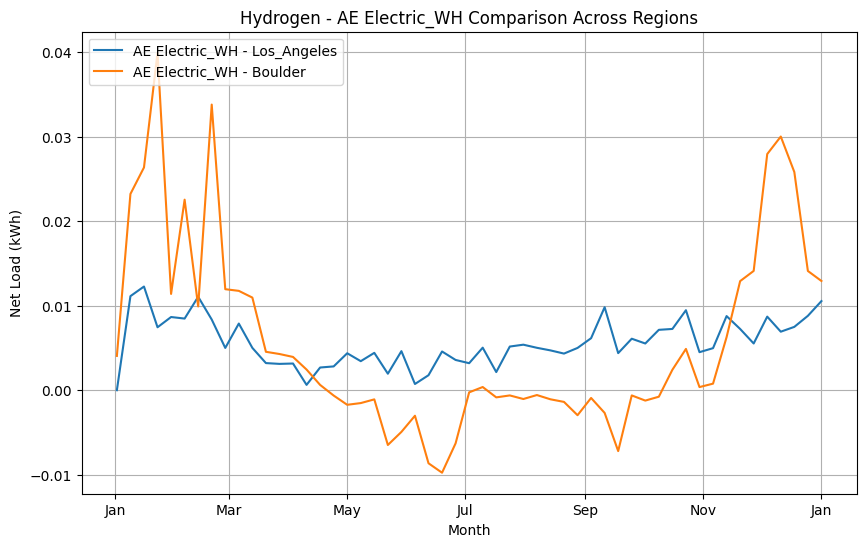

Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_NAE_Electric_WH_100_Site/Thermal_Battery_Results_Los_Angeles_NAE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_NAE_Electric_WH_100_Site/Battery_Results_Los_Angeles_NAE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_NAE_Electric_WH_100_Site/Hydrogen_Results_Los_Angeles_NAE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_NAE_Electric_WH_100_Site/CHP_Results_Los_Angeles_NAE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Boulder/Boulder_NAE_Electric_WH_100_Site/Thermal_Battery_Results_Boulder_NAE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Boulder/Boulder_NAE_Electric_WH_100_Site/Battery_Results_Boulder_NAE_Electric_WH_100_Site.csv
Loaded results from: 

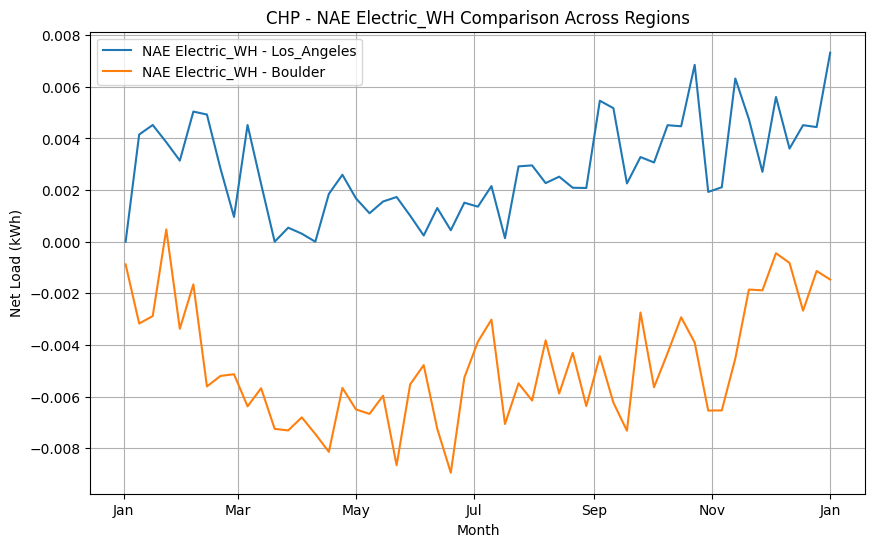

Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_NAE_Gas_WH_100_Site/Thermal_Battery_Results_Los_Angeles_NAE_Gas_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_NAE_Gas_WH_100_Site/Battery_Results_Los_Angeles_NAE_Gas_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_NAE_Gas_WH_100_Site/Hydrogen_Results_Los_Angeles_NAE_Gas_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_NAE_Gas_WH_100_Site/CHP_Results_Los_Angeles_NAE_Gas_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Boulder/Boulder_NAE_Gas_WH_100_Site/Thermal_Battery_Results_Boulder_NAE_Gas_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Boulder/Boulder_NAE_Gas_WH_100_Site/Battery_Results_Boulder_NAE_Gas_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Boulder/Boulder_NAE_Ga

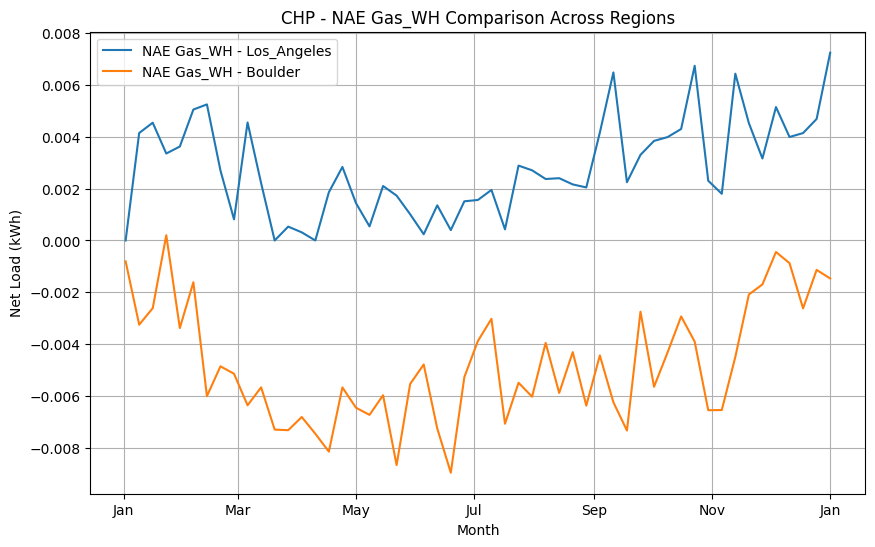

Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_AE_Electric_WH_100_Site/Thermal_Battery_Results_Los_Angeles_AE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_AE_Electric_WH_100_Site/Battery_Results_Los_Angeles_AE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_AE_Electric_WH_100_Site/Hydrogen_Results_Los_Angeles_AE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_AE_Electric_WH_100_Site/CHP_Results_Los_Angeles_AE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Boulder/Boulder_AE_Electric_WH_100_Site/Thermal_Battery_Results_Boulder_AE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Boulder/Boulder_AE_Electric_WH_100_Site/Battery_Results_Boulder_AE_Electric_WH_100_Site.csv
Loaded results from: /content/dri

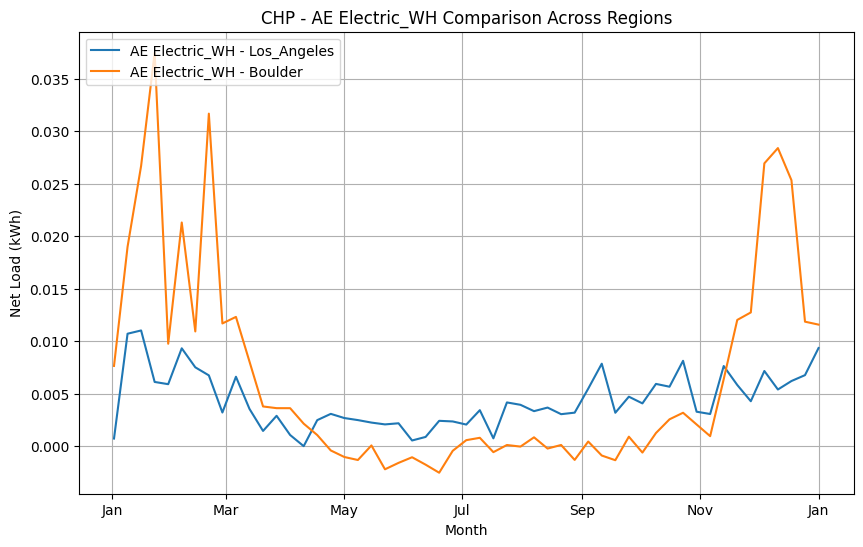

In [ ]:
# To compare cities without normalization (default setting):
compare_cities_net_load_storage("Los_Angeles", "Boulder")



Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_NAE_Electric_WH_100_Site/Thermal_Battery_Results_Los_Angeles_NAE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_NAE_Electric_WH_100_Site/Battery_Results_Los_Angeles_NAE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_NAE_Electric_WH_100_Site/Hydrogen_Results_Los_Angeles_NAE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_NAE_Electric_WH_100_Site/CHP_Results_Los_Angeles_NAE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Boulder/Boulder_NAE_Electric_WH_100_Site/Thermal_Battery_Results_Boulder_NAE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Boulder/Boulder_NAE_Electric_WH_100_Site/Battery_Results_Boulder_NAE_Electric_WH_100_Site.csv
Loaded results from: 

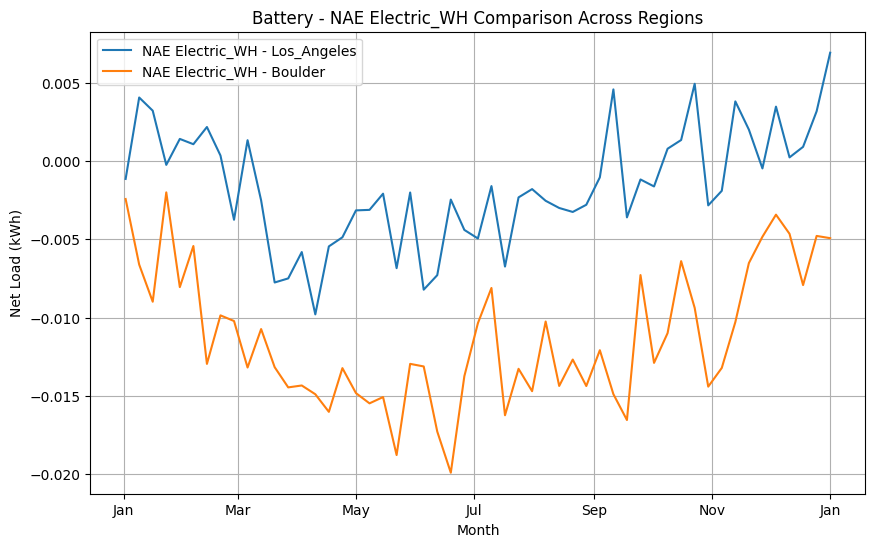

Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_NAE_Gas_WH_100_Site/Thermal_Battery_Results_Los_Angeles_NAE_Gas_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_NAE_Gas_WH_100_Site/Battery_Results_Los_Angeles_NAE_Gas_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_NAE_Gas_WH_100_Site/Hydrogen_Results_Los_Angeles_NAE_Gas_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_NAE_Gas_WH_100_Site/CHP_Results_Los_Angeles_NAE_Gas_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Boulder/Boulder_NAE_Gas_WH_100_Site/Thermal_Battery_Results_Boulder_NAE_Gas_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Boulder/Boulder_NAE_Gas_WH_100_Site/Battery_Results_Boulder_NAE_Gas_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Boulder/Boulder_NAE_Ga

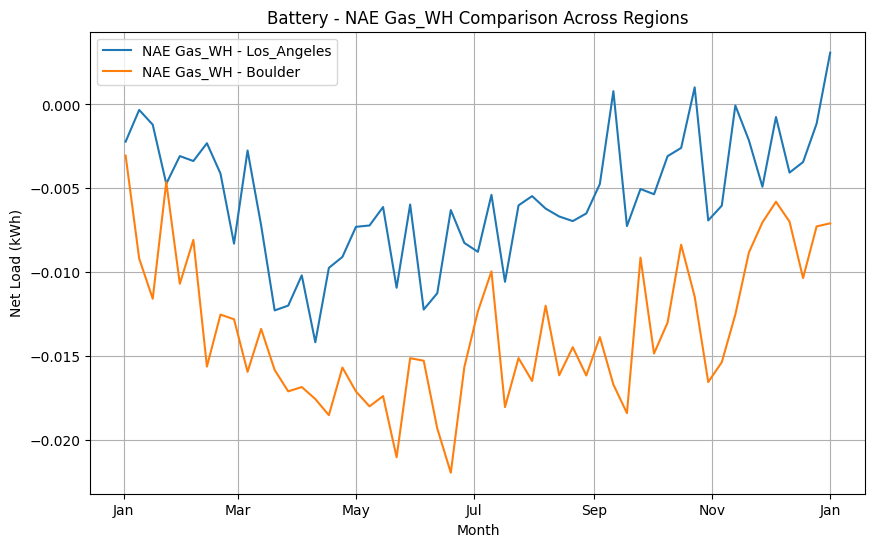

Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_AE_Electric_WH_100_Site/Thermal_Battery_Results_Los_Angeles_AE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_AE_Electric_WH_100_Site/Battery_Results_Los_Angeles_AE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_AE_Electric_WH_100_Site/Hydrogen_Results_Los_Angeles_AE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_AE_Electric_WH_100_Site/CHP_Results_Los_Angeles_AE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Boulder/Boulder_AE_Electric_WH_100_Site/Thermal_Battery_Results_Boulder_AE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Boulder/Boulder_AE_Electric_WH_100_Site/Battery_Results_Boulder_AE_Electric_WH_100_Site.csv
Loaded results from: /content/dri

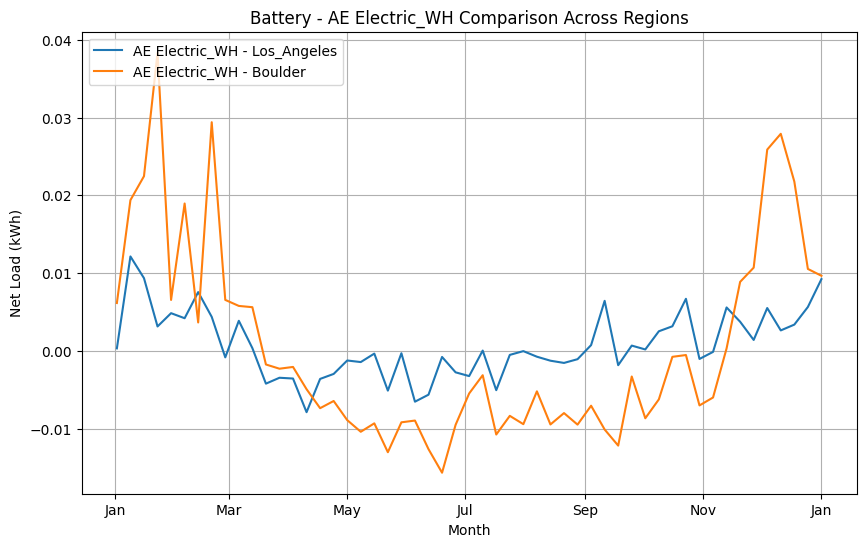

Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_NAE_Electric_WH_100_Site/Thermal_Battery_Results_Los_Angeles_NAE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_NAE_Electric_WH_100_Site/Battery_Results_Los_Angeles_NAE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_NAE_Electric_WH_100_Site/Hydrogen_Results_Los_Angeles_NAE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_NAE_Electric_WH_100_Site/CHP_Results_Los_Angeles_NAE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Boulder/Boulder_NAE_Electric_WH_100_Site/Thermal_Battery_Results_Boulder_NAE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Boulder/Boulder_NAE_Electric_WH_100_Site/Battery_Results_Boulder_NAE_Electric_WH_100_Site.csv
Loaded results from: 

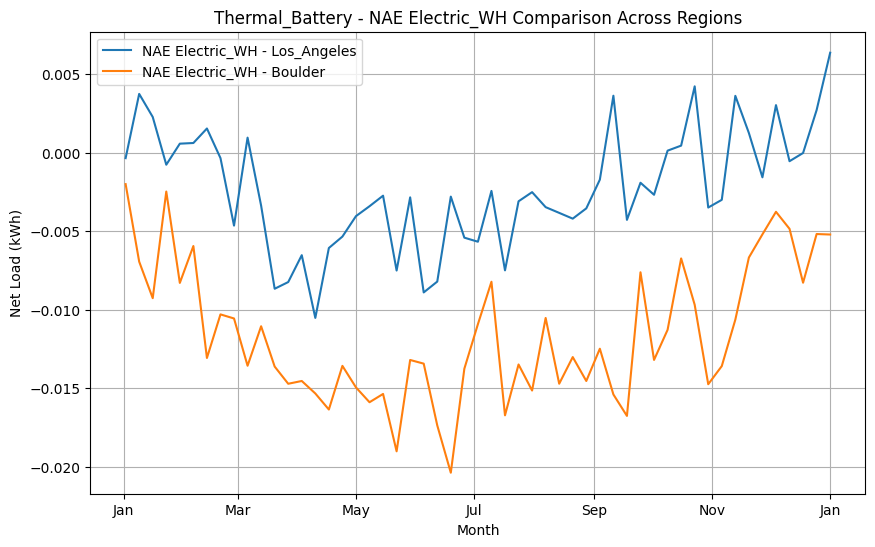

Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_NAE_Gas_WH_100_Site/Thermal_Battery_Results_Los_Angeles_NAE_Gas_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_NAE_Gas_WH_100_Site/Battery_Results_Los_Angeles_NAE_Gas_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_NAE_Gas_WH_100_Site/Hydrogen_Results_Los_Angeles_NAE_Gas_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_NAE_Gas_WH_100_Site/CHP_Results_Los_Angeles_NAE_Gas_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Boulder/Boulder_NAE_Gas_WH_100_Site/Thermal_Battery_Results_Boulder_NAE_Gas_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Boulder/Boulder_NAE_Gas_WH_100_Site/Battery_Results_Boulder_NAE_Gas_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Boulder/Boulder_NAE_Ga

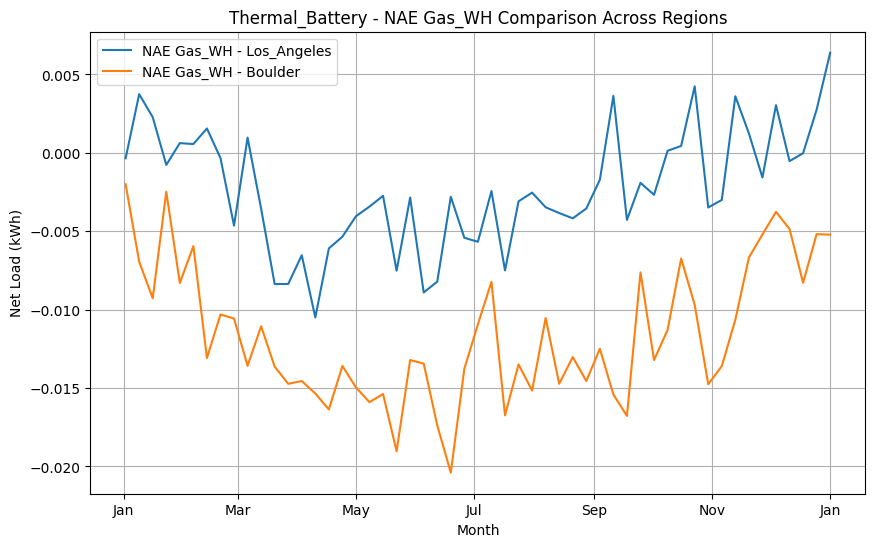

Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_AE_Electric_WH_100_Site/Thermal_Battery_Results_Los_Angeles_AE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_AE_Electric_WH_100_Site/Battery_Results_Los_Angeles_AE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_AE_Electric_WH_100_Site/Hydrogen_Results_Los_Angeles_AE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_AE_Electric_WH_100_Site/CHP_Results_Los_Angeles_AE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Boulder/Boulder_AE_Electric_WH_100_Site/Thermal_Battery_Results_Boulder_AE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Boulder/Boulder_AE_Electric_WH_100_Site/Battery_Results_Boulder_AE_Electric_WH_100_Site.csv
Loaded results from: /content/dri

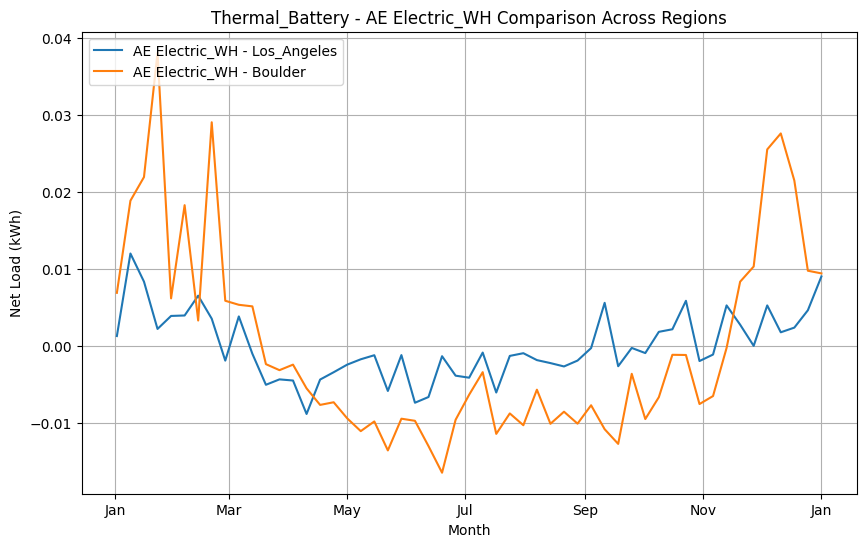

Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_NAE_Electric_WH_100_Site/Thermal_Battery_Results_Los_Angeles_NAE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_NAE_Electric_WH_100_Site/Battery_Results_Los_Angeles_NAE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_NAE_Electric_WH_100_Site/Hydrogen_Results_Los_Angeles_NAE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_NAE_Electric_WH_100_Site/CHP_Results_Los_Angeles_NAE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Boulder/Boulder_NAE_Electric_WH_100_Site/Thermal_Battery_Results_Boulder_NAE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Boulder/Boulder_NAE_Electric_WH_100_Site/Battery_Results_Boulder_NAE_Electric_WH_100_Site.csv
Loaded results from: 

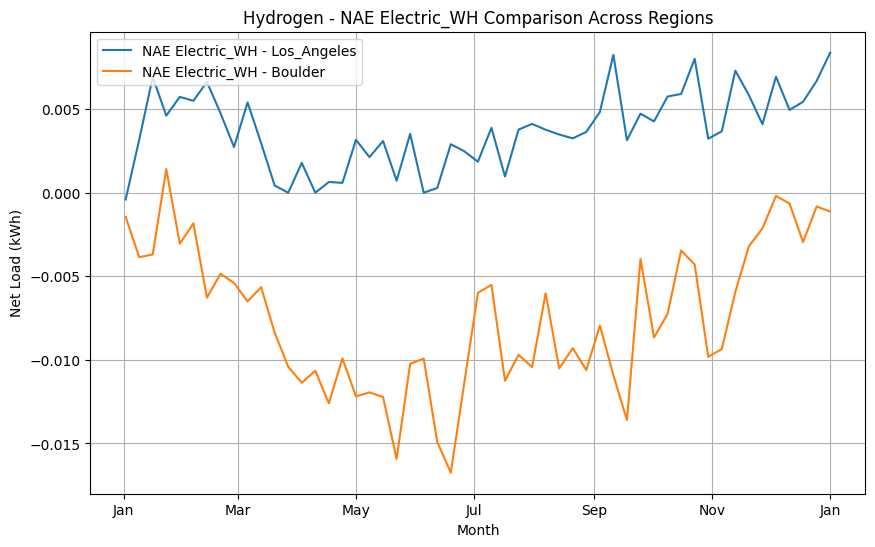

Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_NAE_Gas_WH_100_Site/Thermal_Battery_Results_Los_Angeles_NAE_Gas_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_NAE_Gas_WH_100_Site/Battery_Results_Los_Angeles_NAE_Gas_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_NAE_Gas_WH_100_Site/Hydrogen_Results_Los_Angeles_NAE_Gas_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_NAE_Gas_WH_100_Site/CHP_Results_Los_Angeles_NAE_Gas_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Boulder/Boulder_NAE_Gas_WH_100_Site/Thermal_Battery_Results_Boulder_NAE_Gas_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Boulder/Boulder_NAE_Gas_WH_100_Site/Battery_Results_Boulder_NAE_Gas_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Boulder/Boulder_NAE_Ga

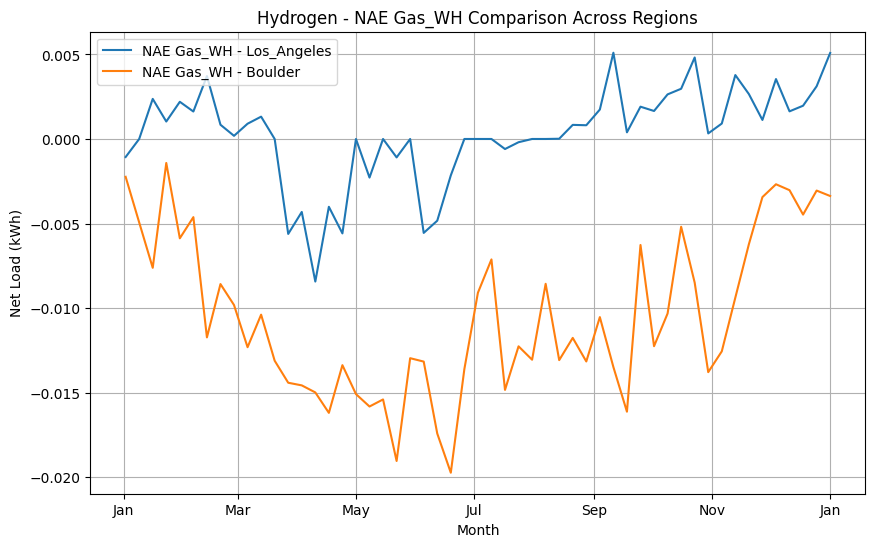

Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_AE_Electric_WH_100_Site/Thermal_Battery_Results_Los_Angeles_AE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_AE_Electric_WH_100_Site/Battery_Results_Los_Angeles_AE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_AE_Electric_WH_100_Site/Hydrogen_Results_Los_Angeles_AE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_AE_Electric_WH_100_Site/CHP_Results_Los_Angeles_AE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Boulder/Boulder_AE_Electric_WH_100_Site/Thermal_Battery_Results_Boulder_AE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Boulder/Boulder_AE_Electric_WH_100_Site/Battery_Results_Boulder_AE_Electric_WH_100_Site.csv
Loaded results from: /content/dri

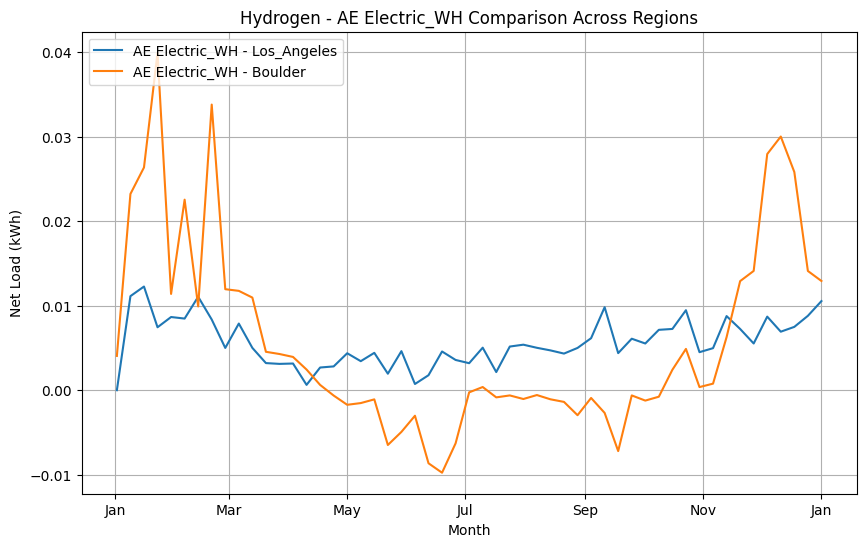

Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_NAE_Electric_WH_100_Site/Thermal_Battery_Results_Los_Angeles_NAE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_NAE_Electric_WH_100_Site/Battery_Results_Los_Angeles_NAE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_NAE_Electric_WH_100_Site/Hydrogen_Results_Los_Angeles_NAE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_NAE_Electric_WH_100_Site/CHP_Results_Los_Angeles_NAE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Boulder/Boulder_NAE_Electric_WH_100_Site/Thermal_Battery_Results_Boulder_NAE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Boulder/Boulder_NAE_Electric_WH_100_Site/Battery_Results_Boulder_NAE_Electric_WH_100_Site.csv
Loaded results from: 

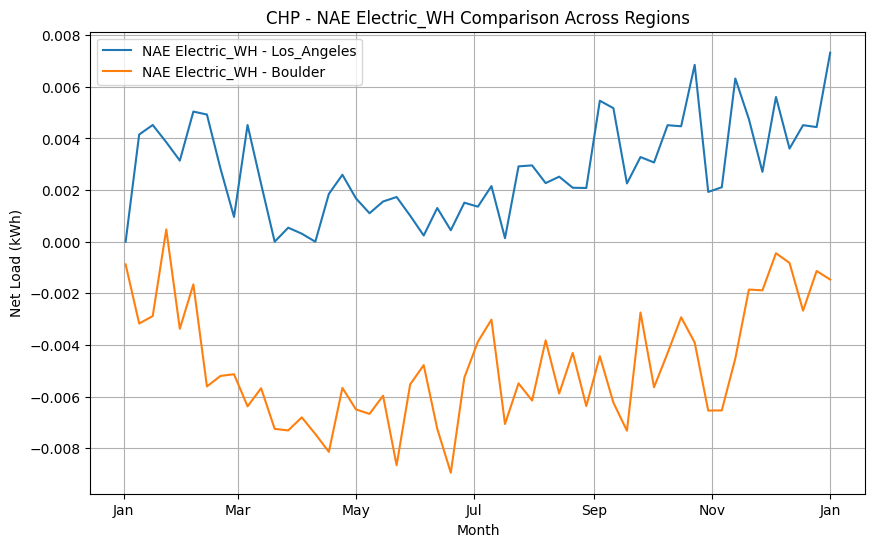

Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_NAE_Gas_WH_100_Site/Thermal_Battery_Results_Los_Angeles_NAE_Gas_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_NAE_Gas_WH_100_Site/Battery_Results_Los_Angeles_NAE_Gas_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_NAE_Gas_WH_100_Site/Hydrogen_Results_Los_Angeles_NAE_Gas_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_NAE_Gas_WH_100_Site/CHP_Results_Los_Angeles_NAE_Gas_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Boulder/Boulder_NAE_Gas_WH_100_Site/Thermal_Battery_Results_Boulder_NAE_Gas_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Boulder/Boulder_NAE_Gas_WH_100_Site/Battery_Results_Boulder_NAE_Gas_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Boulder/Boulder_NAE_Ga

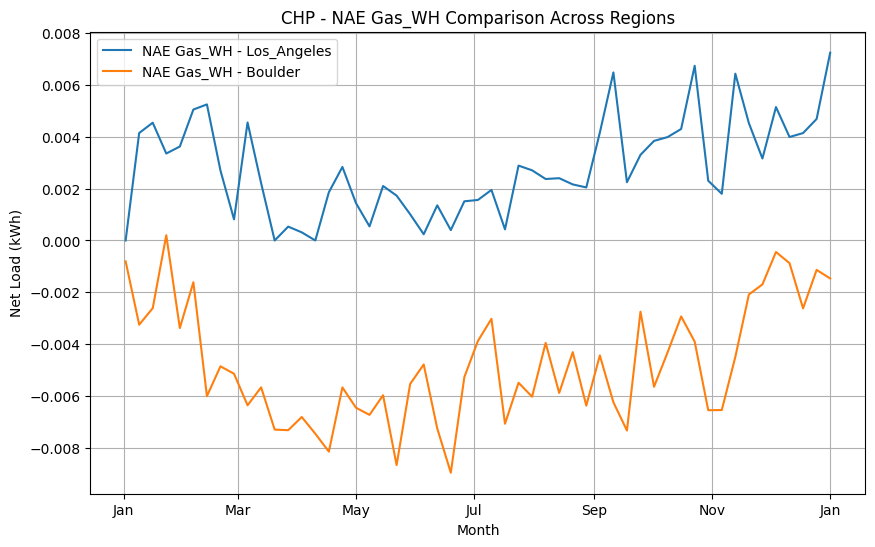

Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_AE_Electric_WH_100_Site/Thermal_Battery_Results_Los_Angeles_AE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_AE_Electric_WH_100_Site/Battery_Results_Los_Angeles_AE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_AE_Electric_WH_100_Site/Hydrogen_Results_Los_Angeles_AE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Los_Angeles/Los_Angeles_AE_Electric_WH_100_Site/CHP_Results_Los_Angeles_AE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Boulder/Boulder_AE_Electric_WH_100_Site/Thermal_Battery_Results_Boulder_AE_Electric_WH_100_Site.csv
Loaded results from: /content/drive/MyDrive/Thesis/Results/Boulder/Boulder_AE_Electric_WH_100_Site/Battery_Results_Boulder_AE_Electric_WH_100_Site.csv
Loaded results from: /content/dri

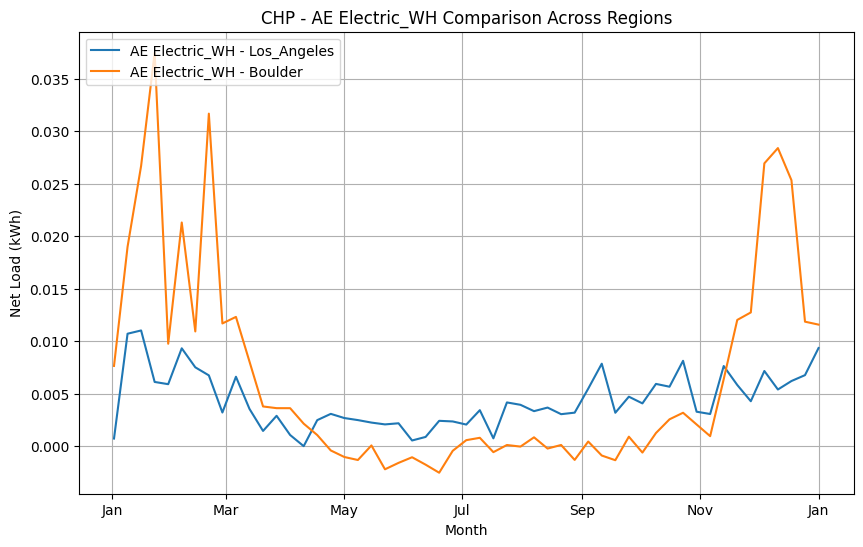

In [ ]:
# To compare cities with normalized net load (normalizing by PV generation size):
compare_cities_net_load_storage("Los_Angeles", "Boulder", normalize=True)

#Analysis 2

                                               Metric         Value
0                           Total PV Generation (kWh)  11433.625440
1          Total Solar Utilization with Battery (kWh)   5954.194005
2       Total Solar Utilization without Battery (kWh)   3547.395332
3   Total Solar Utilization by Self-Consumption (kWh)   3547.395332
4                 Total Solar Utilization Check (kWh)   5931.406194
5      Percentage Difference in Solar Utilization (%)     67.846926
6                             Total Grid Import (kWh)   4117.722478
7                             Total Grid Export (kWh)   5502.219246
8             Total Grid Import without Battery (kWh)   4094.934668
9             Total Grid Export without Battery (kWh)   7886.230107
10            Total Energy Charged into Battery (kWh)   2406.798672
11       Final State of Charge (SOC) of Battery (kWh)      1.971005
12     Average State of Charge (SOC) of Battery (kWh)      8.520796
13                               Self-Sufficienc

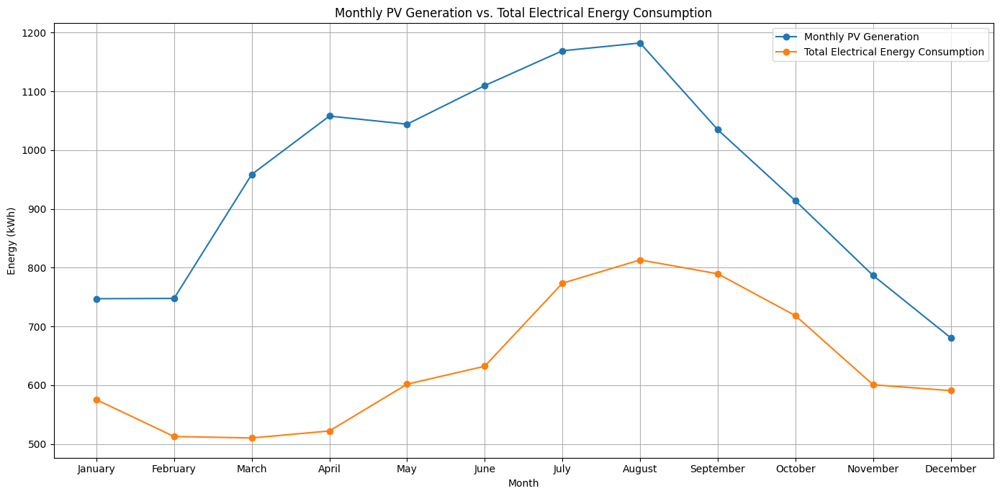

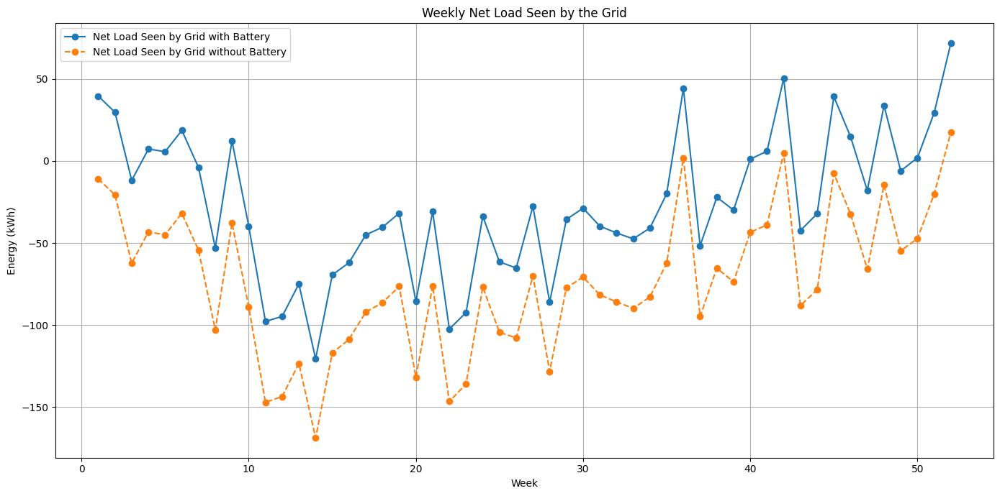

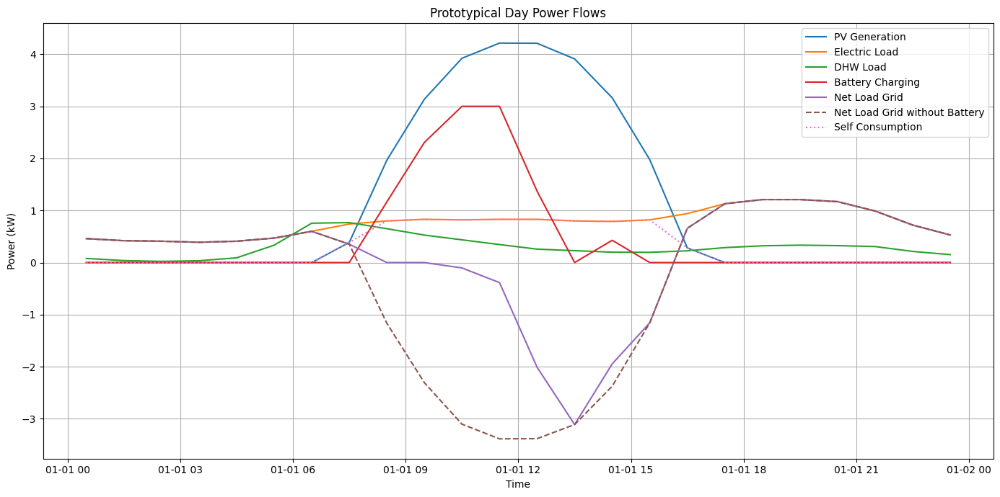

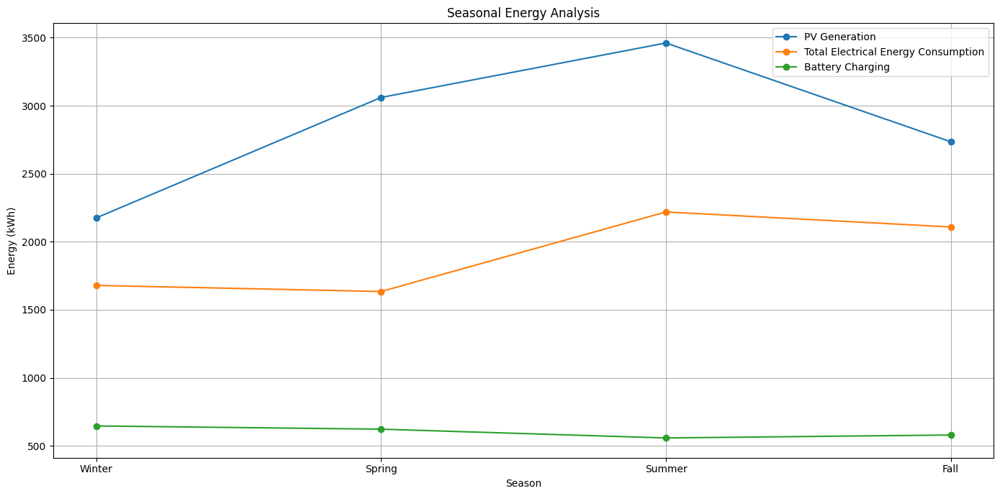

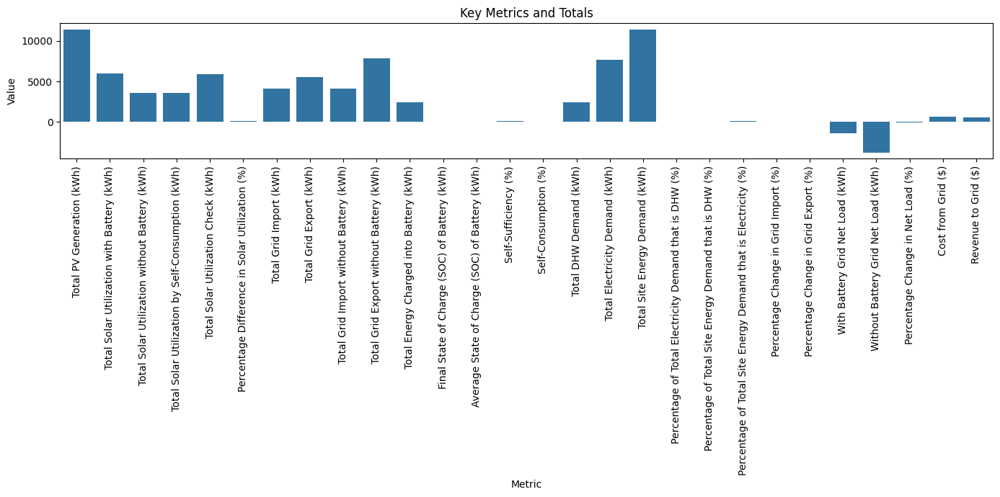

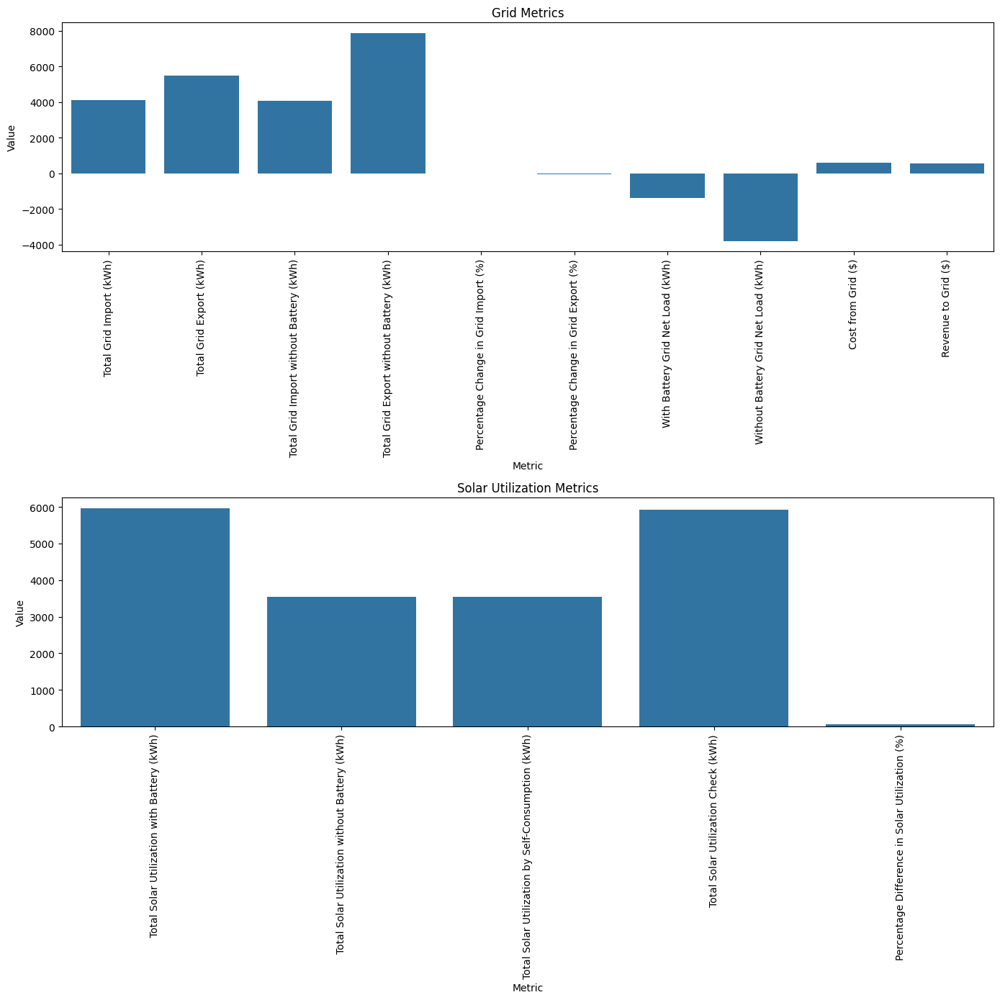

In [ ]:
def analyze_results(results, Load_Data, cost_from_grid, cost_to_grid):
    # Determine the appropriate load column based on configuration
    if 'P_Total_Load' in results.columns:
        P_Load = results['P_Total_Load']
    else:
        P_Load = results['P_Load']

    # Calculate Total Solar Utilization
    total_solar_utilization_with_battery = (results['P_PV'].where(results['P_PV'] <= P_Load, P_Load).sum() + results['P_TB_Ch'].sum())
    total_solar_utilization_without_battery = np.minimum(results['P_PV'], P_Load).sum()

    # Multiple ways to check on-site solar utilization
    solar_utilization_Self_Consumption = results['Self_Consumption'].sum()
    solar_utilization_check = results['P_PV'].sum() - results['P_Grid_To'].sum()

    # Calculate Total Grid Interaction
    total_grid_import = results['P_Grid_From'].sum()
    total_grid_export = results['P_Grid_To'].sum()
    total_grid_import_without_battery = results['P_Grid_From_Baseline'].sum()
    total_grid_export_without_battery = results['P_Grid_To_Baseline'].sum()

    # Calculate Total Battery Performance
    total_energy_charged = results['P_TB_Ch'].sum()
    final_soc = results['E_TB'].iloc[-1]
    average_soc = results['E_TB'].mean()

    # Calculate Self-Sufficiency and Self-Consumption
    total_load = P_Load.sum()
    self_sufficiency = (total_solar_utilization_with_battery / total_load) * 100
    total_pv_generation = results['P_PV'].sum()
    Self_Consumption = (total_solar_utilization_with_battery / total_pv_generation) * 100

    # Calculate Total Demands
    if 'My Design - End Use:  Electricity : Hot Water (kWh)' in Load_Data.columns:
        total_dhw_demand_kWh = Load_Data['My Design - End Use:  Electricity : Hot Water (kWh)'].sum()
    else:
        total_dhw_demand_kWh = Load_Data['My Design - End Use:  Natural Gas: Hot Water (kBtu)'].sum() / 3.412  # Convert kBtu to kWh

    total_electricity_demand_kWh = Load_Data['My Design - Fuel Use:  Electricity: Total (kWh)'].sum()
    total_site_energy_demand_kWh = Load_Data['My Design - Energy Use:  Total (kBtu)'].sum() / 3.412  # Convert kBtu to kWh

    # Calculate Percentages
    percentage_dhw_of_electricity = (total_dhw_demand_kWh / total_electricity_demand_kWh) * 100
    percentage_dhw_of_site_energy = (total_dhw_demand_kWh / total_site_energy_demand_kWh) * 100
    percentage_electricity_of_site_energy = (total_electricity_demand_kWh / total_site_energy_demand_kWh) * 100

    # Percentage Changes
    total_Net_Load_Grid_with_battery = results['Net_Load_Grid'].sum()
    total_Net_Load_Grid_without_battery = results['Net_Load_Grid_Without_Battery'].sum()
    percentage_change_grid_import = ((total_grid_import - total_grid_import_without_battery) / total_grid_import_without_battery) * 100
    percentage_change_grid_export = ((total_grid_export - total_grid_export_without_battery) / total_grid_export_without_battery) * 100
    percentage_change_net_load = ((results['Net_Load_Grid'].sum() - results['Net_Load_Grid_Without_Battery'].sum()) / results['Net_Load_Grid_Without_Battery'].sum()) * 100

    # Aggregate to monthly data for plotting
    results['Date'] = pd.to_datetime(results['Date'])
    results['Month'] = results['Date'].dt.strftime('%B')
    monthly_results = results.groupby('Month').sum(numeric_only=True).reset_index()

    # Ensure months are in the correct order
    monthly_results['Month'] = pd.Categorical(monthly_results['Month'], categories=[
        'January', 'February', 'March', 'April', 'May', 'June', 'July', 'August', 'September', 'October', 'November', 'December'], ordered=True)
    monthly_results = monthly_results.sort_values('Month')

    # Aggregate to weekly data for plotting
    results['Week'] = results['Date'].dt.isocalendar().week
    weekly_results = results.groupby('Week').sum(numeric_only=True).reset_index()

    # Create DataFrame for Metrics
    metrics_df = pd.DataFrame({
        'Metric': [
            'Total PV Generation (kWh)',
            'Total Solar Utilization with Battery (kWh)',
            'Total Solar Utilization without Battery (kWh)',
            'Total Solar Utilization by Self-Consumption (kWh)',
            'Total Solar Utilization Check (kWh)',
            'Percentage Difference in Solar Utilization (%)',
            'Total Grid Import (kWh)',
            'Total Grid Export (kWh)',
            'Total Grid Import without Battery (kWh)',
            'Total Grid Export without Battery (kWh)',
            'Total Energy Charged into Battery (kWh)',
            'Final State of Charge (SOC) of Battery (kWh)',
            'Average State of Charge (SOC) of Battery (kWh)',
            'Self-Sufficiency (%)',
            'Self-Consumption (%)',
            'Total DHW Demand (kWh)',
            'Total Electricity Demand (kWh)',
            'Total Site Energy Demand (kWh)',
            'Percentage of Total Electricity Demand that is DHW (%)',
            'Percentage of Total Site Energy Demand that is DHW (%)',
            'Percentage of Total Site Energy Demand that is Electricity (%)',
            'Percentage Change in Grid Import (%)',
            'Percentage Change in Grid Export (%)',
            'With Battery Grid Net Load (kWh)',
            'Without Battery Grid Net Load (kWh)',
            'Percentage Change in Net Load (%)',
            'Cost from Grid ($)',
            'Revenue to Grid ($)'
        ],
        'Value': [
            total_pv_generation,
            total_solar_utilization_with_battery,
            total_solar_utilization_without_battery,
            solar_utilization_Self_Consumption,
            solar_utilization_check,
            ((total_solar_utilization_with_battery - total_solar_utilization_without_battery) / total_solar_utilization_without_battery) * 100,
            total_grid_import,
            total_grid_export,
            total_grid_import_without_battery,
            total_grid_export_without_battery,
            total_energy_charged,
            final_soc,
            average_soc,
            self_sufficiency,
            Self_Consumption,
            total_dhw_demand_kWh,
            total_electricity_demand_kWh,
            total_site_energy_demand_kWh,
            percentage_dhw_of_electricity,
            percentage_dhw_of_site_energy,
            percentage_electricity_of_site_energy,
            percentage_change_grid_import,
            percentage_change_grid_export,
            total_Net_Load_Grid_with_battery,
            total_Net_Load_Grid_without_battery,
            percentage_change_net_load,
            total_grid_import * cost_from_grid,
            total_grid_export * cost_to_grid
        ]
    })

    # Print Key Metrics
    print(metrics_df)

    # Monthly PV Generation vs. Total Energy Consumption
    def plot_monthly_pv_vs_total_energy(monthly_results):
        plt.figure(figsize=(14, 7))
        plt.plot(monthly_results['Month'], monthly_results['P_PV'], label='Monthly PV Generation', marker='o')
        plt.plot(monthly_results['Month'], monthly_results['P_Load'], label='Total Electrical Energy Consumption', marker='o')
        plt.xlabel('Month')
        plt.ylabel('Energy (kWh)')
        plt.title('Monthly PV Generation vs. Total Electrical Energy Consumption')
        plt.legend()
        plt.grid()
        plt.tight_layout()
        plt.show()

    plot_monthly_pv_vs_total_energy(monthly_results)

    # Weekly Net Load with and without Battery
    def plot_weekly_net_load(weekly_results):
        plt.figure(figsize=(14, 7))
        plt.plot(weekly_results['Week'], weekly_results['Net_Load_Grid'], label='Net Load Seen by Grid with Battery', marker='o')
        plt.plot(weekly_results['Week'], weekly_results['Net_Load_Grid_Without_Battery'], label='Net Load Seen by Grid without Battery', linestyle='--', marker='o')
        plt.xlabel('Week')
        plt.ylabel('Energy (kWh)')
        plt.title('Weekly Net Load Seen by the Grid')
        plt.legend()
        plt.grid()
        plt.tight_layout()
        plt.show()

    plot_weekly_net_load(weekly_results)

    # Prototypical Day Plot for Power Flows
    def plot_prototypical_day(results):
        typical_day = results[results['Date'].dt.dayofyear == results['Date'].dt.dayofyear.mode()[0]]

        plt.figure(figsize=(14, 7))
        plt.plot(typical_day['Date'], typical_day['P_PV'], label='PV Generation')
        plt.plot(typical_day['Date'], typical_day['P_Load'], label='Electric Load')
        plt.plot(typical_day['Date'], typical_day['P_DHW'], label='DHW Load')
        plt.plot(typical_day['Date'], typical_day['P_TB_Ch'], label='Battery Charging')
        plt.plot(typical_day['Date'], typical_day['Net_Load_Grid'], label='Net Load Grid')
        plt.plot(typical_day['Date'], typical_day['Net_Load_Grid_Without_Battery'], label='Net Load Grid without Battery', linestyle='--')
        plt.plot(typical_day['Date'], typical_day['Self_Consumption'], label='Self Consumption', linestyle=':')
        plt.xlabel('Time')
        plt.ylabel('Power (kW)')
        plt.title('Prototypical Day Power Flows')
        plt.legend()
        plt.grid()
        plt.tight_layout()
        plt.show()

    plot_prototypical_day(results)

    # Seasonal Analysis
    def seasonal_analysis(results):
        results['Season'] = results['Date'].apply(lambda x: (x.month % 12 + 3) // 3)
        seasonal_results = results.groupby('Season').sum(numeric_only=True).reset_index()
        seasonal_results['Season'] = seasonal_results['Season'].replace({1: 'Winter', 2: 'Spring', 3: 'Summer', 4: 'Fall'})

        plt.figure(figsize=(14, 7))
        plt.plot(seasonal_results['Season'], seasonal_results['P_PV'], label='PV Generation', marker='o')
        plt.plot(seasonal_results['Season'], seasonal_results['P_Load'], label='Total Electrical Energy Consumption', marker='o')
        plt.plot(seasonal_results['Season'], seasonal_results['P_TB_Ch'], label='Battery Charging', marker='o')
        plt.xlabel('Season')
        plt.ylabel('Energy (kWh)')
        plt.title('Seasonal Energy Analysis')
        plt.legend()
        plt.grid()
        plt.tight_layout()
        plt.show()

    seasonal_analysis(results)

    # Visualization of Key Metrics and Totals
    def visualize_key_metrics(metrics_df):
        plt.figure(figsize=(14, 7))
        sns.barplot(data=metrics_df, x='Metric', y='Value')
        plt.xticks(rotation=90)
        plt.title('Key Metrics and Totals')
        plt.tight_layout()
        plt.show()

    visualize_key_metrics(metrics_df)

    # Detailed Grid and Solar Utilization Metrics
    def grid_and_solar_metrics_charts(metrics_df):
        grid_metrics = metrics_df[metrics_df['Metric'].str.contains('Grid')]
        solar_metrics = metrics_df[metrics_df['Metric'].str.contains('Solar')]

        fig, axs = plt.subplots(2, 1, figsize=(14, 14))

        sns.barplot(data=grid_metrics, x='Metric', y='Value', ax=axs[0])
        axs[0].set_title('Grid Metrics')
        axs[0].tick_params(axis='x', rotation=90)

        sns.barplot(data=solar_metrics, x='Metric', y='Value', ax=axs[1])
        axs[1].set_title('Solar Utilization Metrics')
        axs[1].tick_params(axis='x', rotation=90)

        plt.tight_layout()
        plt.show()

    grid_and_solar_metrics_charts(metrics_df)

# Assuming you have the thermal battery results and Load_Data available
cost_from_grid = 0.15  # Example cost per kWh from the grid
cost_to_grid = 0.10    # Example revenue per kWh to the grid
analyze_results(results_thermal, load_data_thermal, cost_from_grid, cost_to_grid)


                                               Metric         Value
0                           Total PV Generation (kWh)  11433.625440
1          Total Solar Utilization with Battery (kWh)   5954.194005
2       Total Solar Utilization without Battery (kWh)   3547.395332
3   Total Solar Utilization by Self-Consumption (kWh)   3547.395332
4                 Total Solar Utilization Check (kWh)   5931.406194
5      Percentage Difference in Solar Utilization (%)     67.846926
6                             Total Grid Import (kWh)   4117.722478
7                             Total Grid Export (kWh)   5502.219246
8             Total Grid Import without Battery (kWh)   4094.934668
9             Total Grid Export without Battery (kWh)   7886.230107
10            Total Energy Charged into Battery (kWh)   2406.798672
11       Final State of Charge (SOC) of Battery (kWh)      1.971005
12     Average State of Charge (SOC) of Battery (kWh)      8.520796
13                               Self-Sufficienc

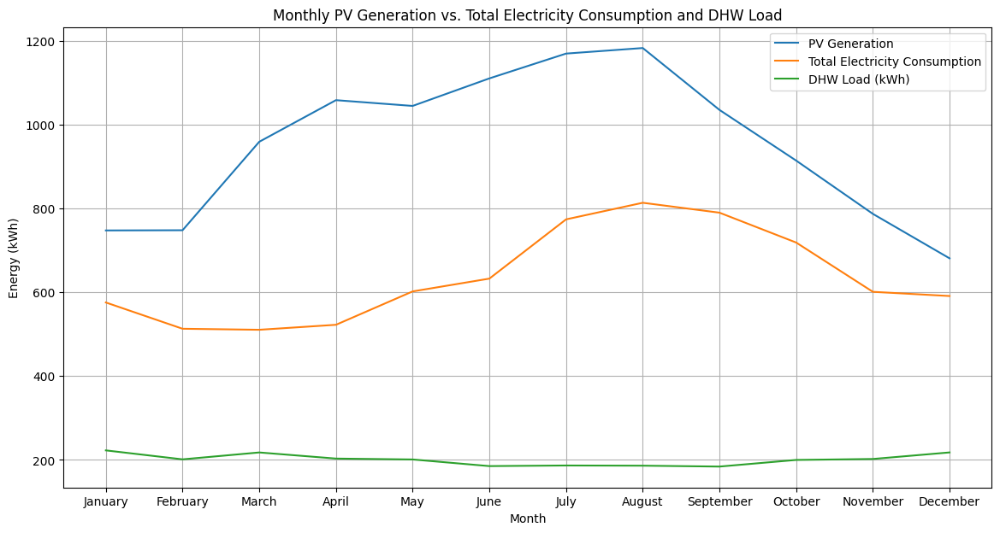

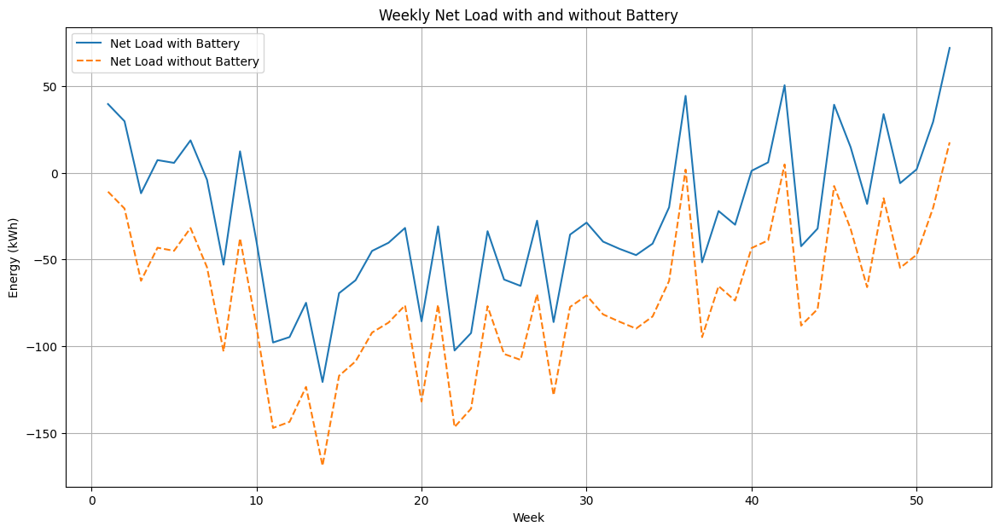

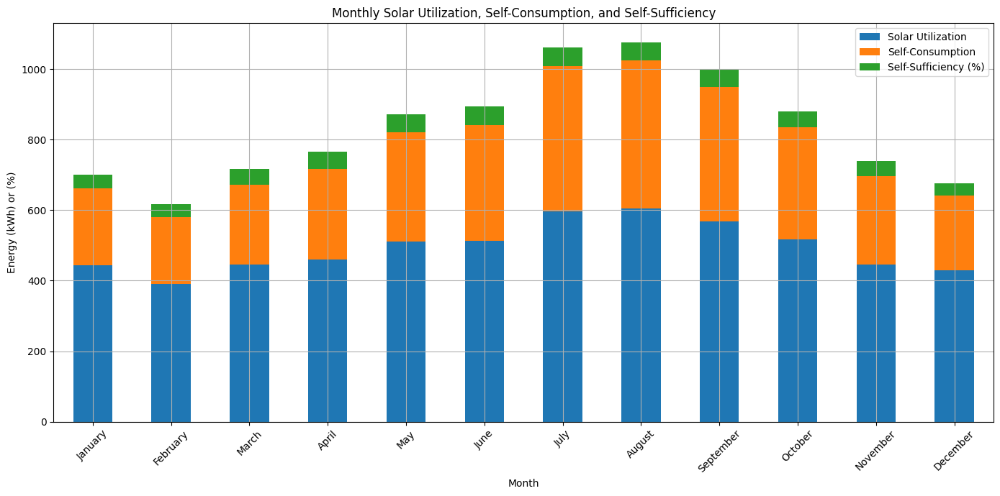

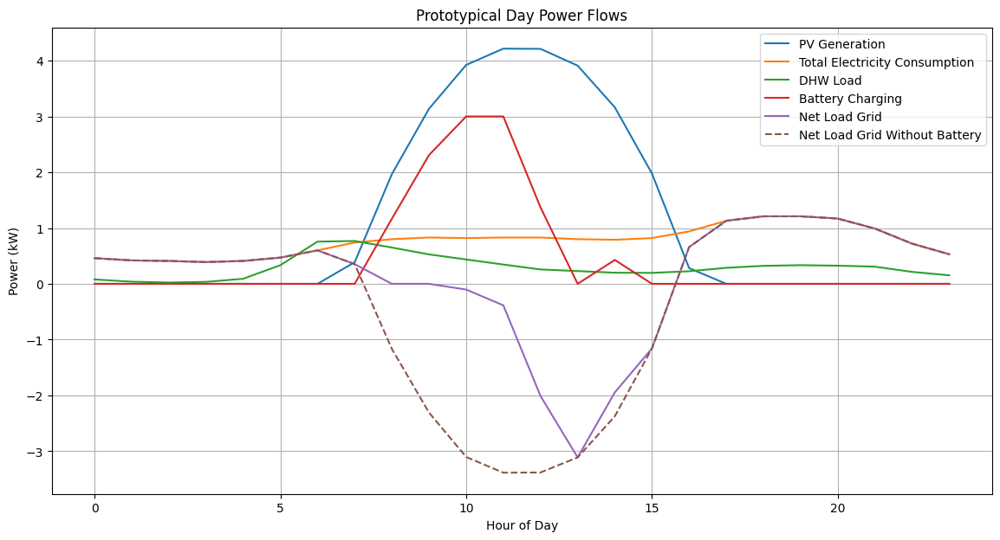

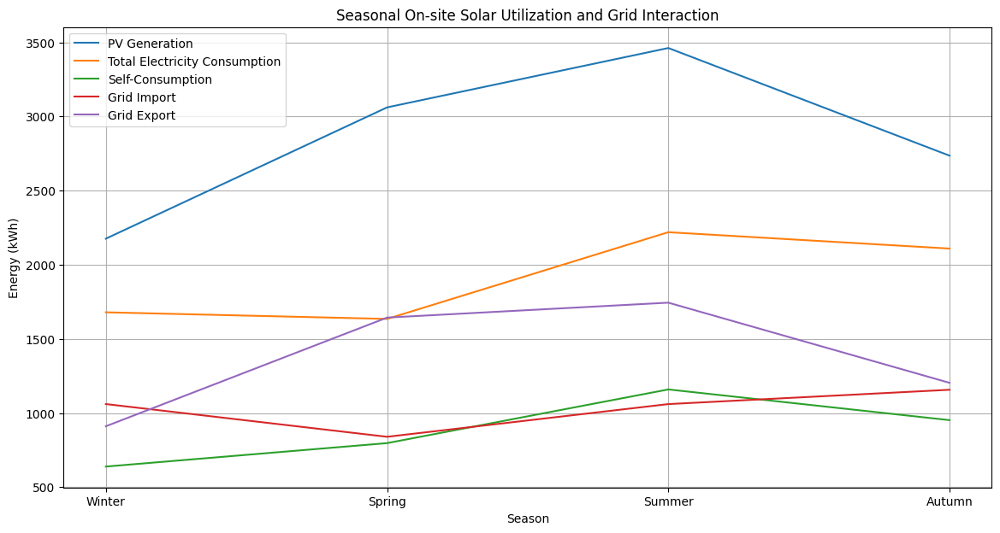

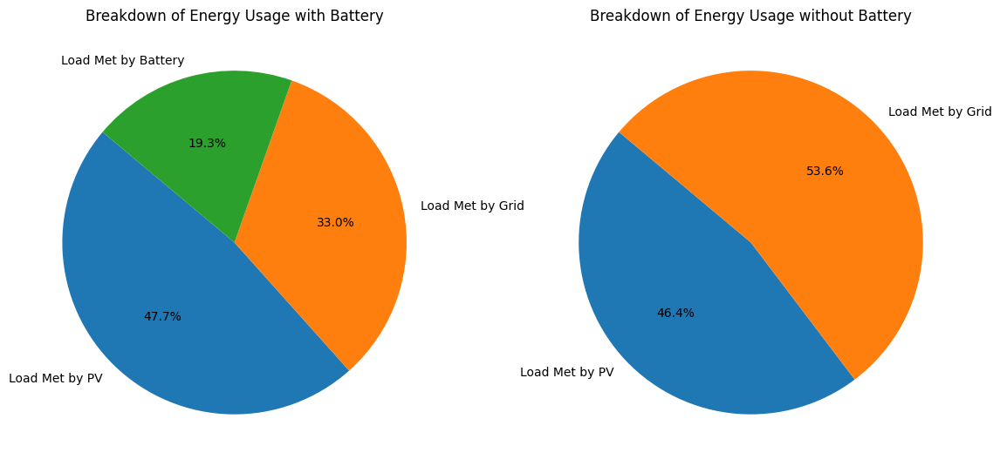

In [ ]:
def analyze_results(results, Load_Data, cost_from_grid, cost_to_grid):
    # Calculate Total Solar Utilization
    total_solar_utilization_with_battery = (results['P_PV'].where(results['P_PV'] <= results['P_Load'], results['P_Load']).sum() + results['P_TB_Ch'].sum())
    total_solar_utilization_without_battery = np.minimum(results['P_PV'], results['P_Load']).sum()

    # Multiple ways to check on-site solar utilization
    solar_utilization_Self_Consumption = results['Self_Consumption'].sum()
    solar_utilization_check = results['P_PV'].sum() - results['P_Grid_To'].sum()

    # Calculate Total Grid Interaction
    total_grid_import = results['P_Grid_From'].sum()
    total_grid_export = results['P_Grid_To'].sum()
    total_grid_import_without_battery = results['P_Grid_From_Baseline'].sum()
    total_grid_export_without_battery = results['P_Grid_To_Baseline'].sum()

    # Calculate Total Battery Performance
    total_energy_charged = results['P_TB_Ch'].sum()
    final_soc = results['E_TB'].iloc[-1]
    average_soc = results['E_TB'].mean()

    # Calculate Self-Sufficiency and Self-Consumption
    total_load = results['P_Load'].sum()
    self_sufficiency = (total_solar_utilization_with_battery / total_load) * 100
    total_pv_generation = results['P_PV'].sum()
    Self_Consumption = (total_solar_utilization_with_battery / total_pv_generation) * 100

    # Calculate Total Demands
    if 'My Design - End Use:  Electricity : Hot Water (kWh)' in Load_Data.columns:
        total_dhw_demand_kWh = Load_Data['My Design - End Use:  Electricity : Hot Water (kWh)'].sum()
    else:
        total_dhw_demand_kWh = Load_Data['My Design - End Use:  Natural Gas: Hot Water (kBtu)'].sum() / 3.412  # Convert kBtu to kWh

    total_electricity_demand_kWh = Load_Data['My Design - Fuel Use:  Electricity: Total (kWh)'].sum()
    total_site_energy_demand_kWh = Load_Data['My Design - Energy Use:  Total (kBtu)'].sum() / 3.412  # Convert kBtu to kWh

    # Calculate Percentages
    percentage_dhw_of_electricity = (total_dhw_demand_kWh / total_electricity_demand_kWh) * 100
    percentage_dhw_of_site_energy = (total_dhw_demand_kWh / total_site_energy_demand_kWh) * 100
    percentage_electricity_of_site_energy = (total_electricity_demand_kWh / total_site_energy_demand_kWh) * 100

    # Percentage Changes
    total_Net_Load_Grid_with_battery = results['Net_Load_Grid'].sum()
    total_Net_Load_Grid_without_battery = results['Net_Load_Grid_Without_Battery'].sum()
    percentage_change_grid_import = ((total_grid_import - total_grid_import_without_battery) / total_grid_import_without_battery) * 100
    percentage_change_grid_export = ((total_grid_export - total_grid_export_without_battery) / total_grid_export_without_battery) * 100
    percentage_change_net_load = ((results['Net_Load_Grid'].sum() - results['Net_Load_Grid_Without_Battery'].sum()) / results['Net_Load_Grid_Without_Battery'].sum()) * 100

    # Key Metrics
    key_metrics = {
        'Total PV Generation (kWh)': total_pv_generation,
        'Total Solar Utilization with Battery (kWh)': total_solar_utilization_with_battery,
        'Total Solar Utilization without Battery (kWh)': total_solar_utilization_without_battery,
        'Total Solar Utilization by Self-Consumption (kWh)': solar_utilization_Self_Consumption,
        'Total Solar Utilization Check (kWh)': solar_utilization_check,
        'Percentage Difference in Solar Utilization (%)': ((total_solar_utilization_with_battery - total_solar_utilization_without_battery) / total_solar_utilization_without_battery) * 100,
        'Total Grid Import (kWh)': total_grid_import,
        'Total Grid Export (kWh)': total_grid_export,
        'Total Grid Import without Battery (kWh)': total_grid_import_without_battery,
        'Total Grid Export without Battery (kWh)': total_grid_export_without_battery,
        'Total Energy Charged into Battery (kWh)': total_energy_charged,
        'Final State of Charge (SOC) of Battery (kWh)': final_soc,
        'Average State of Charge (SOC) of Battery (kWh)': average_soc,
        'Self-Sufficiency (%)': self_sufficiency,
        'Self-Consumption (%)': Self_Consumption,
        'Total DHW Demand (kWh)': total_dhw_demand_kWh,
        'Total Electricity Demand (kWh)': total_electricity_demand_kWh,
        'Total Site Energy Demand (kWh)': total_site_energy_demand_kWh,
        'Percentage of Total Electricity Demand that is DHW (%)': percentage_dhw_of_electricity,
        'Percentage of Total Site Energy Demand that is DHW (%)': percentage_dhw_of_site_energy,
        'Percentage of Total Site Energy Demand that is Electricity (%)': percentage_electricity_of_site_energy,
        'Percentage Change in Grid Import (%)': percentage_change_grid_import,
        'Percentage Change in Grid Export (%)': percentage_change_grid_export,
        'With Battery Grid Net Load (kWh)': total_Net_Load_Grid_with_battery,
        'Without Battery Grid Net Load (kWh)': total_Net_Load_Grid_without_battery,
        'Percentage Change in Net Load (%)': percentage_change_net_load,
        'Cost from Grid ($)': total_grid_import * cost_from_grid,
        'Revenue to Grid ($)': total_grid_export * cost_to_grid
    }

    # Print Key Metrics
    print(pd.DataFrame(list(key_metrics.items()), columns=['Metric', 'Value']))

    # Create DataFrame for Metrics
    metrics_df = pd.DataFrame({
        'Metric': [
            'Total PV Generation (kWh)',
            'Total Solar Utilization with Battery (kWh)',
            'Total Solar Utilization without Battery (kWh)',
            'Total Solar Utilization by Self-Consumption (kWh)',
            'Total Solar Utilization Check (kWh)',
            'Percentage Difference in Solar Utilization (%)',
            'Total Grid Import (kWh)',
            'Total Grid Export (kWh)',
            'Total Grid Import without Battery (kWh)',
            'Total Grid Export without Battery (kWh)',
            'Total Energy Charged into Battery (kWh)',
            'Final State of Charge (SOC) of Battery (kWh)',
            'Average State of Charge (SOC) of Battery (kWh)',
            'Self-Sufficiency (%)',
            'Self-Consumption (%)',
            'Total DHW Demand (kWh)',
            'Total Electricity Demand (kWh)',
            'Total Site Energy Demand (kWh)',
            'Percentage of Total Electricity Demand that is DHW (%)',
            'Percentage of Total Site Energy Demand that is DHW (%)',
            'Percentage of Total Site Energy Demand that is Electricity (%)',
            'Percentage Change in Grid Import (%)',
            'Percentage Change in Grid Export (%)',
            'With Battery Grid Net Load (kWh)',
            'Without Battery Grid Net Load (kWh)',
            'Percentage Change in Net Load (%)',
            'Cost from Grid ($)',
            'Revenue to Grid ($)'
        ],
        'Value': [
            total_pv_generation,
            total_solar_utilization_with_battery,
            total_solar_utilization_without_battery,
            solar_utilization_Self_Consumption,
            solar_utilization_check,
            ((total_solar_utilization_with_battery - total_solar_utilization_without_battery) / total_solar_utilization_without_battery) * 100,
            total_grid_import,
            total_grid_export,
            total_grid_import_without_battery,
            total_grid_export_without_battery,
            total_energy_charged,
            final_soc,
            average_soc,
            self_sufficiency,
            Self_Consumption,
            total_dhw_demand_kWh,
            total_electricity_demand_kWh,
            total_site_energy_demand_kWh,
            percentage_dhw_of_electricity,
            percentage_dhw_of_site_energy,
            percentage_electricity_of_site_energy,
            percentage_change_grid_import,
            percentage_change_grid_export,
            total_Net_Load_Grid_with_battery,
            total_Net_Load_Grid_without_battery,
            percentage_change_net_load,
            total_grid_import * cost_from_grid,
            total_grid_export * cost_to_grid
        ]
    })

    # Aggregate to monthly data for plotting
    results['Month'] = results['Date'].dt.strftime('%B')
    monthly_results = results.groupby('Month').sum(numeric_only=True).reset_index()

    # Ensure months are in the correct order
    monthly_results['Month'] = pd.Categorical(monthly_results['Month'], categories=[
        'January', 'February', 'March', 'April', 'May', 'June', 'July', 'August', 'September', 'October', 'November', 'December'], ordered=True)
    monthly_results = monthly_results.sort_values('Month')

    # Plot Monthly PV Generation vs. Total Energy Consumption
    plt.figure(figsize=(14, 7))
    plt.plot(monthly_results['Month'], monthly_results['P_PV'], label='PV Generation')
    plt.plot(monthly_results['Month'], monthly_results['P_Load'], label='Total Electricity Consumption')
    plt.plot(monthly_results['Month'], monthly_results['P_DHW'], label='DHW Load (kWh)')
    plt.xlabel('Month')
    plt.ylabel('Energy (kWh)')
    plt.title('Monthly PV Generation vs. Total Electricity Consumption and DHW Load')
    plt.legend()
    plt.grid()
    plt.show()

    # Plot Weekly Net Load with and without Battery
    results['Week'] = results['Date'].dt.isocalendar().week
    weekly_results = results.groupby('Week').sum(numeric_only=True).reset_index()

    plt.figure(figsize=(14, 7))
    plt.plot(weekly_results['Week'], weekly_results['Net_Load_Grid'], label='Net Load with Battery')
    plt.plot(weekly_results['Week'], weekly_results['Net_Load_Grid_Without_Battery'], label='Net Load without Battery', linestyle='--')
    plt.xlabel('Week')
    plt.ylabel('Energy (kWh)')
    plt.title('Weekly Net Load with and without Battery')
    plt.legend()
    plt.grid()
    plt.show()

    # Monthly Solar Utilization, Self-Consumption, and Self-Sufficiency
    monthly_solar_utilization = monthly_results['P_PV'] - monthly_results['P_Grid_To']
    monthly_Self_Consumption = monthly_results['P_Load'] - monthly_results['P_Grid_From']
    monthly_self_sufficiency = (monthly_Self_Consumption / monthly_results['P_Load']) * 100

    monthly_metrics_df = pd.DataFrame({
        'Month': monthly_results['Month'],
        'Solar Utilization': monthly_solar_utilization,
        'Self-Consumption': monthly_Self_Consumption,
        'Self-Sufficiency (%)': monthly_self_sufficiency
    })

    # Plot Monthly Metrics
    monthly_metrics_df.plot(x='Month', kind='bar', figsize=(14, 7), stacked=True)
    plt.title('Monthly Solar Utilization, Self-Consumption, and Self-Sufficiency')
    plt.ylabel('Energy (kWh) or (%)')
    plt.xticks(rotation=45)
    plt.legend(loc='upper right')
    plt.grid(True)
    plt.tight_layout()
    plt.show()

    # Prototypical Day Plot for Power Flows
    prototypical_day = results[results['Date'].dt.dayofyear == results['Date'].dt.dayofyear.mode()[0]]

    plt.figure(figsize=(14, 7))
    plt.plot(prototypical_day['Date'].dt.hour, prototypical_day['P_PV'], label='PV Generation')
    plt.plot(prototypical_day['Date'].dt.hour, prototypical_day['P_Load'], label='Total Electricity Consumption')
    plt.plot(prototypical_day['Date'].dt.hour, prototypical_day['P_DHW'], label='DHW Load')
    plt.plot(prototypical_day['Date'].dt.hour, prototypical_day['P_TB_Ch'], label='Battery Charging')
    plt.plot(prototypical_day['Date'].dt.hour, prototypical_day['Net_Load_Grid'], label='Net Load Grid')
    plt.plot(prototypical_day['Date'].dt.hour, prototypical_day['Net_Load_Grid_Without_Battery'], label='Net Load Grid Without Battery', linestyle='--')
    plt.xlabel('Hour of Day')
    plt.ylabel('Power (kW)')
    plt.title('Prototypical Day Power Flows')
    plt.legend()
    plt.grid()
    plt.show()

    # Seasonal Analysis: On-site Solar Utilization
    seasons = ['Winter', 'Spring', 'Summer', 'Autumn']
    results['Season'] = (results['Date'].dt.month % 12 // 3).map({0: 'Winter', 1: 'Spring', 2: 'Summer', 3: 'Autumn'})
    seasonal_results = results.groupby('Season').sum(numeric_only=True).reindex(seasons).reset_index()

    plt.figure(figsize=(14, 7))
    plt.plot(seasonal_results['Season'], seasonal_results['P_PV'], label='PV Generation')
    plt.plot(seasonal_results['Season'], seasonal_results['P_Load'], label='Total Electricity Consumption')
    plt.plot(seasonal_results['Season'], seasonal_results['Self_Consumption'], label='Self-Consumption')
    plt.plot(seasonal_results['Season'], seasonal_results['P_Grid_From'], label='Grid Import')
    plt.plot(seasonal_results['Season'], seasonal_results['P_Grid_To'], label='Grid Export')
    plt.xlabel('Season')
    plt.ylabel('Energy (kWh)')
    plt.title('Seasonal On-site Solar Utilization and Grid Interaction')
    plt.legend()
    plt.grid()
    plt.show()

    # Breakdown of Energy Usage with and without Energy Storage
    energy_usage_with_storage = {
        'Load Met by PV': total_solar_utilization_with_battery,
        'Load Met by Grid': total_grid_import,
        'Load Met by Battery': total_energy_charged
    }
    energy_usage_without_storage = {
        'Load Met by PV': total_solar_utilization_without_battery,
        'Load Met by Grid': total_grid_import_without_battery
    }

    fig, axs = plt.subplots(1, 2, figsize=(14, 7))
    axs[0].pie(energy_usage_with_storage.values(), labels=energy_usage_with_storage.keys(), autopct='%1.1f%%', startangle=140)
    axs[0].set_title('Breakdown of Energy Usage with Battery')
    axs[1].pie(energy_usage_without_storage.values(), labels=energy_usage_without_storage.keys(), autopct='%1.1f%%', startangle=140)
    axs[1].set_title('Breakdown of Energy Usage without Battery')
    plt.show()

# Assuming you have the thermal battery results and Load_Data available
cost_from_grid = 0.15  # Example cost per kWh from the grid
cost_to_grid = 0.10    # Example revenue per kWh to the grid
analyze_results(results_thermal, load_data_thermal, cost_from_grid, cost_to_grid)



In [ ]:
def plot_monthly_pv_vs_total_energy(monthly_results):
    plt.figure(figsize=(14, 7))
    plt.plot(monthly_results['Month'], monthly_results['P_PV'], label='Total PV Generation')
    plt.plot(monthly_results['Month'], monthly_results['P_Total_Load'] if 'P_Total_Load' in monthly_results.columns else monthly_results['P_Load'], label='Total Electricity Consumption')
    plt.plot(monthly_results['Month'], monthly_results['P_DHW'], label='DHW Load (kWh)')
    plt.xlabel('Month')
    plt.ylabel('Energy (kWh)')
    plt.title('Monthly PV Generation vs. Total Electricity Consumption')
    plt.legend()
    plt.grid()
    plt.show()

def plot_weekly_pv_vs_total_energy(weekly_results):
    plt.figure(figsize=(14, 7))
    plt.plot(weekly_results['Week'], weekly_results['P_PV'], label='Total PV Generation')
    plt.plot(weekly_results['Week'], weekly_results['P_Total_Load'] if 'P_Total_Load' in weekly_results.columns else weekly_results['P_Load'], label='Total Electricity Consumption')
    plt.xlabel('Week')
    plt.ylabel('Energy (kWh)')
    plt.title('Weekly PV Generation vs. Total Electricity Consumption')
    plt.legend()
    plt.grid()
    plt.show()

def plot_monthly_net_load(monthly_results):
    plt.figure(figsize=(14, 7))
    plt.plot(monthly_results['Month'], monthly_results['Net_Load_Grid'], label='Net Load with Battery')
    plt.plot(monthly_results['Month'], monthly_results['Net_Load_Grid_Without_Battery'], label='Net Load without Battery', linestyle='--')
    plt.xlabel('Month')
    plt.ylabel('Energy (kWh)')
    plt.title('Monthly Net Load with and without Battery')
    plt.legend()
    plt.grid()
    plt.show()

def plot_weekly_net_load(weekly_results):
    plt.figure(figsize=(14, 7))
    plt.plot(weekly_results['Week'], weekly_results['Net_Load_Grid'], label='Net Load with Battery')
    plt.plot(weekly_results['Week'], weekly_results['Net_Load_Grid_Without_Battery'], label='Net Load without Battery', linestyle='--')
    plt.xlabel('Week')
    plt.ylabel('Energy (kWh)')
    plt.title('Weekly Net Load with and without Battery')
    plt.legend()
    plt.grid()
    plt.show()

def plot_monthly_soc_vs_load(monthly_results):
    plt.figure(figsize=(14, 7))
    plt.plot(monthly_results['Month'], monthly_results['E_TB'], label='State of Charge (SOC) of Battery', color='b')
    plt.plot(monthly_results['Month'], monthly_results['P_DHW'], label='DHW Load', linestyle=':', color='g')
    plt.xlabel('Month')
    plt.ylabel('Energy (kWh)')
    plt.title('Monthly SOC of Battery and DHW Load')
    plt.legend()
    plt.grid()
    plt.show()

def plot_weekly_soc_vs_load(weekly_results):
    plt.figure(figsize=(14, 7))
    plt.plot(weekly_results['Week'], weekly_results['E_TB'], label='State of Charge (SOC) of Battery', color='b')
    plt.plot(weekly_results['Week'], weekly_results['P_DHW'], label='DHW Load', linestyle=':', color='g')
    plt.xlabel('Week')
    plt.ylabel('Energy (kWh)')
    plt.title('Weekly SOC of Battery and DHW Load')
    plt.legend()
    plt.grid()
    plt.show()

def plot_prototypical_day(results):
    prototypical_day = results[results['Date'].dt.month == 6].head(24)
    plt.figure(figsize=(14, 7))
    plt.plot(prototypical_day['Date'], prototypical_day['P_PV'], label='PV Generation')
    plt.plot(prototypical_day['Date'], prototypical_day['P_Load'], label='Electric Load')
    plt.plot(prototypical_day['Date'], prototypical_day['P_DHW'], label='DHW Load')
    plt.plot(prototypical_day['Date'], prototypical_day['P_TB_Ch'], label='Battery Charging')
    plt.plot(prototypical_day['Date'], prototypical_day['Net_Load_Grid'], label='Net Load Grid')
    plt.plot(prototypical_day['Date'], prototypical_day['Self_Consumption'], label='Self Consumption', linestyle=':')
    plt.xlabel('Time')
    plt.ylabel('Power (kW)')
    plt.title('Prototypical Day Power Flows')
    plt.legend()
    plt.grid()
    plt.show()

def plot_monthly_utilization(utilization_results):
    utilization_df = pd.DataFrame(utilization_results)
    utilization_df.plot(kind='bar', figsize=(14, 7))
    plt.xlabel('Month')
    plt.ylabel('Percentage (%)')
    plt.title('Monthly Solar Utilization, Self Consumption, and Self Sufficiency')
    plt.grid()
    plt.show()

def plot_seasonal_analysis(seasonal_results):
    seasonal_df = pd.DataFrame(seasonal_results)
    seasonal_df.plot(kind='bar', figsize=(14, 7))
    plt.xlabel('Season')
    plt.ylabel('Energy (kWh)')
    plt.title('Seasonal Analysis: PV, Total Electricity, Net Load, Self Consumption, Solar Utilization, and Self Sufficiency')
    plt.grid()
    plt.show()

def plot_seasonal_pv_analysis(seasonal_pv_results):
    seasonal_pv_df = pd.DataFrame(seasonal_pv_results)
    seasonal_pv_df.plot(kind='bar', figsize=(14, 7))
    plt.xlabel('Season')
    plt.ylabel('Energy (kWh)')
    plt.title('Seasonal PV Analysis: PV Total, Battery Charged, Self Consumption, To Grid, and From Grid')
    plt.grid()
    plt.show()

def plot_energy_usagE_TBreakdown(energy_usage_with_battery, energy_usage_without_battery):
    fig, axs = plt.subplots(1, 2, figsize=(14, 7))

    colors = ['#1f77b4', '#2ca02c', '#ff7f0e']  # Blue for PV, Green for Battery, Orange for Grid

    axs[0].pie(energy_usage_with_battery.values(), labels=energy_usage_with_battery.keys(), autopct='%1.1f%%', startangle=140, colors=colors)
    axs[0].set_title('Breakdown of Energy Usage with Battery')

    axs[1].pie(energy_usage_without_battery.values(), labels=energy_usage_without_battery.keys(), autopct='%1.1f%%', startangle=140, colors=colors)
    axs[1].set_title('Breakdown of Energy Usage without Battery')

    plt.show()


                                               Metric         Value
0                           Total PV Generation (kWh)  11433.625440
1          Total Solar Utilization with Battery (kWh)   5954.194005
2       Total Solar Utilization without Battery (kWh)   3547.395332
3   Total Solar Utilization by Self-Consumption (kWh)   3547.395332
4                 Total Solar Utilization Check (kWh)   9501.589337
5      Percentage Difference in Solar Utilization (%)     67.846926
6                             Total Grid Import (kWh)   4117.722478
7                             Total Grid Export (kWh)   5502.219246
8             Total Grid Import without Battery (kWh)   4094.934668
9             Total Grid Export without Battery (kWh)   7886.230107
10            Total Energy Charged into Battery (kWh)   2406.798672
11       Final State of Charge (SOC) of Battery (kWh)      1.971005
12     Average State of Charge (SOC) of Battery (kWh)      8.520796
13                               Self-Sufficienc

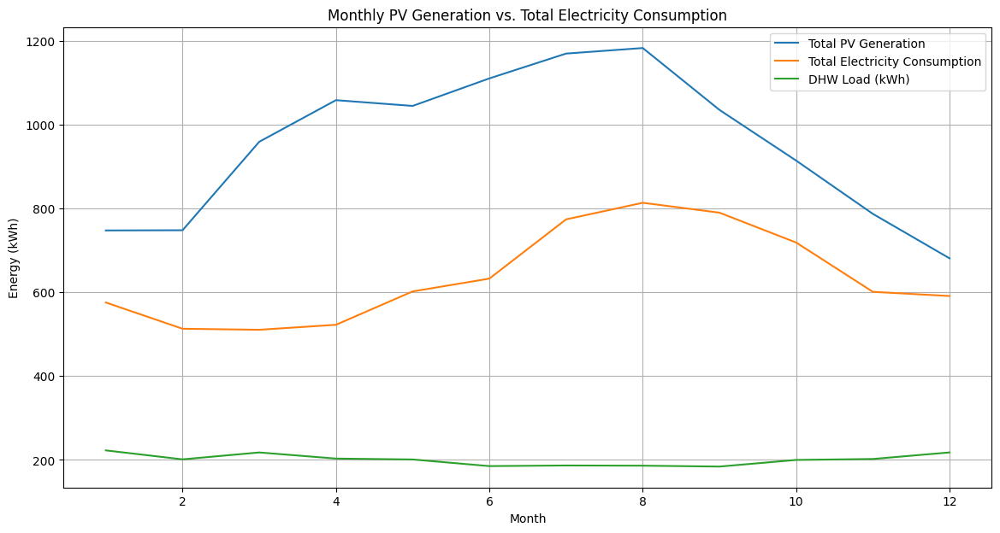

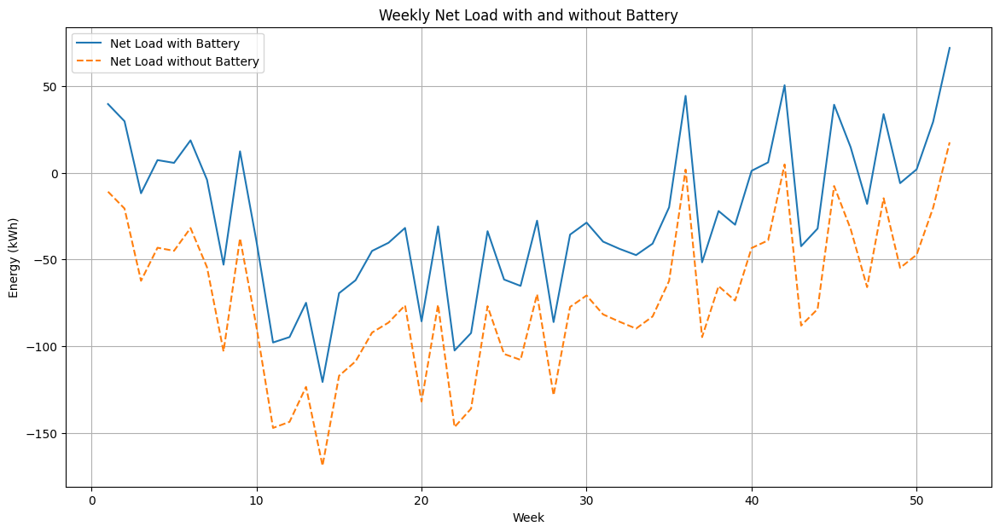

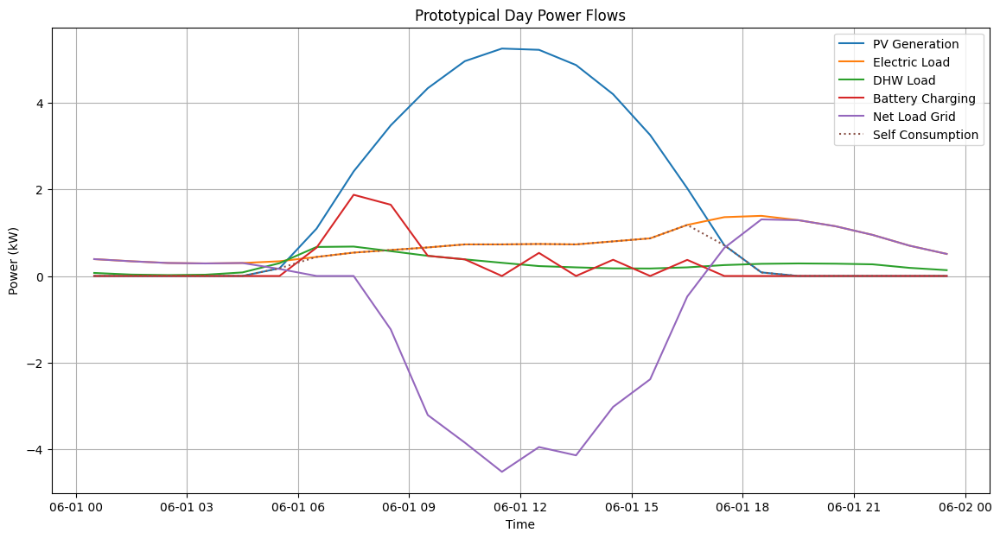

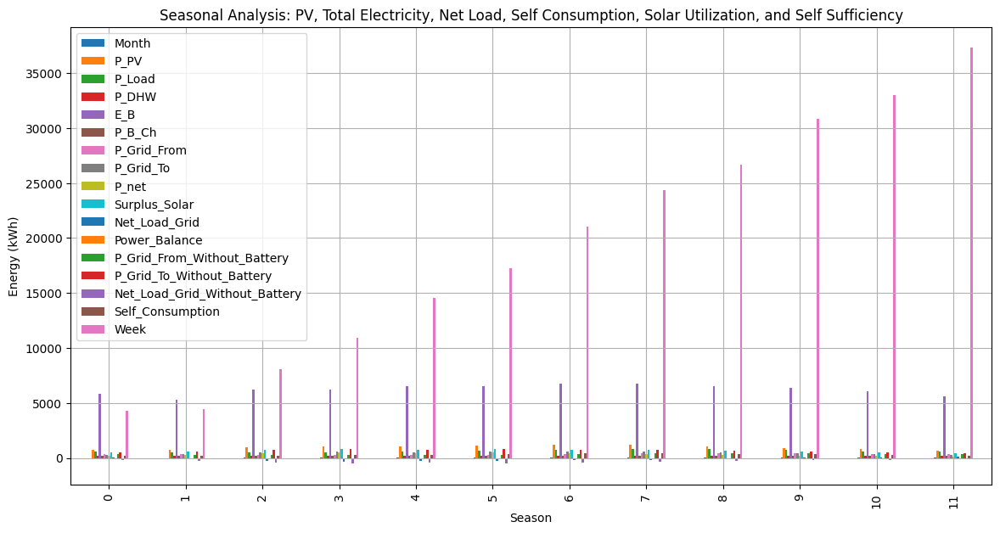

TypeError: unhashable type: 'Series'

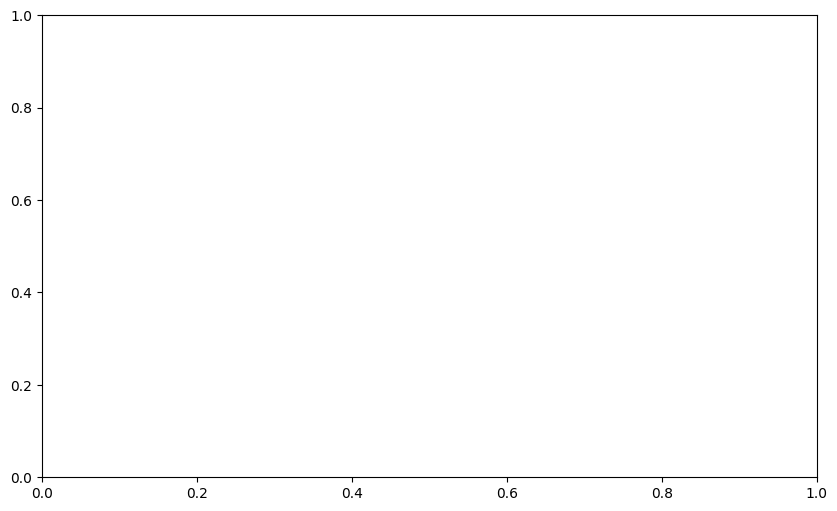

In [ ]:
def analyze_results(results, Load_Data, cost_from_grid, cost_to_grid):
    # Aggregate monthly and weekly results
    results['Month'] = results['Date'].dt.month
    results['Week'] = results['Date'].dt.isocalendar().week.astype(int)  # Convert Week to int

    # Only sum numeric columns
    monthly_results = results.groupby('Month').sum(numeric_only=True).reset_index()
    weekly_results = results.groupby('Week').sum(numeric_only=True).reset_index()

    # Calculate Solar Utilization and Grid Metrics
    total_pv_generation = results['P_PV'].sum()
    total_solar_utilization_with_battery = results[['P_PV', 'P_Load']].apply(lambda row: min(row['P_PV'], row['P_Load']), axis=1).sum() + results['P_TB_Ch'].sum()
    total_solar_utilization_without_battery = results[['P_PV', 'P_Load']].apply(lambda row: min(row['P_PV'], row['P_Load']), axis=1).sum()
    solar_utilization_Self_Consumption = total_solar_utilization_without_battery
    solar_utilization_check = total_solar_utilization_with_battery + solar_utilization_Self_Consumption

    total_grid_import = results['P_Grid_From'].sum()
    total_grid_export = results['P_Grid_To'].sum()
    total_grid_import_without_battery = results['P_Grid_From_Baseline'].sum()
    total_grid_export_without_battery = results['P_Grid_To_Baseline'].sum()

    total_energy_charged = results['P_TB_Ch'].sum()
    final_soc = results['E_TB'].iloc[-1]
    average_soc = results['E_TB'].mean()

    self_sufficiency = (total_solar_utilization_with_battery / results['P_Load'].sum()) * 100
    Self_Consumption = (total_solar_utilization_with_battery / total_pv_generation) * 100

    total_dhw_demand_kWh = Load_Data['My Design - End Use:  Natural Gas: Hot Water (kBtu)'].sum() / 3.412  # Convert kBtu to kWh
    total_electricity_demand_kWh = Load_Data['My Design - Fuel Use:  Electricity: Total (kWh)'].sum()
    total_site_energy_demand_kWh = Load_Data['My Design - Energy Use:  Total (kBtu)'].sum() / 3.412  # Convert kBtu to kWh

    # Calculate Percentages
    percentage_dhw_of_electricity = (total_dhw_demand_kWh / total_electricity_demand_kWh) * 100
    percentage_dhw_of_site_energy = (total_dhw_demand_kWh / total_site_energy_demand_kWh) * 100
    percentage_electricity_of_site_energy = (total_electricity_demand_kWh / total_site_energy_demand_kWh) * 100

    # Percentage Changes
    total_Net_Load_Grid_with_battery = results['Net_Load_Grid'].sum()
    total_Net_Load_Grid_without_battery = results['Net_Load_Grid_Without_Battery'].sum()
    percentage_change_grid_import = ((total_grid_import - total_grid_import_without_battery) / total_grid_import_without_battery) * 100
    percentage_change_grid_export = ((total_grid_export - total_grid_export_without_battery) / total_grid_export_without_battery) * 100
    percentage_change_net_load = ((total_Net_Load_Grid_with_battery - total_Net_Load_Grid_without_battery) / total_Net_Load_Grid_without_battery) * 100

    # Key Metrics
    key_metrics = {
        'Total PV Generation (kWh)': total_pv_generation,
        'Total Solar Utilization with Battery (kWh)': total_solar_utilization_with_battery,
        'Total Solar Utilization without Battery (kWh)': total_solar_utilization_without_battery,
        'Total Solar Utilization by Self-Consumption (kWh)': solar_utilization_Self_Consumption,
        'Total Solar Utilization Check (kWh)': solar_utilization_check,
        'Percentage Difference in Solar Utilization (%)': ((total_solar_utilization_with_battery - total_solar_utilization_without_battery) / total_solar_utilization_without_battery) * 100,
        'Total Grid Import (kWh)': total_grid_import,
        'Total Grid Export (kWh)': total_grid_export,
        'Total Grid Import without Battery (kWh)': total_grid_import_without_battery,
        'Total Grid Export without Battery (kWh)': total_grid_export_without_battery,
        'Total Energy Charged into Battery (kWh)': total_energy_charged,
        'Final State of Charge (SOC) of Battery (kWh)': final_soc,
        'Average State of Charge (SOC) of Battery (kWh)': average_soc,
        'Self-Sufficiency (%)': self_sufficiency,
        'Self-Consumption (%)': Self_Consumption,
        'Total DHW Demand (kWh)': total_dhw_demand_kWh,
        'Total Electricity Demand (kWh)': total_electricity_demand_kWh,
        'Total Site Energy Demand (kWh)': total_site_energy_demand_kWh,
        'Percentage of Total Electricity Demand that is DHW (%)': percentage_dhw_of_electricity,
        'Percentage of Total Site Energy Demand that is DHW (%)': percentage_dhw_of_site_energy,
        'Percentage of Total Site Energy Demand that is Electricity (%)': percentage_electricity_of_site_energy,
        'Percentage Change in Grid Import (%)': percentage_change_grid_import,
        'Percentage Change in Grid Export (%)': percentage_change_grid_export,
        'With Battery Grid Net Load (kWh)': total_Net_Load_Grid_with_battery,
        'Without Battery Grid Net Load (kWh)': total_Net_Load_Grid_without_battery,
        'Percentage Change in Net Load (%)': percentage_change_net_load,
        'Cost from Grid ($)': total_grid_import * cost_from_grid,
        'Revenue to Grid ($)': total_grid_export * cost_to_grid
    }

    # Create DataFrame for Metrics
    metrics_df = pd.DataFrame({
        'Metric': list(key_metrics.keys()),
        'Value': list(key_metrics.values())
    })

    # Print Key Metrics
    print(metrics_df)

    # Monthly PV Generation vs. Total Energy Consumption
    plot_monthly_pv_vs_total_energy(monthly_results)

    # Weekly Net Load with and without Battery
    plot_weekly_net_load(weekly_results)

    # Prototypical Day Plot for Power Flows
    plot_prototypical_day(results)

    # Seasonal Analysis
    plot_seasonal_analysis(monthly_results)

    # Visualization of Key Metrics and Totals
    visualize_key_metrics(metrics_df)

    # Detailed Grid and Solar Utilization Metrics
    grid_and_solar_metrics_charts(metrics_df)

# Assuming you have the thermal battery results and Load_Data available
cost_from_grid = 0.15  # Example cost per kWh from the grid
cost_to_grid = 0.10    # Example revenue per kWh to the grid
analyze_results(results_thermal, load_data_thermal, cost_from_grid, cost_to_grid)


# New Section

# New Section

In [ ]:
def analyze_thermal_battery(results):
    metrics = {
        'Total PV Gen': results['P_PV'].sum(),
        'Total Solar Utilization w/ Energy Storage': results['P_PV'].sum() - results['Surplus_Solar'].sum(),
        'Total Solar Utilization without Battery': results['P_PV'].sum() - results['P_Grid_To_Baseline'].sum(),
        'Total Self Consumption': results['Self_Consumption'].sum(),
        'Total Self Sufficiency': results['Self_Consumption'].sum() / results['P_Total_Load'].sum(),
        'Surplus Solar (Before Energy Storage)': results['Surplus_Solar'].sum(),
        'Export Ratio': results['P_Grid_To'].sum() / results['P_PV'].sum(),
        'Import Ratio': results['P_Grid_From'].sum() / results['P_Total_Load'].sum(),
        '% Difference In Solar Utilization': (results['P_PV'].sum() - results['Surplus_Solar'].sum()) / results['P_PV'].sum(),
        '% Difference in Self Sufficiency': results['Self_Consumption'].sum() / results['P_Total_Load'].sum(),
        '% Difference in Export Ratio': results['P_Grid_To'].sum() / results['P_PV'].sum(),
        '% Of Surplus Solar Used': results['P_TB_Ch'].sum() / results['Surplus_Solar'].sum(),
        'Total Grid Import (With Energy Storage)': results['P_Grid_From'].sum(),
        'Total Grid Export (With Energy Storage)': results['P_Grid_To'].sum(),
        'Total Grid Import W/Out Energy Storage': results['P_Grid_From_Baseline'].sum(),
        'Total Grid Export W/Out Energy Storage': results['P_Grid_To_Baseline'].sum(),
        'Net Load Grid (Energy Storage)': results['Net_Load_Grid'].sum(),
        'Net Load Grid (No Storage)': results['Net_Load_Grid_Without_Battery'].sum(),
        '% Difference in grid import': (results['P_Grid_From'].sum() - results['P_Grid_From_Baseline'].sum()) / results['P_Grid_From_Baseline'].sum(),
        '% Difference in grid export': (results['P_Grid_To'].sum() - results['P_Grid_To_Baseline'].sum()) / results['P_Grid_To_Baseline'].sum(),
        '% Difference in grid impact (net load)': (results['Net_Load_Grid'].sum() - results['Net_Load_Grid_Without_Battery'].sum()) / results['Net_Load_Grid_Without_Battery'].sum(),
        'Total Energy Into Energy Storage': results['P_TB_Ch'].sum(),
        'Total Out of Energy Storage': results['E_TB'].diff().sum(),
        'Ave SOC of Energy Storage': results['E_TB'].mean(),
        'Final SOC of Energy Storage': results['E_TB'].iloc[-1],
        'Total DHW Demand': results['P_DHW'].sum(),
        'Total Electricity Demand': results['P_Load'].sum(),
        'Total Site Energy Demand': results['P_Total_Load'].sum(),
        '% of Total Energy That is DHW': results['P_DHW'].sum() / results['P_Total_Load'].sum(),
        '% of Total Energy that is Electricity': results['P_Load'].sum() / results['P_Total_Load'].sum(),
        '% of Total Electricity that is DHW': results['P_DHW'].sum() / results['P_Load'].sum()
    }
    return metrics

def analyzE_TBattery(results):
    metrics = {
        'Total PV Gen': results['P_PV'].sum(),
        'Total Solar Utilization w/ Energy Storage': results['P_PV'].sum() - results['Surplus_Solar'].sum(),
        'Total Solar Utilization without Battery': results['P_PV'].sum() - results['P_Grid_To_Without_B'].sum(),
        'Total Self Consumption': results['Self_Consumption'].sum(),
        'Total Self Sufficiency': results['Self_Consumption'].sum() / results['P_Total_Load'].sum(),
        'Surplus Solar (Before Energy Storage)': results['Surplus_Solar'].sum(),
        'Export Ratio': results['P_Grid_To'].sum() / results['P_PV'].sum(),
        'Import Ratio': results['P_Grid_From'].sum() / results['P_Total_Load'].sum(),
        '% Difference In Solar Utilization': (results['P_PV'].sum() - results['Surplus_Solar'].sum()) / results['P_PV'].sum(),
        '% Difference in Self Sufficiency': results['Self_Consumption'].sum() / results['P_Total_Load'].sum(),
        '% Difference in Export Ratio': results['P_Grid_To'].sum() / results['P_PV'].sum(),
        '% Of Surplus Solar Used': results['P_B_Ch'].sum() / results['Surplus_Solar'].sum(),
        'Total Grid Import (With Energy Storage)': results['P_Grid_From'].sum(),
        'Total Grid Export (With Energy Storage)': results['P_Grid_To'].sum(),
        'Total Grid Import W/Out Energy Storage': results['P_Grid_From_Without_B'].sum(),
        'Total Grid Export W/Out Energy Storage': results['P_Grid_To_Without_B'].sum(),
        'Net Load Grid (Energy Storage)': results['Net_Load_Grid'].sum(),
        'Net Load Grid (No Storage)': results['Net_Load_Grid_Without_B'].sum(),
        '% Difference in grid import': (results['P_Grid_From'].sum() - results['P_Grid_From_Without_B'].sum()) / results['P_Grid_From_Without_B'].sum(),
        '% Difference in grid export': (results['P_Grid_To'].sum() - results['P_Grid_To_Without_B'].sum()) / results['P_Grid_To_Without_B'].sum(),
        '% Difference in grid impact (net load)': (results['Net_Load_Grid'].sum() - results['Net_Load_Grid_Without_B'].sum()) / results['Net_Load_Grid_Without_B'].sum(),
        'Total Energy Into Energy Storage': results['P_B_Ch'].sum(),
        'Total Out of Energy Storage': results['E_B'].diff().sum(),
        'Ave SOC of Energy Storage': results['E_B'].mean(),
        'Final SOC of Energy Storage': results['E_B'].iloc[-1],
        'Total DHW Demand': results['P_DHW'].sum(),
        'Total Electricity Demand': results['P_Load'].sum(),
        'Total Site Energy Demand': results['P_Total_Load'].sum(),
        '% of Total Energy That is DHW': results['P_DHW'].sum() / results['P_Total_Load'].sum(),
        '% of Total Energy that is Electricity': results['P_Load'].sum() / results['P_Total_Load'].sum(),
        '% of Total Electricity that is DHW': results['P_DHW'].sum() / results['P_Load'].sum()
    }
    return metrics

def analyze_hydrogen(results):
    metrics = {
        'Total PV Gen': results['P_PV'].sum(),
        'Total Solar Utilization w/ Energy Storage': results['P_PV'].sum() - results['Surplus_Solar'].sum(),
        'Total Solar Utilization without Battery': results['P_PV'].sum() - results['P_Grid_To_Without_H2'].sum(),
        'Total Self Consumption': results['Self_Consumption'].sum(),
        'Total Self Sufficiency': results['Self_Consumption'].sum() / results['P_Total_Load'].sum(),
        'Surplus Solar (Before Energy Storage)': results['Surplus_Solar'].sum(),
        'Export Ratio': results['P_Grid_To'].sum() / results['P_PV'].sum(),
        'Import Ratio': results['P_Grid_From'].sum() / results['P_Total_Load'].sum(),
        '% Difference In Solar Utilization': (results['P_PV'].sum() - results['Surplus_Solar'].sum()) / results['P_PV'].sum(),
        '% Difference in Self Sufficiency': results['Self_Consumption'].sum() / results['P_Total_Load'].sum(),
        '% Difference in Export Ratio': results['P_Grid_To'].sum() / results['P_PV'].sum(),
        '% Of Surplus Solar Used': results['P_EL'].sum() / results['Surplus_Solar'].sum(),
        'Total Grid Import (With Energy Storage)': results['P_Grid_From'].sum(),
        'Total Grid Export (With Energy Storage)': results['P_Grid_To'].sum(),
        'Total Grid Import W/Out Energy Storage': results['P_Grid_From_Without_H2'].sum(),
        'Total Grid Export W/Out Energy Storage': results['P_Grid_To_Without_H2'].sum(),
        'Net Load Grid (Energy Storage)': results['Net_Load_Grid'].sum(),
        'Net Load Grid (No Storage)': results['Net_Load_Grid_Without_H2'].sum(),
        '% Difference in grid import': (results['P_Grid_From'].sum() - results['P_Grid_From_Without_H2'].sum()) / results['P_Grid_From_Without_H2'].sum(),
        '% Difference in grid export': (results['P_Grid_To'].sum() - results['P_Grid_To_Without_H2'].sum()) / results['P_Grid_To_Without_H2'].sum(),
        '% Difference in grid impact (net load)': (results['Net_Load_Grid'].sum() - results['Net_Load_Grid_Without_H2'].sum()) / results['Net_Load_Grid_Without_H2'].sum(),
        'Total Energy Into Energy Storage': results['P_EL'].sum(),
        'Total Out of Energy Storage': results['H2_Tank'].diff().sum(),
        'Ave SOC of Energy Storage': results['H2_Tank'].mean(),
        'Final SOC of Energy Storage': results['H2_Tank'].iloc[-1],
        'Total DHW Demand': results['P_DHW'].sum(),
        'Total Electricity Demand': results['P_Load'].sum(),
        'Total Site Energy Demand': results['P_Total_Load'].sum(),
        '% of Total Energy That is DHW': results['P_DHW'].sum() / results['P_Total_Load'].sum(),
        '% of Total Energy that is Electricity': results['P_Load'].sum() / results['P_Total_Load'].sum(),
        '% of Total Electricity that is DHW': results['P_DHW'].sum() / results['P_Load'].sum()
    }
    return metrics

def analyze_chp(results):
    metrics = {
        'Total PV Gen': results['P_PV'].sum(),
        'Total Solar Utilization w/ Energy Storage': results['P_PV'].sum() - results['Surplus_Solar'].sum(),
        'Total Solar Utilization without Battery': results['P_PV'].sum() - results['P_Grid_To_Without_H2'].sum(),
        'Total Self Consumption': results['Self_Consumption'].sum(),
        'Total Self Sufficiency': results['Self_Consumption'].sum() / results['P_Total_Load'].sum(),
        'Surplus Solar (Before Energy Storage)': results['Surplus_Solar'].sum(),
        'Export Ratio': results['P_Grid_To'].sum() / results['P_PV'].sum(),
        'Import Ratio': results['P_Grid_From'].sum() / results['P_Total_Load'].sum(),
        '% Difference In Solar Utilization': (results['P_PV'].sum() - results['Surplus_Solar'].sum()) / results['P_PV'].sum(),
        '% Difference in Self Sufficiency': results['Self_Consumption'].sum() / results['P_Total_Load'].sum(),
        '% Difference in Export Ratio': results['P_Grid_To'].sum() / results['P_PV'].sum(),
        '% Of Surplus Solar Used': results['P_EL'].sum() / results['Surplus_Solar'].sum(),
        'Total Grid Import (With Energy Storage)': results['P_Grid_From'].sum(),
        'Total Grid Export (With Energy Storage)': results['P_Grid_To'].sum(),
        'Total Grid Import W/Out Energy Storage': results['P_Grid_From_Without_H2'].sum(),
        'Total Grid Export W/Out Energy Storage': results['P_Grid_To_Without_H2'].sum(),
        'Net Load Grid (Energy Storage)': results['Net_Load_Grid'].sum(),
        'Net Load Grid (No Storage)': results['Net_Load_Grid_Without_H2'].sum(),
        '% Difference in grid import': (results['P_Grid_From'].sum() - results['P_Grid_From_Without_H2'].sum()) / results['P_Grid_From_Without_H2'].sum(),
        '% Difference in grid export': (results['P_Grid_To'].sum() - results['P_Grid_To_Without_H2'].sum()) / results['P_Grid_To_Without_H2'].sum(),
        '% Difference in grid impact (net load)': (results['Net_Load_Grid'].sum() - results['Net_Load_Grid_Without_H2'].sum()) / results['Net_Load_Grid_Without_H2'].sum(),
        'Total Energy Into Energy Storage': results['P_EL'].sum(),
        'Total Out of Energy Storage': results['H2_Tank'].diff().sum(),
        'Ave SOC of Energy Storage': results['H2_Tank'].mean(),
        'Final SOC of Energy Storage': results['H2_Tank'].iloc[-1],
        'Total DHW Demand': results['P_DHW'].sum(),
        'Total Electricity Demand': results['P_Load'].sum(),
        'Total Site Energy Demand': results['P_Total_Load'].sum(),
        '% of Total Energy That is DHW': results['P_DHW'].sum() / results['P_Total_Load'].sum(),
        '% of Total Energy that is Electricity': results['P_Load'].sum() / results['P_Total_Load'].sum(),
        '% of Total Electricity that is DHW': results['P_DHW'].sum() / results['P_Load'].sum()
    }
    return metrics

def generate_plots(results, model_type):
    # Extract date for x-axis
    dates = pd.to_datetime(results['Date'])

    # Plot Monthly PV Gen Vs Total Site Energy & Total Site Electricity
    plt.figure(figsize=(12, 6))
    plt.plot(dates, results['P_PV'], label='PV Generation (kW)')
    plt.plot(dates, results['P_Total_Load'], label='Total Site Energy (kW)')
    plt.plot(dates, results['P_Load'], label='Total Site Electricity (kW)')
    plt.xlabel('Date')
    plt.ylabel('Power (kW)')
    plt.title(f'Monthly PV Gen Vs Total Site Energy & Total Site Electricity - {model_type}')
    plt.legend()
    plt.grid(True)
    plt.show()

    # Plot Monthly Net load with and without energy storage
    plt.figure(figsize=(12, 6))
    plt.plot(dates, results['Net_Load_Grid'], label='Net Load with Energy Storage (kW)')
    plt.plot(dates, results['Net_Load_Grid_Without_Battery'], label='Net Load without Energy Storage (kW)')
    plt.xlabel('Date')
    plt.ylabel('Power (kW)')
    plt.title(f'Monthly Net Load with and without Energy Storage - {model_type}')
    plt.legend()
    plt.grid(True)
    plt.show()

    # Plot Monthly SOC vs Load For Energy Storage
    if model_type == 'thermal_battery':
        plt.figure(figsize=(12, 6))
        plt.plot(dates, results['E_TB'], label='Thermal Battery SOC (kWh)')
    elif model_type == 'battery':
        plt.figure(figsize=(12, 6))
        plt.plot(dates, results['E_B'], label='Battery SOC (kWh)')
    elif model_type == 'hydrogen' or model_type == 'chp':
        plt.figure(figsize=(12, 6))
        plt.plot(dates, results['H2_Tank'], label='Hydrogen Tank SOC (L)')
    plt.plot(dates, results['P_Total_Load'], label='Total Load (kW)')
    plt.xlabel('Date')
    plt.ylabel('Energy/Power')
    plt.title(f'Monthly SOC vs Load For Energy Storage - {model_type}')
    plt.legend()
    plt.grid(True)
    plt.show()

    # Bar Chart Energy Flows With and Without Energy Storage
    metrics = {
        'Grid Import with Storage': results['P_Grid_From'].sum(),
        'Grid Export with Storage': results['P_Grid_To'].sum(),
        'Grid Import without Storage': results['P_Grid_From_Baseline'].sum(),
        'Grid Export without Storage': results['P_Grid_To_Baseline'].sum()
    }
    plt.figure(figsize=(12, 6))
    plt.bar(metrics.keys(), metrics.values())
    plt.ylabel('Energy (kWh)')
    plt.title(f'Energy Flows With and Without Energy Storage - {model_type}')
    plt.grid(True)
    plt.show()

    # Energy Breakdown Pie Chart (% of Load met by Solar, Storage, Grid with and without storage)
    total_load = results['P_Total_Load'].sum()
    solar_meet_load = results['Self_Consumption'].sum()
    if model_type == 'thermal_battery':
        storage_meet_load = results['P_TB_Ch'].sum()
    elif model_type == 'battery':
        storage_meet_load = results['P_B_Ch'].sum()
    elif model_type == 'hydrogen' or model_type == 'chp':
        storage_meet_load = results['P_EL'].sum()
    grid_meet_load = results['P_Grid_From'].sum()

    plt.figure(figsize=(12, 6))
    plt.pie(
        [solar_meet_load, storage_meet_load, grid_meet_load],
        labels=['Solar', 'Storage', 'Grid'],
        autopct='%1.1f%%',
        startangle=140
    )
    plt.title(f'Energy Breakdown (% of Load met by Solar, Storage, Grid) - {model_type}')
    plt.show()

def analyze_and_plot(config_suffix):
    for model_type in ["thermal_battery", "battery", "hydrogen", "chp"]:
        key = f"{config_suffix}_{model_type}"
        if key in results_dict:
            results_to_analyze = results_dict[key]
            metrics = analyze_results(model_type, results_to_analyze)
            print(f"Metrics for {model_type}:")
            print(metrics)
            generate_plots(results_to_analyze, model_type)
        else:
            print(f"No results found for {model_type} in configuration {config_suffix}.")

def analyze_and_plot_all_configs(config_names):
    for config_suffix in config_names:
        print(f"Analyzing and plotting for configuration: {config_suffix}")
        analyze_and_plot(config_suffix)

# Example usage with the provided configuration names
config_names = [
    "Los_Angeles_NAE_Gas_WH_100_Site",
    "Los_Angeles_NAE_Electric_WH_100_Site",
    "Los_Angeles_AE_Electric_WH_100_Site"
]

# Analyze and plot for all configurations
analyze_and_plot_all_configs(config_names)


Analyzing and plotting for configuration: Los_Angeles_NAE_Gas_WH_100_Site


NameError: name 'results_dict' is not defined

In [ ]:
# Print available configurations
print("Available Configurations:")
for name in config_names:
    print(name)


Available Configurations:
Los_Angeles_NAE_Gas_WH_100_Site
Los_Angeles_NAE_Electric_WH_100_Site
Los_Angeles_AE_Electric_WH_100_Site


In [ ]:
# Analyze and plot for all configurations
analyze_and_plot_all_configs(Los_Angeles_NAE_Gas_WH_100_Site,
Los_Angeles_NAE_Electric_WH_100_Site,
Los_Angeles_AE_Electric_WH_100_Site)

NameError: name 'Los_Angeles_NAE_Gas_WH_100_Site' is not defined

In [ ]:
def generate_plots(results, model_type):
    # Monthly PV Generation vs Total Site Energy & Total Site Electricity
    results['Month'] = results['Date'].dt.month
    monthly_data = results.groupby('Month').sum()

    plt.figure(figsize=(10, 6))
    plt.plot(monthly_data.index, monthly_data['P_PV'], label='Total PV Generation')
    plt.plot(monthly_data.index, monthly_data['P_Total_Load'], label='Total Site Energy')
    plt.plot(monthly_data.index, monthly_data['P_Load'], label='Total Site Electricity')
    plt.xlabel('Month')
    plt.ylabel('Energy (kWh)')
    plt.title('Monthly PV Generation vs Total Site Energy & Total Site Electricity')
    plt.legend()
    plt.show()

    # Monthly Net Load with and without Energy Storage
    plt.figure(figsize=(10, 6))
    plt.plot(monthly_data.index, monthly_data['Net_Load_Grid'], label='Net Load with Energy Storage')
    plt.plot(monthly_data.index, monthly_data['Net_Load_Grid_Without_Battery'], label='Net Load without Energy Storage')
    plt.xlabel('Month')
    plt.ylabel('Energy (kWh)')
    plt.title('Monthly Net Load with and without Energy Storage')
    plt.legend()
    plt.show()

    # Monthly SOC vs Load for Energy Storage (if applicable)
    if model_type in ["thermal_battery", "battery", "hydrogen", "chp"]:
        plt.figure(figsize=(10, 6))
        plt.plot(results['Date'], results['E_TB'], label='SOC of Thermal Battery' if model_type == "thermal_battery" else 'SOC of Battery' if model_type == "battery" else 'H2 Tank Level' if model_type == "hydrogen" else 'SOC of Thermal Battery & H2 Tank Level')
        plt.plot(results['Date'], results['P_Total_Load'], label='Total Load')
        plt.xlabel('Date')
        plt.ylabel('Energy (kWh)')
        plt.title('SOC vs Load for Energy Storage')
        plt.legend()
        plt.show()

    # Bar Chart Energy Flows with and without Energy Storage
    plt.figure(figsize=(10, 6))
    energy_flows = {
        'With Storage': [results['P_Grid_From'].sum(), results['P_Grid_To'].sum(), results['Total_Energy_Into_Storage'].sum(), results['Total_Energy_Out_of_Storage'].sum()],
        'Without Storage': [results['P_Grid_From_Baseline'].sum(), results['P_Grid_To_Baseline'].sum(), 0, 0]
    }
    df_energy_flows = pd.DataFrame(energy_flows, index=['Grid Import', 'Grid Export', 'Energy Into Storage', 'Energy Out of Storage'])
    df_energy_flows.plot(kind='bar', figsize=(10, 6))
    plt.ylabel('Energy (kWh)')
    plt.title('Energy Flows with and without Energy Storage')
    plt.show()

    # Energy Breakdown Pie Chart (% of Load met by Solar, Storage, Grid with and without storage)
    total_load = results['P_Total_Load'].sum()
    solar_meets_load_with_storage = results['Self_Consumption'].sum() + results['P_TB_Ch'].sum() + results['P_EL'].sum() if model_type in ["thermal_battery", "battery", "hydrogen", "chp"] else results['Self_Consumption'].sum()
    grid_meets_load_with_storage = results['P_Grid_From'].sum()

    plt.figure(figsize=(10, 6))
    plt.pie([solar_meets_load_with_storage, results['Total_Energy_Out_of_Storage'].sum(), grid_meets_load_with_storage], labels=['Solar', 'Storage', 'Grid'], autopct='%1.1f%%')
    plt.title('Energy Breakdown with Energy Storage')
    plt.show()

    plt.figure(figsize=(10, 6))
    solar_meets_load_without_storage = results['Self_Consumption'].sum()
    grid_meets_load_without_storage = results['P_Grid_From_Baseline'].sum()

    plt.pie([solar_meets_load_without_storage, 0, grid_meets_load_without_storage], labels=['Solar', 'Storage', 'Grid'], autopct='%1.1f%%')
    plt.title('Energy Breakdown without Energy Storage')
    plt.show()


In [ ]:
def analyze_and_plot_all_configs(config_names):
    for config_suffix in config_names:
        print(f"Analyzing configuration: {config_suffix}")

        for model_type in ["thermal_battery", "battery", "hydrogen", "chp"]:
            results_key = f"results_{config_suffix}_{model_type}"

            if results_key in locals():
                results_to_analyze = locals()[results_key]
                metrics = analyze_results(model_type, results_to_analyze)
                print(f"Metrics for {model_type} ({config_suffix}):")
                for key, value in metrics.items():
                    print(f"{key}: {value}")
                generate_plots(results_to_analyze, model_type)




In [ ]:
def analyze_and_plot(config_suffix):
    for model_type in ["thermal_battery", "battery", "hydrogen", "chp"]:
        results_to_analyze = locals()[f"results_{config_suffix}_{model_type}"]
        metrics = analyze_results(model_type, results_to_analyze)
        print(f"Metrics for {model_type}:")
        for key, value in metrics.items():
            print(f"{key}: {value}")
        generate_plots(results_to_analyze, model_type)




In [ ]:
# Print available configurations
print("Available Configurations:")
for name in config_names:
    print(name)



Available Configurations:
Los_Angeles_NAE_Gas_WH_100_Site
Los_Angeles_NAE_Electric_WH_100_Site
Los_Angeles_AE_Electric_WH_100_Site


In [ ]:
# Analyze and plot for the specified configuration
analyze_and_plot(config_suffix)

# Analyze and plot for all configurations
analyze_and_plot_all_configs(Los_Angeles_NAE_Gas_WH_100_Site,
Los_Angeles_NAE_Electric_WH_100_Site,
Los_Angeles_AE_Electric_WH_100_Site)

KeyError: 'results_Los_Angeles_AE_Electric_WH_100_Site_thermal_battery'

# Model Validation


### Thermal battery test

In [ ]:
# Specify a test folder for saving results
test_results_folder = "/content/drive/MyDrive/Thesis/Results/Test"

# Create default configurations and save results in the Test folder
create_default_configs("Los_Angeles")

# Update the configurations to use the Test folder
for config in configs.values():
    if config['region'] == "Los_Angeles":
        config['config_folder'] = os.path.join(test_results_folder, config['config_suffix'])
        os.makedirs(config['config_folder'], exist_ok=True)


Default configurations for Los_Angeles already exist.


In [ ]:
create_default_configs("Los_Angeles")
run_model("Los_Angeles")


Configuration Created: Los_Angeles_NAE_Electric_WH_100_Site
Results will be saved in: /content/drive/MyDrive/Thesis/Results/Test/Los_Angeles/Los_Angeles_NAE_Electric_WH_100_Site

Configuration Created: Los_Angeles_NAE_Gas_WH_100_Site
Results will be saved in: /content/drive/MyDrive/Thesis/Results/Test/Los_Angeles/Los_Angeles_NAE_Gas_WH_100_Site

Configuration Created: Los_Angeles_AE_Electric_WH_100_Site
Results will be saved in: /content/drive/MyDrive/Thesis/Results/Test/Los_Angeles/Los_Angeles_AE_Electric_WH_100_Site

Default configurations created for Los_Angeles. Results stored in: /content/drive/MyDrive/Thesis/Results/Test/Los_Angeles
Los_Angeles_NAE_Electric_WH_100_Site
Los_Angeles_NAE_Gas_WH_100_Site
Los_Angeles_AE_Electric_WH_100_Site

Available Configurations for Los_Angeles:
[1] Los_Angeles_NAE_Electric_WH_100_Site
[2] Los_Angeles_NAE_Gas_WH_100_Site
[3] Los_Angeles_AE_Electric_WH_100_Site
Select configuration by index,
type 'all' to run all configurations,
or type multiple in

Thermal Battery Optimization (Chunked): 100%|██████████| 365/365 [00:10<00:00, 35.30it/s]



Thermal Battery Optimization completed.
Results saved to: /content/drive/MyDrive/Thesis/Results/Test/Los_Angeles/Los_Angeles_NAE_Electric_WH_100_Site/Thermal_Battery_Results_Los_Angeles_NAE_Electric_WH_100_Site.csv


Running Thermal Battery Optimization Model
Loading PV data from: /content/drive/MyDrive/Thesis/Data/Los_Angeles/Los_Angeles PV Watts Hourly kW.csv
Loading load data from: /content/drive/MyDrive/Thesis/Data/Los_Angeles/Los_Angeles_NAE_Gas_WH_Loads.csv
Load Data Columns: Index(['Hours since 00:00 Jan 1', 'My Design - Energy Use:  Total (kBtu)',
       'My Design - Fuel Use:  Electricity: Total (kWh)',
       'My Design - End Use:  Natural Gas: Hot Water (kBtu)'],
      dtype='object')
NZE Solar Array Size: 6.79 kWp
Sized to: Total Site Energy


Thermal Battery Optimization (Chunked): 100%|██████████| 365/365 [00:10<00:00, 35.83it/s]



Thermal Battery Optimization completed.
Results saved to: /content/drive/MyDrive/Thesis/Results/Test/Los_Angeles/Los_Angeles_NAE_Gas_WH_100_Site/Thermal_Battery_Results_Los_Angeles_NAE_Gas_WH_100_Site.csv


Running Thermal Battery Optimization Model
Loading PV data from: /content/drive/MyDrive/Thesis/Data/Los_Angeles/Los_Angeles PV Watts Hourly kW.csv
Loading load data from: /content/drive/MyDrive/Thesis/Data/Los_Angeles/Los_Angeles_AE_Electric_WH_Loads.csv
Load Data Columns: Index(['Hours since 00:00 Jan 1', 'My Design - Energy Use:  Total (kBtu)',
       'My Design - Fuel Use:  Electricity: Total (kWh)',
       'My Design - End Use:  Electricity: Hot Water (kWh)'],
      dtype='object')
NZE Solar Array Size: 6.07 kWp
Sized to: Total Site Energy


Thermal Battery Optimization (Chunked): 100%|██████████| 365/365 [00:09<00:00, 40.25it/s]



Thermal Battery Optimization completed.
Results saved to: /content/drive/MyDrive/Thesis/Results/Test/Los_Angeles/Los_Angeles_AE_Electric_WH_100_Site/Thermal_Battery_Results_Los_Angeles_AE_Electric_WH_100_Site.csv



In [ ]:
def compare_all_metrics_fixed(original_base_folder, test_base_folder):
    """
    Compare all metrics between unchunked and chunked thermal battery results, fixing any non-numeric issues.

    Parameters:
        original_base_folder (str): Path to the base folder containing original results.
        test_base_folder (str): Path to the base folder containing test results.

    Returns:
        pd.DataFrame: DataFrame with yearly totals for all metrics in both sets of results.
    """
    # Ensure both folders exist
    if not os.path.exists(original_base_folder) or not os.path.exists(test_base_folder):
        print(f"Error: One of the result folders does not exist: {original_base_folder}, {test_base_folder}")
        return None

    # Initialize comparison DataFrame
    all_metrics_comparison = []

    # Iterate through all configuration subfolders in the original results folder
    for original_subfolder in os.listdir(original_base_folder):
        original_subfolder_path = os.path.join(original_base_folder, original_subfolder)

        # Check if it is a directory
        if not os.path.isdir(original_subfolder_path):
            continue

        # Locate the corresponding subfolder in the test results folder
        test_subfolder_path = os.path.join(test_base_folder, original_subfolder)
        if not os.path.exists(test_subfolder_path):
            print(f"Skipping comparison. Test subfolder not found: {test_subfolder_path}")
            continue

        # Find result files in both subfolders
        original_files = [
            f for f in os.listdir(original_subfolder_path) if f.endswith(".csv")
        ]
        test_files = [
            f for f in os.listdir(test_subfolder_path) if f.endswith(".csv")
        ]

        # Match files by name
        matched_files = set(original_files) & set(test_files)

        if not matched_files:
            print(f"No matching result files found in: {original_subfolder_path}")
            continue

        for file in matched_files:
            original_file_path = os.path.join(original_subfolder_path, file)
            test_file_path = os.path.join(test_subfolder_path, file)

            # Load the CSV files
            original_df = pd.read_csv(original_file_path)
            test_df = pd.read_csv(test_file_path)

            # Ensure columns match between the two DataFrames
            common_columns = sorted(set(original_df.columns) & set(test_df.columns))  # Convert to sorted list
            if not common_columns:
                print(f"Error: No common columns found in file {file}")
                continue

            # Convert common columns to numeric (non-numeric will become NaN)
            original_numeric = original_df[common_columns].apply(pd.to_numeric, errors='coerce')
            test_numeric = test_df[common_columns].apply(pd.to_numeric, errors='coerce')

            # Calculate yearly totals for all numeric metrics
            original_totals = original_numeric.sum()
            test_totals = test_numeric.sum()
            differences = test_totals - original_totals

            # Create a comparison DataFrame for this configuration
            comparison_df = pd.DataFrame({
                "Metric": common_columns,
                "Unchunked Totals": original_totals,
                "Chunked Totals": test_totals,
                "Difference": differences
            }).reset_index(drop=True)

            comparison_df.insert(0, "Configuration", file.replace(".csv", ""))

            # Append to the overall comparison DataFrame
            all_metrics_comparison.append(comparison_df)

    # Concatenate results
    final_comparison_df = pd.concat(all_metrics_comparison, ignore_index=True)
    return final_comparison_df


# Correct file paths to the original and test folders
original_results_folder = "/content/drive/MyDrive/Thesis/Results/Los_Angeles"
test_results_folder = "/content/drive/MyDrive/Thesis/Results/Test/Los_Angeles"

# Run the comparison
comparison_df_fixed = compare_all_metrics_fixed(original_results_folder, test_results_folder)

# Display the comparison results
if comparison_df_fixed is not None:
    # Option 1: Print as plain text
    print("Yearly Totals Comparison:")
    print(comparison_df_fixed)

    # Option 2: Display in a nicely formatted table in Jupyter/Colab
    from IPython.display import display
    display(comparison_df_fixed)


Yearly Totals Comparison:
                                        Configuration  \
0   Thermal_Battery_Results_Los_Angeles_NAE_Electr...   
1   Thermal_Battery_Results_Los_Angeles_NAE_Electr...   
2   Thermal_Battery_Results_Los_Angeles_NAE_Electr...   
3   Thermal_Battery_Results_Los_Angeles_NAE_Electr...   
4   Thermal_Battery_Results_Los_Angeles_NAE_Electr...   
5   Thermal_Battery_Results_Los_Angeles_NAE_Electr...   
6   Thermal_Battery_Results_Los_Angeles_NAE_Electr...   
7   Thermal_Battery_Results_Los_Angeles_NAE_Electr...   
8   Thermal_Battery_Results_Los_Angeles_NAE_Electr...   
9   Thermal_Battery_Results_Los_Angeles_NAE_Electr...   
10  Thermal_Battery_Results_Los_Angeles_NAE_Electr...   
11  Thermal_Battery_Results_Los_Angeles_NAE_Electr...   
12  Thermal_Battery_Results_Los_Angeles_NAE_Electr...   
13  Thermal_Battery_Results_Los_Angeles_NAE_Electr...   
14  Thermal_Battery_Results_Los_Angeles_NAE_Electr...   
15  Thermal_Battery_Results_Los_Angeles_NAE_Electr...   
16  T

,Configuration,Metric,Unchunked Totals,Chunked Totals,Difference
0,Thermal_Battery_Results_Los_Angeles_NAE_Electr...,Date,0.000000e+00,0.000000e+00,0.000000e+00
1,Thermal_Battery_Results_Los_Angeles_NAE_Electr...,E_B,6.263201e+04,6.694540e+04,4.313384e+03
2,Thermal_Battery_Results_Los_Angeles_NAE_Electr...,Net_Load_Grid,-1.385682e+03,-1.385682e+03,4.547474e-13
3,Thermal_Battery_Results_Los_Angeles_NAE_Electr...,Net_Load_Grid_Without_Battery,-1.383505e+03,-1.383505e+03,0.000000e+00
4,Thermal_Battery_Results_Los_Angeles_NAE_Electr...,P_B_Ch,2.406224e+03,2.406224e+03,3.637979e-12
5,Thermal_Battery_Results_Los_Angeles_NAE_Electr...,P_DHW,2.408400e+03,2.408400e+03,0.000000e+00
6,Thermal_Battery_Results_Los_Angeles_NAE_Electr...,P_Grid_From,4.117243e+03,4.117243e+03,-2.728484e-12
7,Thermal_Battery_Results_Los_Angeles_NAE_Electr...,P_Grid_From_Without_Battery,5.438456e+03,5.438456e+03,0.000000e+00
8,Thermal_Battery_Results_Los_Angeles_NAE_Electr...,P_Grid_To,5.502925e+03,5.502925e+03,-4.547474e-12
9,Thermal_Battery_Results_Los_Angeles_NAE_Electr...,P_Grid_To_Without_Battery,6.821962e+03,6.821962e+03,0.000000e+00


In [ ]:
def create_default_configs(region):
    if any(config['region'] == region for config in configs.values()):
        print(f"Default configurations for {region} already exist.")
        return

    created_configs = []
    # Update this path to use the Test folder
    results_folder = f"/content/drive/MyDrive/Thesis/Results/Test/{region.replace(' ', '_')}"

    # Create the shared parent folder
    os.makedirs(results_folder, exist_ok=True)

    # Create default configurations
    created_configs.append(
        create_configuration(region, "NAE", "Electric_WH", 1.0, "Site", default_run=True, default_results_folder=results_folder)
    )
    created_configs.append(
        create_configuration(region, "NAE", "Gas_WH", 1.0, "Site", default_run=True, default_results_folder=results_folder)
    )
    created_configs.append(
        create_configuration(region, "AE", "Electric_WH", 1.0, "Site", default_run=True, default_results_folder=results_folder)
    )

    # Filter out any None configurations (e.g., if files were missing)
    created_configs = [config for config in created_configs if config is not None]

    # Print summary
    if len(created_configs) == 3:
        print(colored_text(f"Default configurations created for {region}. Results stored in: {results_folder}", 33))
    else:
        print(colored_text(f"Partial configurations created for {region}. Each configuration has its own folder.", 33))

    # List created configurations
    for config in created_configs:
        print(config['config_suffix'])


#Parametric Analysis


In [ ]:
def load_data_parametric(pv_data_path, load_data_path, pv_sizes, nze_type, nze_percentage, water_heater_type, home_type):
    """
    Loads and processes data for PV generation and home energy load across multiple PV sizes.

    Parameters:
        pv_data_path (str): Path to the PV data file.
        load_data_path (str): Path to the load data file.
        pv_sizes (list): List of PV sizes to analyze (kWp).
        nze_type (str): Type of NZE ('Site' or 'Electricity').
        nze_percentage (float): Percentage of NZE.
        water_heater_type (str): Type of water heater ('Electric_WH' or 'Gas_WH').
        home_type (str): Home type ('AE' or 'NAE').

    Returns:
        DataFrame: A DataFrame with metrics for each PV size.
    """
    print(f"Loading PV data from: {pv_data_path}")
    print(f"Loading load data from: {load_data_path}")

    # Load PV and load data
    PV_Data = pd.read_csv(pv_data_path)
    Load_Data = pd.read_csv(load_data_path)

    # Convert time to datetime
    if 'Hours since 00:00 Jan 1' in Load_Data.columns:
        Load_Data['Date'] = pd.to_datetime('2022-01-01') + pd.to_timedelta(Load_Data['Hours since 00:00 Jan 1'], unit='h')

    # Total solar generation per kWp
    SolarGenPerKW = PV_Data['Hourly (kW)'].sum()

    # Calculate total load
    P_DHW = (Load_Data['My Design - End Use:  Electricity: Hot Water (kWh)']
             if water_heater_type == "Electric_WH" else
             Load_Data['My Design - End Use:  Natural Gas: Hot Water (kBtu)'] / 3.412).values
    P_Load = Load_Data['My Design - Fuel Use:  Electricity: Total (kWh)'].values - (P_DHW if home_type == "AE" else 0)
    P_Total_Load = P_Load + P_DHW

    # NZE PV size
    Total_Site_Energy_kWh = P_Total_Load.sum()
    NZE_PV_Size = Total_Site_Energy_kWh / SolarGenPerKW * nze_percentage

    # Initialize results
    results = []

    # Calculate metrics for each PV size
    for pv_size in pv_sizes:
        Load_Data[f'NZE_PV_Gen_{pv_size}'] = PV_Data['Hourly (kW)'] * pv_size
        P_PV = Load_Data[f'NZE_PV_Gen_{pv_size}'].values

        # Metrics
        total_pv_gen = P_PV.sum()
        Self_Consumption = np.minimum(P_PV, P_Total_Load).sum() / total_pv_gen
        self_sufficiency = np.minimum(P_PV, P_Total_Load).sum() / Total_Site_Energy_kWh
        sent_to_grid = (P_PV - np.minimum(P_PV, P_Total_Load)).sum() / total_pv_gen
        nze_status = total_pv_gen / Total_Site_Energy_kWh

        # Store results
        results.append({
            'PV_Size': pv_size,
            'Total_PV_Generation': total_pv_gen / Total_Site_Energy_kWh * 100,
            'Self_Consumption': Self_Consumption * 100,
            'Self_Sufficiency': self_sufficiency * 100,
            'Sent_To_Grid': sent_to_grid * 100,
            'NZE_Status': nze_status * 100,
            'Is_NZE': 'Yes' if nze_status >= 100 else 'No'
        })

    return pd.DataFrame(results), NZE_PV_Size


Loading PV data from: /content/drive/MyDrive/Thesis/Data/Los_Angeles/Los_Angeles PV Watts Hourly kW.csv
Loading load data from: /content/drive/MyDrive/Thesis/Data/Los_Angeles/Los_Angeles_AE_Electric_WH_Loads.csv


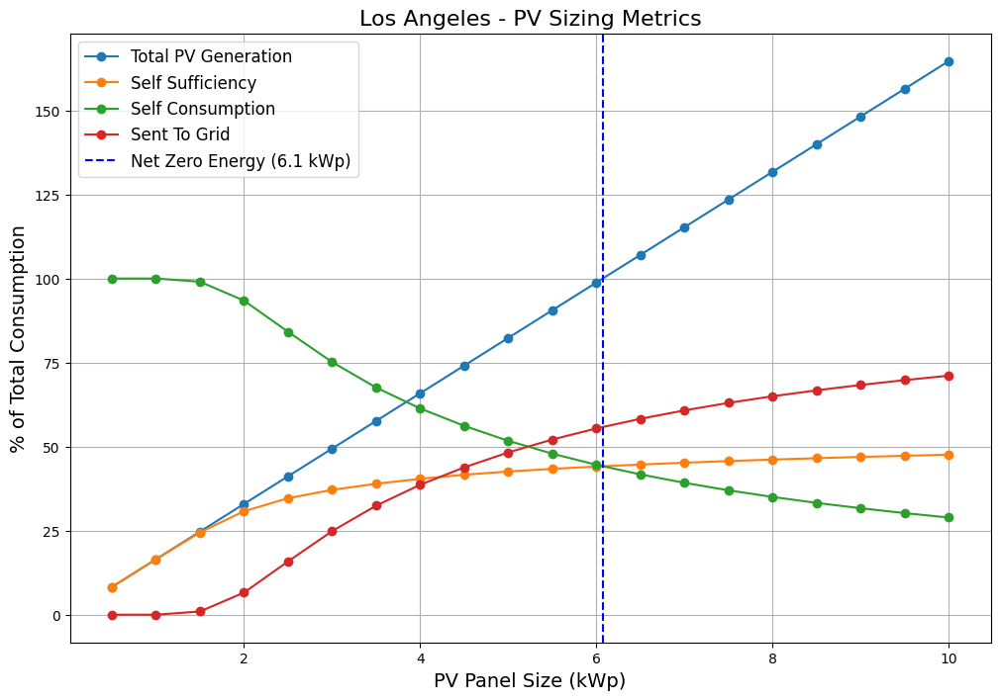

In [ ]:
# Define parameters
pv_sizes = np.arange(0.5, 10.5, 0.5)  # PV sizes from 0.5 kWp to 10.0 kWp
nze_percentage = 1.0  # 100% NZE
nze_type = "Site"
water_heater_type = "Electric_WH"
home_type = "AE"
pv_data_path = "/content/drive/MyDrive/Thesis/Data/Los_Angeles/Los_Angeles PV Watts Hourly kW.csv"
load_data_path = "/content/drive/MyDrive/Thesis/Data/Los_Angeles/Los_Angeles_AE_Electric_WH_Loads.csv"

# Load data and calculate metrics
results, NZE_PV_Size = load_data_parametric(pv_data_path, load_data_path, pv_sizes, nze_type, nze_percentage, water_heater_type, home_type)

# Create the plot
plt.figure(figsize=(12, 8))
plt.plot(results['PV_Size'], results['Total_PV_Generation'], label='Total PV Generation', marker='o')
plt.plot(results['PV_Size'], results['Self_Sufficiency'], label='Self Sufficiency', marker='o')
plt.plot(results['PV_Size'], results['Self_Consumption'], label='Self Consumption', marker='o')
plt.plot(results['PV_Size'], results['Sent_To_Grid'], label='Sent To Grid', marker='o')
plt.axvline(NZE_PV_Size, color='blue', linestyle='--', label=f'Net Zero Energy ({NZE_PV_Size:.1f} kWp)')

# Customize plot
plt.title("Los Angeles - PV Sizing Metrics", fontsize=16)
plt.xlabel("PV Panel Size (kWp)", fontsize=14)
plt.ylabel("% of Total Consumption", fontsize=14)
plt.legend(fontsize=12)
plt.grid(True)
plt.show()


## Try 2

In [ ]:
def create_default_configs_parametric(region, nze_percentage_range):
    """
    Creates parametric configurations for a specific region and range of NZE percentages.

    Parameters:
        region (str): The region (e.g., city) for which configurations will be created.
        nze_percentage_range (list): A list of NZE percentages (e.g., [0.5, 0.75, 1.0, 1.25, 1.5]).
    """
    created_configs = []  # Initialize the variable at the beginning

    # Define the results folder for the parametric run
    results_folder = f"/content/drive/MyDrive/Thesis/Results/{region.replace(' ', '_')}/parametric"

    # Create the shared parent folder
    os.makedirs(results_folder, exist_ok=True)

    # Generate configurations for each NZE percentage
    for nze_percentage in nze_percentage_range:
        created_configs.append(
            create_configuration(region, "NAE", "Electric_WH", nze_percentage, "Site", default_run=True, default_results_folder=results_folder)
        )
        created_configs.append(
            create_configuration(region, "NAE", "Gas_WH", nze_percentage, "Site", default_run=True, default_results_folder=results_folder)
        )
        created_configs.append(
            create_configuration(region, "AE", "Electric_WH", nze_percentage, "Site", default_run=True, default_results_folder=results_folder)
        )

    # Filter out any None configurations (e.g., if files were missing)
    created_configs = [config for config in created_configs if config is not None]

    # Print summary
    if created_configs:
        print(colored_text(f"Parametric configurations created for {region}. Results stored in: {results_folder}", 33))
    else:
        print(colored_text(f"No configurations were created for {region}. Please check input files and paths.", 31))

    # List created configurations
    for config in created_configs:
        print(config['config_suffix'])


In [ ]:
def run_model_parametric(region, nze_percentage_range):
    """
    Runs all parametric configurations for a specific region and NZE percentage range.

    Parameters:
        region (str): The region (e.g., city) for which configurations will be run.
        nze_percentage_range (list): A list of NZE percentages (e.g., [0.5, 0.75, 1.0, 1.25, 1.5]).
    """
    # Filter configurations by region
    region_configs = filter_configs_by_region(region)

    # Check if any configurations exist for this region
    if not region_configs:
        print(f"Error: No configurations found for '{region}'. Please create configurations first.")
        return

    # Filter configurations that match the NZE percentage range
    parametric_configs = [
        config for config in region_configs
        if config['nze_percentage'] in nze_percentage_range
    ]

    if not parametric_configs:
        print(f"No parametric configurations found for {region} in the specified NZE percentage range.")
        return

    print(f"\n{bold_text('Available Configurations for')} {colored_text(region, 33)}:")
    for i, config in enumerate(parametric_configs):
        print(f"[{i + 1}] {config['config_suffix']}")

    choice = input(
        "Select configuration by index,\n"
        "type 'all' to run all configurations,\n"
        "or type multiple indexes separated by commas: "
    ).strip().lower()

    if choice == "all":
        selected_configs = parametric_configs
    else:
        indexes = [int(i) - 1 for i in choice.split(",")]
        selected_configs = [parametric_configs[i] for i in indexes]

    option = input("Do you want to run all models for all configurations? (yes/no): ").strip().lower()
    total_configs = len(selected_configs)

    if option == "yes":
        for idx, config in enumerate(selected_configs, start=1):
            print(f"\n{bold_text(f'Running all models for configuration:')} {colored_text(config['config_suffix'], 33)} ({idx}/{total_configs})\n")
            run_thermal_model(config)
            run_battery_model(config)
            run_hydrogen_model(config)
            run_chp_model(config)
    else:
        available_models = ["thermal_battery", "battery", "hydrogen", "chp"]
        print("\nAvailable Models:")
        for i, model in enumerate(available_models):
            print(f"[{i + 1}] {model}")

        model_choice = input(
            "Select model by index,\n"
            "type 'all' to run all models,\n"
            "or type multiple indexes separated by commas: "
        ).strip().lower()

        selected_models = available_models if model_choice == "all" else [available_models[int(i) - 1] for i in model_choice.split(",")]

        for idx, config in enumerate(selected_configs, start=1):
            print(f"\n{bold_text(f'Running selected models for configuration:')} {colored_text(config['config_suffix'], 33)} ({idx}/{total_configs})\n")
            for model in selected_models:
                if model == "thermal_battery":
                    run_thermal_model(config)
                elif model == "battery":
                    run_battery_model(config)
                elif model == "hydrogen":
                    run_hydrogen_model(config)
                elif model == "chp":
                    run_chp_model(config)


In [ ]:
nze_percentage_range = [0.5, 0.75, 1.0, 1.25, 1.5]
create_default_configs_parametric("Boulder", nze_percentage_range)
run_model_parametric("Boulder", nze_percentage_range)
plot_parametric_results("Boulder", nze_percentage_range)




Configuration Created: Boulder_NAE_Electric_WH_50_Site
Results will be saved in: /content/drive/MyDrive/Thesis/Results/Boulder/parametric/Boulder_NAE_Electric_WH_50_Site

Configuration Created: Boulder_NAE_Gas_WH_50_Site
Results will be saved in: /content/drive/MyDrive/Thesis/Results/Boulder/parametric/Boulder_NAE_Gas_WH_50_Site

Configuration Created: Boulder_AE_Electric_WH_50_Site
Results will be saved in: /content/drive/MyDrive/Thesis/Results/Boulder/parametric/Boulder_AE_Electric_WH_50_Site

Configuration Created: Boulder_NAE_Electric_WH_75_Site
Results will be saved in: /content/drive/MyDrive/Thesis/Results/Boulder/parametric/Boulder_NAE_Electric_WH_75_Site

Configuration Created: Boulder_NAE_Gas_WH_75_Site
Results will be saved in: /content/drive/MyDrive/Thesis/Results/Boulder/parametric/Boulder_NAE_Gas_WH_75_Site

Configuration Created: Boulder_AE_Electric_WH_75_Site
Results will be saved in: /content/drive/MyDrive/Thesis/Results/Boulder/parametric/Boulder_AE_Electric_WH_75_Site

In [ ]:
run_model_parametric("Boulder", nze_percentage_range)



Available Configurations for Boulder:
[1] Boulder_NAE_Electric_WH_50_Site
[2] Boulder_NAE_Gas_WH_50_Site
[3] Boulder_AE_Electric_WH_50_Site
[4] Boulder_NAE_Electric_WH_75_Site
[5] Boulder_NAE_Gas_WH_75_Site
[6] Boulder_AE_Electric_WH_75_Site
[7] Boulder_NAE_Electric_WH_100_Site
[8] Boulder_NAE_Gas_WH_100_Site
[9] Boulder_AE_Electric_WH_100_Site
[10] Boulder_NAE_Electric_WH_125_Site
[11] Boulder_NAE_Gas_WH_125_Site
[12] Boulder_AE_Electric_WH_125_Site
[13] Boulder_NAE_Electric_WH_150_Site
[14] Boulder_NAE_Gas_WH_150_Site
[15] Boulder_AE_Electric_WH_150_Site
Select configuration by index,
type 'all' to run all configurations,
or type multiple indexes separated by commas: all
Do you want to run all models for all configurations? (yes/no): no

Available Models:
[1] thermal_battery
[2] battery
[3] hydrogen
[4] chp
Select model by index,
type 'all' to run all models,
or type multiple indexes separated by commas: 1

Running selected models for configuration: Boulder_NAE_Electric_WH_50_Site (

Thermal Battery Optimization (Chunked): 100%|██████████| 365/365 [00:08<00:00, 40.65it/s]



Thermal Battery Optimization completed.
Results saved to: /content/drive/MyDrive/Thesis/Results/Boulder/parametric/Boulder_NAE_Electric_WH_50_Site/Thermal_Battery_Results_Boulder_NAE_Electric_WH_50_Site.csv


Running selected models for configuration: Boulder_NAE_Gas_WH_50_Site (2/15)


Running Thermal Battery Optimization Model
Loading PV data from: /content/drive/MyDrive/Thesis/Data/Boulder/Boulder PV Watts Hourly kW.csv
Loading load data from: /content/drive/MyDrive/Thesis/Data/Boulder/Boulder_NAE_Gas_WH_Loads.csv
Load Data Columns: Index(['Hours since 00:00 Jan 1', 'My Design - Energy Use:  Total (kBtu)',
       'My Design - Fuel Use:  Electricity: Total (kWh)',
       'My Design - End Use:  Natural Gas: Hot Water (kBtu)'],
      dtype='object')
NZE Solar Array Size: 9.32 kWp
Sized to: Total Site Energy


Thermal Battery Optimization (Chunked): 100%|██████████| 365/365 [00:09<00:00, 38.71it/s]



Thermal Battery Optimization completed.
Results saved to: /content/drive/MyDrive/Thesis/Results/Boulder/parametric/Boulder_NAE_Gas_WH_50_Site/Thermal_Battery_Results_Boulder_NAE_Gas_WH_50_Site.csv


Running selected models for configuration: Boulder_AE_Electric_WH_50_Site (3/15)


Running Thermal Battery Optimization Model
Loading PV data from: /content/drive/MyDrive/Thesis/Data/Boulder/Boulder PV Watts Hourly kW.csv
Loading load data from: /content/drive/MyDrive/Thesis/Data/Boulder/Boulder_AE_Electric_WH_Loads.csv
Load Data Columns: Index(['Hours since 00:00 Jan 1', 'My Design - Energy Use:  Total (kBtu)',
       'My Design - Fuel Use:  Electricity: Total (kWh)',
       'My Design - End Use:  Electricity: Hot Water (kWh)'],
      dtype='object')
NZE Solar Array Size: 5.96 kWp
Sized to: Total Site Energy


Thermal Battery Optimization (Chunked): 100%|██████████| 365/365 [00:10<00:00, 35.60it/s]



Thermal Battery Optimization completed.
Results saved to: /content/drive/MyDrive/Thesis/Results/Boulder/parametric/Boulder_AE_Electric_WH_50_Site/Thermal_Battery_Results_Boulder_AE_Electric_WH_50_Site.csv


Running selected models for configuration: Boulder_NAE_Electric_WH_75_Site (4/15)


Running Thermal Battery Optimization Model
Loading PV data from: /content/drive/MyDrive/Thesis/Data/Boulder/Boulder PV Watts Hourly kW.csv
Loading load data from: /content/drive/MyDrive/Thesis/Data/Boulder/Boulder_NAE_Electric_WH_Loads.csv
Load Data Columns: Index(['Hours since 00:00 Jan 1', 'My Design - Energy Use:  Total (kBtu)',
       'My Design - Fuel Use:  Electricity: Total (kWh)',
       'My Design - End Use:  Electricity: Hot Water (kWh)'],
      dtype='object')
NZE Solar Array Size: 13.97 kWp
Sized to: Total Site Energy


Thermal Battery Optimization (Chunked): 100%|██████████| 365/365 [00:09<00:00, 39.06it/s]



Thermal Battery Optimization completed.
Results saved to: /content/drive/MyDrive/Thesis/Results/Boulder/parametric/Boulder_NAE_Electric_WH_75_Site/Thermal_Battery_Results_Boulder_NAE_Electric_WH_75_Site.csv


Running selected models for configuration: Boulder_NAE_Gas_WH_75_Site (5/15)


Running Thermal Battery Optimization Model
Loading PV data from: /content/drive/MyDrive/Thesis/Data/Boulder/Boulder PV Watts Hourly kW.csv
Loading load data from: /content/drive/MyDrive/Thesis/Data/Boulder/Boulder_NAE_Gas_WH_Loads.csv
Load Data Columns: Index(['Hours since 00:00 Jan 1', 'My Design - Energy Use:  Total (kBtu)',
       'My Design - Fuel Use:  Electricity: Total (kWh)',
       'My Design - End Use:  Natural Gas: Hot Water (kBtu)'],
      dtype='object')
NZE Solar Array Size: 13.97 kWp
Sized to: Total Site Energy


Thermal Battery Optimization (Chunked): 100%|██████████| 365/365 [00:08<00:00, 40.67it/s]



Thermal Battery Optimization completed.
Results saved to: /content/drive/MyDrive/Thesis/Results/Boulder/parametric/Boulder_NAE_Gas_WH_75_Site/Thermal_Battery_Results_Boulder_NAE_Gas_WH_75_Site.csv


Running selected models for configuration: Boulder_AE_Electric_WH_75_Site (6/15)


Running Thermal Battery Optimization Model
Loading PV data from: /content/drive/MyDrive/Thesis/Data/Boulder/Boulder PV Watts Hourly kW.csv
Loading load data from: /content/drive/MyDrive/Thesis/Data/Boulder/Boulder_AE_Electric_WH_Loads.csv
Load Data Columns: Index(['Hours since 00:00 Jan 1', 'My Design - Energy Use:  Total (kBtu)',
       'My Design - Fuel Use:  Electricity: Total (kWh)',
       'My Design - End Use:  Electricity: Hot Water (kWh)'],
      dtype='object')
NZE Solar Array Size: 8.94 kWp
Sized to: Total Site Energy


Thermal Battery Optimization (Chunked): 100%|██████████| 365/365 [00:10<00:00, 35.60it/s]



Thermal Battery Optimization completed.
Results saved to: /content/drive/MyDrive/Thesis/Results/Boulder/parametric/Boulder_AE_Electric_WH_75_Site/Thermal_Battery_Results_Boulder_AE_Electric_WH_75_Site.csv


Running selected models for configuration: Boulder_NAE_Electric_WH_100_Site (7/15)


Running Thermal Battery Optimization Model
Loading PV data from: /content/drive/MyDrive/Thesis/Data/Boulder/Boulder PV Watts Hourly kW.csv
Loading load data from: /content/drive/MyDrive/Thesis/Data/Boulder/Boulder_NAE_Electric_WH_Loads.csv
Load Data Columns: Index(['Hours since 00:00 Jan 1', 'My Design - Energy Use:  Total (kBtu)',
       'My Design - Fuel Use:  Electricity: Total (kWh)',
       'My Design - End Use:  Electricity: Hot Water (kWh)'],
      dtype='object')
NZE Solar Array Size: 18.63 kWp
Sized to: Total Site Energy


Thermal Battery Optimization (Chunked): 100%|██████████| 365/365 [00:09<00:00, 38.05it/s]



Thermal Battery Optimization completed.
Results saved to: /content/drive/MyDrive/Thesis/Results/Boulder/parametric/Boulder_NAE_Electric_WH_100_Site/Thermal_Battery_Results_Boulder_NAE_Electric_WH_100_Site.csv


Running selected models for configuration: Boulder_NAE_Gas_WH_100_Site (8/15)


Running Thermal Battery Optimization Model
Loading PV data from: /content/drive/MyDrive/Thesis/Data/Boulder/Boulder PV Watts Hourly kW.csv
Loading load data from: /content/drive/MyDrive/Thesis/Data/Boulder/Boulder_NAE_Gas_WH_Loads.csv
Load Data Columns: Index(['Hours since 00:00 Jan 1', 'My Design - Energy Use:  Total (kBtu)',
       'My Design - Fuel Use:  Electricity: Total (kWh)',
       'My Design - End Use:  Natural Gas: Hot Water (kBtu)'],
      dtype='object')
NZE Solar Array Size: 18.63 kWp
Sized to: Total Site Energy


Thermal Battery Optimization (Chunked): 100%|██████████| 365/365 [00:08<00:00, 41.30it/s]



Thermal Battery Optimization completed.
Results saved to: /content/drive/MyDrive/Thesis/Results/Boulder/parametric/Boulder_NAE_Gas_WH_100_Site/Thermal_Battery_Results_Boulder_NAE_Gas_WH_100_Site.csv


Running selected models for configuration: Boulder_AE_Electric_WH_100_Site (9/15)


Running Thermal Battery Optimization Model
Loading PV data from: /content/drive/MyDrive/Thesis/Data/Boulder/Boulder PV Watts Hourly kW.csv
Loading load data from: /content/drive/MyDrive/Thesis/Data/Boulder/Boulder_AE_Electric_WH_Loads.csv
Load Data Columns: Index(['Hours since 00:00 Jan 1', 'My Design - Energy Use:  Total (kBtu)',
       'My Design - Fuel Use:  Electricity: Total (kWh)',
       'My Design - End Use:  Electricity: Hot Water (kWh)'],
      dtype='object')
NZE Solar Array Size: 11.93 kWp
Sized to: Total Site Energy


Thermal Battery Optimization (Chunked): 100%|██████████| 365/365 [00:09<00:00, 36.62it/s]



Thermal Battery Optimization completed.
Results saved to: /content/drive/MyDrive/Thesis/Results/Boulder/parametric/Boulder_AE_Electric_WH_100_Site/Thermal_Battery_Results_Boulder_AE_Electric_WH_100_Site.csv


Running selected models for configuration: Boulder_NAE_Electric_WH_125_Site (10/15)


Running Thermal Battery Optimization Model
Loading PV data from: /content/drive/MyDrive/Thesis/Data/Boulder/Boulder PV Watts Hourly kW.csv
Loading load data from: /content/drive/MyDrive/Thesis/Data/Boulder/Boulder_NAE_Electric_WH_Loads.csv
Load Data Columns: Index(['Hours since 00:00 Jan 1', 'My Design - Energy Use:  Total (kBtu)',
       'My Design - Fuel Use:  Electricity: Total (kWh)',
       'My Design - End Use:  Electricity: Hot Water (kWh)'],
      dtype='object')
NZE Solar Array Size: 23.29 kWp
Sized to: Total Site Energy


Thermal Battery Optimization (Chunked): 100%|██████████| 365/365 [00:09<00:00, 38.31it/s]



Thermal Battery Optimization completed.
Results saved to: /content/drive/MyDrive/Thesis/Results/Boulder/parametric/Boulder_NAE_Electric_WH_125_Site/Thermal_Battery_Results_Boulder_NAE_Electric_WH_125_Site.csv


Running selected models for configuration: Boulder_NAE_Gas_WH_125_Site (11/15)


Running Thermal Battery Optimization Model
Loading PV data from: /content/drive/MyDrive/Thesis/Data/Boulder/Boulder PV Watts Hourly kW.csv
Loading load data from: /content/drive/MyDrive/Thesis/Data/Boulder/Boulder_NAE_Gas_WH_Loads.csv
Load Data Columns: Index(['Hours since 00:00 Jan 1', 'My Design - Energy Use:  Total (kBtu)',
       'My Design - Fuel Use:  Electricity: Total (kWh)',
       'My Design - End Use:  Natural Gas: Hot Water (kBtu)'],
      dtype='object')
NZE Solar Array Size: 23.29 kWp
Sized to: Total Site Energy


Thermal Battery Optimization (Chunked): 100%|██████████| 365/365 [00:08<00:00, 42.54it/s]



Thermal Battery Optimization completed.
Results saved to: /content/drive/MyDrive/Thesis/Results/Boulder/parametric/Boulder_NAE_Gas_WH_125_Site/Thermal_Battery_Results_Boulder_NAE_Gas_WH_125_Site.csv


Running selected models for configuration: Boulder_AE_Electric_WH_125_Site (12/15)


Running Thermal Battery Optimization Model
Loading PV data from: /content/drive/MyDrive/Thesis/Data/Boulder/Boulder PV Watts Hourly kW.csv
Loading load data from: /content/drive/MyDrive/Thesis/Data/Boulder/Boulder_AE_Electric_WH_Loads.csv
Load Data Columns: Index(['Hours since 00:00 Jan 1', 'My Design - Energy Use:  Total (kBtu)',
       'My Design - Fuel Use:  Electricity: Total (kWh)',
       'My Design - End Use:  Electricity: Hot Water (kWh)'],
      dtype='object')
NZE Solar Array Size: 14.91 kWp
Sized to: Total Site Energy


Thermal Battery Optimization (Chunked): 100%|██████████| 365/365 [00:10<00:00, 35.29it/s]



Thermal Battery Optimization completed.
Results saved to: /content/drive/MyDrive/Thesis/Results/Boulder/parametric/Boulder_AE_Electric_WH_125_Site/Thermal_Battery_Results_Boulder_AE_Electric_WH_125_Site.csv


Running selected models for configuration: Boulder_NAE_Electric_WH_150_Site (13/15)


Running Thermal Battery Optimization Model
Loading PV data from: /content/drive/MyDrive/Thesis/Data/Boulder/Boulder PV Watts Hourly kW.csv
Loading load data from: /content/drive/MyDrive/Thesis/Data/Boulder/Boulder_NAE_Electric_WH_Loads.csv
Load Data Columns: Index(['Hours since 00:00 Jan 1', 'My Design - Energy Use:  Total (kBtu)',
       'My Design - Fuel Use:  Electricity: Total (kWh)',
       'My Design - End Use:  Electricity: Hot Water (kWh)'],
      dtype='object')
NZE Solar Array Size: 27.95 kWp
Sized to: Total Site Energy


Thermal Battery Optimization (Chunked): 100%|██████████| 365/365 [00:10<00:00, 34.10it/s]



Thermal Battery Optimization completed.
Results saved to: /content/drive/MyDrive/Thesis/Results/Boulder/parametric/Boulder_NAE_Electric_WH_150_Site/Thermal_Battery_Results_Boulder_NAE_Electric_WH_150_Site.csv


Running selected models for configuration: Boulder_NAE_Gas_WH_150_Site (14/15)


Running Thermal Battery Optimization Model
Loading PV data from: /content/drive/MyDrive/Thesis/Data/Boulder/Boulder PV Watts Hourly kW.csv
Loading load data from: /content/drive/MyDrive/Thesis/Data/Boulder/Boulder_NAE_Gas_WH_Loads.csv
Load Data Columns: Index(['Hours since 00:00 Jan 1', 'My Design - Energy Use:  Total (kBtu)',
       'My Design - Fuel Use:  Electricity: Total (kWh)',
       'My Design - End Use:  Natural Gas: Hot Water (kBtu)'],
      dtype='object')
NZE Solar Array Size: 27.95 kWp
Sized to: Total Site Energy


Thermal Battery Optimization (Chunked): 100%|██████████| 365/365 [00:08<00:00, 40.73it/s]



Thermal Battery Optimization completed.
Results saved to: /content/drive/MyDrive/Thesis/Results/Boulder/parametric/Boulder_NAE_Gas_WH_150_Site/Thermal_Battery_Results_Boulder_NAE_Gas_WH_150_Site.csv


Running selected models for configuration: Boulder_AE_Electric_WH_150_Site (15/15)


Running Thermal Battery Optimization Model
Loading PV data from: /content/drive/MyDrive/Thesis/Data/Boulder/Boulder PV Watts Hourly kW.csv
Loading load data from: /content/drive/MyDrive/Thesis/Data/Boulder/Boulder_AE_Electric_WH_Loads.csv
Load Data Columns: Index(['Hours since 00:00 Jan 1', 'My Design - Energy Use:  Total (kBtu)',
       'My Design - Fuel Use:  Electricity: Total (kWh)',
       'My Design - End Use:  Electricity: Hot Water (kWh)'],
      dtype='object')
NZE Solar Array Size: 17.89 kWp
Sized to: Total Site Energy


Thermal Battery Optimization (Chunked): 100%|██████████| 365/365 [00:10<00:00, 34.18it/s]



Thermal Battery Optimization completed.
Results saved to: /content/drive/MyDrive/Thesis/Results/Boulder/parametric/Boulder_AE_Electric_WH_150_Site/Thermal_Battery_Results_Boulder_AE_Electric_WH_150_Site.csv



In [ ]:
import os
import pandas as pd
import matplotlib.pyplot as plt

def plot_parametric_results(region, nze_percentage_range):
    """
    Plots parametric results for a given region and NZE percentage range.

    Parameters:
        region (str): The region (e.g., city) for which results will be plotted.
        nze_percentage_range (list): A list of NZE percentages (e.g., [0.5, 0.75, 1.0, 1.25, 1.5]).
    """
    storage_models = ["Thermal_Battery", "Battery", "Hydrogen", "Chp"]
    results_data = {model: [] for model in storage_models}

    # Loop through NZE percentages and collect results for each model
    for nze_percentage in nze_percentage_range:
        for model in storage_models:
            # Define the base directory and expected results path
            base_dir = f"/content/drive/MyDrive/Thesis/Results/{region}/parametric/"
            # Loop through all possible configurations for each NZE percentage
            for config_suffix in os.listdir(base_dir):
                # Check if the configuration folder contains the specific NZE percentage and model
                if f"{nze_percentage * 100}" in config_suffix and model in config_suffix:
                    results_path = os.path.join(base_dir, config_suffix, f"{model}_Results_{config_suffix}.csv")

                    # Debugging print
                    print(f"Looking for results at: {results_path}")

                    # If the results file exists, load it
                    if os.path.exists(results_path):
                        print(f"Found results for {model} at: {results_path}")  # Debugging output
                        results_df = pd.read_csv(results_path)
                        results_data[model].append((nze_percentage, results_df))
                    else:
                        print(f"Results for {nze_percentage * 100}% NZE with {model} not found at {results_path}. Skipping...")

    # Plot results for each energy storage model
    for model, data in results_data.items():
        if not data:
            print(f"No results available for {model}. Skipping plot...")
            continue

        # Extract metrics for the plot
        nze_sizes = []
        Self_Consumption = []
        self_sufficiency = []
        sent_to_grid = []
        total_pv_generation = []

        for nze_percentage, df in data:
            total_pv = df["P_PV"].sum()
            total_load = df["P_Total_Load"].sum()
            total_self_consumed = df["Self_Consumption"].sum()
            total_exported = df["P_Grid_To"].sum()

            nze_sizes.append(total_pv / 1_000)  # Convert PV size to kWp
            Self_Consumption.append((total_self_consumed / total_pv) * 100)
            self_sufficiency.append((total_self_consumed / total_load) * 100)
            sent_to_grid.append((total_exported / total_pv) * 100)
            total_pv_generation.append((total_pv / total_load) * 100)

        # Create the plot
        plt.figure(figsize=(10, 6))
        plt.plot(nze_sizes, total_pv_generation, 'o-', label="Total PV Generation")
        plt.plot(nze_sizes, self_sufficiency, 'o-', label="Self Sufficiency")
        plt.plot(nze_sizes, Self_Consumption, 'o-', label="Self Consumption")
        plt.plot(nze_sizes, sent_to_grid, 'o-', label="Sent to Grid")
        plt.axvline(x=1.0, color="blue", linestyle="--", label="Net Zero Energy (100%)")

        plt.title(f"Parametric Results: {model} Optimization - {region}")
        plt.xlabel("PV Panel Size [kWp]")
        plt.ylabel("% Of The Total Consumption")
        plt.legend()
        plt.grid(True)
        plt.show()


In [ ]:
plot_parametric_results("Boulder", nze_percentage_range)


No results available for Thermal_Battery. Skipping plot...
No results available for Battery. Skipping plot...
No results available for Hydrogen. Skipping plot...
No results available for Chp. Skipping plot...


In [ ]:
import os

def check_saved_files(region):
    base_dir = f"/content/drive/MyDrive/Thesis/Results/{region}/parametric/"

    # List all files in the directory
    print(f"Listing all files in {base_dir}:")
    for root, dirs, files in os.walk(base_dir):
        for file in files:
            print(f"Found file: {file}")

# Call this function for the Boulder region (or any other region)
check_saved_files("Boulder")


Listing all files in /content/drive/MyDrive/Thesis/Results/Boulder/parametric/:
Found file: Thermal_Battery_Results_Boulder_NAE_Electric_WH_50_Site.csv
Found file: Thermal_Battery_Results_Boulder_NAE_Gas_WH_50_Site.csv
Found file: Thermal_Battery_Results_Boulder_AE_Electric_WH_50_Site.csv
Found file: Thermal_Battery_Results_Boulder_NAE_Electric_WH_75_Site.csv
Found file: Thermal_Battery_Results_Boulder_NAE_Gas_WH_75_Site.csv
Found file: Thermal_Battery_Results_Boulder_AE_Electric_WH_75_Site.csv
Found file: Thermal_Battery_Results_Boulder_NAE_Electric_WH_100_Site.csv
Found file: Thermal_Battery_Results_Boulder_NAE_Gas_WH_100_Site.csv
Found file: Thermal_Battery_Results_Boulder_AE_Electric_WH_100_Site.csv
Found file: Thermal_Battery_Results_Boulder_NAE_Electric_WH_125_Site.csv
Found file: Thermal_Battery_Results_Boulder_NAE_Gas_WH_125_Site.csv
Found file: Thermal_Battery_Results_Boulder_AE_Electric_WH_125_Site.csv
Found file: Thermal_Battery_Results_Boulder_NAE_Electric_WH_150_Site.csv
F

In [ ]:
from matplotlib.ticker import ScalarFormatter



In [ ]:
def plot_parametric_results(region, nze_percentage_range):
    """
    Plots the results for the parametric analysis for a given region.

    Parameters:
        region (str): The region (e.g., city) for which configurations were run.
        nze_percentage_range (list): A list of NZE percentages (e.g., [0.5, 0.75, 1.0, 1.25, 1.5]).
    """
    results_folder = f"/content/drive/MyDrive/Thesis/Results/{region.replace(' ', '_')}/parametric"
    pv_sizes = []
    total_pv_generation = []
    self_sufficiency = []
    Self_Consumption = []
    sent_to_grid = []

    # Iterate over NZE percentages and load results
    for nze_percentage in nze_percentage_range:
        config_suffix = f"{region.replace(' ', '_')}_NAE_Electric_WH_{int(nze_percentage * 100)}_Site"
        result_path = os.path.join(results_folder, config_suffix, f"Thermal_Battery_Results_{config_suffix}.csv")

        if os.path.exists(result_path):
            df = pd.read_csv(result_path)

            # Calculate metrics
            pv_size = nze_percentage  # The PV size is proportional to NZE percentage
            pv_sizes.append(pv_size)

            total_consumption = df['P_Total_Load'].sum()
            pv_generation = df['P_PV'].sum()
            grid_import = df['P_Grid_From'].sum()
            grid_export = df['P_Grid_To'].sum()
            self_use = pv_generation - grid_export

            total_pv_generation.append((pv_generation / total_consumption) * 100)
            self_sufficiency.append((self_use / total_consumption) * 100)
            Self_Consumption.append((self_use / pv_generation) * 100)
            sent_to_grid.append((grid_export / pv_generation) * 100)

    # Plotting the results
    plt.figure(figsize=(12, 8))

    plt.plot(pv_sizes, total_pv_generation, 'o-', label='Total PV Generation', color='tab:blue')
    plt.plot(pv_sizes, self_sufficiency, 'o-', label='Self Sufficiency', color='tab:orange')
    plt.plot(pv_sizes, Self_Consumption, 'o-', label='Self Consumption', color='tab:green')
    plt.plot(pv_sizes, sent_to_grid, 'o-', label='Sent To Grid', color='tab:red')

    # Add Net Zero Energy line
    plt.axvline(x=1.0, color='purple', linestyle='-', label='Net Zero Energy')

    # Adding annotations to each point (optional)
    for i, size in enumerate(pv_sizes):
        plt.text(size, total_pv_generation[i], f'{size}', fontsize=9, ha='right')

    # Formatting the plot
    plt.xlabel('% of Net Zero Energy', fontsize=14)
    plt.ylabel('% Of The Total Consumption', fontsize=14)
    plt.title(region, fontsize=16)
    plt.xscale('log')  # Use exponential scale for x-axis
    plt.yscale('log')  # Use exponential scale for y-axis
    plt.gca().xaxis.set_major_formatter(ScalarFormatter())  # Ensure x-axis labels are formatted as linear values
    plt.gca().yaxis.set_major_formatter(ScalarFormatter())  # Ensure y-axis labels are formatted as linear values
    plt.legend()
    plt.grid(True, which="both", linestyle='--', linewidth=0.5)

    # Show the plot
    plt.tight_layout()
    plt.show()


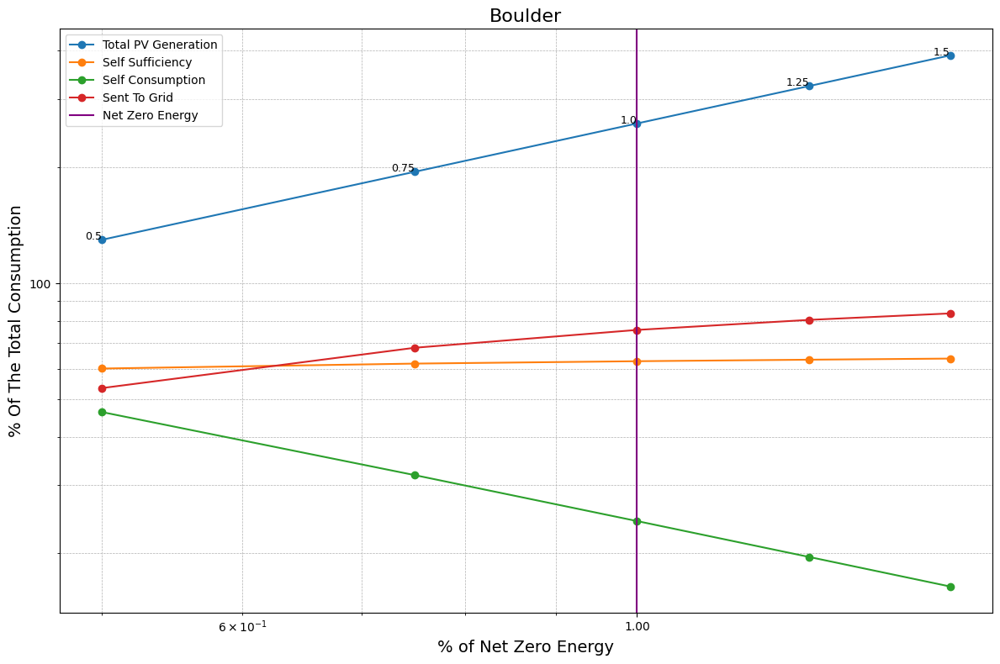

In [ ]:
plot_parametric_results("Boulder", nze_percentage_range)


In [ ]:
def plot_parametric_results(region, nze_percentage_range):
    """
    Plots the results for the parametric analysis for a given region.

    Parameters:
        region (str): The region (e.g., city) for which configurations were run.
        nze_percentage_range (list): A list of NZE percentages (e.g., [0.5, 0.75, 1.0, 1.25, 1.5]).
    """
    results_folder = f"/content/drive/MyDrive/Thesis/Results/{region.replace(' ', '_')}/parametric"
    pv_sizes = []
    total_pv_generation = []
    self_sufficiency = []
    Self_Consumption = []
    sent_to_grid = []

    # Iterate over NZE percentages and load results
    for nze_percentage in nze_percentage_range:
        config_suffix = f"{region.replace(' ', '_')}_NAE_Electric_WH_{int(nze_percentage * 100)}_Site"
        result_path = os.path.join(results_folder, config_suffix, f"Thermal_Battery_Results_{config_suffix}.csv")

        if os.path.exists(result_path):
            df = pd.read_csv(result_path)

            # Calculate metrics
            total_consumption = df['P_Total_Load'].sum()
            pv_generation = df['P_PV'].sum()
            grid_export = df['P_Grid_To'].sum()
            self_use = pv_generation - grid_export

            pv_size = nze_percentage  # The PV size is proportional to NZE percentage
            pv_sizes.append(pv_size)

            total_pv_generation.append(((total_consumption + pv_generation) / total_consumption) * 100)
            self_sufficiency.append(((pv_generation - grid_export) / total_consumption) * 100)
            Self_Consumption.append(((pv_generation - grid_export) / pv_generation) * 100)
            sent_to_grid.append((grid_export / pv_generation) * 100)

    # Plotting the results
    plt.figure(figsize=(12, 8))

    plt.plot(pv_sizes, total_pv_generation, 'o-', label='Total PV Generation', color='tab:blue')
    plt.plot(pv_sizes, self_sufficiency, 'o-', label='Self Sufficiency', color='tab:orange')
    plt.plot(pv_sizes, Self_Consumption, 'o-', label='Self Consumption', color='tab:green')
    plt.plot(pv_sizes, sent_to_grid, 'o-', label='Sent To Grid', color='tab:red')

    # Add Net Zero Energy line
    plt.axvline(x=1.0, color='purple', linestyle='-', label='Net Zero Energy')

    # Adding annotations to each point (optional)
    for i, size in enumerate(pv_sizes):
        plt.text(size, total_pv_generation[i], f'{size}', fontsize=9, ha='right')

    # Formatting the plot
    plt.xlabel('% of Net Zero Energy', fontsize=14)
    plt.ylabel('Energy Metrics (% of Total)', fontsize=14)
    plt.title(region, fontsize=16)
    plt.xscale('linear')  # Use linear scale for x-axis
    plt.yscale('log')  # Use log scale for y-axis
    plt.gca().xaxis.set_major_formatter(ScalarFormatter())  # Ensure x-axis labels are formatted as linear values
    plt.gca().yaxis.set_major_formatter(LogFormatter())  # Use log formatter for y-axis
    plt.gca().yaxis.set_minor_locator(LogLocator(base=10.0, subs='auto'))
    plt.yticks([10, 20, 50, 90, 100, 200, 300, 400], ["10%", "20%", "50%", "90%", "100%", "200%", "300%", "400%"])
    plt.xticks([0.5, 0.75, 1.0, 1.25, 1.5], ["50%", "75%", "100%", "125%", "150%"])
    plt.legend()
    plt.grid(True, which="both", linestyle='--', linewidth=0.5)

    # Show the plot
    plt.tight_layout()
    plt.show()

    # Plot baseline without energy storage
    pv_sizes_baseline = []
    total_pv_generation_baseline = []
    self_sufficiency_baseline = []
    Self_Consumption_baseline = []
    sent_to_grid_baseline = []

    for nze_percentage in nze_percentage_range:
        config_suffix = f"{region.replace(' ', '_')}_NAE_Electric_WH_{int(nze_percentage * 100)}_Site"
        result_path_baseline = os.path.join(results_folder, config_suffix, f"Baseline_Results_{config_suffix}.csv")

        if os.path.exists(result_path_baseline):
            df_baseline = pd.read_csv(result_path_baseline)

            total_consumption_baseline = df_baseline['P_Total_Load'].sum()
            pv_generation_baseline = df_baseline['P_PV'].sum()
            grid_export_baseline = df_baseline['P_Grid_To'].sum()

            pv_sizes_baseline.append(nze_percentage)
            total_pv_generation_baseline.append(((total_consumption_baseline + pv_generation_baseline) / total_consumption_baseline) * 100)
            self_sufficiency_baseline.append(((pv_generation_baseline - grid_export_baseline) / total_consumption_baseline) * 100)
            Self_Consumption_baseline.append(((pv_generation_baseline - grid_export_baseline) / pv_generation_baseline) * 100)
            sent_to_grid_baseline.append((grid_export_baseline / pv_generation_baseline) * 100)

    plt.figure(figsize=(12, 8))

    plt.plot(pv_sizes_baseline, total_pv_generation_baseline, 'o-', label='Total PV Generation (Baseline)', color='tab:blue')
    plt.plot(pv_sizes_baseline, self_sufficiency_baseline, 'o-', label='Self Sufficiency (Baseline)', color='tab:orange')
    plt.plot(pv_sizes_baseline, Self_Consumption_baseline, 'o-', label='Self Consumption (Baseline)', color='tab:green')
    plt.plot(pv_sizes_baseline, sent_to_grid_baseline, 'o-', label='Sent To Grid (Baseline)', color='tab:red')

    plt.axvline(x=1.0, color='purple', linestyle='-', label='Net Zero Energy')

    for i, size in enumerate(pv_sizes_baseline):
        plt.text(size, total_pv_generation_baseline[i], f'{size}', fontsize=9, ha='right')

    plt.xlabel('% of Net Zero Energy', fontsize=14)
    plt.ylabel('Energy Metrics (% of Total)', fontsize=14)
    plt.title(f"{region} (Baseline)", fontsize=16)
    plt.xscale('linear')
    plt.yscale('log')
    plt.gca().xaxis.set_major_formatter(ScalarFormatter())
    plt.gca().yaxis.set_major_formatter(LogFormatter())
    plt.gca().yaxis.set_minor_locator(LogLocator(base=10.0, subs='auto'))
    plt.yticks([10, 20, 50, 90, 100, 200, 300, 400], ["10%", "20%", "50%", "90%", "100%", "200%", "300%", "400%"])
    plt.xticks([0.5, 0.75, 1.0, 1.25, 1.5], ["50%", "75%", "100%", "125%", "150%"])
    plt.legend()
    plt.grid(True, which="both", linestyle='--', linewidth=0.5)

    plt.tight_layout()
    plt.show()

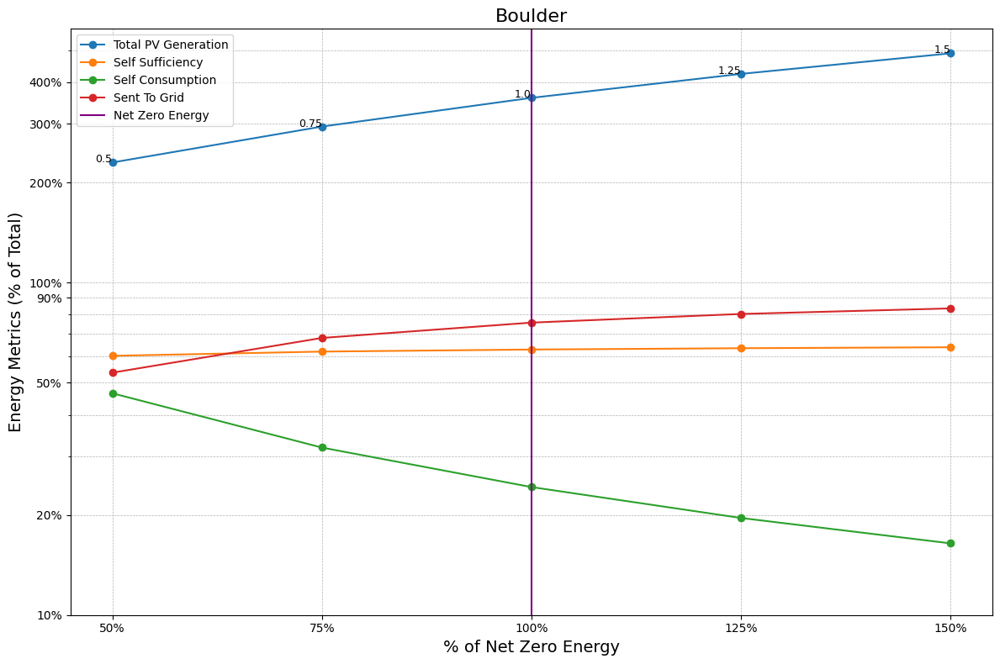

ValueError: Data has no positive values, and therefore cannot be log-scaled.

Error in callback <function _draw_all_if_interactive at 0x7cac9da124d0> (for post_execute):


ValueError: Data has no positive values, and therefore cannot be log-scaled.

ValueError: Data has no positive values, and therefore cannot be log-scaled.

<Figure size 1200x800 with 1 Axes>

In [ ]:
plot_parametric_results("Boulder", nze_percentage_range)


# Chunked Validation

In [ ]:
import os
import pandas as pd

def load_results(results_path):
    """
    Load results from a CSV file and exclude non-numeric columns.

    Parameters:
        results_path (str): Path to the results CSV file.

    Returns:
        DataFrame: Processed DataFrame containing only numeric data.
    """
    if not os.path.exists(results_path):
        raise FileNotFoundError(f"Results file not found: {results_path}")

    results = pd.read_csv(results_path)
    numeric_results = results.select_dtypes(include=['number'])  # Keep only numeric columns
    return numeric_results

def compare_results(original_path, chunked_path):
    """
    Compare yearly totals of the original and chunked model results.

    Parameters:
        original_path (str): Path to the unchunked model results CSV.
        chunked_path (str): Path to the chunked model results CSV.

    Returns:
        DataFrame: A DataFrame showing the comparison of yearly totals.
    """
    # Load results
    original_results = load_results(original_path)
    chunked_results = load_results(chunked_path)

    # Compute yearly totals
    original_totals = original_results.sum()
    chunked_totals = chunked_results.sum()

    # Create a comparison DataFrame
    comparison_df = pd.DataFrame({
        'Unchunked Totals': original_totals,
        'Chunked Totals': chunked_totals,
        'Difference': chunked_totals - original_totals
    })

    return comparison_df

def main():
    # Define paths to the results
    unchunked_results_path = '/content/drive/MyDrive/Thesis/Results/Los_Angeles_Test/Unchunked_Results_Los_Angeles_NAE_Electric_WH_100_Site.csv'
    chunked_results_path = '/content/drive/MyDrive/Thesis/Results/Los_Angeles_Test/Chunked_Results_Los_Angeles_NAE_Electric_WH_100_Site.csv'

    # Perform comparison
    try:
        comparison_df = compare_results(unchunked_results_path, chunked_results_path)

        # Save and display the comparison
        comparison_save_path = '/content/drive/MyDrive/Thesis/Results/Los_Angeles_Test/Comparison_Results_Los_Angeles_NAE_Electric_WH_100_Site.csv'
        comparison_df.to_csv(comparison_save_path, index=True)
        print(f"Comparison results saved to: {comparison_save_path}")

        print("\nYearly Totals Comparison:")
        print(comparison_df)
    except FileNotFoundError as e:
        print(e)

# Run the script
if __name__ == "__main__":
    main()


Comparison results saved to: /content/drive/MyDrive/Thesis/Results/Los_Angeles_Test/Comparison_Results_Los_Angeles_NAE_Electric_WH_100_Site.csv

Yearly Totals Comparison:
                               Unchunked Totals  Chunked Totals    Difference
E_B                                6.263201e+04    6.694540e+04  4.313384e+03
Net_Load_Grid                     -1.385682e+03   -1.385682e+03  4.547474e-13
Net_Load_Grid_Without_Battery     -1.383505e+03   -1.383505e+03  0.000000e+00
P_B_Ch                             2.406224e+03    2.406224e+03  3.637979e-12
P_DHW                              2.408400e+03    2.408400e+03  0.000000e+00
P_Grid_From                        4.117243e+03    4.117243e+03 -2.728484e-12
P_Grid_From_Without_Battery        5.438456e+03    5.438456e+03  0.000000e+00
P_Grid_To                          5.502925e+03    5.502925e+03 -4.547474e-12
P_Grid_To_Without_Battery          6.821962e+03    6.821962e+03  0.000000e+00
P_Load                             7.641720e+03  

# Metrics


## To calculate all metrics for a given region

## Recalculate Metrics Seperately

can be called with either calculate_metrics ("region") or ("config")

In [ ]:
import os
import pandas as pd
from IPython.display import display

def process_model_results(results_path, aggregated_metrics_list=None):
    """
    Processes results to calculate metrics and save them for all storage models,
    including baseline metrics calculated from the results if possible.

    Parameters:
        results_path (str): Path to the CSV file containing model results.
        aggregated_metrics_list (list): A list to store metrics for aggregation across all models.
    """
    # Load results
    results = pd.read_csv(results_path)

    # Identify the model type
    if 'P_B_Ch' in results.columns and 'P_B_Dis' in results.columns and 'E_B' in results.columns:
        model_type = "Battery"
    elif 'P_TB_Ch' in results.columns and 'P_TB_Dis' in results.columns and 'E_TB' in results.columns:
        model_type = "Thermal Battery"
    elif 'P_TB_CH_ER' in results.columns or 'P_TB_CH_WH' in results.columns:
        model_type = "CHP"
    elif 'P_EL' in results.columns and 'P_FC' in results.columns:
        model_type = "Hydrogen"
    else:
        model_type = "Unknown"

    # Attempt to calculate baseline metrics using "_without" columns if available
    if 'P_Grid_From_Baseline' in results.columns and 'P_Grid_To_Baseline' in results.columns:
        P_PV = results['P_PV']
        P_Load = results['P_Load']
        P_Grid_From_Baseline = results['P_Grid_From_Baseline']
        P_Grid_To_Baseline = results['P_Grid_To_Baseline']

        # Calculate baseline metrics
        baseline_summary = {
            'Model_Type': "Baseline (PV)",
            'Self_Consumption': (P_PV - P_Grid_To_Baseline).sum() / P_PV.sum() if P_PV.sum() > 0 else 0,
            'OSU': (P_PV - P_Grid_To_Baseline).sum() / P_PV.sum() if P_PV.sum() > 0 else 0,
            'Self_Sufficiency': (P_PV - P_Grid_To_Baseline).sum() / P_Load.sum() if P_Load.sum() > 0 else 0,
            'GDR': P_Grid_From_Baseline.sum() / P_Load.sum() if P_Load.sum() > 0 else 0,
            'GER': (P_Grid_From_Baseline.sum() - P_Grid_To_Baseline.sum()) / P_Load.sum() if P_Load.sum() > 0 else 0,
            'GUI': P_Grid_To_Baseline.sum() / P_Grid_From_Baseline.sum() if P_Grid_From_Baseline.sum() > 0 else 0,
            'Storage_Efficiency': 0,
            'Peak_Load_Reduction': 0
        }
        baseline_summary_df = pd.DataFrame([baseline_summary])
        baseline_summary_df.index = [0]
    else:
        # Set baseline metrics as fallback values if the required columns are not available
        print("\nWarning: Missing required columns for baseline calculations. Proceeding without baseline.")
        baseline_summary_df = pd.DataFrame([{
            'Model_Type': "Baseline (PV)",
            'Self_Consumption': 0,
            'OSU': 0,
            'Self_Sufficiency': 0,
            'GDR': 0,
            'GER': 0,
            'GUI': 0,
            'Storage_Efficiency': 0,
            'Peak_Load_Reduction': 0
        }])
        baseline_summary_df.index = [0]

    # Calculate model-specific metrics
    P_Grid_From = results['P_Grid_From']
    P_Grid_To = results['P_Grid_To']

    # Model-specific metrics for Battery and Thermal Battery
    if model_type == "Battery":
        P_B_Ch = results['P_B_Ch']
        P_B_Dis = results['P_B_Dis']
        E_B = results['E_B']

        # Calculate battery model metrics
        storage_efficiency = P_B_Dis.sum() / P_B_Ch.sum() if P_B_Ch.sum() > 0 else 0
        peak_load_reduction = results['P_Grid_From_Baseline'].max() - P_Grid_From.max() if 'P_Grid_From_Baseline' in results.columns else 0

    elif model_type == "Thermal Battery":
        P_TB_Ch = results['P_TB_Ch']
        P_TB_Dis = results['P_TB_Dis']
        E_TB = results['E_TB']

        # Calculate thermal battery model metrics
        storage_efficiency = P_TB_Dis.sum() / P_TB_Ch.sum() if P_TB_Ch.sum() > 0 else 0
        peak_load_reduction = results['P_Grid_From_Baseline'].max() - P_Grid_From.max() if 'P_Grid_From_Baseline' in results.columns else 0

    elif model_type == "Hydrogen":
        P_EL = results['P_EL']
        P_FC = results['P_FC']

        # Calculate hydrogen model metrics
        storage_efficiency = P_FC.sum() / P_EL.sum() if P_EL.sum() > 0 else 0
        peak_load_reduction = results['P_Grid_From_Without_H2'].max() - P_Grid_From.max() if 'P_Grid_From_Without_H2' in results.columns else 0

    elif model_type == "CHP":
        P_TB_CH_ER = results['P_TB_CH_ER']
        P_TB_CH_WH = results['P_TB_CH_WH']
        P_TB_Discharge = results['P_TB_Discharge']

        # Calculate CHP model metrics
        storage_efficiency = P_TB_Discharge.sum() / (P_TB_CH_ER + P_TB_CH_WH).sum() if (P_TB_CH_ER + P_TB_CH_WH).sum() > 0 else 0
        peak_load_reduction = results['P_Grid_From_Baseline'].max() - P_Grid_From.max() if 'P_Grid_From_Baseline' in results.columns else 0

    else:
        storage_efficiency = 0
        peak_load_reduction = 0

    # General metrics applicable to all models
    results['Self_Consumption'] = results['P_PV'] - results['P_Grid_To']
    results['Self_Sufficiency'] = results['Self_Consumption'] / results['P_Load']
    results['GDR'] = results['P_Grid_From'] / results['P_Load']
    results['GER'] = (results['P_Grid_From'] - results['P_Grid_To']) / results['P_Load']
    results['GUI'] = results['P_Grid_To'] / results['P_Grid_From'] if P_Grid_From.sum() > 0 else 0
    results['OSU'] = results['Self_Consumption'] / results['P_PV']

    # Summarize metrics for the annual summary
    annual_summary = {
        'Model_Type': model_type,
        'Self_Consumption': results['Self_Consumption'].mean(),
        'OSU': results['OSU'].mean(),
        'Self_Sufficiency': results['Self_Sufficiency'].mean(),
        'GDR': results['GDR'].mean(),
        'GER': results['GER'].mean(),
        'GUI': results['GUI'].mean(),
        'Storage_Efficiency': storage_efficiency,
        'Peak_Load_Reduction': peak_load_reduction
    }

    # Save annual summary
    summary_path = results_path.replace(".csv", "_annual_summary.csv")
    model_summary_df = pd.DataFrame([annual_summary])
    model_summary_df.index = [1]  # Set index to 1 for the model
    model_summary_df.to_csv(summary_path, index=False)

    # Create a combined DataFrame with baseline and model metrics
    combined_summary_df = pd.concat([baseline_summary_df, model_summary_df])

    # Display the summary in an interactive table
    print("\nAnnual Summary Table:")
    display(combined_summary_df)
    print(f"\nMetrics calculated and saved for: {summary_path}")

    # Append to aggregated metrics list if provided
    if aggregated_metrics_list is not None:
        aggregated_metrics_list.append(combined_summary_df)

    # Return the combined summary for further aggregation
    return combined_summary_df


In [ ]:
create_default_configs("Boulder")


Creating default configurations for region: Boulder
Configuration Created: Boulder_NAE_Electric_WH_100_Site_4
Results will be saved in: /content/drive/MyDrive/Thesis/Results/Boulder/Boulder_NAE_Electric_WH_100_Site_4

Configuration Created: Boulder_NAE_Gas_WH_100_Site_4
Results will be saved in: /content/drive/MyDrive/Thesis/Results/Boulder/Boulder_NAE_Gas_WH_100_Site_4

Configuration Created: Boulder_AE_Electric_WH_100_Site_4
Results will be saved in: /content/drive/MyDrive/Thesis/Results/Boulder/Boulder_AE_Electric_WH_100_Site_4

Default configurations created for Boulder. Results stored in: /content/drive/MyDrive/Thesis/Results/Boulder
Boulder_NAE_Electric_WH_100_Site_4
Boulder_NAE_Gas_WH_100_Site_4
Boulder_AE_Electric_WH_100_Site_4


In [ ]:
run_model("Boulder")


Available Configurations for Boulder:
[1] Boulder_NAE_Electric_WH_100_Site_4
[2] Boulder_NAE_Gas_WH_100_Site_4
[3] Boulder_AE_Electric_WH_100_Site_4
Select configuration by index,
type 'all' to run all configurations,
or type multiple indexes separated by commas: 1
Do you want to run all models for this configuration? (yes/no): yes

Running all models for configuration: Boulder_NAE_Electric_WH_100_Site_4


Running Thermal Battery Optimization Model
Loading PV data from: /content/drive/MyDrive/Thesis/Data/Boulder/Boulder PV Watts Hourly kW.csv
Loading load data from: /content/drive/MyDrive/Thesis/Data/Boulder/Boulder_NAE_Electric_WH_Loads.csv
Load Data Columns: Index(['Hours since 00:00 Jan 1', 'My Design - Energy Use:  Total (kBtu)',
       'My Design - Fuel Use:  Electricity: Total (kWh)',
       'My Design - End Use:  Electricity: Hot Water (kWh)'],
      dtype='object')
NZE Solar Array Size: 18.63 kWp
Sized to: Total Site Energy


Thermal Battery Optimization (Chunked): 100%|██████████| 365/365 [00:08<00:00, 43.84it/s]



Thermal Battery Optimization completed.
Results saved to: /content/drive/MyDrive/Thesis/Results/Boulder/Boulder_NAE_Electric_WH_100_Site_4/Thermal_Battery_Results_Boulder_NAE_Electric_WH_100_Site_4.csv


Calculating Metrics

Annual Summary Table:


,Model_Type,Self_Consumption,OSU,Self_Sufficiency,GDR,GER,GUI,Storage_Efficiency,Peak_Load_Reduction
0,Baseline (PV),0.187133,0.187133,0.690405,0.733117,-2.265852,4.090709,0,0
1,Unknown,0.759711,0.455945,0.833940,0.558250,-2.323591,inf,0,0



Metrics calculated and saved for: /content/drive/MyDrive/Thesis/Results/Boulder/Boulder_NAE_Electric_WH_100_Site_4/Thermal_Battery_Results_Boulder_NAE_Electric_WH_100_Site_4_annual_summary.csv

Running Battery Optimization Model
Loading PV data from: /content/drive/MyDrive/Thesis/Data/Boulder/Boulder PV Watts Hourly kW.csv
Loading load data from: /content/drive/MyDrive/Thesis/Data/Boulder/Boulder_NAE_Electric_WH_Loads.csv
Load Data Columns: Index(['Hours since 00:00 Jan 1', 'My Design - Energy Use:  Total (kBtu)',
       'My Design - Fuel Use:  Electricity: Total (kWh)',
       'My Design - End Use:  Electricity: Hot Water (kWh)'],
      dtype='object')
NZE Solar Array Size: 18.63 kWp
Sized to: Total Site Energy


Battery Optimization Progress: 100%|██████████| 365/365 [00:13<00:00, 27.82it/s]



Battery Optimization completed.
Results saved to: /content/drive/MyDrive/Thesis/Results/Boulder/Boulder_NAE_Electric_WH_100_Site_4/Battery_Results_Boulder_NAE_Electric_WH_100_Site_4.csv


Calculating Metrics


Annual Summary Table:


,Model_Type,Self_Consumption,OSU,Self_Sufficiency,GDR,GER,GUI,Storage_Efficiency,Peak_Load_Reduction
0,Baseline (PV),0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0
1,Battery,1.134144,0.561448,1.321119,0.193582,-2.201081,inf,0.904848,0



Metrics calculated and saved for: /content/drive/MyDrive/Thesis/Results/Boulder/Boulder_NAE_Electric_WH_100_Site_4/Battery_Results_Boulder_NAE_Electric_WH_100_Site_4_annual_summary.csv

Running Hydrogen Optimization Model
Loading PV data from: /content/drive/MyDrive/Thesis/Data/Boulder/Boulder PV Watts Hourly kW.csv
Loading load data from: /content/drive/MyDrive/Thesis/Data/Boulder/Boulder_NAE_Electric_WH_Loads.csv
Load Data Columns: Index(['Hours since 00:00 Jan 1', 'My Design - Energy Use:  Total (kBtu)',
       'My Design - Fuel Use:  Electricity: Total (kWh)',
       'My Design - End Use:  Electricity: Hot Water (kWh)'],
      dtype='object')
NZE Solar Array Size: 18.63 kWp
Sized to: Total Site Energy


Hydrogen Optimization Progress: 100%|██████████| 365/365 [00:13<00:00, 27.69it/s]



Hydrogen Optimization completed.
Results saved to: /content/drive/MyDrive/Thesis/Results/Boulder/Boulder_NAE_Electric_WH_100_Site_4/Hydrogen_Results_Boulder_NAE_Electric_WH_100_Site_4.csv


Calculating Metrics


Annual Summary Table:


,Model_Type,Self_Consumption,OSU,Self_Sufficiency,GDR,GER,GUI,Storage_Efficiency,Peak_Load_Reduction
0,Baseline (PV),0.000000,0.0,0.000000,0.000000,0.000000,0.0,0.00000,0.00
1,Hydrogen,1.848594,-inf,2.155239,0.057236,-1.503306,inf,0.45778,0.16



Metrics calculated and saved for: /content/drive/MyDrive/Thesis/Results/Boulder/Boulder_NAE_Electric_WH_100_Site_4/Hydrogen_Results_Boulder_NAE_Electric_WH_100_Site_4_annual_summary.csv

Running CHP Optimization Model
Loading PV data from: /content/drive/MyDrive/Thesis/Data/Boulder/Boulder PV Watts Hourly kW.csv
Loading load data from: /content/drive/MyDrive/Thesis/Data/Boulder/Boulder_NAE_Electric_WH_Loads.csv
Load Data Columns: Index(['Hours since 00:00 Jan 1', 'My Design - Energy Use:  Total (kBtu)',
       'My Design - Fuel Use:  Electricity: Total (kWh)',
       'My Design - End Use:  Electricity: Hot Water (kWh)'],
      dtype='object')
NZE Solar Array Size: 18.63 kWp
Sized to: Total Site Energy


CHP Optimization Progress: 100%|██████████| 37/37 [00:08<00:00,  4.48it/s]



CHP Optimization completed.
Results saved to: /content/drive/MyDrive/Thesis/Results/Boulder/Boulder_NAE_Electric_WH_100_Site_4/CHP_Results_Boulder_NAE_Electric_WH_100_Site_4.csv


Calculating Metrics


Annual Summary Table:


,Model_Type,Self_Consumption,OSU,Self_Sufficiency,GDR,GER,GUI,Storage_Efficiency,Peak_Load_Reduction
0,Baseline (PV),0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0
1,Hydrogen,2.252558,0.845244,2.662193,0.128871,-0.924717,inf,0.420939,0



Metrics calculated and saved for: /content/drive/MyDrive/Thesis/Results/Boulder/Boulder_NAE_Electric_WH_100_Site_4/CHP_Results_Boulder_NAE_Electric_WH_100_Site_4_annual_summary.csv


In [ ]:
calculate_metrics("Boulder")

ValueError: No objects to concatenate

In [ ]:
!ls "/content/drive/MyDrive/Thesis/Data/Los_Angeles/"


ls: cannot access '/content/drive/MyDrive/Thesis/Data/Los_Angeles/': No such file or directory
